In [1]:
"""
Created on Thu Jul  4 12:00:18 2019
@author: DataLoungeUser
"""
import numpy as np
import pandas as pd
import seaborn as sns
#import plotly
#%matplotlib inline
#import plotly.plotly as py
import matplotlib.pyplot as plt
from matplotlib import style

from sklearn.model_selection import train_test_split

In [2]:
style.use('fivethirtyeight')
df1 = pd.read_csv("hour.csv")
print (df1.head())
df = df1.drop(['dteday'], axis=1)
print (df.head())

   instant      dteday  season  yr  mnth  hr  holiday  weekday  workingday  \
0        1  2011-01-01       1   0     1   0        0        6           0   
1        2  2011-01-01       1   0     1   1        0        6           0   
2        3  2011-01-01       1   0     1   2        0        6           0   
3        4  2011-01-01       1   0     1   3        0        6           0   
4        5  2011-01-01       1   0     1   4        0        6           0   

   weathersit  temp   atemp   hum  windspeed  casual  registered  cnt  
0           1  0.24  0.2879  0.81        0.0       3          13   16  
1           1  0.22  0.2727  0.80        0.0       8          32   40  
2           1  0.22  0.2727  0.80        0.0       5          27   32  
3           1  0.24  0.2879  0.75        0.0       3          10   13  
4           1  0.24  0.2879  0.75        0.0       0           1    1  
   instant  season  yr  mnth  hr  holiday  weekday  workingday  weathersit  \
0        1       1   

In [3]:
df.info()

df.head()

df.shape
df_A,df_test = train_test_split(df, test_size=0.20, random_state=42)
df_train,df_val = train_test_split(df_A, test_size=0.20, random_state=42)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 16 columns):
instant       17379 non-null int64
season        17379 non-null int64
yr            17379 non-null int64
mnth          17379 non-null int64
hr            17379 non-null int64
holiday       17379 non-null int64
weekday       17379 non-null int64
workingday    17379 non-null int64
weathersit    17379 non-null int64
temp          17379 non-null float64
atemp         17379 non-null float64
hum           17379 non-null float64
windspeed     17379 non-null float64
casual        17379 non-null int64
registered    17379 non-null int64
cnt           17379 non-null int64
dtypes: float64(4), int64(12)
memory usage: 2.1 MB


In [4]:
def plotFeatures(col_list,title):
    plt.figure(figsize=(10, 14))
    i = 0
    print(len(col_list))
    for col in col_list:
        i+=1
        plt.subplot(8,2,i)
        plt.plot(df[col],df["cnt"],marker='.',linestyle='none')
        plt.title(title % (col))   
        plt.tight_layout()

16


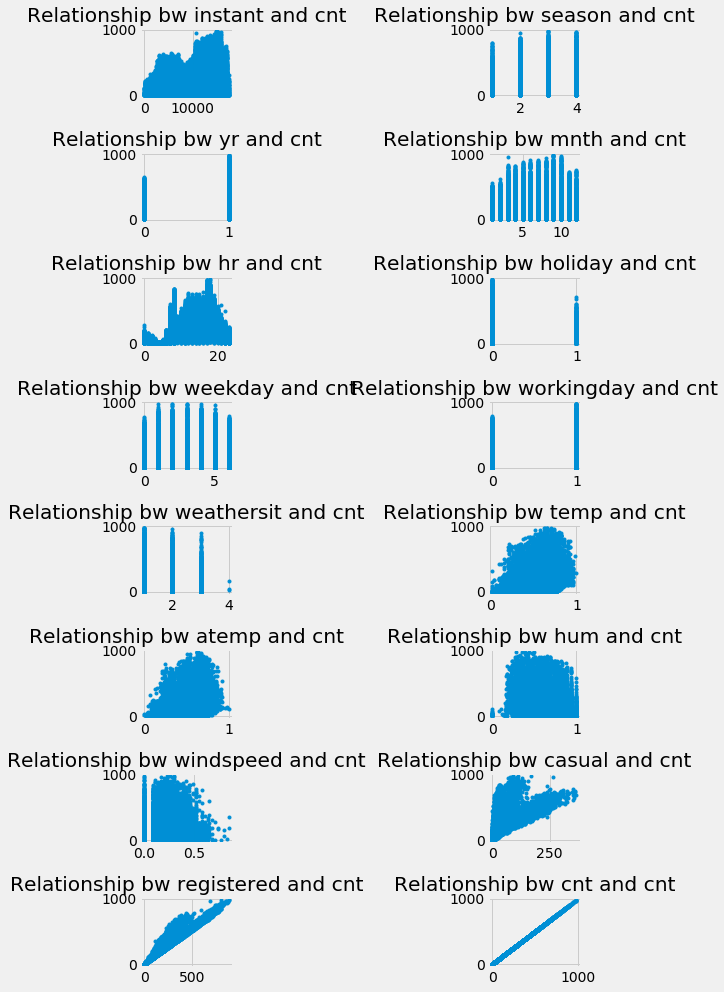

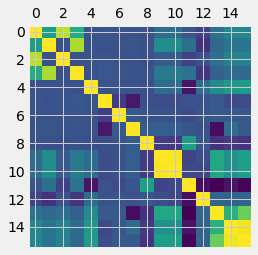

In [5]:

#colnames = ['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'registered', 'AGE', 'DIS', 'RAD', 'TAX', 'PTRATIO', 'B', 'LSTAT']

colnames = df.columns

plotFeatures(colnames,"Relationship bw %s and cnt")


plt.matshow(df.corr())

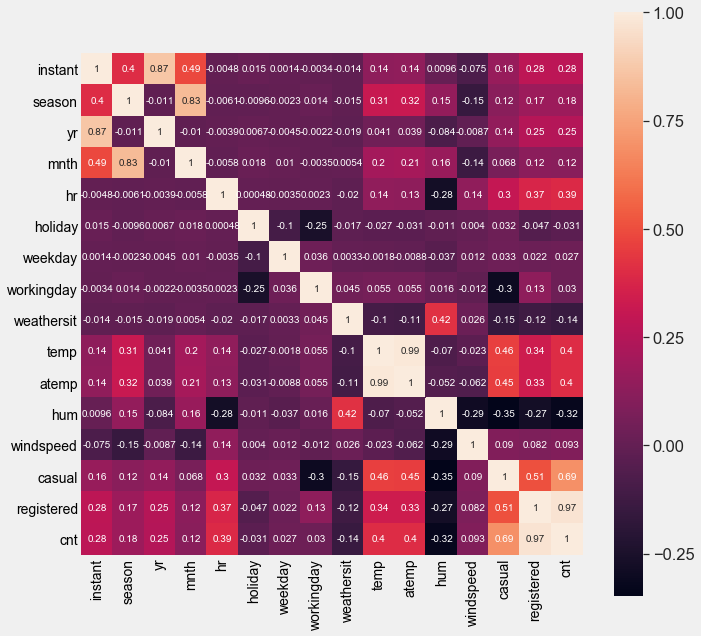

In [6]:

fig = plt.subplots(figsize = (10,10))
sns.set(font_scale=1.5)
sns.heatmap(df.corr(),square = True,cbar=True,annot=True,annot_kws={'size': 10})
plt.show()



In [7]:
def predictPrice(x,theta):
    return np.dot(x,theta)

In [8]:
def calculateCost(x,theta,Y):
    prediction = predictPrice(x,theta)
    return ((prediction - Y)**2).mean()/2

In [9]:
def abline(x,theta,Y):
    """Plot a line from slope and intercept"""
    
    y_vals = predictPrice(x,theta)
#    plt.xlim(-20, 20)
#    plt.ylim(-10, 60)
    plt.xlabel('No. of Rooms in the house')
    plt.ylabel('Price of house')
    plt.gca().set_aspect(0.1, adjustable='datalim')
    plt.plot(x[:,-1],Y,'.',x[:,-1], y_vals, '-.')
    plt.gca().legend(('Data','Regressor'))
    plt.show()

In [10]:
def loss_plot(x,costs_train,costs_val):
    '''plot the loss informination'''
    plt.xlabel('No. of iteration')
    plt.ylabel('Loss')
    plt.plot(x,costs_train,'.',x, costs_val, '-.')
    plt.gca().legend(('Train','Val'))
    plt.show()

In [23]:
def gradientDescentLinearRegression(alpha=0.0001,iter=20000,theta=[]):
    '''initialized the values'''
    prev_val = 1
    counter =0
    if any(theta):
        theta = theta
    else :
        theta = np.zeros(2)
#    else:
#        theta = np.zeros(2)
        
    theta0 = []
    theta1 = []
        
    costs_train = []
    costs_val = []
    
    '''provide the training informination'''
    predictor = df_train["registered"]
    x_train = np.column_stack((np.ones(len(predictor)),predictor))
    Y_train = df_train["cnt"]
    
    
    
    '''provide the validation informination'''
    predictor_val = df_val["registered"]
    x_val = np.column_stack((np.ones(len(predictor_val)),predictor_val))
    Y_val = df_val["cnt"]
     
    '''Do for number of iter'''
    for i in range(iter):
        '''do the prediction'''
        pred = predictPrice(x_train,theta)
        '''' correct the gradient '''
        t0 = theta[0] - alpha *(pred - Y_train).mean()
        t1 = theta[1] - alpha *((pred - Y_train)* x_train[:,1]).mean()
        theta = np.array([t0,t1])
        
        ''' training loss '''
        J_train = calculateCost(x_train,theta,Y_train)
        theta0.append(t0)
        theta1.append(t1)
        costs_train.append(J_train)
        '''validation loss'''
        J_val = calculateCost(x_val,theta,Y_val)
        costs_val.append(J_val)
        if i%10==0:
            print(f"Iteration: {i+1},Cost = {J_train},theta = {theta}")
            
            print(f"Iteration: {i+1},Cost_val = {J_val},theta = {theta}")
            
            abline(x_train,theta,Y_train)
        if J_val>prev_val:
            counter +=1   #counter = counter + 1
            prev_val = J_val
        else:
            counter = 0
            prev_val = J_val
            
        '''check the teregisteredination condition''' 
        if counter>10:
            print ("teregisteredinated")
            print(f'theta0 = {len(theta0)}\ntheta1 = {len(theta1)}\nCosts = {len(costs_train)}')
            print ( J_val,prev_val,counter,i)
            return costs_val,costs_train,theta,i+1
        
#            abline(x_train,theta,Y_train)
    print(f'theta0 = {len(theta0)}\ntheta1 = {len(theta1)}\nCosts = {len(costs_train)}')
    return costs_val,costs_train,theta,iter

Iteration: 1,Cost = 10416.758828235585,theta = [0.00190264 0.56444161]
Iteration: 1,Cost_val = 10448.144978051072,theta = [0.00190264 0.56444161]


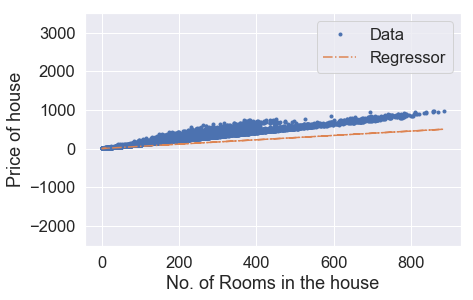

Iteration: 11,Cost = 943.6135885402562,theta = [0.00449718 1.19768563]
Iteration: 11,Cost_val = 948.0498707796667,theta = [0.00449718 1.19768563]


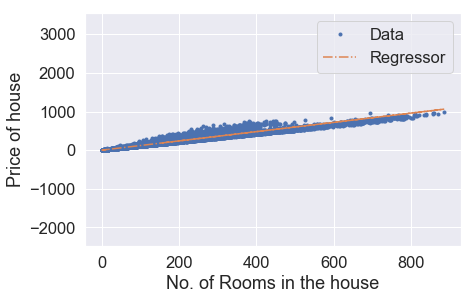

Iteration: 21,Cost = 943.5828425876023,theta = [0.00501883 1.19877382]
Iteration: 21,Cost_val = 947.8382294704114,theta = [0.00501883 1.19877382]


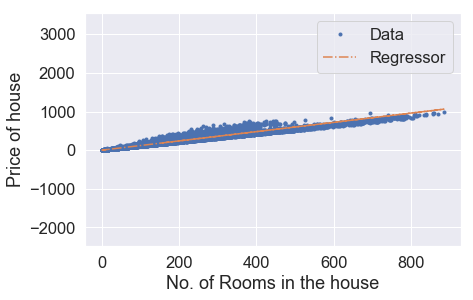

Iteration: 31,Cost = 943.5801587202974,theta = [0.00553688 1.198774  ]
Iteration: 31,Cost_val = 947.8352803676518,theta = [0.00553688 1.198774  ]


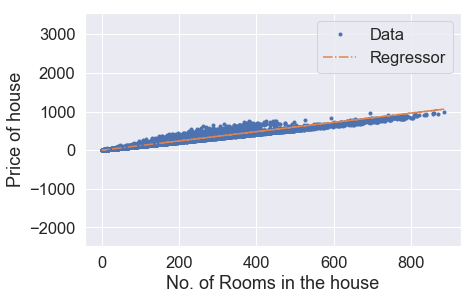

Iteration: 41,Cost = 943.5774752011329,theta = [0.00605491 1.19877231]
Iteration: 41,Cost_val = 947.8326428908274,theta = [0.00605491 1.19877231]


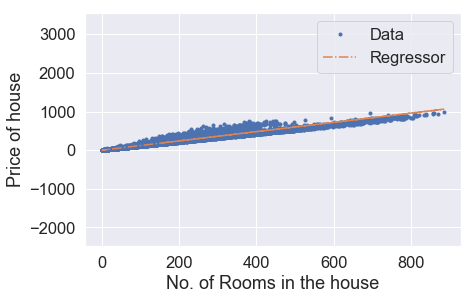

Iteration: 51,Cost = 943.5747919469492,theta = [0.00657291 1.19877061]
Iteration: 51,Cost_val = 947.8300062096909,theta = [0.00657291 1.19877061]


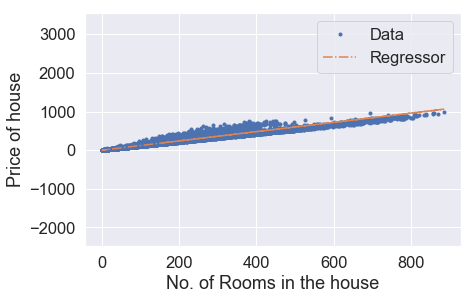

Iteration: 61,Cost = 943.5721089577314,theta = [0.00709088 1.19876891]
Iteration: 61,Cost_val = 947.8273697893806,theta = [0.00709088 1.19876891]


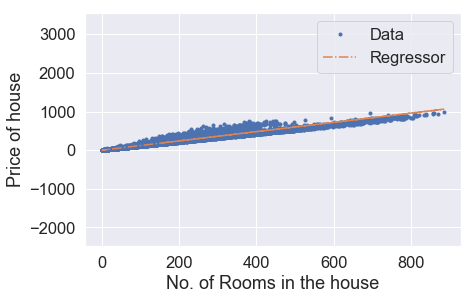

Iteration: 71,Cost = 943.5694262334353,theta = [0.00760883 1.19876721]
Iteration: 71,Cost_val = 947.8247336289529,theta = [0.00760883 1.19876721]


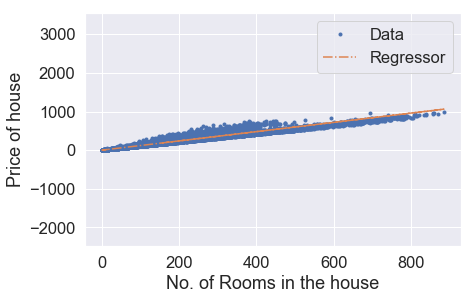

Iteration: 81,Cost = 943.5667437740706,theta = [0.00812675 1.19876551]
Iteration: 81,Cost_val = 947.8220977283788,theta = [0.00812675 1.19876551]


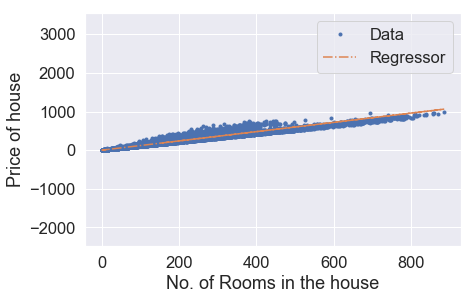

Iteration: 91,Cost = 943.5640615795646,theta = [0.00864465 1.19876381]
Iteration: 91,Cost_val = 947.8194620876371,theta = [0.00864465 1.19876381]


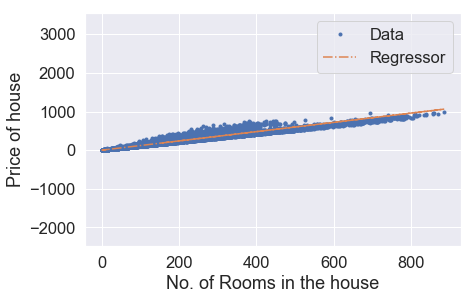

theta0 = 100
theta1 = 100
Costs = 100


In [12]:
costs_val,costs_train,theta,iteration  = gradientDescentLinearRegression(alpha=0.00001,iter=100)


In [24]:
'''prepare the test data'''

predictor_test = df_test["registered"]
x_test = np.column_stack((np.ones(len(predictor_test)),predictor_test))
Y_test = df_test["cnt"]  

In [14]:
'''Calculate the loss for test data'''
J_test = calculateCost(x_test,theta,Y_test)
print(f"Cost_test = {J_test}")

Cost_test = 869.890643360146


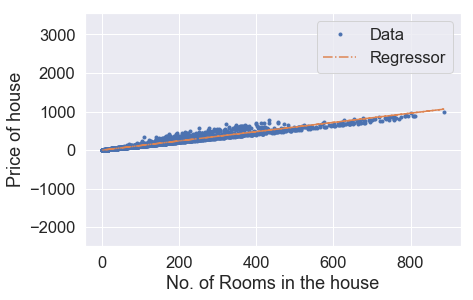

In [15]:
'''plot the test data'''
abline(x_test,theta,Y_test)

In [16]:
''' create range of iteration'''
iteration_range=list(range(0, iteration))

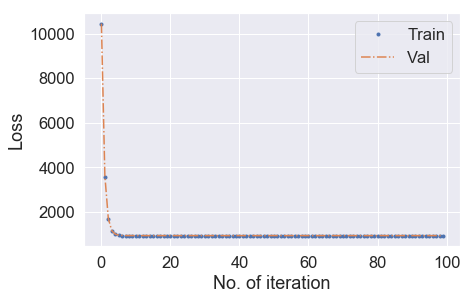

In [17]:
'''plot loss'''
loss_plot(iteration_range,costs_train,costs_val)

Iteration: 1,Cost = 943.5613796499246,theta = [0.00916252 1.19876212]
Iteration: 1,Cost_val = 947.8168267067033,theta = [0.00916252 1.19876212]


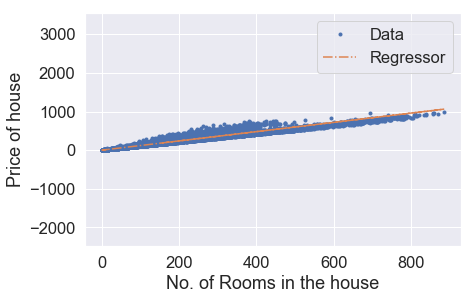

Iteration: 11,Cost = 943.5586979851054,theta = [0.00968037 1.19876042]
Iteration: 11,Cost_val = 947.8141915855412,theta = [0.00968037 1.19876042]


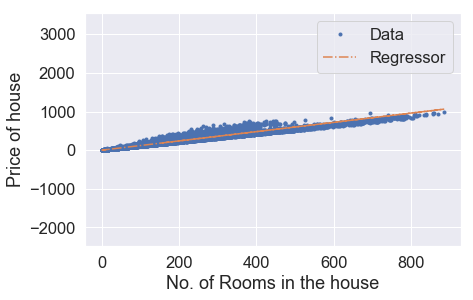

Iteration: 21,Cost = 943.5560165850976,theta = [0.01019819 1.19875872]
Iteration: 21,Cost_val = 947.811556724137,theta = [0.01019819 1.19875872]


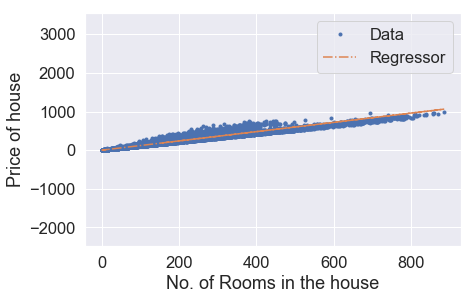

Iteration: 31,Cost = 943.5533354498708,theta = [0.01071598 1.19875702]
Iteration: 31,Cost_val = 947.8089221224551,theta = [0.01071598 1.19875702]


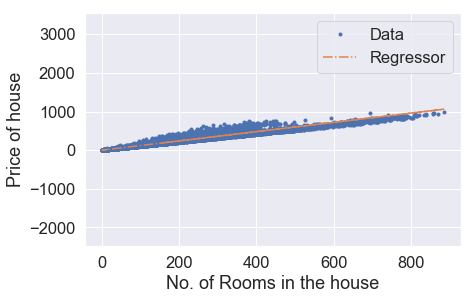

Iteration: 41,Cost = 943.5506545793787,theta = [0.01123375 1.19875532]
Iteration: 41,Cost_val = 947.8062877804729,theta = [0.01123375 1.19875532]


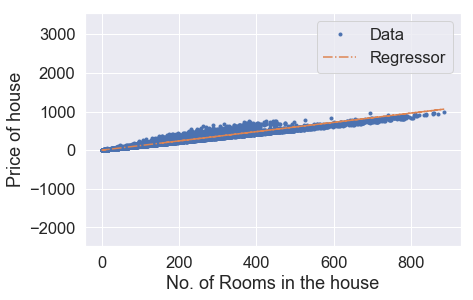

Iteration: 51,Cost = 943.5479739736122,theta = [0.01175149 1.19875363]
Iteration: 51,Cost_val = 947.8036536981705,theta = [0.01175149 1.19875363]


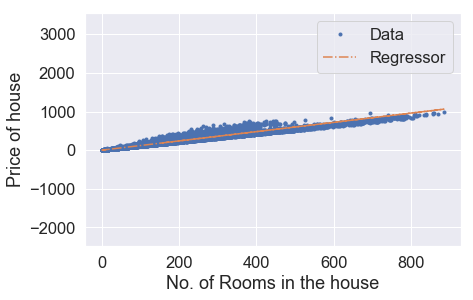

Iteration: 61,Cost = 943.5452936325504,theta = [0.01226921 1.19875193]
Iteration: 61,Cost_val = 947.8010198755211,theta = [0.01226921 1.19875193]


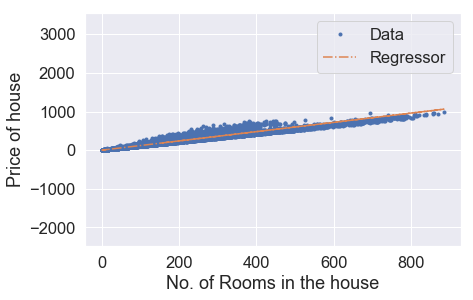

Iteration: 71,Cost = 943.542613556171,theta = [0.0127869  1.19875023]
Iteration: 71,Cost_val = 947.7983863124919,theta = [0.0127869  1.19875023]


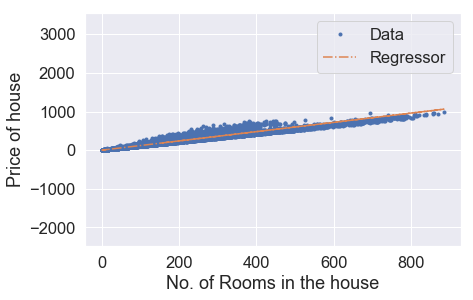

Iteration: 81,Cost = 943.539933744423,theta = [0.01330457 1.19874853]
Iteration: 81,Cost_val = 947.7957530090678,theta = [0.01330457 1.19874853]


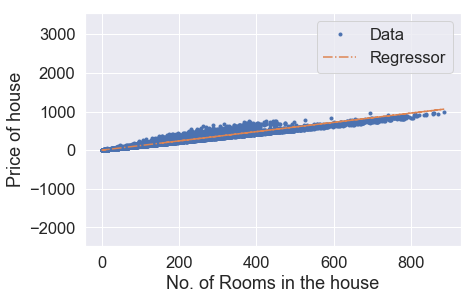

Iteration: 91,Cost = 943.5372541972794,theta = [0.01382221 1.19874684]
Iteration: 91,Cost_val = 947.7931199652106,theta = [0.01382221 1.19874684]


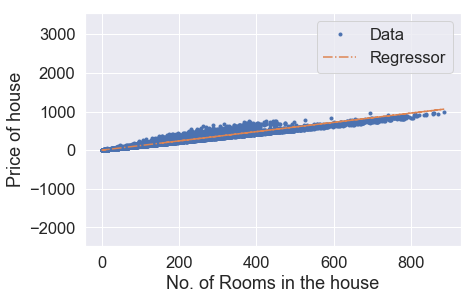

Iteration: 101,Cost = 943.5345749147613,theta = [0.01433983 1.19874514]
Iteration: 101,Cost_val = 947.7904871808958,theta = [0.01433983 1.19874514]


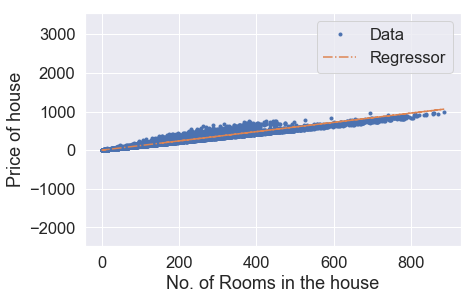

Iteration: 111,Cost = 943.5318958967965,theta = [0.01485742 1.19874344]
Iteration: 111,Cost_val = 947.7878546561171,theta = [0.01485742 1.19874344]


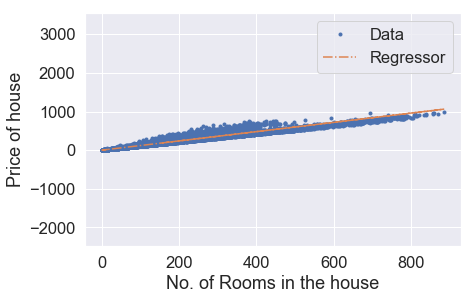

Iteration: 121,Cost = 943.5292171433757,theta = [0.01537498 1.19874174]
Iteration: 121,Cost_val = 947.7852223908257,theta = [0.01537498 1.19874174]


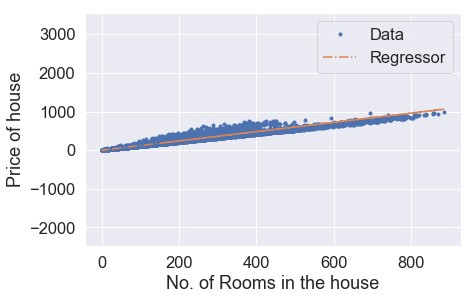

Iteration: 131,Cost = 943.5265386544748,theta = [0.01589252 1.19874005]
Iteration: 131,Cost_val = 947.78259038501,theta = [0.01589252 1.19874005]


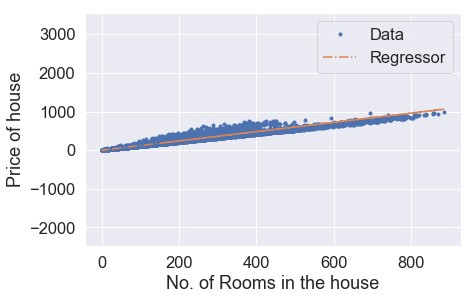

Iteration: 141,Cost = 943.5238604300571,theta = [0.01641003 1.19873835]
Iteration: 141,Cost_val = 947.7799586386328,theta = [0.01641003 1.19873835]


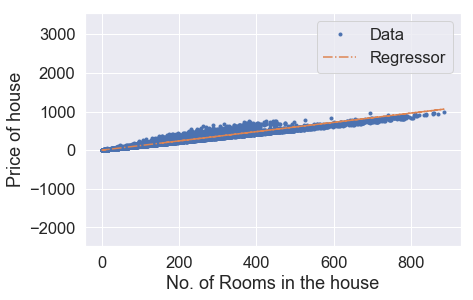

Iteration: 151,Cost = 943.5211824700933,theta = [0.01692752 1.19873665]
Iteration: 151,Cost_val = 947.7773271516779,theta = [0.01692752 1.19873665]


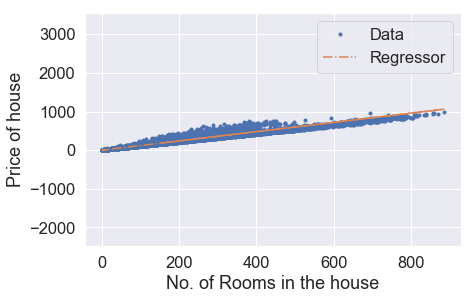

Iteration: 161,Cost = 943.5185047745725,theta = [0.01744498 1.19873496]
Iteration: 161,Cost_val = 947.7746959241251,theta = [0.01744498 1.19873496]


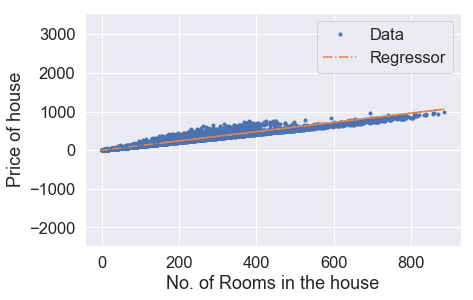

Iteration: 171,Cost = 943.5158273434798,theta = [0.01796242 1.19873326]
Iteration: 171,Cost_val = 947.7720649559327,theta = [0.01796242 1.19873326]


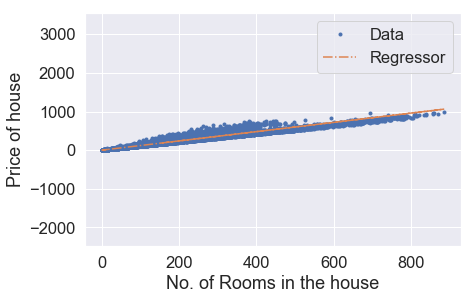

Iteration: 181,Cost = 943.5131501767452,theta = [0.01847983 1.19873156]
Iteration: 181,Cost_val = 947.7694342470869,theta = [0.01847983 1.19873156]


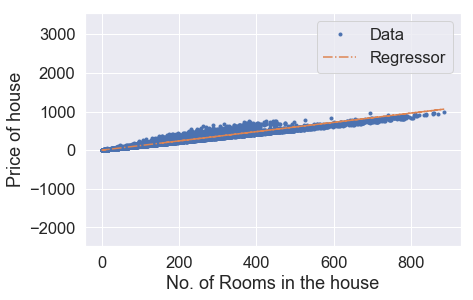

Iteration: 191,Cost = 943.5104732743808,theta = [0.01899722 1.19872987]
Iteration: 191,Cost_val = 947.7668037975541,theta = [0.01899722 1.19872987]


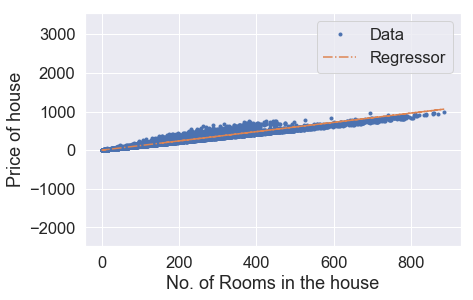

Iteration: 201,Cost = 943.5077966363597,theta = [0.01951458 1.19872817]
Iteration: 201,Cost_val = 947.7641736073153,theta = [0.01951458 1.19872817]


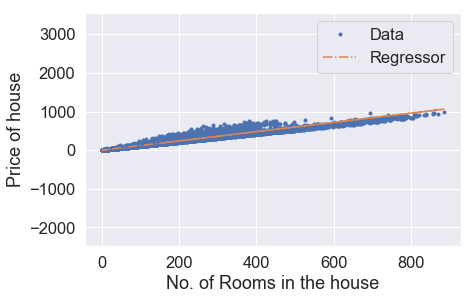

Iteration: 211,Cost = 943.5051202626297,theta = [0.02003191 1.19872647]
Iteration: 211,Cost_val = 947.7615436763459,theta = [0.02003191 1.19872647]


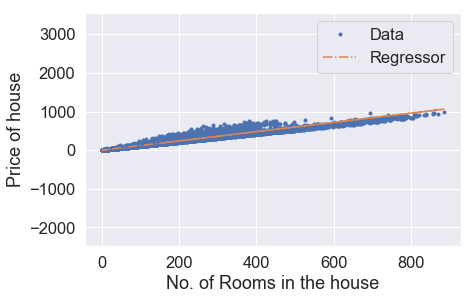

Iteration: 221,Cost = 943.5024441531815,theta = [0.02054922 1.19872478]
Iteration: 221,Cost_val = 947.758914004615,theta = [0.02054922 1.19872478]


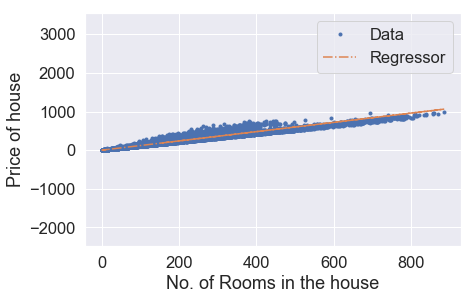

Iteration: 231,Cost = 943.4997683080003,theta = [0.02106651 1.19872308]
Iteration: 231,Cost_val = 947.7562845920964,theta = [0.02106651 1.19872308]


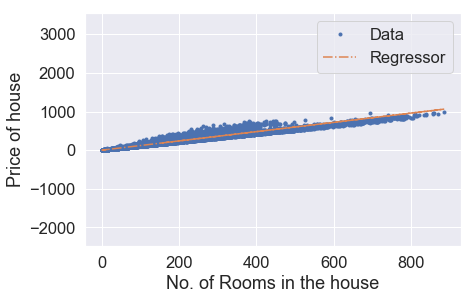

Iteration: 241,Cost = 943.4970927270319,theta = [0.02158376 1.19872139]
Iteration: 241,Cost_val = 947.7536554387718,theta = [0.02158376 1.19872139]


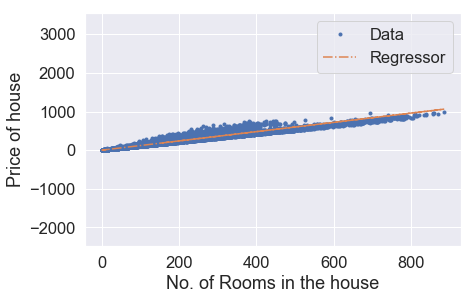

Iteration: 251,Cost = 943.4944174102744,theta = [0.022101   1.19871969]
Iteration: 251,Cost_val = 947.7510265446067,theta = [0.022101   1.19871969]


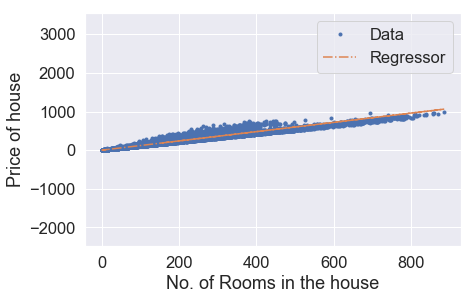

Iteration: 261,Cost = 943.4917423576973,theta = [0.0226182  1.19871799]
Iteration: 261,Cost_val = 947.7483979095817,theta = [0.0226182  1.19871799]


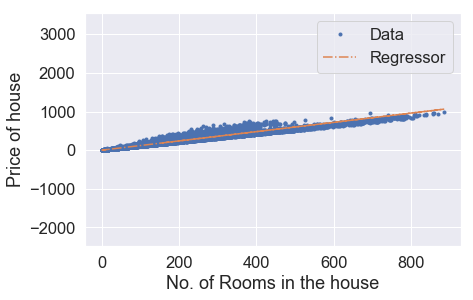

Iteration: 271,Cost = 943.4890675692484,theta = [0.02313539 1.1987163 ]
Iteration: 271,Cost_val = 947.7457695336718,theta = [0.02313539 1.1987163 ]


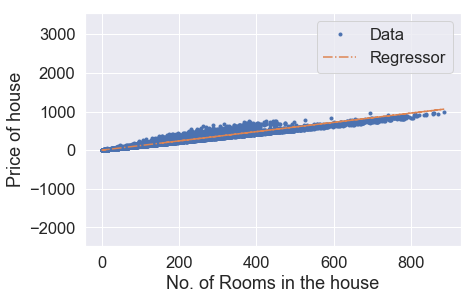

Iteration: 281,Cost = 943.4863930449434,theta = [0.02365254 1.1987146 ]
Iteration: 281,Cost_val = 947.7431414168469,theta = [0.02365254 1.1987146 ]


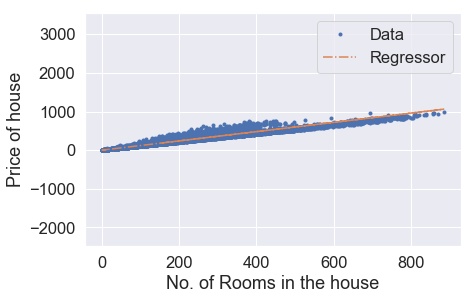

Iteration: 291,Cost = 943.4837187847229,theta = [0.02416967 1.19871291]
Iteration: 291,Cost_val = 947.7405135590867,theta = [0.02416967 1.19871291]


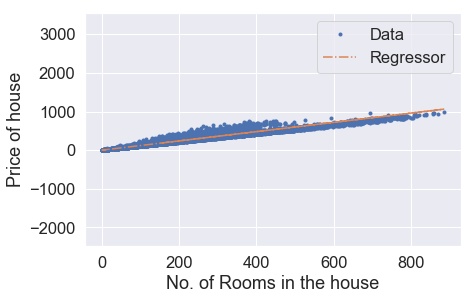

Iteration: 301,Cost = 943.481044788586,theta = [0.02468678 1.19871121]
Iteration: 301,Cost_val = 947.7378859603563,theta = [0.02468678 1.19871121]


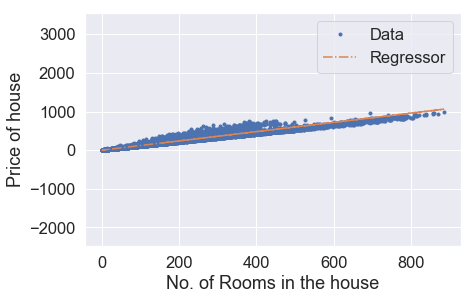

Iteration: 311,Cost = 943.4783710564961,theta = [0.02520386 1.19870952]
Iteration: 311,Cost_val = 947.7352586206414,theta = [0.02520386 1.19870952]


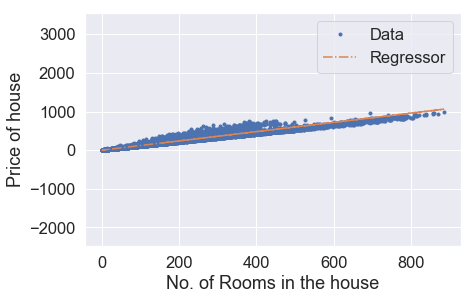

Iteration: 321,Cost = 943.4756975884255,theta = [0.02572091 1.19870782]
Iteration: 321,Cost_val = 947.73263153991,theta = [0.02572091 1.19870782]


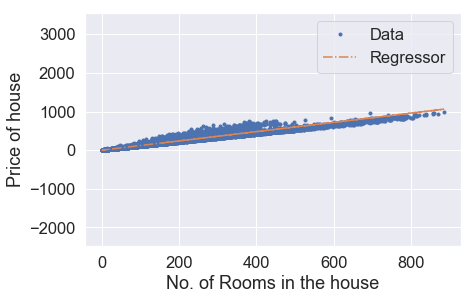

Iteration: 331,Cost = 943.4730243843261,theta = [0.02623794 1.19870612]
Iteration: 331,Cost_val = 947.7300047181357,theta = [0.02623794 1.19870612]


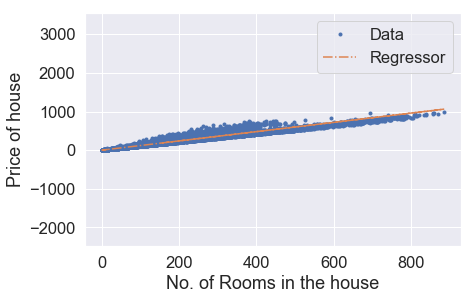

Iteration: 341,Cost = 943.4703514442195,theta = [0.02675494 1.19870443]
Iteration: 341,Cost_val = 947.7273781552981,theta = [0.02675494 1.19870443]


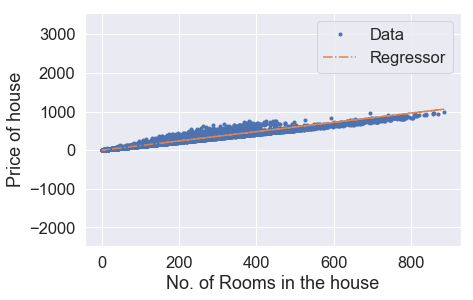

Iteration: 351,Cost = 943.4676787680402,theta = [0.02727192 1.19870273]
Iteration: 351,Cost_val = 947.7247518513688,theta = [0.02727192 1.19870273]


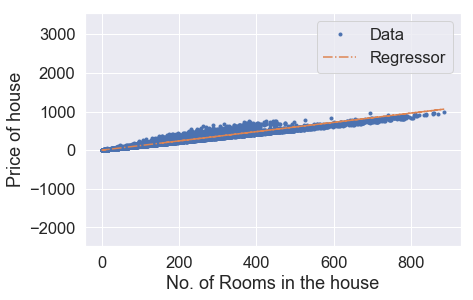

Iteration: 361,Cost = 943.4650063557807,theta = [0.02778887 1.19870104]
Iteration: 361,Cost_val = 947.7221258063249,theta = [0.02778887 1.19870104]


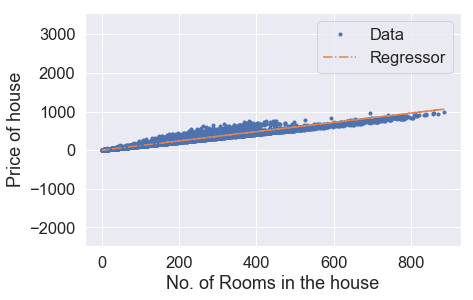

Iteration: 371,Cost = 943.4623342074118,theta = [0.0283058  1.19869934]
Iteration: 371,Cost_val = 947.7195000201323,theta = [0.0283058  1.19869934]


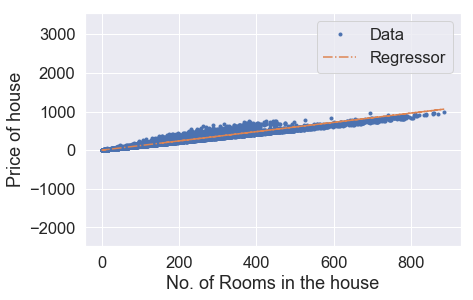

Iteration: 381,Cost = 943.459662322905,theta = [0.0288227  1.19869765]
Iteration: 381,Cost_val = 947.7168744927767,theta = [0.0288227  1.19869765]


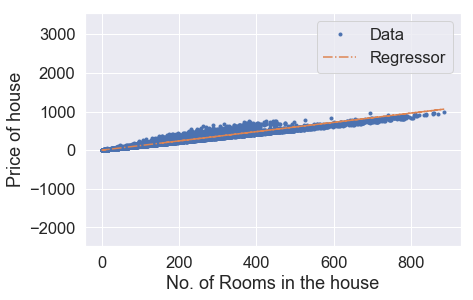

Iteration: 391,Cost = 943.4569907022346,theta = [0.02933957 1.19869595]
Iteration: 391,Cost_val = 947.7142492242249,theta = [0.02933957 1.19869595]


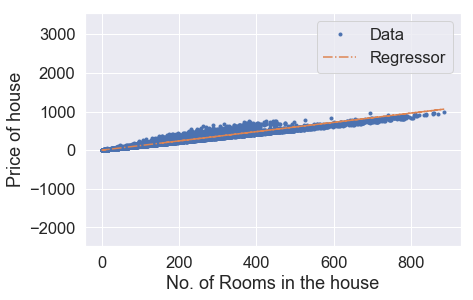

Iteration: 401,Cost = 943.4543193453699,theta = [0.02985642 1.19869426]
Iteration: 401,Cost_val = 947.7116242144565,theta = [0.02985642 1.19869426]


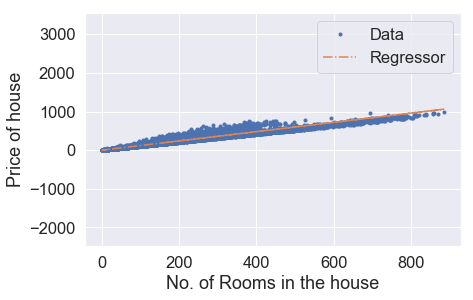

Iteration: 411,Cost = 943.4516482522984,theta = [0.03037324 1.19869256]
Iteration: 411,Cost_val = 947.7089994634367,theta = [0.03037324 1.19869256]


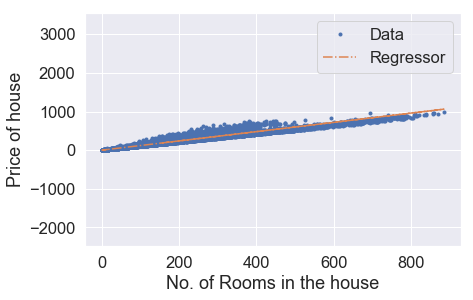

Iteration: 421,Cost = 943.4489774229819,theta = [0.03089004 1.19869087]
Iteration: 421,Cost_val = 947.7063749711524,theta = [0.03089004 1.19869087]


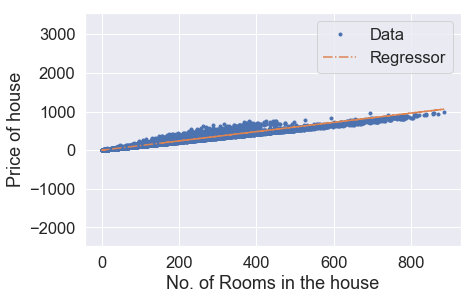

Iteration: 431,Cost = 943.4463068573945,theta = [0.03140682 1.19868918]
Iteration: 431,Cost_val = 947.7037507375696,theta = [0.03140682 1.19868918]


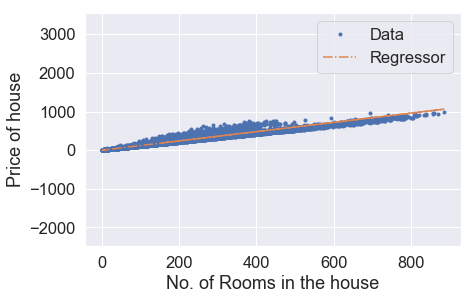

Iteration: 441,Cost = 943.4436365555233,theta = [0.03192356 1.19868748]
Iteration: 441,Cost_val = 947.7011267626663,theta = [0.03192356 1.19868748]


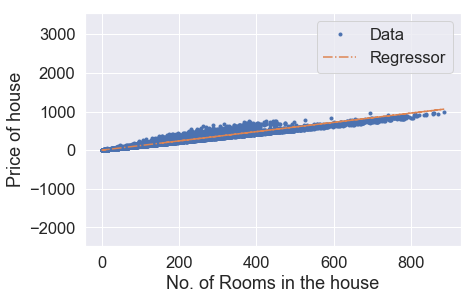

Iteration: 451,Cost = 943.4409665173307,theta = [0.03244029 1.19868579]
Iteration: 451,Cost_val = 947.698503046413,theta = [0.03244029 1.19868579]


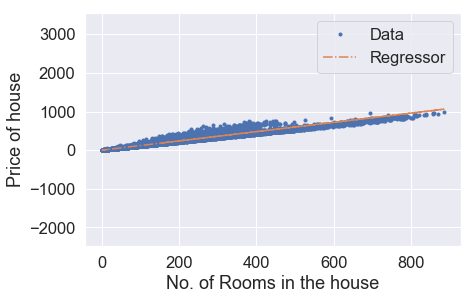

Iteration: 461,Cost = 943.4382967427836,theta = [0.03295698 1.19868409]
Iteration: 461,Cost_val = 947.6958795887931,theta = [0.03295698 1.19868409]


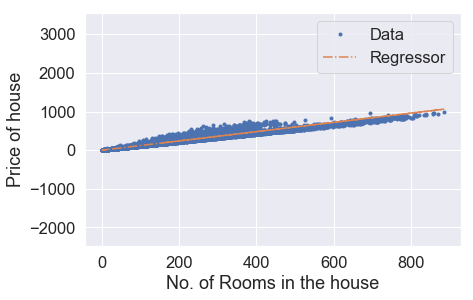

Iteration: 471,Cost = 943.4356272318743,theta = [0.03347365 1.1986824 ]
Iteration: 471,Cost_val = 947.6932563897707,theta = [0.03347365 1.1986824 ]


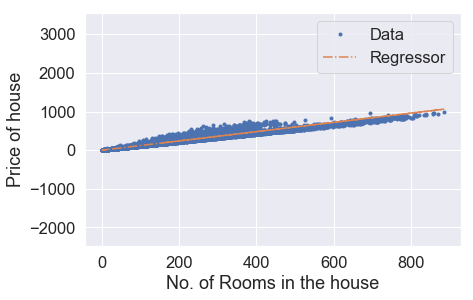

Iteration: 481,Cost = 943.4329579845672,theta = [0.0339903 1.1986807]
Iteration: 481,Cost_val = 947.6906334493278,theta = [0.0339903 1.1986807]


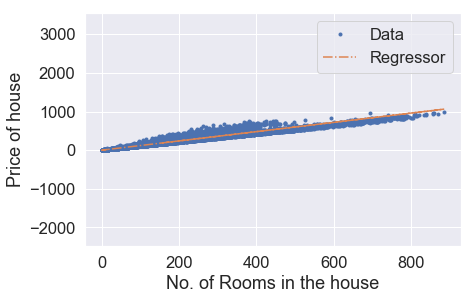

Iteration: 491,Cost = 943.4302890008279,theta = [0.03450692 1.19867901]
Iteration: 491,Cost_val = 947.6880107674318,theta = [0.03450692 1.19867901]


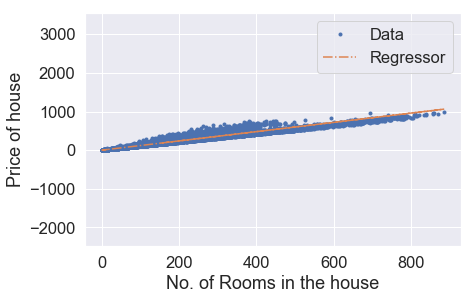

Iteration: 501,Cost = 943.4276202806474,theta = [0.03502351 1.19867732]
Iteration: 501,Cost_val = 947.6853883440623,theta = [0.03502351 1.19867732]


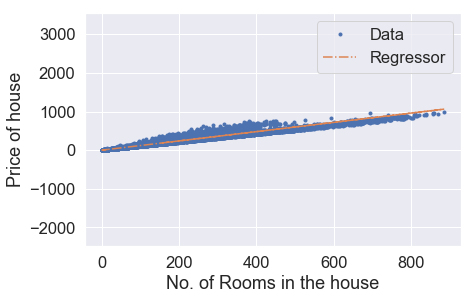

Iteration: 511,Cost = 943.4249518239923,theta = [0.03554008 1.19867562]
Iteration: 511,Cost_val = 947.6827661791966,theta = [0.03554008 1.19867562]


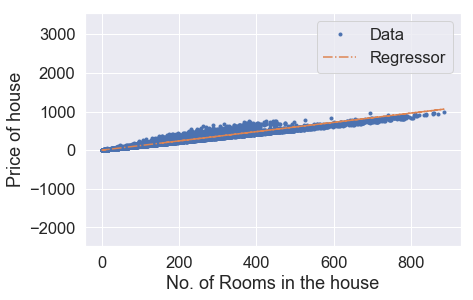

Iteration: 521,Cost = 943.4222836308252,theta = [0.03605663 1.19867393]
Iteration: 521,Cost_val = 947.6801442728017,theta = [0.03605663 1.19867393]


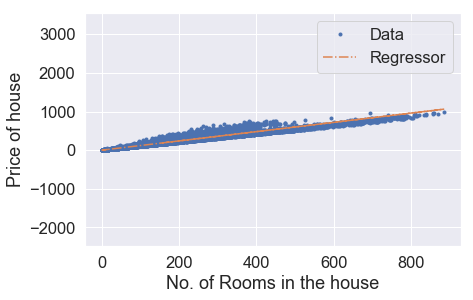

Iteration: 531,Cost = 943.4196157011454,theta = [0.03657314 1.19867223]
Iteration: 531,Cost_val = 947.6775226248569,theta = [0.03657314 1.19867223]


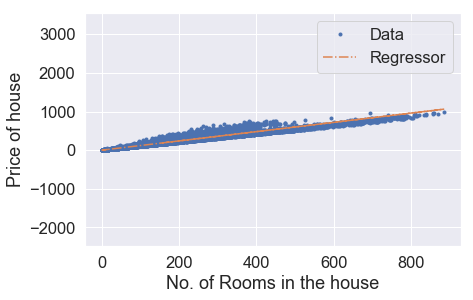

Iteration: 541,Cost = 943.4169480349025,theta = [0.03708964 1.19867054]
Iteration: 541,Cost_val = 947.6749012353324,theta = [0.03708964 1.19867054]


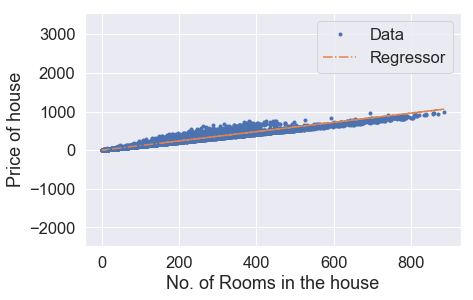

Iteration: 551,Cost = 943.4142806320872,theta = [0.0376061  1.19866885]
Iteration: 551,Cost_val = 947.6722801042113,theta = [0.0376061  1.19866885]


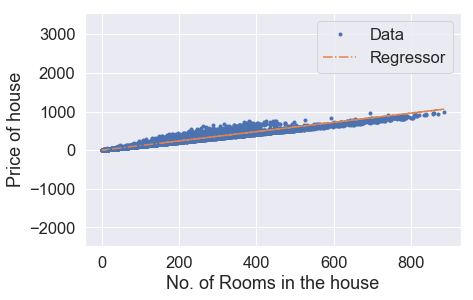

Iteration: 561,Cost = 943.4116134926526,theta = [0.03812254 1.19866715]
Iteration: 561,Cost_val = 947.669659231463,theta = [0.03812254 1.19866715]


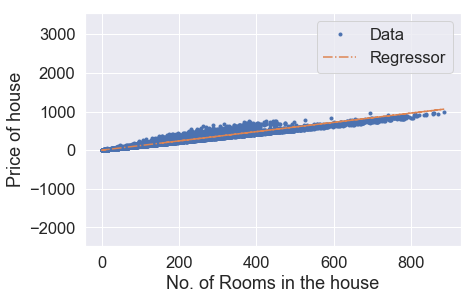

Iteration: 571,Cost = 943.4089466166071,theta = [0.03863896 1.19866546]
Iteration: 571,Cost_val = 947.6670386170572,theta = [0.03863896 1.19866546]


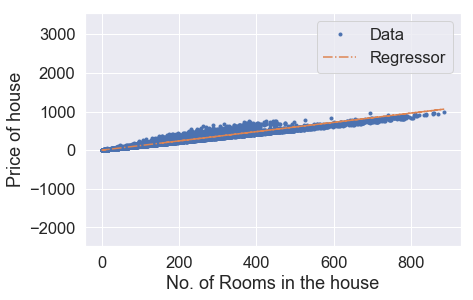

Iteration: 581,Cost = 943.406280003893,theta = [0.03915535 1.19866377]
Iteration: 581,Cost_val = 947.6644182609726,theta = [0.03915535 1.19866377]


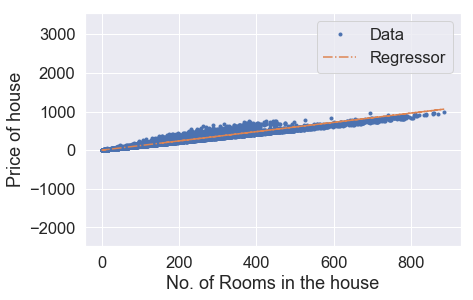

Iteration: 591,Cost = 943.4036136544935,theta = [0.03967171 1.19866207]
Iteration: 591,Cost_val = 947.6617981631875,theta = [0.03967171 1.19866207]


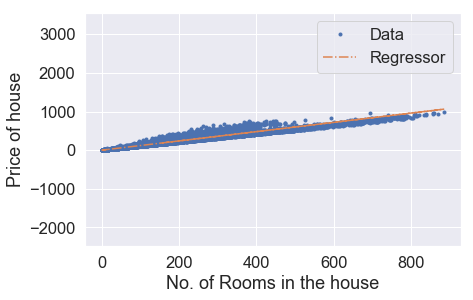

Iteration: 601,Cost = 943.4009475683871,theta = [0.04018805 1.19866038]
Iteration: 601,Cost_val = 947.6591783236673,theta = [0.04018805 1.19866038]


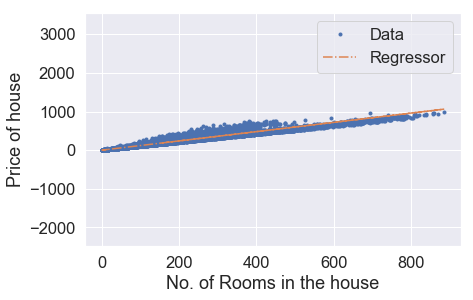

Iteration: 611,Cost = 943.3982817455309,theta = [0.04070437 1.19865869]
Iteration: 611,Cost_val = 947.6565587424016,theta = [0.04070437 1.19865869]


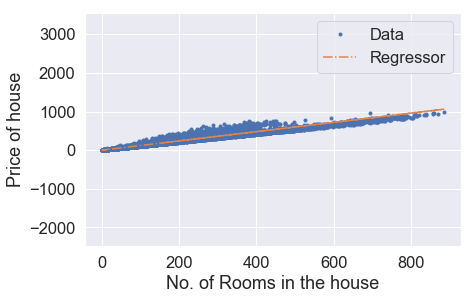

Iteration: 621,Cost = 943.395616185931,theta = [0.04122066 1.198657  ]
Iteration: 621,Cost_val = 947.65393941935,theta = [0.04122066 1.198657  ]


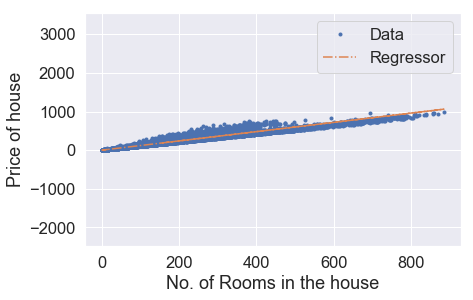

Iteration: 631,Cost = 943.3929508895355,theta = [0.04173692 1.1986553 ]
Iteration: 631,Cost_val = 947.6513203544916,theta = [0.04173692 1.1986553 ]


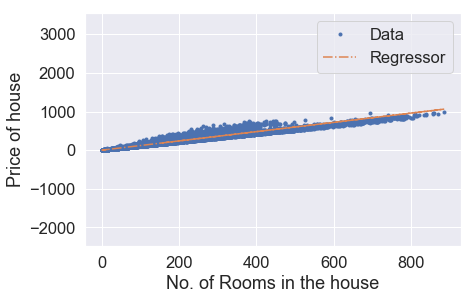

Iteration: 641,Cost = 943.3902858563358,theta = [0.04225316 1.19865361]
Iteration: 641,Cost_val = 947.6487015477992,theta = [0.04225316 1.19865361]


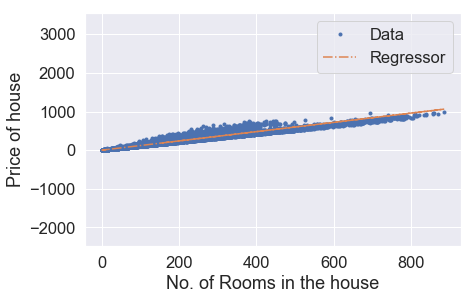

Iteration: 651,Cost = 943.3876210862884,theta = [0.04276937 1.19865192]
Iteration: 651,Cost_val = 947.6460829992556,theta = [0.04276937 1.19865192]


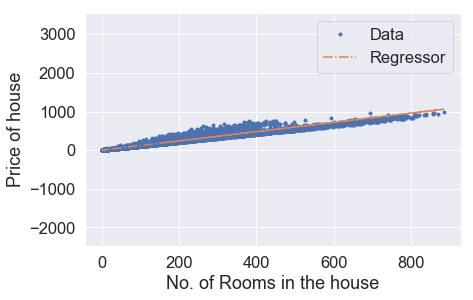

Iteration: 661,Cost = 943.3849565793776,theta = [0.04328556 1.19865022]
Iteration: 661,Cost_val = 947.643464708828,theta = [0.04328556 1.19865022]


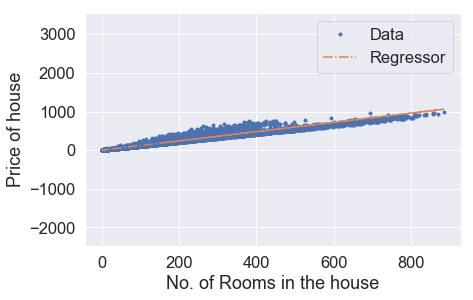

Iteration: 671,Cost = 943.382292335567,theta = [0.04380172 1.19864853]
Iteration: 671,Cost_val = 947.6408466764906,theta = [0.04380172 1.19864853]


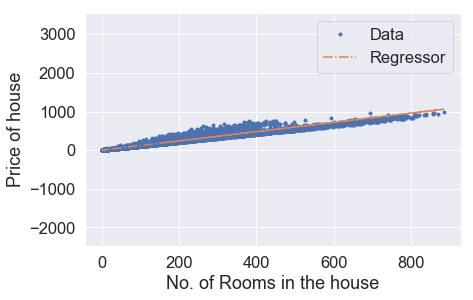

Iteration: 681,Cost = 943.3796283548639,theta = [0.04431785 1.19864684]
Iteration: 681,Cost_val = 947.6382289022222,theta = [0.04431785 1.19864684]


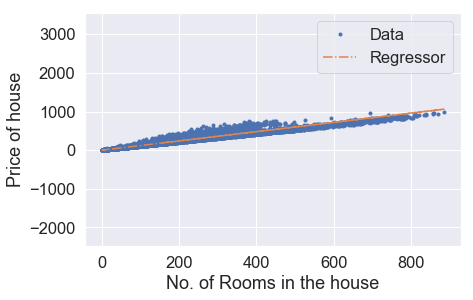

Iteration: 691,Cost = 943.3769646371927,theta = [0.04483396 1.19864515]
Iteration: 691,Cost_val = 947.6356113859952,theta = [0.04483396 1.19864515]


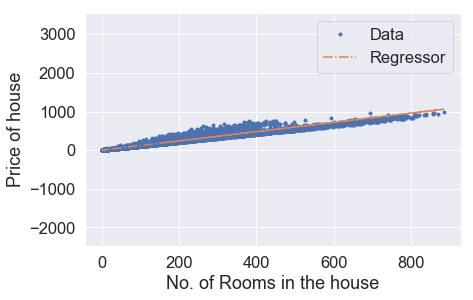

Iteration: 701,Cost = 943.3743011825561,theta = [0.04535005 1.19864346]
Iteration: 701,Cost_val = 947.6329941277853,theta = [0.04535005 1.19864346]


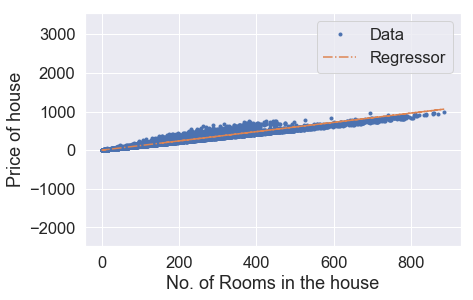

Iteration: 711,Cost = 943.3716379909262,theta = [0.04586611 1.19864176]
Iteration: 711,Cost_val = 947.630377127563,theta = [0.04586611 1.19864176]


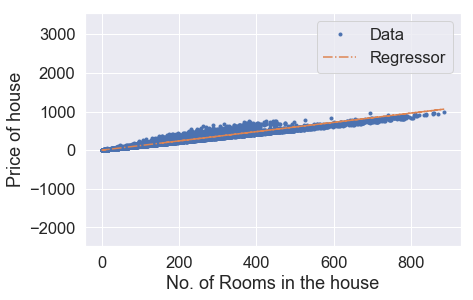

Iteration: 721,Cost = 943.3689750622812,theta = [0.04638214 1.19864007]
Iteration: 721,Cost_val = 947.6277603853059,theta = [0.04638214 1.19864007]


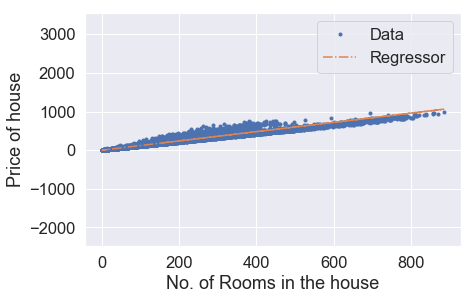

Iteration: 731,Cost = 943.366312396582,theta = [0.04689815 1.19863838]
Iteration: 731,Cost_val = 947.6251439009868,theta = [0.04689815 1.19863838]


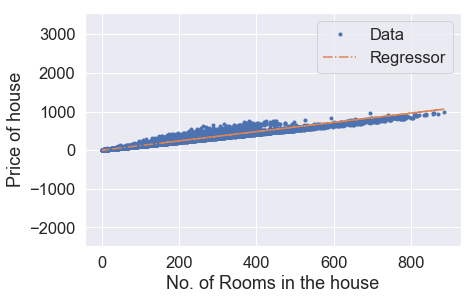

Iteration: 741,Cost = 943.3636499938109,theta = [0.04741413 1.19863669]
Iteration: 741,Cost_val = 947.6225276745835,theta = [0.04741413 1.19863669]


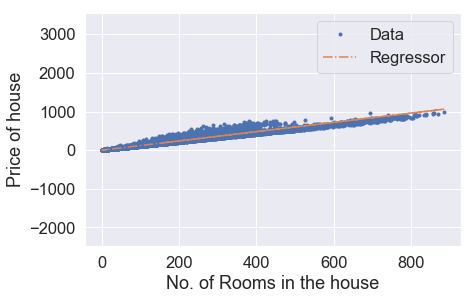

Iteration: 751,Cost = 943.3609878539438,theta = [0.04793009 1.198635  ]
Iteration: 751,Cost_val = 947.6199117060692,theta = [0.04793009 1.198635  ]


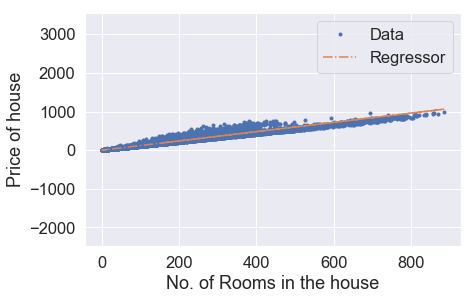

Iteration: 761,Cost = 943.358325976946,theta = [0.04844602 1.1986333 ]
Iteration: 761,Cost_val = 947.6172959954146,theta = [0.04844602 1.1986333 ]


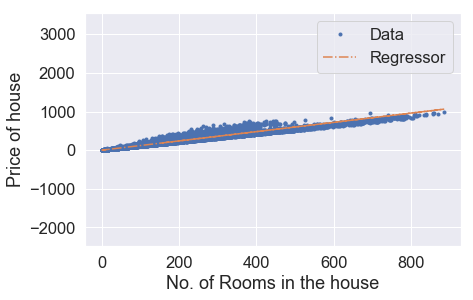

Iteration: 771,Cost = 943.3556643628117,theta = [0.04896193 1.19863161]
Iteration: 771,Cost_val = 947.6146805426025,theta = [0.04896193 1.19863161]


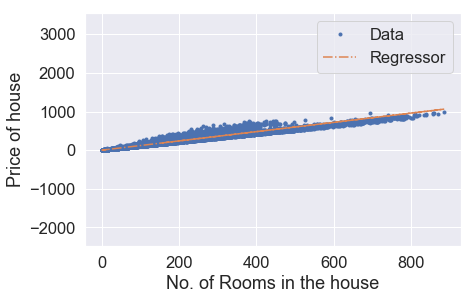

Iteration: 781,Cost = 943.3530030114787,theta = [0.04947781 1.19862992]
Iteration: 781,Cost_val = 947.6120653475978,theta = [0.04947781 1.19862992]


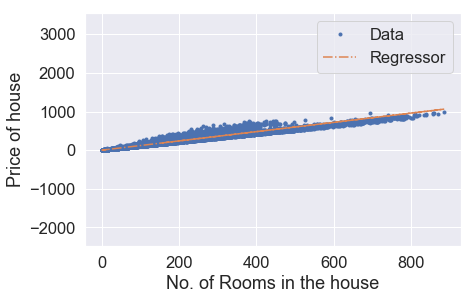

Iteration: 791,Cost = 943.3503419229597,theta = [0.04999366 1.19862823]
Iteration: 791,Cost_val = 947.609450410384,theta = [0.04999366 1.19862823]


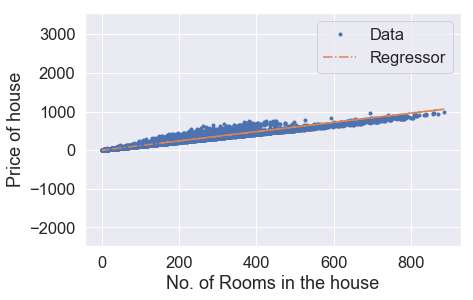

Iteration: 801,Cost = 943.347681097196,theta = [0.05050949 1.19862654]
Iteration: 801,Cost_val = 947.6068357309302,theta = [0.05050949 1.19862654]


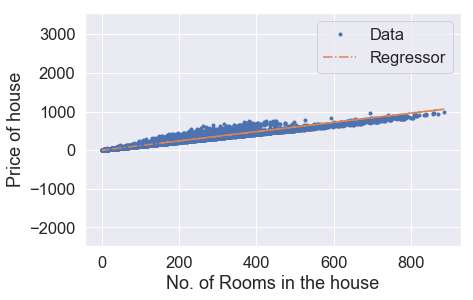

Iteration: 811,Cost = 943.3450205341857,theta = [0.0510253  1.19862485]
Iteration: 811,Cost_val = 947.6042213092132,theta = [0.0510253  1.19862485]


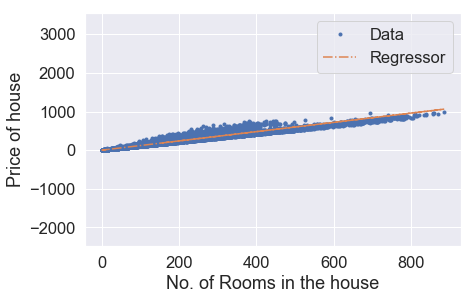

Iteration: 821,Cost = 943.342360233886,theta = [0.05154107 1.19862315]
Iteration: 821,Cost_val = 947.6016071452087,theta = [0.05154107 1.19862315]


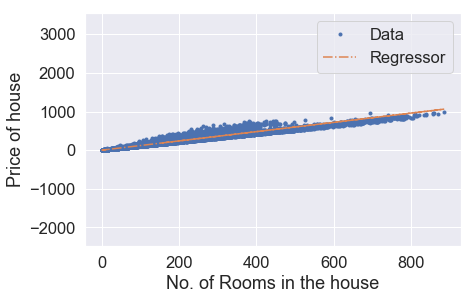

Iteration: 831,Cost = 943.3397001963062,theta = [0.05205683 1.19862146]
Iteration: 831,Cost_val = 947.598993238884,theta = [0.05205683 1.19862146]


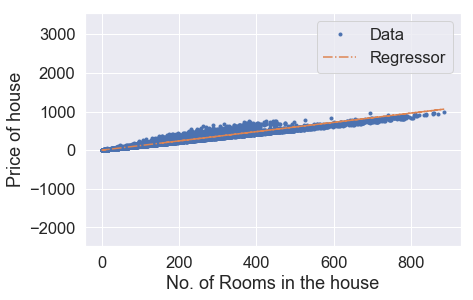

Iteration: 841,Cost = 943.3370404213621,theta = [0.05257256 1.19861977]
Iteration: 841,Cost_val = 947.5963795902215,theta = [0.05257256 1.19861977]


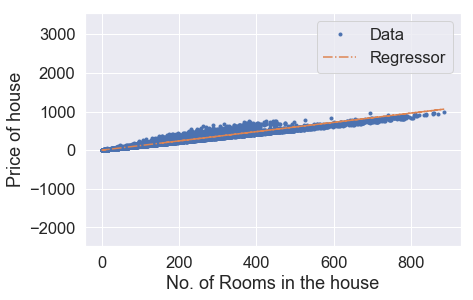

Iteration: 851,Cost = 943.3343809090675,theta = [0.05308826 1.19861808]
Iteration: 851,Cost_val = 947.5937661991928,theta = [0.05308826 1.19861808]


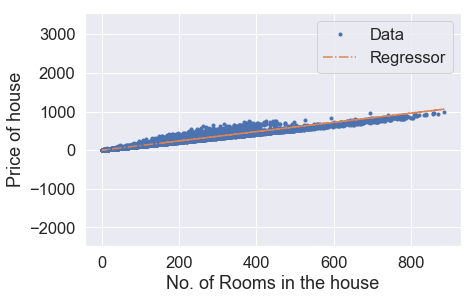

Iteration: 861,Cost = 943.3317216594032,theta = [0.05360393 1.19861639]
Iteration: 861,Cost_val = 947.5911530657755,theta = [0.05360393 1.19861639]


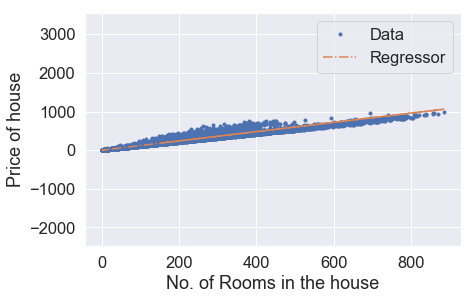

Iteration: 871,Cost = 943.3290626723159,theta = [0.05411959 1.1986147 ]
Iteration: 871,Cost_val = 947.5885401899371,theta = [0.05411959 1.1986147 ]


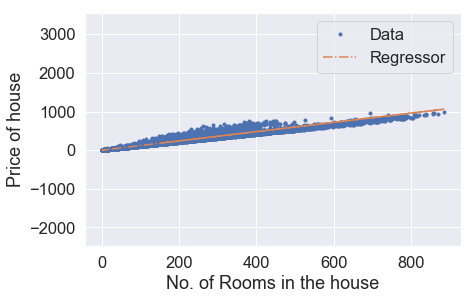

Iteration: 881,Cost = 943.3264039477889,theta = [0.05463521 1.19861301]
Iteration: 881,Cost_val = 947.5859275716593,theta = [0.05463521 1.19861301]


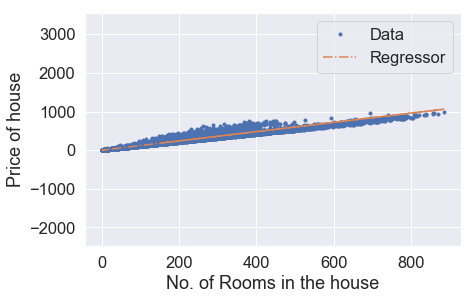

Iteration: 891,Cost = 943.3237454858076,theta = [0.05515081 1.19861132]
Iteration: 891,Cost_val = 947.5833152109133,theta = [0.05515081 1.19861132]


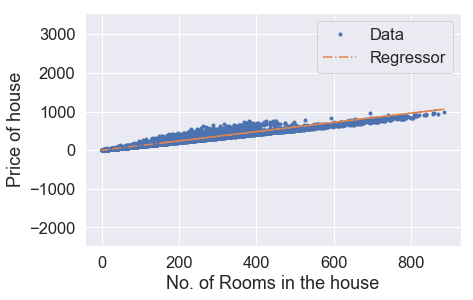

Iteration: 901,Cost = 943.3210872863358,theta = [0.05566639 1.19860963]
Iteration: 901,Cost_val = 947.5807031076766,theta = [0.05566639 1.19860963]


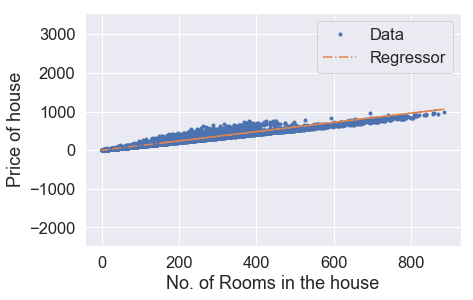

Iteration: 911,Cost = 943.3184293493478,theta = [0.05618194 1.19860794]
Iteration: 911,Cost_val = 947.5780912619184,theta = [0.05618194 1.19860794]


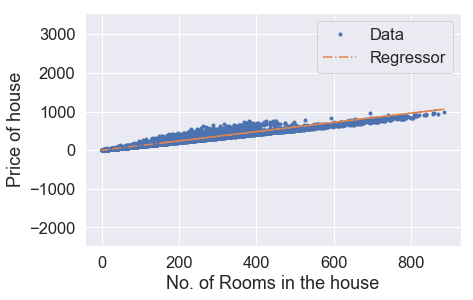

Iteration: 921,Cost = 943.3157716748195,theta = [0.05669746 1.19860625]
Iteration: 921,Cost_val = 947.5754796736184,theta = [0.05669746 1.19860625]


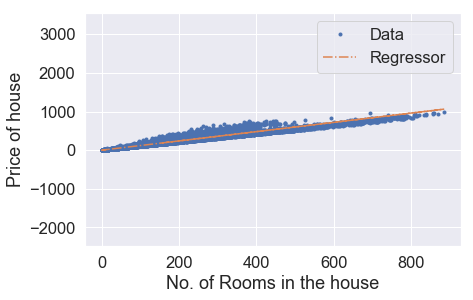

Iteration: 931,Cost = 943.3131142627149,theta = [0.05721296 1.19860456]
Iteration: 931,Cost_val = 947.5728683427498,theta = [0.05721296 1.19860456]


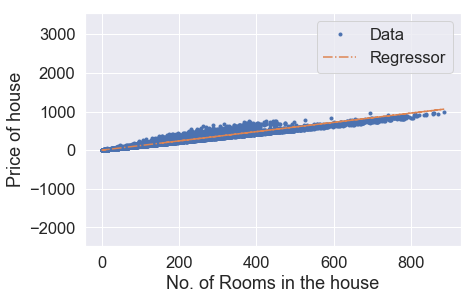

Iteration: 941,Cost = 943.3104571130401,theta = [0.05772843 1.19860287]
Iteration: 941,Cost_val = 947.5702572692851,theta = [0.05772843 1.19860287]


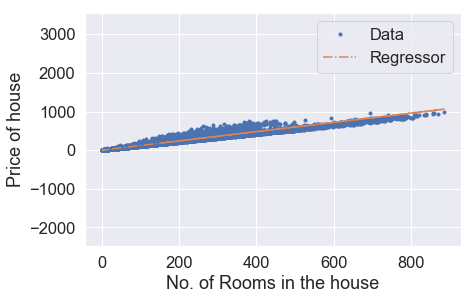

Iteration: 951,Cost = 943.3078002257333,theta = [0.05824388 1.19860118]
Iteration: 951,Cost_val = 947.5676464532074,theta = [0.05824388 1.19860118]


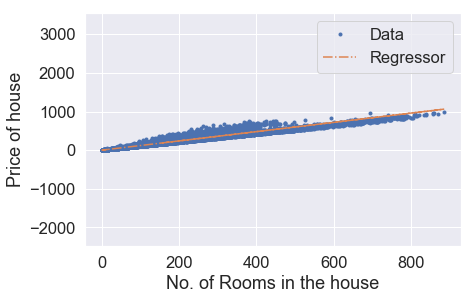

Iteration: 961,Cost = 943.3051436007868,theta = [0.0587593  1.19859949]
Iteration: 961,Cost_val = 947.5650358944773,theta = [0.0587593  1.19859949]


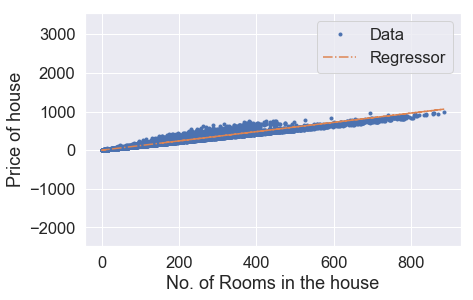

Iteration: 971,Cost = 943.3024872381654,theta = [0.0592747 1.1985978]
Iteration: 971,Cost_val = 947.5624255930758,theta = [0.0592747 1.1985978]


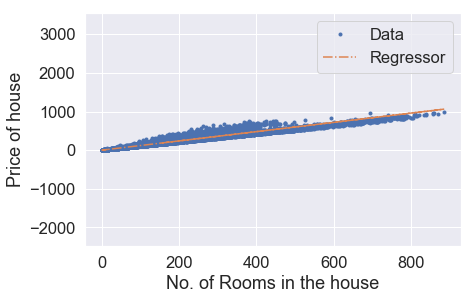

Iteration: 981,Cost = 943.2998311378556,theta = [0.05979007 1.19859611]
Iteration: 981,Cost_val = 947.5598155489822,theta = [0.05979007 1.19859611]


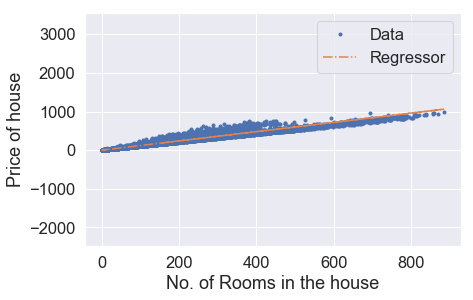

Iteration: 991,Cost = 943.297175299823,theta = [0.06030542 1.19859442]
Iteration: 991,Cost_val = 947.5572057621631,theta = [0.06030542 1.19859442]


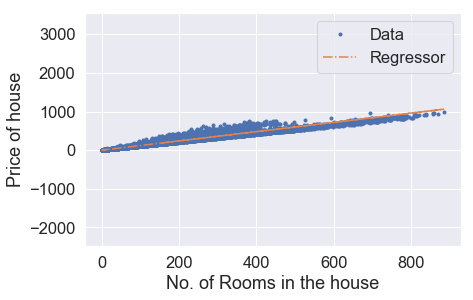

Iteration: 1001,Cost = 943.2945197240377,theta = [0.06082074 1.19859273]
Iteration: 1001,Cost_val = 947.5545962326012,theta = [0.06082074 1.19859273]


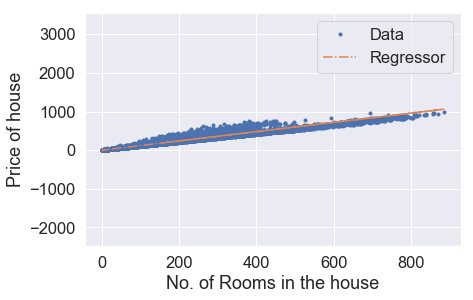

Iteration: 1011,Cost = 943.2918644104839,theta = [0.06133604 1.19859104]
Iteration: 1011,Cost_val = 947.5519869602653,theta = [0.06133604 1.19859104]


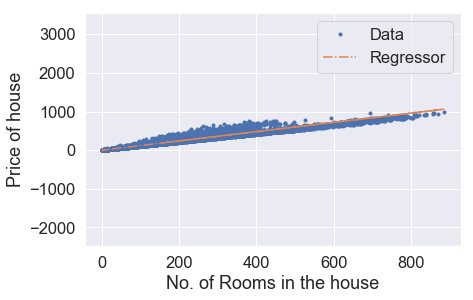

Iteration: 1021,Cost = 943.28920935913,theta = [0.0618513  1.19858935]
Iteration: 1021,Cost_val = 947.5493779451315,theta = [0.0618513  1.19858935]


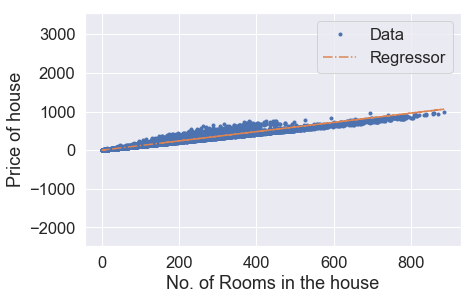

Iteration: 1031,Cost = 943.2865545699448,theta = [0.06236655 1.19858766]
Iteration: 1031,Cost_val = 947.5467691871738,theta = [0.06236655 1.19858766]


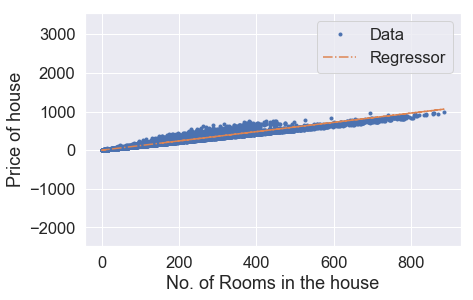

Iteration: 1041,Cost = 943.2839000429193,theta = [0.06288177 1.19858597]
Iteration: 1041,Cost_val = 947.54416068637,theta = [0.06288177 1.19858597]


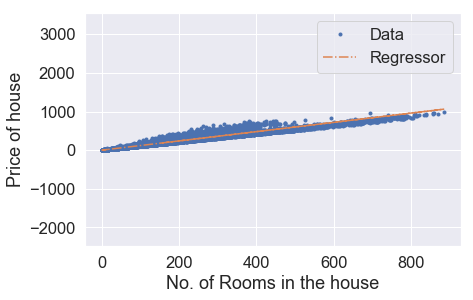

Iteration: 1051,Cost = 943.2812457780107,theta = [0.06339696 1.19858428]
Iteration: 1051,Cost_val = 947.5415524426911,theta = [0.06339696 1.19858428]


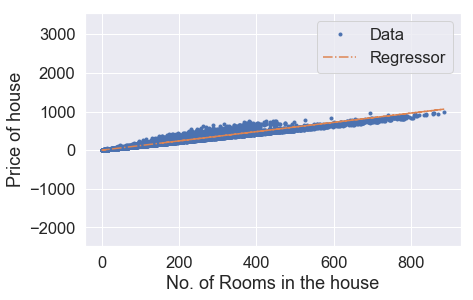

Iteration: 1061,Cost = 943.2785917752005,theta = [0.06391213 1.19858259]
Iteration: 1061,Cost_val = 947.5389444561147,theta = [0.06391213 1.19858259]


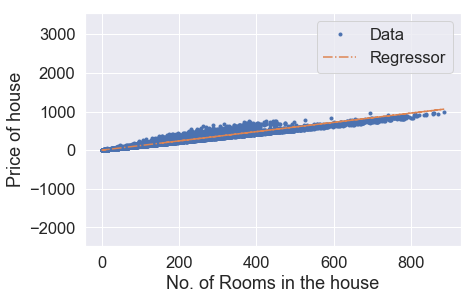

Iteration: 1071,Cost = 943.2759380344555,theta = [0.06442727 1.1985809 ]
Iteration: 1071,Cost_val = 947.5363367266159,theta = [0.06442727 1.1985809 ]


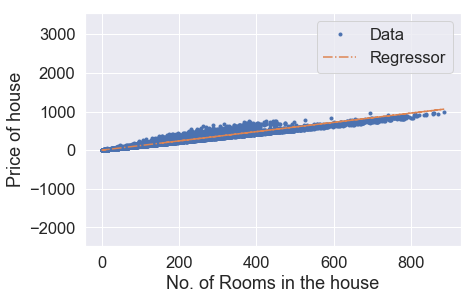

Iteration: 1081,Cost = 943.2732845557572,theta = [0.06494239 1.19857921]
Iteration: 1081,Cost_val = 947.533729254163,theta = [0.06494239 1.19857921]


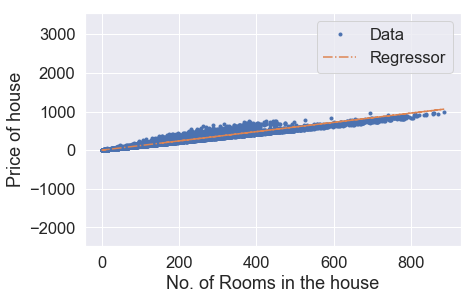

Iteration: 1091,Cost = 943.2706313390843,theta = [0.06545748 1.19857752]
Iteration: 1091,Cost_val = 947.531122038734,theta = [0.06545748 1.19857752]


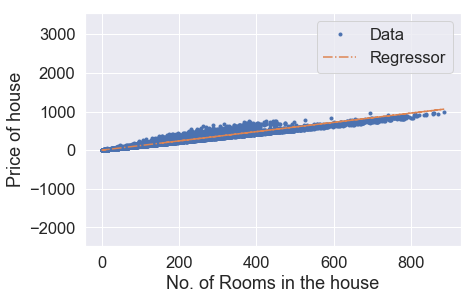

Iteration: 1101,Cost = 943.2679783844073,theta = [0.06597255 1.19857583]
Iteration: 1101,Cost_val = 947.5285150803112,theta = [0.06597255 1.19857583]


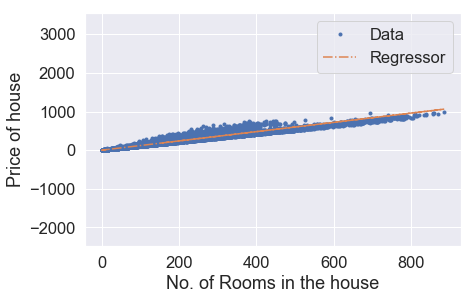

Iteration: 1111,Cost = 943.2653256917054,theta = [0.06648759 1.19857414]
Iteration: 1111,Cost_val = 947.525908378858,theta = [0.06648759 1.19857414]


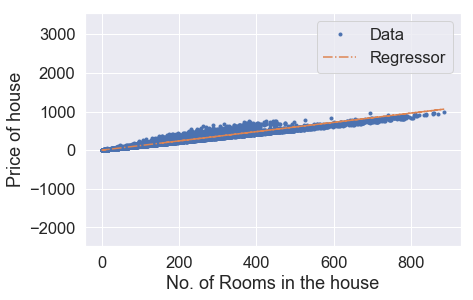

Iteration: 1121,Cost = 943.262673260928,theta = [0.0670026  1.19857246]
Iteration: 1121,Cost_val = 947.5233019343556,theta = [0.0670026  1.19857246]


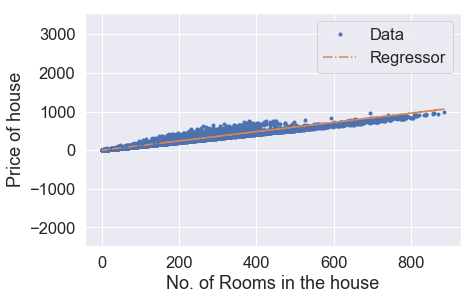

Iteration: 1131,Cost = 943.2600210920657,theta = [0.06751759 1.19857077]
Iteration: 1131,Cost_val = 947.5206957467793,theta = [0.06751759 1.19857077]


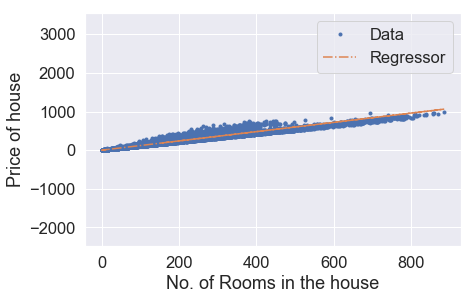

Iteration: 1141,Cost = 943.2573691851047,theta = [0.06803256 1.19856908]
Iteration: 1141,Cost_val = 947.5180898160932,theta = [0.06803256 1.19856908]


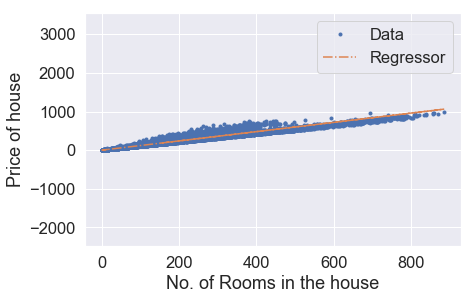

Iteration: 1151,Cost = 943.2547175399976,theta = [0.0685475  1.19856739]
Iteration: 1151,Cost_val = 947.5154841422843,theta = [0.0685475  1.19856739]


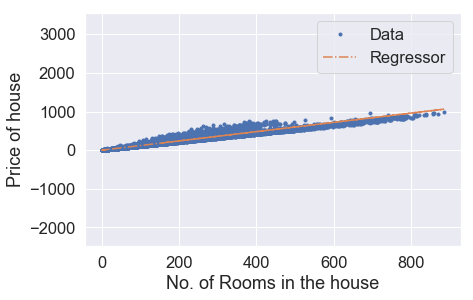

Iteration: 1161,Cost = 943.2520661567363,theta = [0.06906241 1.1985657 ]
Iteration: 1161,Cost_val = 947.5128787253233,theta = [0.06906241 1.1985657 ]


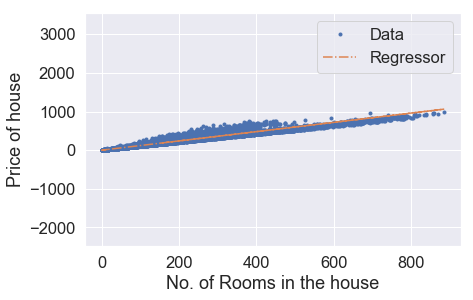

Iteration: 1171,Cost = 943.2494150352844,theta = [0.0695773  1.19856401]
Iteration: 1171,Cost_val = 947.5102735651831,theta = [0.0695773  1.19856401]


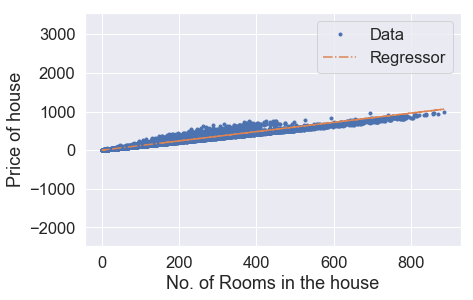

Iteration: 1181,Cost = 943.2467641756191,theta = [0.07009216 1.19856232]
Iteration: 1181,Cost_val = 947.5076686618429,theta = [0.07009216 1.19856232]


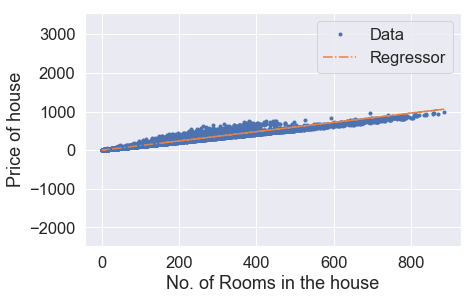

Iteration: 1191,Cost = 943.2441135777157,theta = [0.070607   1.19856064]
Iteration: 1191,Cost_val = 947.5050640152689,theta = [0.070607   1.19856064]


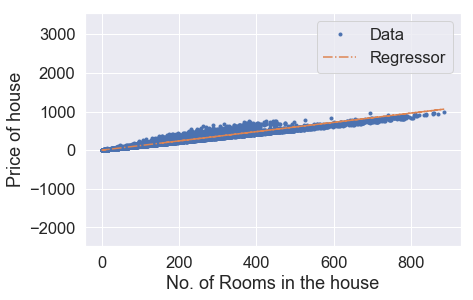

Iteration: 1201,Cost = 943.2414632415437,theta = [0.07112181 1.19855895]
Iteration: 1201,Cost_val = 947.5024596254431,theta = [0.07112181 1.19855895]


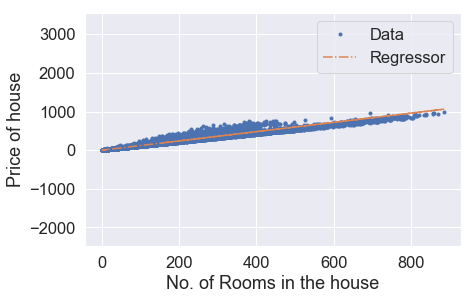

Iteration: 1211,Cost = 943.2388131670875,theta = [0.0716366  1.19855726]
Iteration: 1211,Cost_val = 947.4998554923388,theta = [0.0716366  1.19855726]


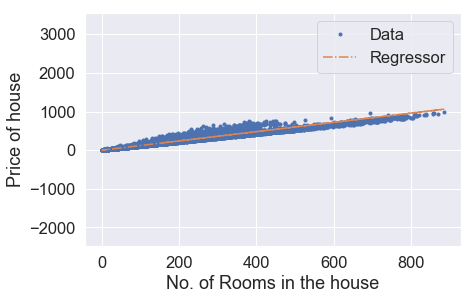

Iteration: 1221,Cost = 943.236163354313,theta = [0.07215136 1.19855557]
Iteration: 1221,Cost_val = 947.4972516159294,theta = [0.07215136 1.19855557]


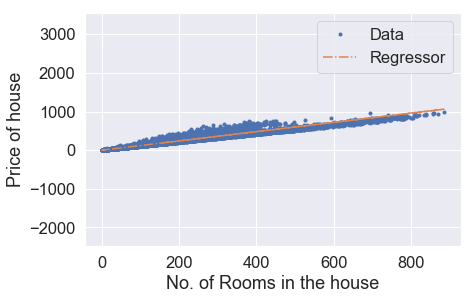

Iteration: 1231,Cost = 943.233513803206,theta = [0.0726661  1.19855388]
Iteration: 1231,Cost_val = 947.4946479961907,theta = [0.0726661  1.19855388]


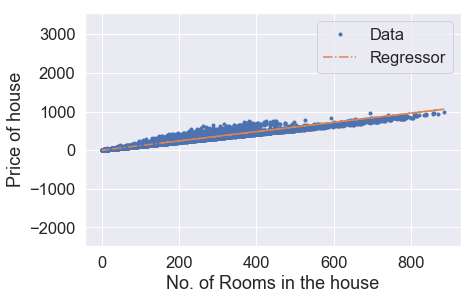

Iteration: 1241,Cost = 943.2308645137165,theta = [0.07318081 1.1985522 ]
Iteration: 1241,Cost_val = 947.4920446330965,theta = [0.07318081 1.1985522 ]


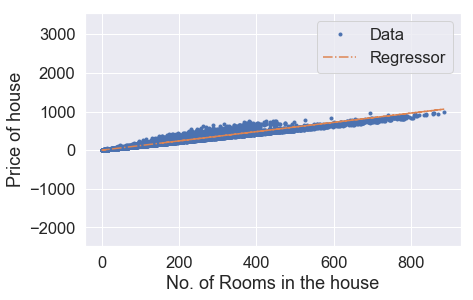

Iteration: 1251,Cost = 943.2282154858327,theta = [0.07369549 1.19855051]
Iteration: 1251,Cost_val = 947.4894415266203,theta = [0.07369549 1.19855051]


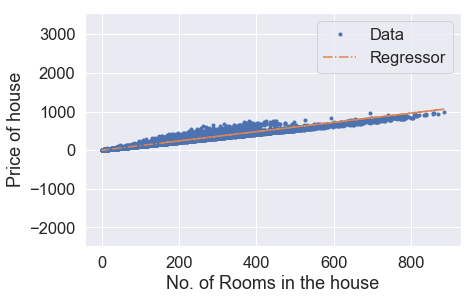

Iteration: 1261,Cost = 943.2255667195342,theta = [0.07421015 1.19854882]
Iteration: 1261,Cost_val = 947.4868386767408,theta = [0.07421015 1.19854882]


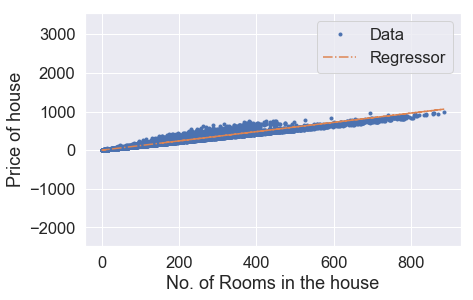

Iteration: 1271,Cost = 943.2229182147869,theta = [0.07472478 1.19854713]
Iteration: 1271,Cost_val = 947.4842360834294,theta = [0.07472478 1.19854713]


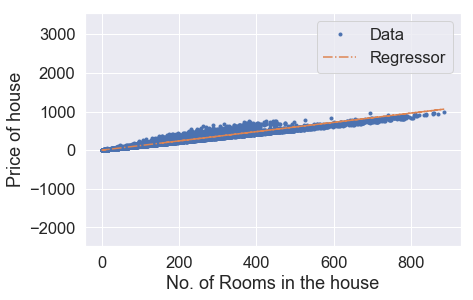

Iteration: 1281,Cost = 943.2202699715721,theta = [0.07523939 1.19854545]
Iteration: 1281,Cost_val = 947.4816337466622,theta = [0.07523939 1.19854545]


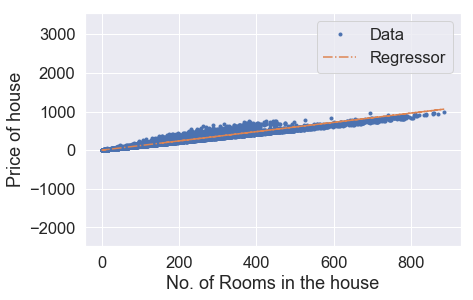

Iteration: 1291,Cost = 943.217621989851,theta = [0.07575398 1.19854376]
Iteration: 1291,Cost_val = 947.4790316664117,theta = [0.07575398 1.19854376]


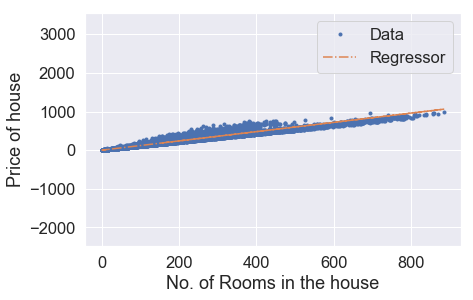

Iteration: 1301,Cost = 943.2149742696164,theta = [0.07626853 1.19854207]
Iteration: 1301,Cost_val = 947.4764298426571,theta = [0.07626853 1.19854207]


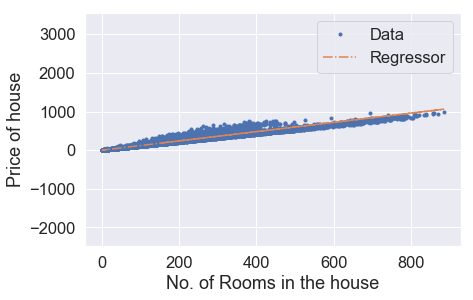

Iteration: 1311,Cost = 943.2123268108203,theta = [0.07678307 1.19854039]
Iteration: 1311,Cost_val = 947.4738282753665,theta = [0.07678307 1.19854039]


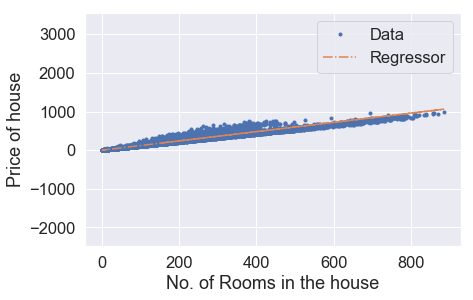

Iteration: 1321,Cost = 943.2096796134573,theta = [0.07729757 1.1985387 ]
Iteration: 1321,Cost_val = 947.4712269645188,theta = [0.07729757 1.1985387 ]


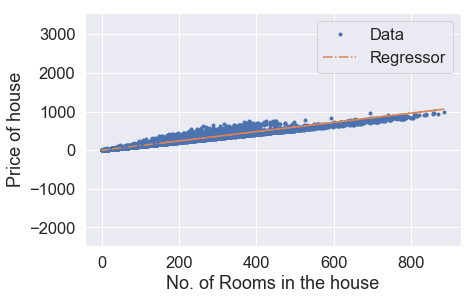

Iteration: 1331,Cost = 943.2070326774999,theta = [0.07781206 1.19853701]
Iteration: 1331,Cost_val = 947.46862591009,theta = [0.07781206 1.19853701]


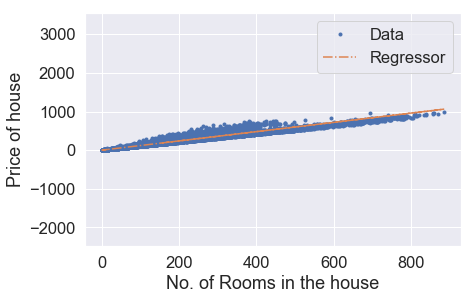

Iteration: 1341,Cost = 943.2043860029138,theta = [0.07832651 1.19853532]
Iteration: 1341,Cost_val = 947.4660251120483,theta = [0.07832651 1.19853532]


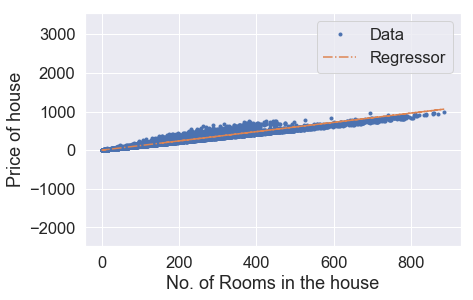

Iteration: 1351,Cost = 943.201739589666,theta = [0.07884094 1.19853364]
Iteration: 1351,Cost_val = 947.4634245703793,theta = [0.07884094 1.19853364]


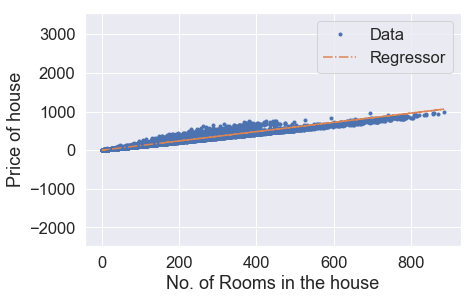

Iteration: 1361,Cost = 943.1990934377451,theta = [0.07935535 1.19853195]
Iteration: 1361,Cost_val = 947.460824285046,theta = [0.07935535 1.19853195]


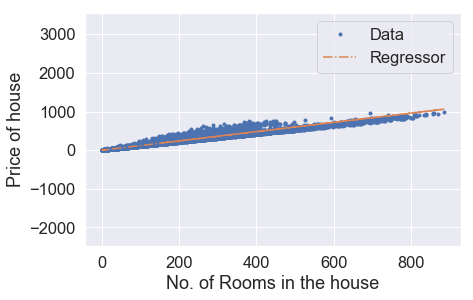

Iteration: 1371,Cost = 943.1964475471311,theta = [0.07986973 1.19853026]
Iteration: 1371,Cost_val = 947.4582242560335,theta = [0.07986973 1.19853026]


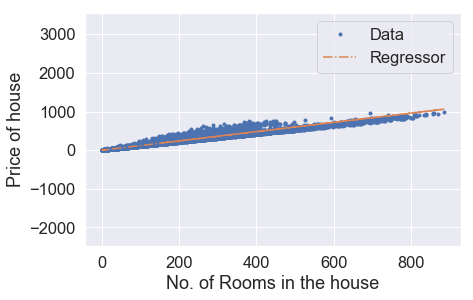

Iteration: 1381,Cost = 943.1938019177701,theta = [0.08038408 1.19852858]
Iteration: 1381,Cost_val = 947.4556244833079,theta = [0.08038408 1.19852858]


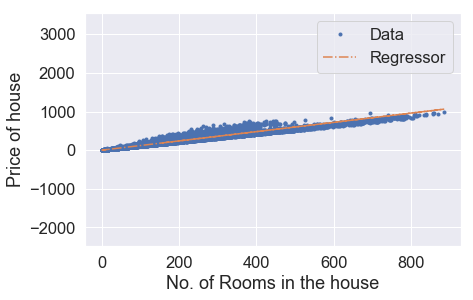

Iteration: 1391,Cost = 943.1911565496533,theta = [0.08089841 1.19852689]
Iteration: 1391,Cost_val = 947.4530249668454,theta = [0.08089841 1.19852689]


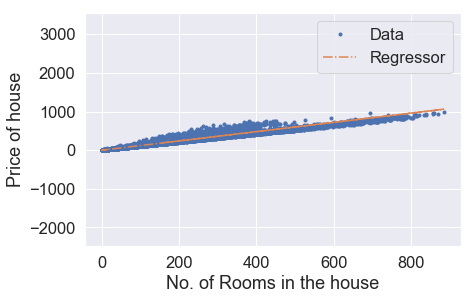

Iteration: 1401,Cost = 943.18851144277,theta = [0.08141272 1.1985252 ]
Iteration: 1401,Cost_val = 947.4504257066307,theta = [0.08141272 1.1985252 ]


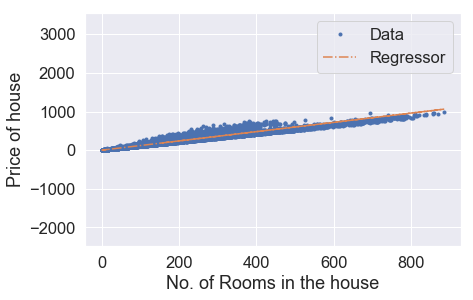

Iteration: 1411,Cost = 943.1858665970802,theta = [0.08192699 1.19852352]
Iteration: 1411,Cost_val = 947.4478267026246,theta = [0.08192699 1.19852352]


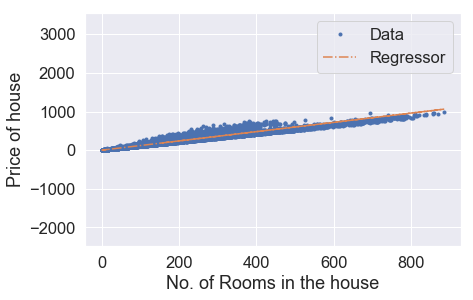

Iteration: 1421,Cost = 943.1832220125383,theta = [0.08244125 1.19852183]
Iteration: 1421,Cost_val = 947.4452279548121,theta = [0.08244125 1.19852183]


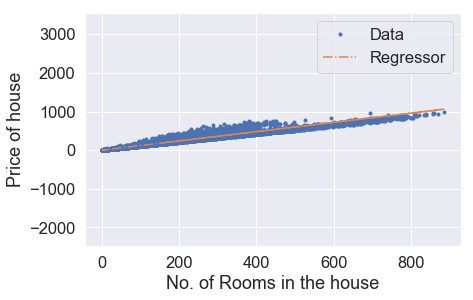

Iteration: 1431,Cost = 943.1805776891485,theta = [0.08295548 1.19852015]
Iteration: 1431,Cost_val = 947.4426294631577,theta = [0.08295548 1.19852015]


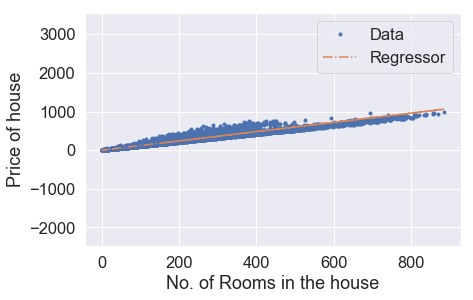

Iteration: 1441,Cost = 943.177933626869,theta = [0.08346968 1.19851846]
Iteration: 1441,Cost_val = 947.440031227644,theta = [0.08346968 1.19851846]


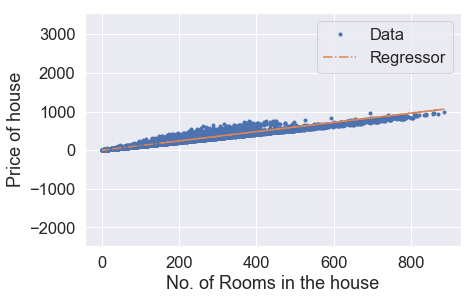

Iteration: 1451,Cost = 943.1752898256868,theta = [0.08398385 1.19851677]
Iteration: 1451,Cost_val = 947.4374332482474,theta = [0.08398385 1.19851677]


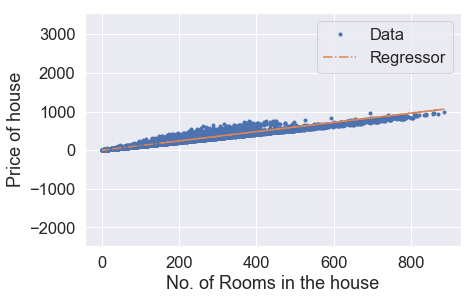

Iteration: 1461,Cost = 943.1726462855639,theta = [0.08449801 1.19851509]
Iteration: 1461,Cost_val = 947.4348355249382,theta = [0.08449801 1.19851509]


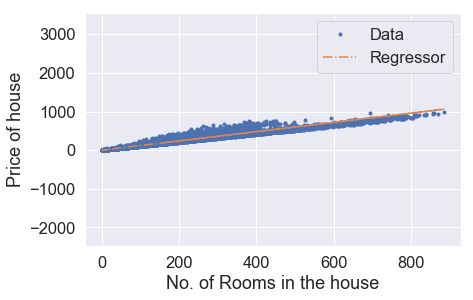

Iteration: 1471,Cost = 943.170003006483,theta = [0.08501213 1.1985134 ]
Iteration: 1471,Cost_val = 947.4322380576906,theta = [0.08501213 1.1985134 ]


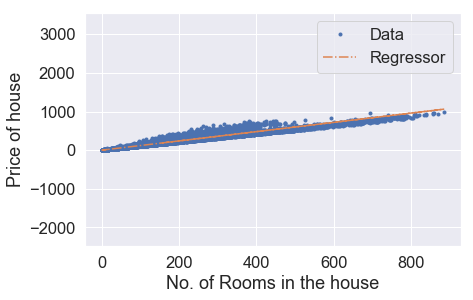

Iteration: 1481,Cost = 943.1673599884141,theta = [0.08552623 1.19851172]
Iteration: 1481,Cost_val = 947.4296408464805,theta = [0.08552623 1.19851172]


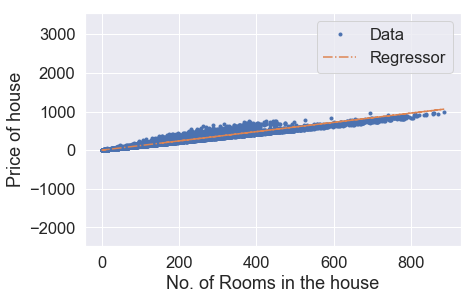

Iteration: 1491,Cost = 943.1647172313352,theta = [0.08604031 1.19851003]
Iteration: 1491,Cost_val = 947.4270438912865,theta = [0.08604031 1.19851003]


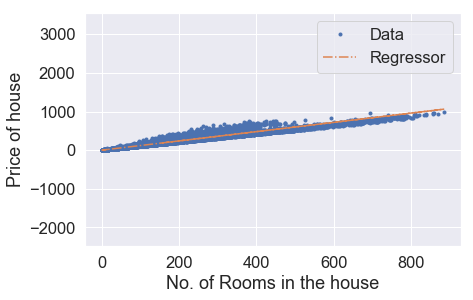

Iteration: 1501,Cost = 943.1620747352101,theta = [0.08655436 1.19850834]
Iteration: 1501,Cost_val = 947.424447192076,theta = [0.08655436 1.19850834]


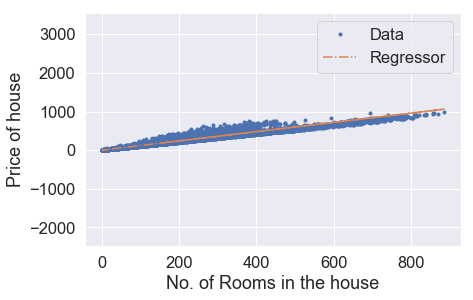

Iteration: 1511,Cost = 943.1594325000246,theta = [0.08706838 1.19850666]
Iteration: 1511,Cost_val = 947.4218507488265,theta = [0.08706838 1.19850666]


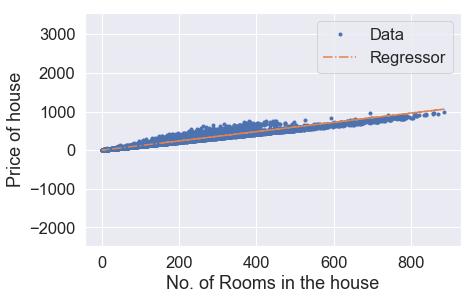

Iteration: 1521,Cost = 943.1567905257434,theta = [0.08758238 1.19850497]
Iteration: 1521,Cost_val = 947.419254561515,theta = [0.08758238 1.19850497]


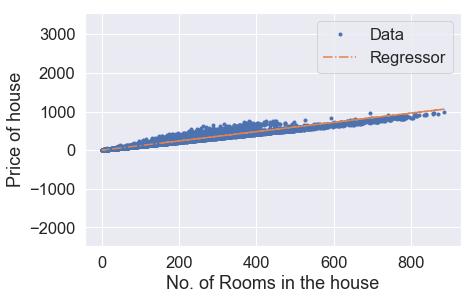

Iteration: 1531,Cost = 943.1541488123474,theta = [0.08809636 1.19850329]
Iteration: 1531,Cost_val = 947.4166586301193,theta = [0.08809636 1.19850329]


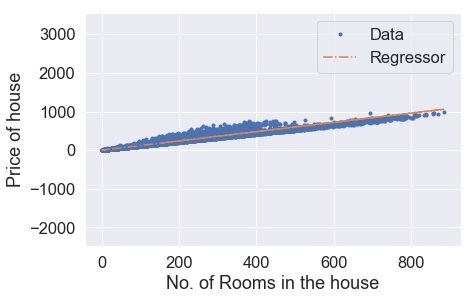

Iteration: 1541,Cost = 943.1515073598059,theta = [0.0886103 1.1985016]
Iteration: 1541,Cost_val = 947.414062954608,theta = [0.0886103 1.1985016]


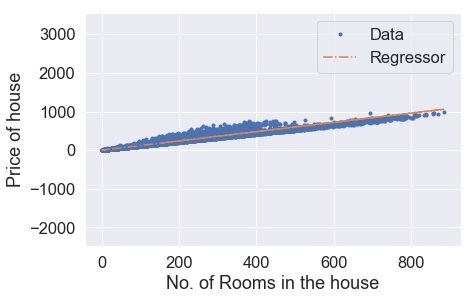

Iteration: 1551,Cost = 943.1488661681024,theta = [0.08912423 1.19849992]
Iteration: 1551,Cost_val = 947.4114675349549,theta = [0.08912423 1.19849992]


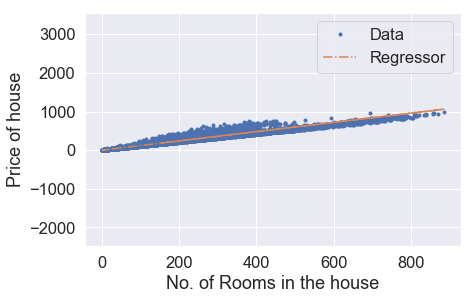

Iteration: 1561,Cost = 943.146225237187,theta = [0.08963813 1.19849823]
Iteration: 1561,Cost_val = 947.4088723711369,theta = [0.08963813 1.19849823]


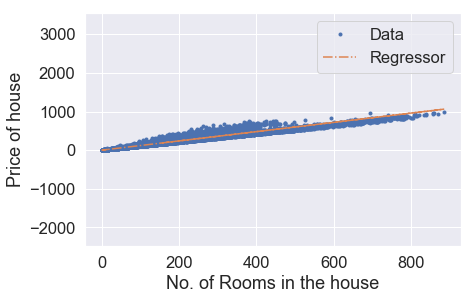

Iteration: 1571,Cost = 943.1435845670825,theta = [0.090152   1.19849655]
Iteration: 1571,Cost_val = 947.406277463133,theta = [0.090152   1.19849655]


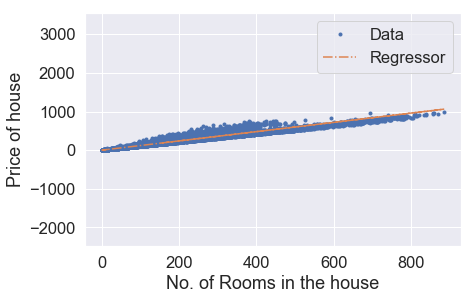

Iteration: 1581,Cost = 943.1409441577208,theta = [0.09066585 1.19849486]
Iteration: 1581,Cost_val = 947.403682810913,theta = [0.09066585 1.19849486]


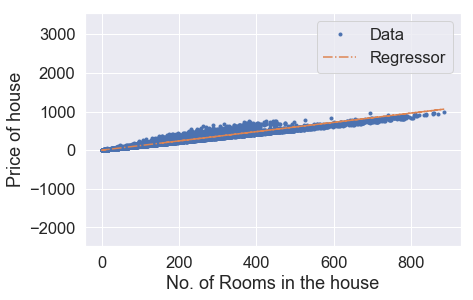

Iteration: 1591,Cost = 943.1383040090811,theta = [0.09117967 1.19849318]
Iteration: 1591,Cost_val = 947.401088414452,theta = [0.09117967 1.19849318]


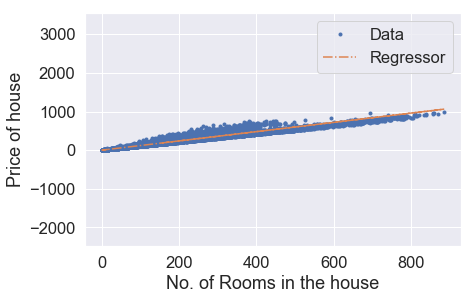

Iteration: 1601,Cost = 943.1356641211537,theta = [0.09169346 1.19849149]
Iteration: 1601,Cost_val = 947.3984942737261,theta = [0.09169346 1.19849149]


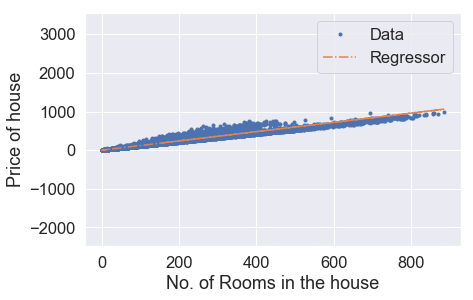

Iteration: 1611,Cost = 943.1330244938877,theta = [0.09220723 1.19848981]
Iteration: 1611,Cost_val = 947.3959003887111,theta = [0.09220723 1.19848981]


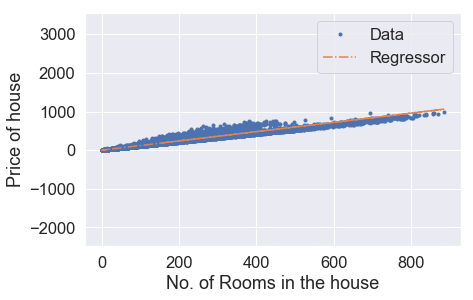

Iteration: 1621,Cost = 943.1303851272891,theta = [0.09272098 1.19848812]
Iteration: 1621,Cost_val = 947.393306759378,theta = [0.09272098 1.19848812]


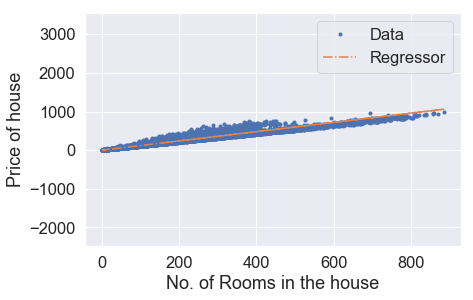

Iteration: 1631,Cost = 943.1277460213244,theta = [0.0932347  1.19848644]
Iteration: 1631,Cost_val = 947.3907133857065,theta = [0.0932347  1.19848644]


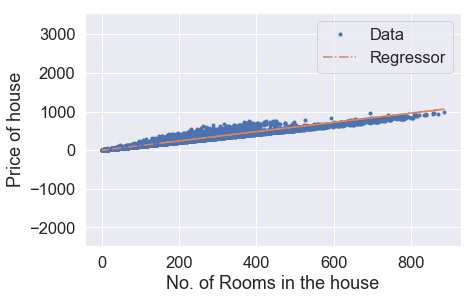

Iteration: 1641,Cost = 943.1251071759248,theta = [0.09374839 1.19848476]
Iteration: 1641,Cost_val = 947.388120267672,theta = [0.09374839 1.19848476]


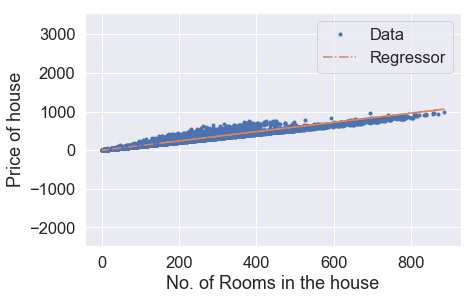

Iteration: 1651,Cost = 943.1224685911353,theta = [0.09426206 1.19848307]
Iteration: 1651,Cost_val = 947.3855274052413,theta = [0.09426206 1.19848307]


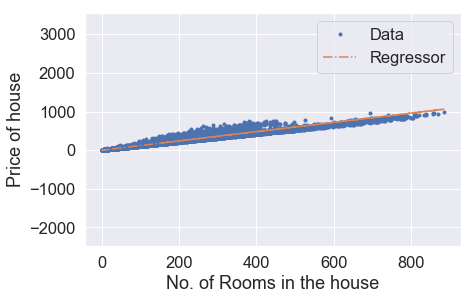

Iteration: 1661,Cost = 943.1198302668854,theta = [0.09477571 1.19848139]
Iteration: 1661,Cost_val = 947.3829347983924,theta = [0.09477571 1.19848139]


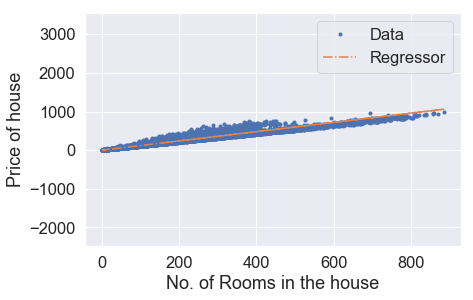

Iteration: 1671,Cost = 943.1171922031535,theta = [0.09528933 1.1984797 ]
Iteration: 1671,Cost_val = 947.3803424471068,theta = [0.09528933 1.1984797 ]


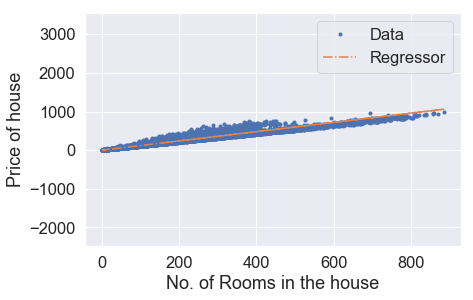

Iteration: 1681,Cost = 943.1145543999203,theta = [0.09580292 1.19847802]
Iteration: 1681,Cost_val = 947.3777503513508,theta = [0.09580292 1.19847802]


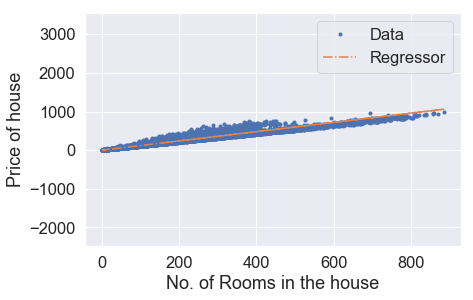

Iteration: 1691,Cost = 943.1119168571536,theta = [0.09631649 1.19847633]
Iteration: 1691,Cost_val = 947.3751585111039,theta = [0.09631649 1.19847633]


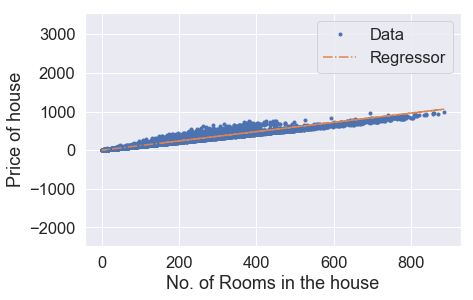

Iteration: 1701,Cost = 943.1092795748511,theta = [0.09683003 1.19847465]
Iteration: 1701,Cost_val = 947.3725669263401,theta = [0.09683003 1.19847465]


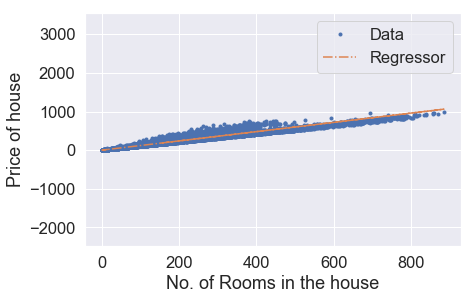

Iteration: 1711,Cost = 943.1066425529546,theta = [0.09734355 1.19847297]
Iteration: 1711,Cost_val = 947.3699755970318,theta = [0.09734355 1.19847297]


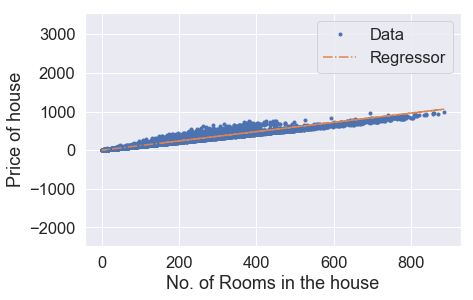

Iteration: 1721,Cost = 943.1040057914447,theta = [0.09785704 1.19847128]
Iteration: 1721,Cost_val = 947.3673845231572,theta = [0.09785704 1.19847128]


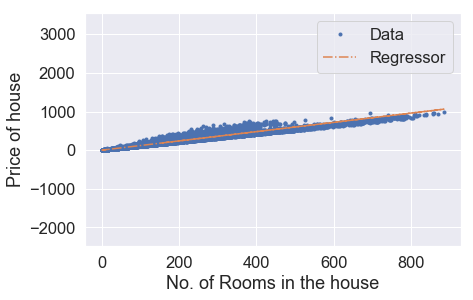

Iteration: 1731,Cost = 943.1013692903136,theta = [0.09837051 1.1984696 ]
Iteration: 1731,Cost_val = 947.3647937046895,theta = [0.09837051 1.1984696 ]


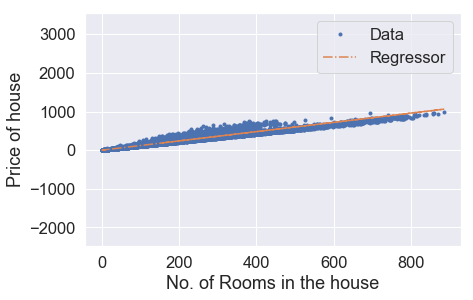

Iteration: 1741,Cost = 943.0987330495245,theta = [0.09888395 1.19846792]
Iteration: 1741,Cost_val = 947.3622031416054,theta = [0.09888395 1.19846792]


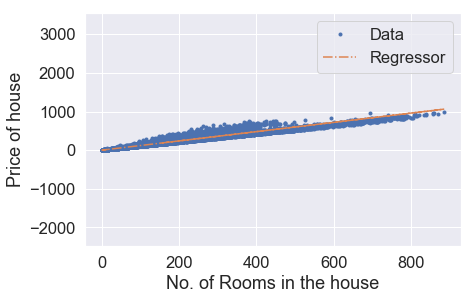

Iteration: 1751,Cost = 943.0960970690609,theta = [0.09939736 1.19846623]
Iteration: 1751,Cost_val = 947.359612833876,theta = [0.09939736 1.19846623]


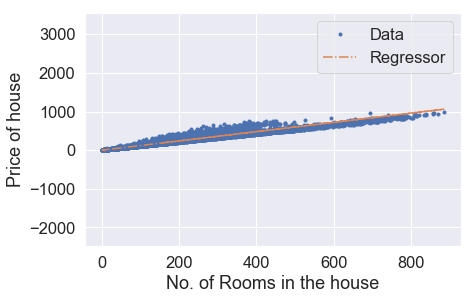

Iteration: 1761,Cost = 943.0934613488716,theta = [0.09991075 1.19846455]
Iteration: 1761,Cost_val = 947.3570227814816,theta = [0.09991075 1.19846455]


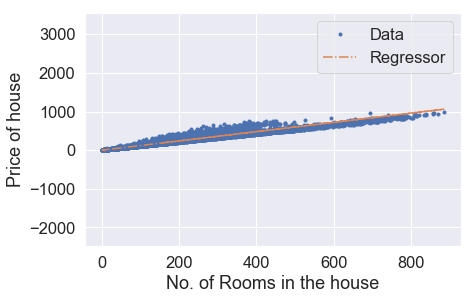

Iteration: 1771,Cost = 943.0908258889541,theta = [0.10042412 1.19846287]
Iteration: 1771,Cost_val = 947.3544329843866,theta = [0.10042412 1.19846287]


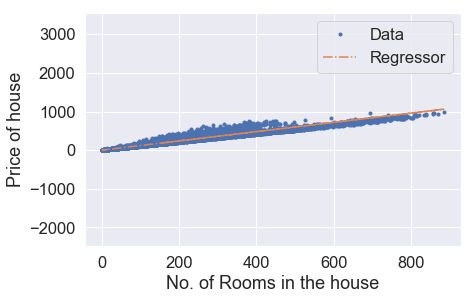

Iteration: 1781,Cost = 943.0881906892848,theta = [0.10093746 1.19846118]
Iteration: 1781,Cost_val = 947.3518434425771,theta = [0.10093746 1.19846118]


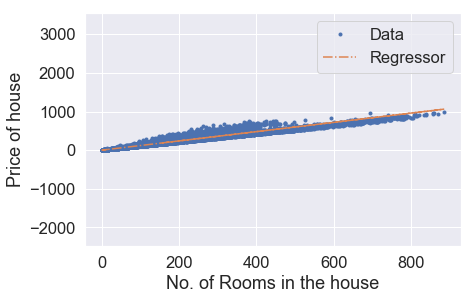

Iteration: 1791,Cost = 943.0855557498201,theta = [0.10145077 1.1984595 ]
Iteration: 1791,Cost_val = 947.3492541560203,theta = [0.10145077 1.1984595 ]


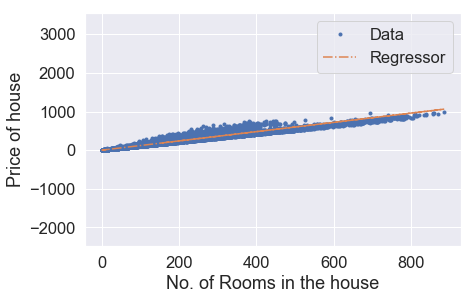

Iteration: 1801,Cost = 943.08292107056,theta = [0.10196406 1.19845782]
Iteration: 1801,Cost_val = 947.3466651246982,theta = [0.10196406 1.19845782]


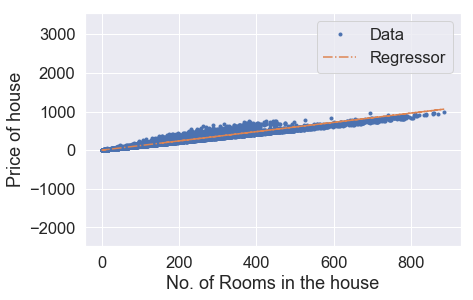

Iteration: 1811,Cost = 943.08028665145,theta = [0.10247733 1.19845613]
Iteration: 1811,Cost_val = 947.34407634858,theta = [0.10247733 1.19845613]


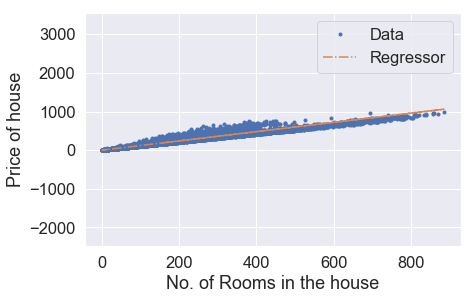

Iteration: 1821,Cost = 943.077652492474,theta = [0.10299056 1.19845445]
Iteration: 1821,Cost_val = 947.3414878276457,theta = [0.10299056 1.19845445]


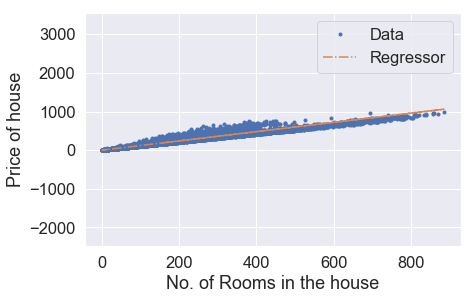

Iteration: 1831,Cost = 943.0750185936201,theta = [0.10350378 1.19845277]
Iteration: 1831,Cost_val = 947.3388995618599,theta = [0.10350378 1.19845277]


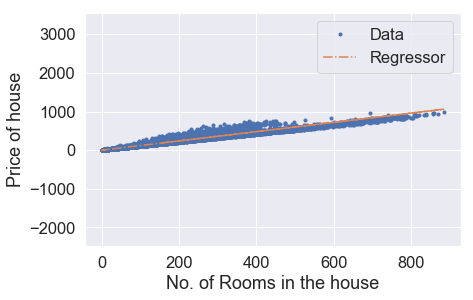

Iteration: 1841,Cost = 943.0723849548432,theta = [0.10401697 1.19845108]
Iteration: 1841,Cost_val = 947.3363115512083,theta = [0.10401697 1.19845108]


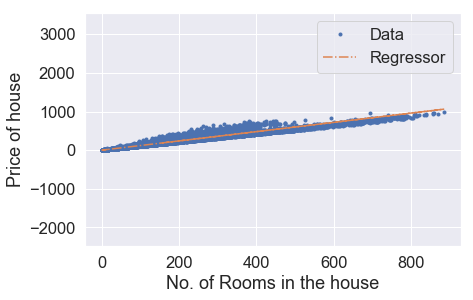

Iteration: 1851,Cost = 943.0697515761291,theta = [0.10453013 1.1984494 ]
Iteration: 1851,Cost_val = 947.333723795658,theta = [0.10453013 1.1984494 ]


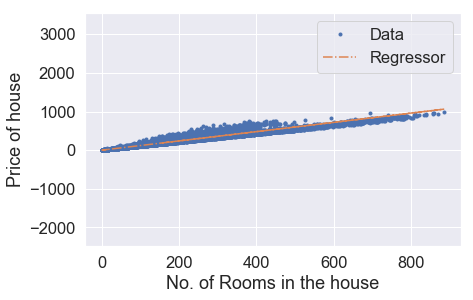

Iteration: 1861,Cost = 943.0671184574626,theta = [0.10504327 1.19844772]
Iteration: 1861,Cost_val = 947.3311362951923,theta = [0.10504327 1.19844772]


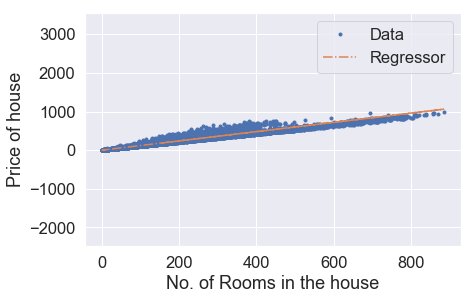

Iteration: 1871,Cost = 943.0644855987828,theta = [0.10555638 1.19844604]
Iteration: 1871,Cost_val = 947.3285490497802,theta = [0.10555638 1.19844604]


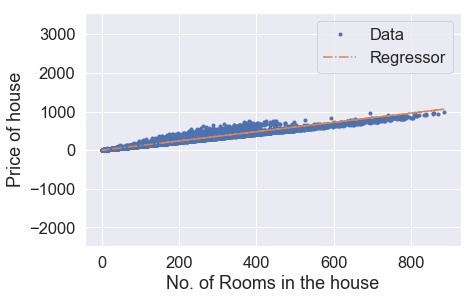

Iteration: 1881,Cost = 943.0618530000943,theta = [0.10606946 1.19844435]
Iteration: 1881,Cost_val = 947.3259620593924,theta = [0.10606946 1.19844435]


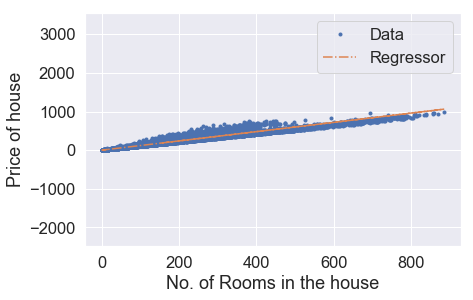

Iteration: 1891,Cost = 943.0592206613755,theta = [0.10658252 1.19844267]
Iteration: 1891,Cost_val = 947.323375324014,theta = [0.10658252 1.19844267]


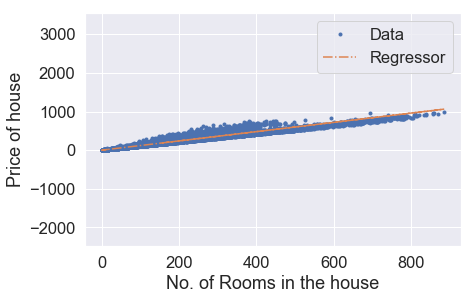

Iteration: 1901,Cost = 943.0565885825837,theta = [0.10709556 1.19844099]
Iteration: 1901,Cost_val = 947.3207888436136,theta = [0.10709556 1.19844099]


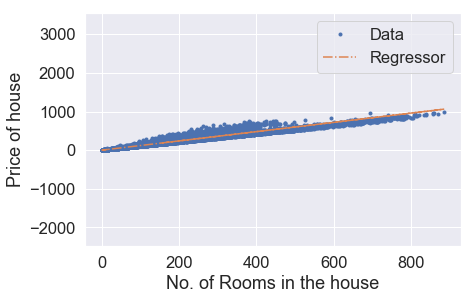

Iteration: 1911,Cost = 943.0539567636818,theta = [0.10760857 1.19843931]
Iteration: 1911,Cost_val = 947.318202618167,theta = [0.10760857 1.19843931]


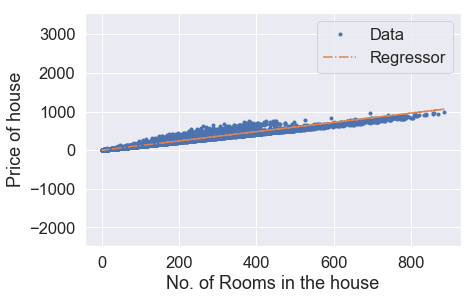

Iteration: 1921,Cost = 943.051325204674,theta = [0.10812156 1.19843762]
Iteration: 1921,Cost_val = 947.3156166476494,theta = [0.10812156 1.19843762]


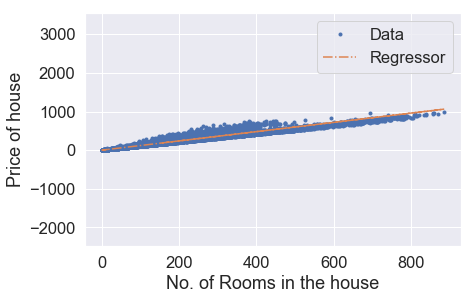

Iteration: 1931,Cost = 943.0486939055338,theta = [0.10863452 1.19843594]
Iteration: 1931,Cost_val = 947.313030932032,theta = [0.10863452 1.19843594]


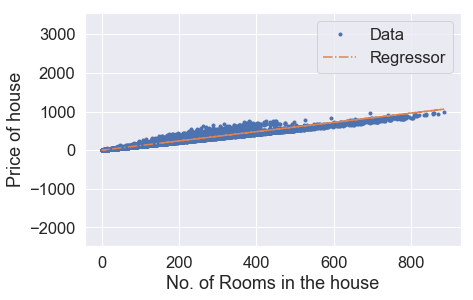

Iteration: 1941,Cost = 943.046062866207,theta = [0.10914745 1.19843426]
Iteration: 1941,Cost_val = 947.310445471295,theta = [0.10914745 1.19843426]


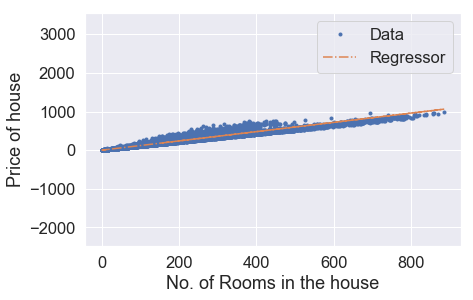

Iteration: 1951,Cost = 943.0434320866827,theta = [0.10966036 1.19843258]
Iteration: 1951,Cost_val = 947.3078602654118,theta = [0.10966036 1.19843258]


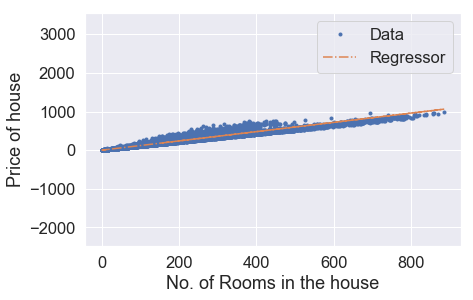

Iteration: 1961,Cost = 943.0408015669433,theta = [0.11017324 1.1984309 ]
Iteration: 1961,Cost_val = 947.3052753143604,theta = [0.11017324 1.1984309 ]


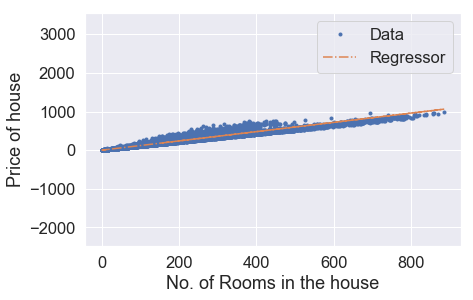

Iteration: 1971,Cost = 943.0381713069572,theta = [0.1106861  1.19842922]
Iteration: 1971,Cost_val = 947.3026906181053,theta = [0.1106861  1.19842922]


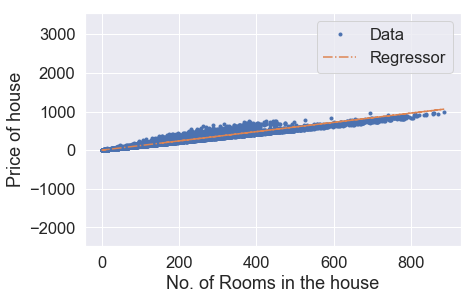

Iteration: 1981,Cost = 943.0355413066911,theta = [0.11119893 1.19842753]
Iteration: 1981,Cost_val = 947.3001061766303,theta = [0.11119893 1.19842753]


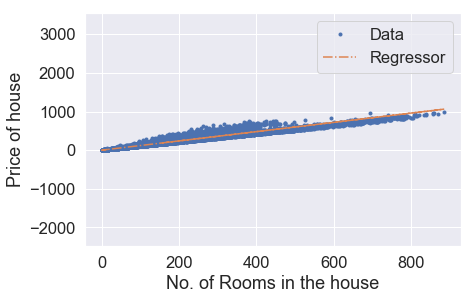

Iteration: 1991,Cost = 943.0329115661292,theta = [0.11171174 1.19842585]
Iteration: 1991,Cost_val = 947.2975219899055,theta = [0.11171174 1.19842585]


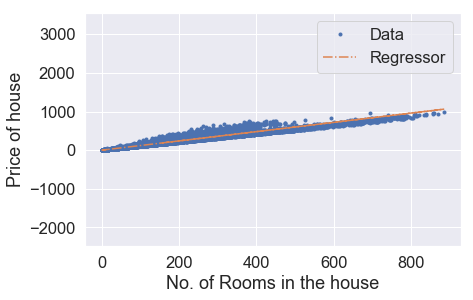

Iteration: 2001,Cost = 943.0302820852468,theta = [0.11222453 1.19842417]
Iteration: 2001,Cost_val = 947.2949380579139,theta = [0.11222453 1.19842417]


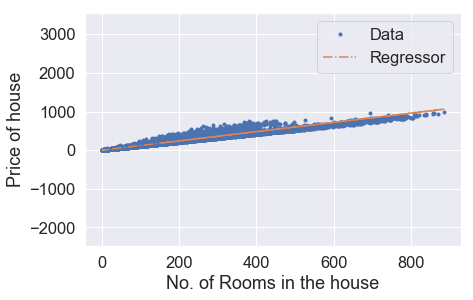

Iteration: 2011,Cost = 943.0276528640056,theta = [0.11273728 1.19842249]
Iteration: 2011,Cost_val = 947.2923543806238,theta = [0.11273728 1.19842249]


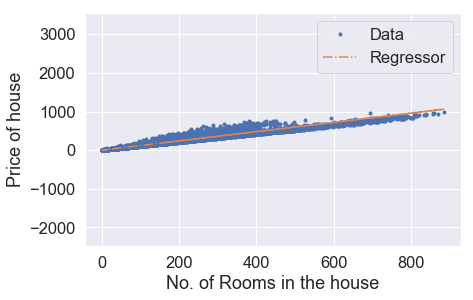

Iteration: 2021,Cost = 943.0250239024093,theta = [0.11325001 1.19842081]
Iteration: 2021,Cost_val = 947.2897709580086,theta = [0.11325001 1.19842081]


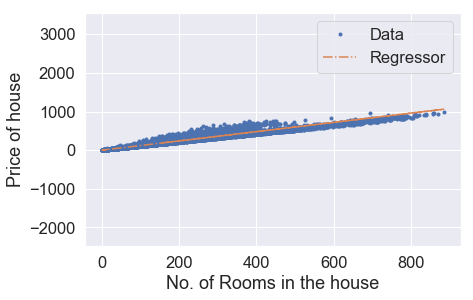

Iteration: 2031,Cost = 943.022395200391,theta = [0.11376272 1.19841913]
Iteration: 2031,Cost_val = 947.2871877900466,theta = [0.11376272 1.19841913]


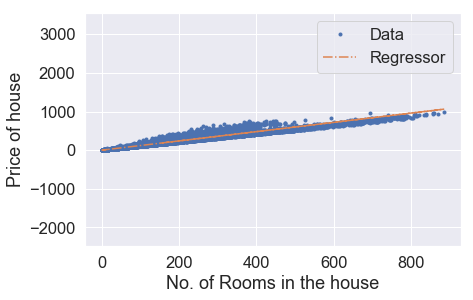

Iteration: 2041,Cost = 943.0197667579499,theta = [0.1142754  1.19841745]
Iteration: 2041,Cost_val = 947.2846048767115,theta = [0.1142754  1.19841745]


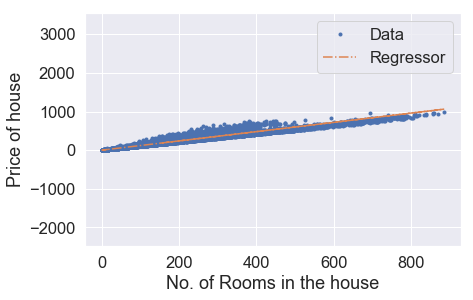

Iteration: 2051,Cost = 943.0171385750479,theta = [0.11478806 1.19841577]
Iteration: 2051,Cost_val = 947.2820222179777,theta = [0.11478806 1.19841577]


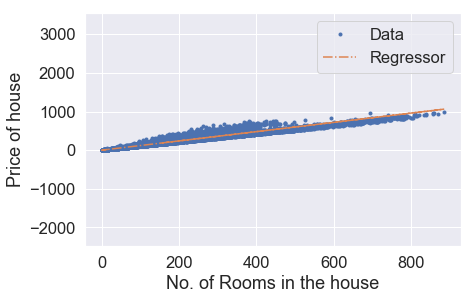

Iteration: 2061,Cost = 943.0145106516752,theta = [0.11530069 1.19841408]
Iteration: 2061,Cost_val = 947.2794398138229,theta = [0.11530069 1.19841408]


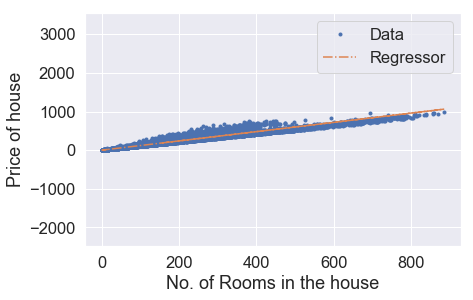

Iteration: 2071,Cost = 943.0118829877947,theta = [0.11581329 1.1984124 ]
Iteration: 2071,Cost_val = 947.2768576642162,theta = [0.11581329 1.1984124 ]


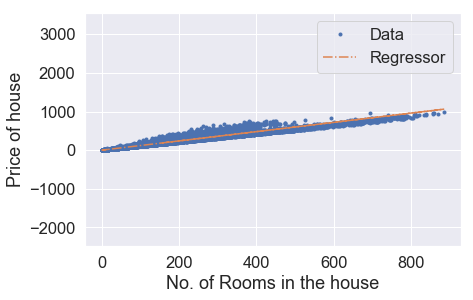

Iteration: 2081,Cost = 943.0092555834016,theta = [0.11632587 1.19841072]
Iteration: 2081,Cost_val = 947.2742757691414,theta = [0.11632587 1.19841072]


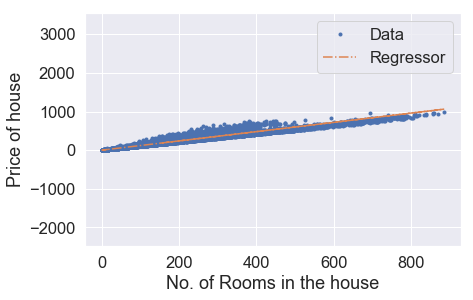

Iteration: 2091,Cost = 943.00662843844,theta = [0.11683843 1.19840904]
Iteration: 2091,Cost_val = 947.2716941285637,theta = [0.11683843 1.19840904]


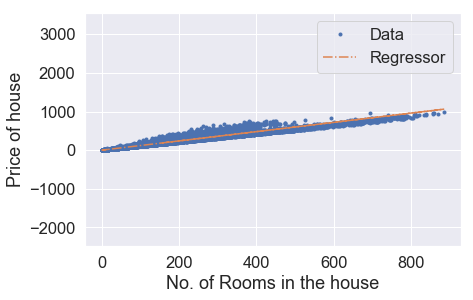

Iteration: 2101,Cost = 943.0040015528994,theta = [0.11735096 1.19840736]
Iteration: 2101,Cost_val = 947.2691127424617,theta = [0.11735096 1.19840736]


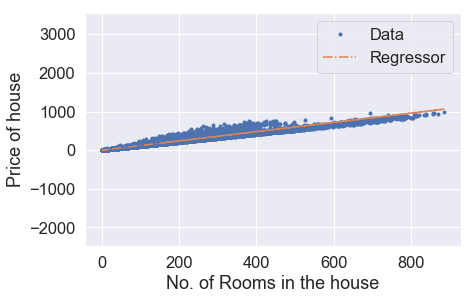

Iteration: 2111,Cost = 943.0013749267431,theta = [0.11786346 1.19840568]
Iteration: 2111,Cost_val = 947.2665316108125,theta = [0.11786346 1.19840568]


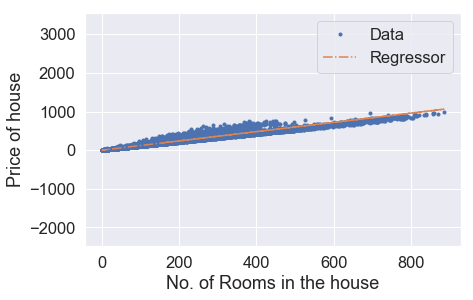

Iteration: 2121,Cost = 942.998748559972,theta = [0.11837594 1.198404  ]
Iteration: 2121,Cost_val = 947.2639507335913,theta = [0.11837594 1.198404  ]


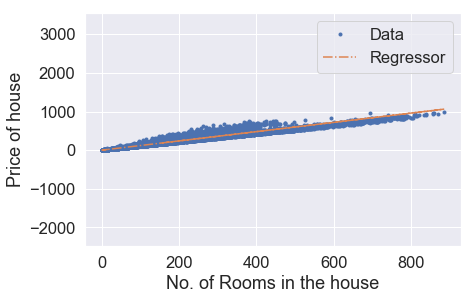

Iteration: 2131,Cost = 942.996122452525,theta = [0.11888839 1.19840232]
Iteration: 2131,Cost_val = 947.2613701107692,theta = [0.11888839 1.19840232]


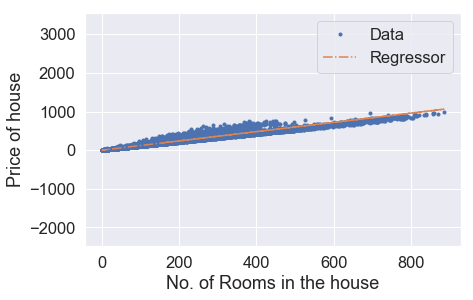

Iteration: 2141,Cost = 942.9934966044108,theta = [0.11940082 1.19840064]
Iteration: 2141,Cost_val = 947.2587897423198,theta = [0.11940082 1.19840064]


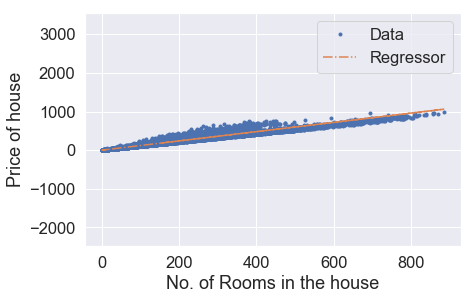

Iteration: 2151,Cost = 942.990871015581,theta = [0.11991323 1.19839896]
Iteration: 2151,Cost_val = 947.2562096282294,theta = [0.11991323 1.19839896]


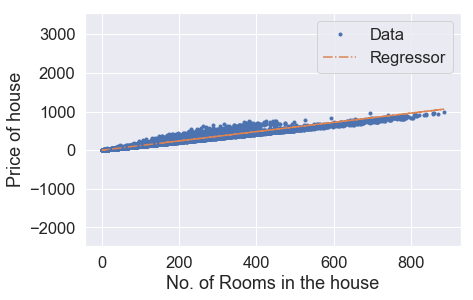

Iteration: 2161,Cost = 942.9882456860174,theta = [0.1204256  1.19839728]
Iteration: 2161,Cost_val = 947.2536297684561,theta = [0.1204256  1.19839728]


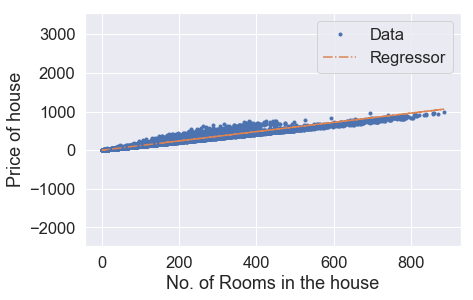

Iteration: 2171,Cost = 942.9856206156927,theta = [0.12093796 1.1983956 ]
Iteration: 2171,Cost_val = 947.2510501629876,theta = [0.12093796 1.1983956 ]


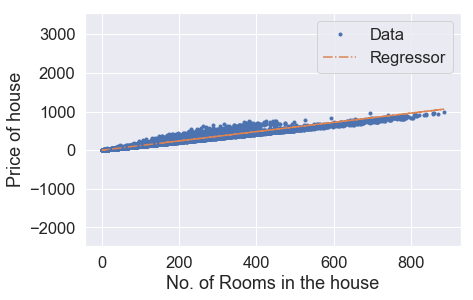

Iteration: 2181,Cost = 942.9829958045882,theta = [0.12145028 1.19839392]
Iteration: 2181,Cost_val = 947.2484708117969,theta = [0.12145028 1.19839392]


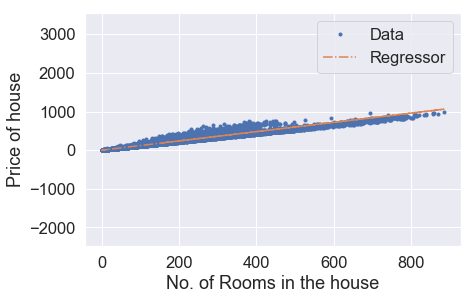

Iteration: 2191,Cost = 942.9803712526538,theta = [0.12196258 1.19839224]
Iteration: 2191,Cost_val = 947.2458917148557,theta = [0.12196258 1.19839224]


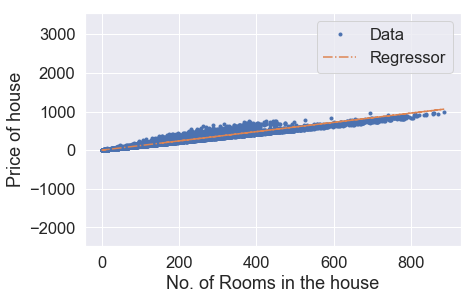

Iteration: 2201,Cost = 942.9777469598939,theta = [0.12247486 1.19839056]
Iteration: 2201,Cost_val = 947.2433128721364,theta = [0.12247486 1.19839056]


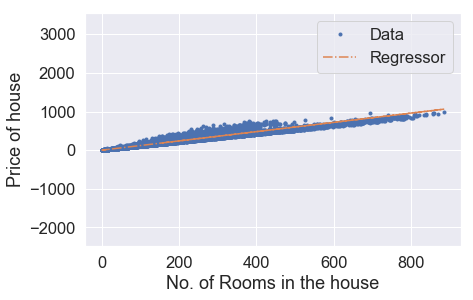

Iteration: 2211,Cost = 942.9751229262831,theta = [0.12298711 1.19838888]
Iteration: 2211,Cost_val = 947.2407342836235,theta = [0.12298711 1.19838888]


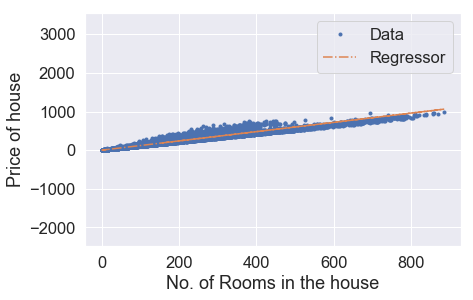

Iteration: 2221,Cost = 942.9724991517736,theta = [0.12349934 1.1983872 ]
Iteration: 2221,Cost_val = 947.2381559492744,theta = [0.12349934 1.1983872 ]


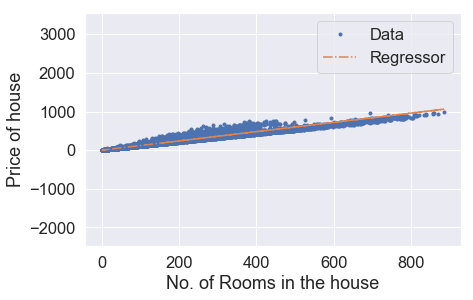

Iteration: 2231,Cost = 942.9698756363512,theta = [0.12401154 1.19838552]
Iteration: 2231,Cost_val = 947.235577869087,theta = [0.12401154 1.19838552]


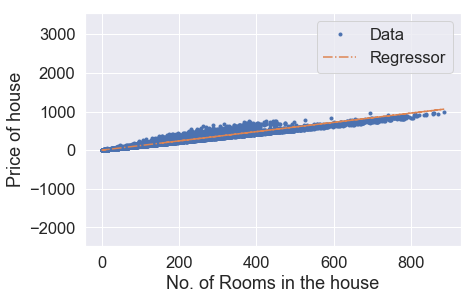

Iteration: 2241,Cost = 942.9672523799837,theta = [0.12452371 1.19838384]
Iteration: 2241,Cost_val = 947.2330000430206,theta = [0.12452371 1.19838384]


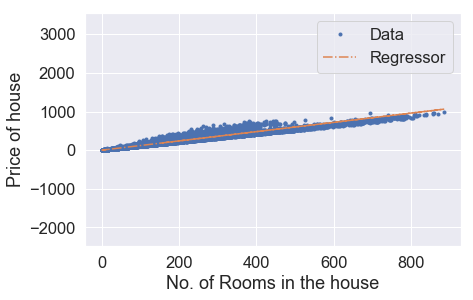

Iteration: 2251,Cost = 942.9646293826601,theta = [0.12503586 1.19838216]
Iteration: 2251,Cost_val = 947.2304224710542,theta = [0.12503586 1.19838216]


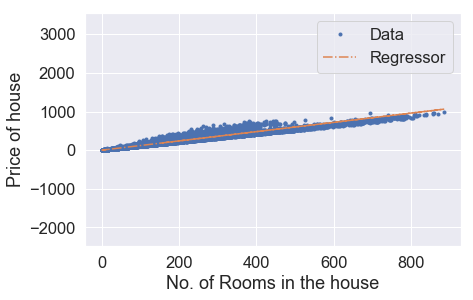

Iteration: 2261,Cost = 942.9620066443489,theta = [0.12554799 1.19838048]
Iteration: 2261,Cost_val = 947.2278451531615,theta = [0.12554799 1.19838048]


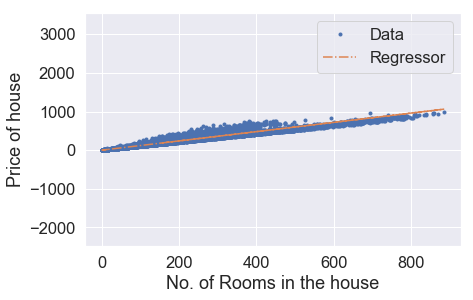

Iteration: 2271,Cost = 942.9593841650066,theta = [0.12606009 1.1983788 ]
Iteration: 2271,Cost_val = 947.2252680893238,theta = [0.12606009 1.1983788 ]


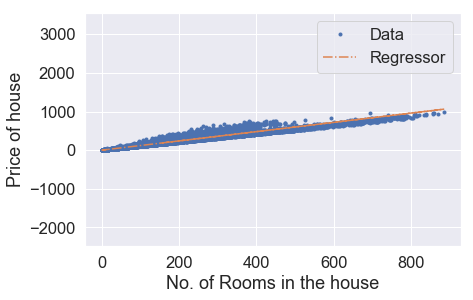

Iteration: 2281,Cost = 942.956761944632,theta = [0.12657216 1.19837712]
Iteration: 2281,Cost_val = 947.2226912795041,theta = [0.12657216 1.19837712]


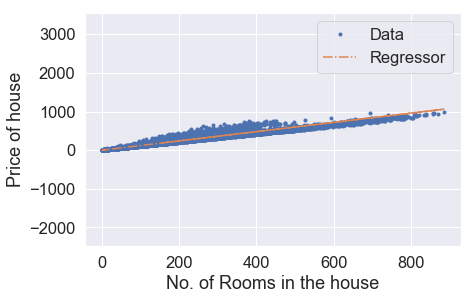

Iteration: 2291,Cost = 942.9541399831958,theta = [0.12708421 1.19837545]
Iteration: 2291,Cost_val = 947.220114723686,theta = [0.12708421 1.19837545]


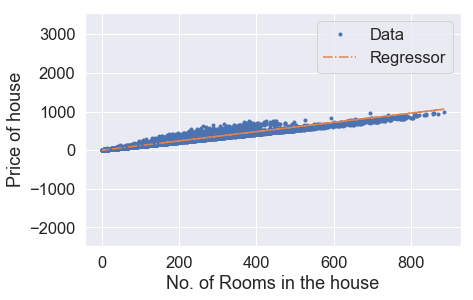

Iteration: 2301,Cost = 942.9515182806529,theta = [0.12759623 1.19837377]
Iteration: 2301,Cost_val = 947.2175384218473,theta = [0.12759623 1.19837377]


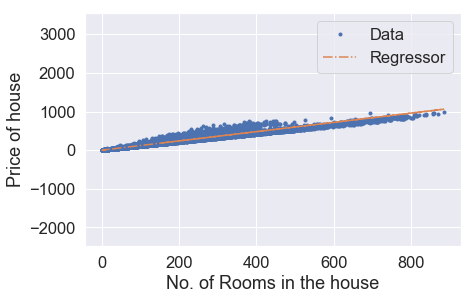

Iteration: 2311,Cost = 942.9488968370046,theta = [0.12810823 1.19837209]
Iteration: 2311,Cost_val = 947.2149623739508,theta = [0.12810823 1.19837209]


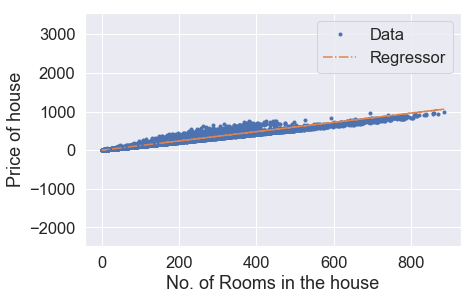

Iteration: 2321,Cost = 942.9462756522138,theta = [0.1286202  1.19837041]
Iteration: 2321,Cost_val = 947.2123865799879,theta = [0.1286202  1.19837041]


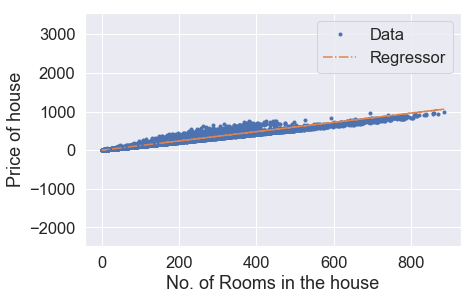

Iteration: 2331,Cost = 942.9436547262519,theta = [0.12913215 1.19836873]
Iteration: 2331,Cost_val = 947.2098110399181,theta = [0.12913215 1.19836873]


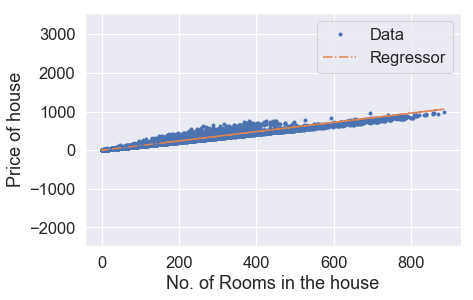

Iteration: 2341,Cost = 942.9410340590838,theta = [0.12964407 1.19836705]
Iteration: 2341,Cost_val = 947.2072357537239,theta = [0.12964407 1.19836705]


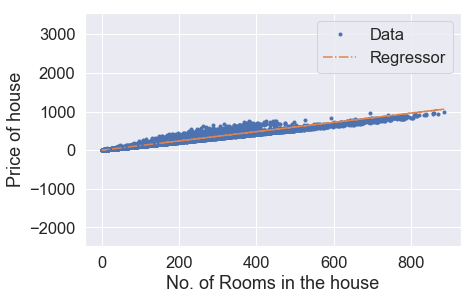

Iteration: 2351,Cost = 942.9384136507051,theta = [0.13015597 1.19836537]
Iteration: 2351,Cost_val = 947.2046607213814,theta = [0.13015597 1.19836537]


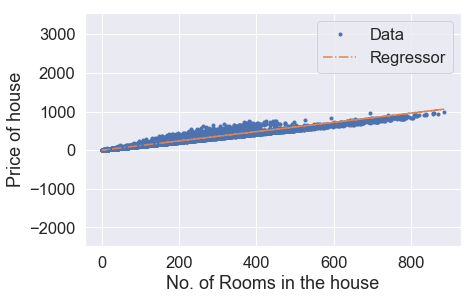

Iteration: 2361,Cost = 942.9357935010764,theta = [0.13066784 1.19836369]
Iteration: 2361,Cost_val = 947.2020859428593,theta = [0.13066784 1.19836369]


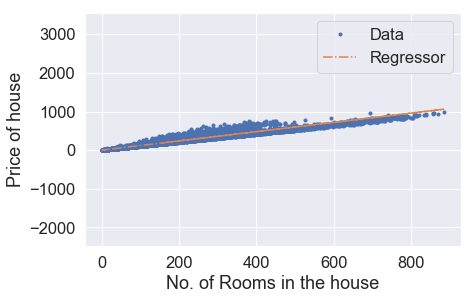

Iteration: 2371,Cost = 942.9331736101792,theta = [0.13117969 1.19836202]
Iteration: 2371,Cost_val = 947.1995114181385,theta = [0.13117969 1.19836202]


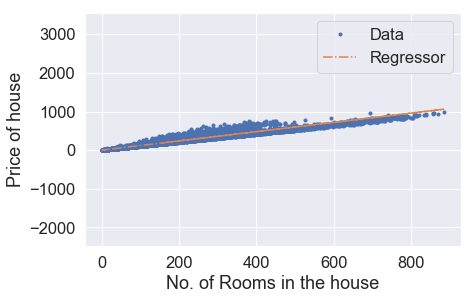

Iteration: 2381,Cost = 942.9305539779856,theta = [0.13169151 1.19836034]
Iteration: 2381,Cost_val = 947.196937147193,theta = [0.13169151 1.19836034]


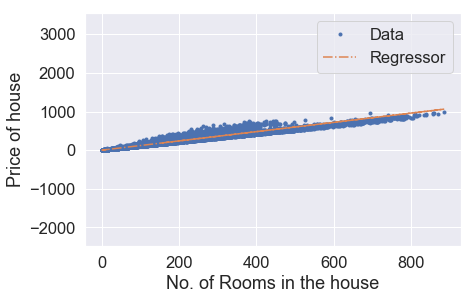

Iteration: 2391,Cost = 942.9279346044634,theta = [0.13220331 1.19835866]
Iteration: 2391,Cost_val = 947.1943631299963,theta = [0.13220331 1.19835866]


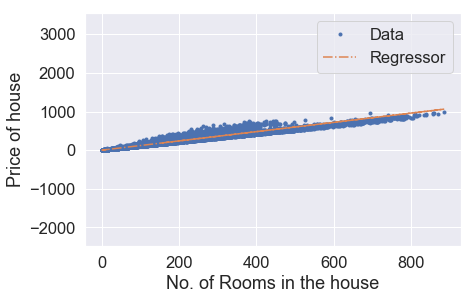

Iteration: 2401,Cost = 942.9253154895995,theta = [0.13271508 1.19835698]
Iteration: 2401,Cost_val = 947.1917893665226,theta = [0.13271508 1.19835698]


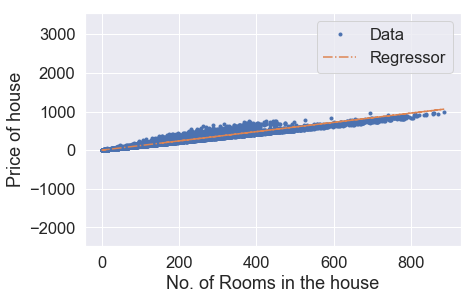

Iteration: 2411,Cost = 942.9226966333567,theta = [0.13322682 1.1983553 ]
Iteration: 2411,Cost_val = 947.1892158567524,theta = [0.13322682 1.1983553 ]


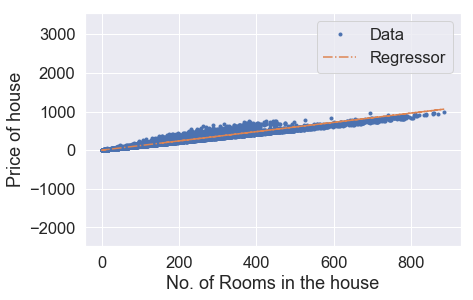

Iteration: 2421,Cost = 942.9200780357113,theta = [0.13373854 1.19835363]
Iteration: 2421,Cost_val = 947.1866426006495,theta = [0.13373854 1.19835363]


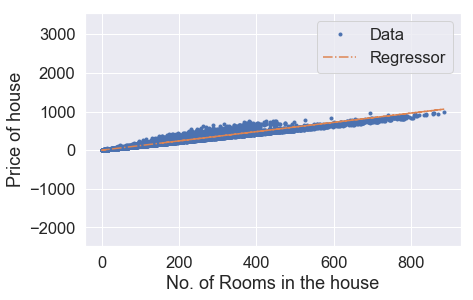

Iteration: 2431,Cost = 942.9174596966592,theta = [0.13425024 1.19835195]
Iteration: 2431,Cost_val = 947.1840695981991,theta = [0.13425024 1.19835195]


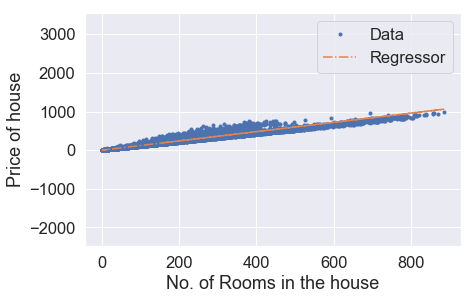

Iteration: 2441,Cost = 942.9148416161316,theta = [0.13476191 1.19835027]
Iteration: 2441,Cost_val = 947.1814968493727,theta = [0.13476191 1.19835027]


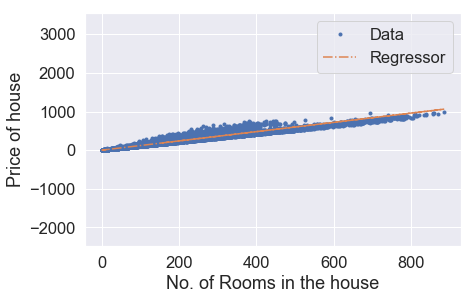

Iteration: 2451,Cost = 942.9122237941326,theta = [0.13527355 1.19834859]
Iteration: 2451,Cost_val = 947.1789243541466,theta = [0.13527355 1.19834859]


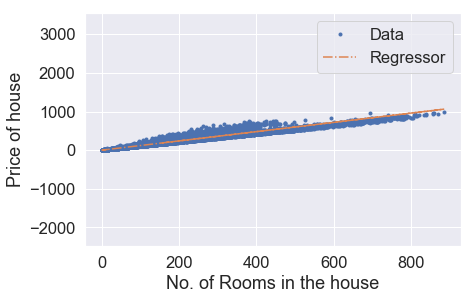

Iteration: 2461,Cost = 942.9096062306501,theta = [0.13578517 1.19834691]
Iteration: 2461,Cost_val = 947.1763521124959,theta = [0.13578517 1.19834691]


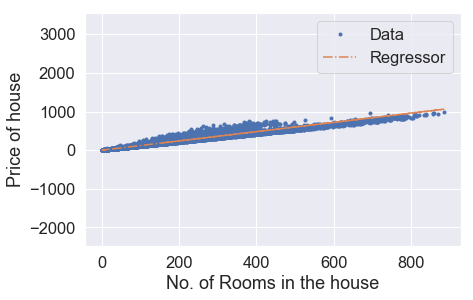

Iteration: 2471,Cost = 942.9069889256301,theta = [0.13629677 1.19834524]
Iteration: 2471,Cost_val = 947.1737801243929,theta = [0.13629677 1.19834524]


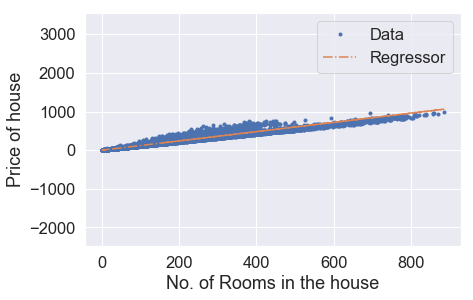

Iteration: 2481,Cost = 942.9043718790565,theta = [0.13680833 1.19834356]
Iteration: 2481,Cost_val = 947.1712083898113,theta = [0.13680833 1.19834356]


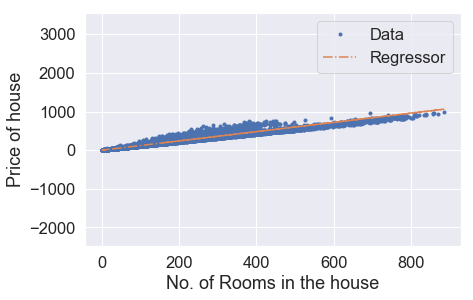

Iteration: 2491,Cost = 942.9017550909052,theta = [0.13731988 1.19834188]
Iteration: 2491,Cost_val = 947.1686369087336,theta = [0.13731988 1.19834188]


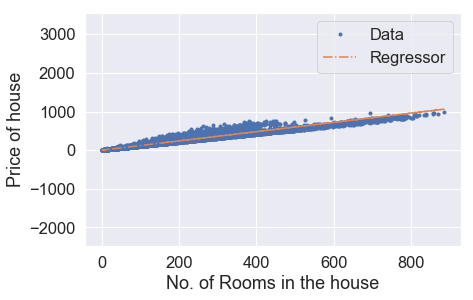

Iteration: 2501,Cost = 942.8991385611522,theta = [0.1378314  1.19834021]
Iteration: 2501,Cost_val = 947.1660656811256,theta = [0.1378314  1.19834021]


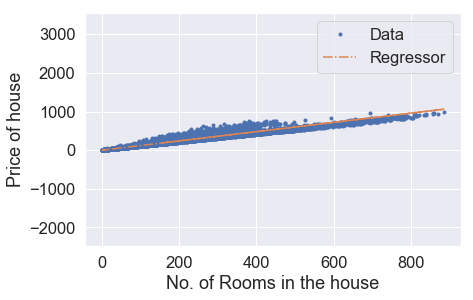

Iteration: 2511,Cost = 942.8965222897813,theta = [0.13834289 1.19833853]
Iteration: 2511,Cost_val = 947.1634947069631,theta = [0.13834289 1.19833853]


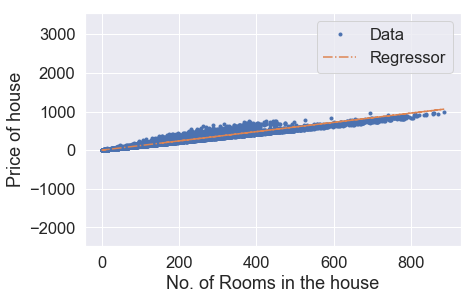

Iteration: 2521,Cost = 942.8939062767311,theta = [0.13885436 1.19833685]
Iteration: 2521,Cost_val = 947.1609239862339,theta = [0.13885436 1.19833685]


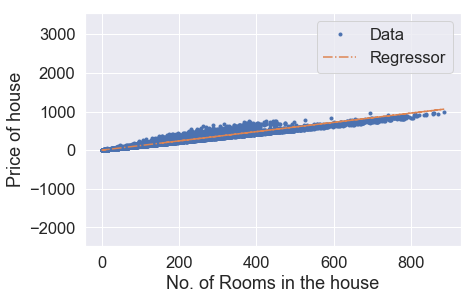

Iteration: 2531,Cost = 942.891290522012,theta = [0.1393658  1.19833517]
Iteration: 2531,Cost_val = 947.1583535188994,theta = [0.1393658  1.19833517]


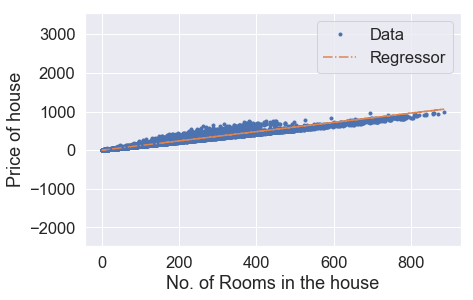

Iteration: 2541,Cost = 942.8886750255956,theta = [0.13987722 1.1983335 ]
Iteration: 2541,Cost_val = 947.1557833049396,theta = [0.13987722 1.1983335 ]


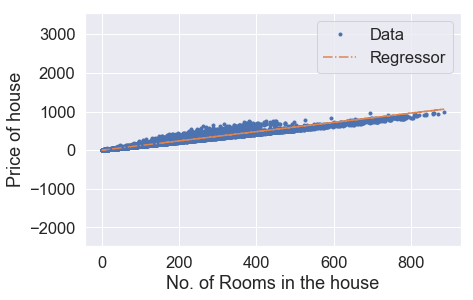

Iteration: 2551,Cost = 942.8860597874411,theta = [0.14038861 1.19833182]
Iteration: 2551,Cost_val = 947.1532133443278,theta = [0.14038861 1.19833182]


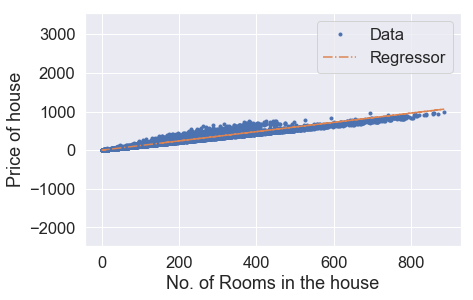

Iteration: 2561,Cost = 942.8834448075241,theta = [0.14089997 1.19833014]
Iteration: 2561,Cost_val = 947.1506436370377,theta = [0.14089997 1.19833014]


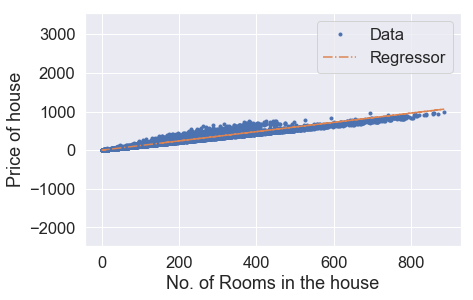

Iteration: 2571,Cost = 942.8808300858365,theta = [0.14141132 1.19832847]
Iteration: 2571,Cost_val = 947.1480741830517,theta = [0.14141132 1.19832847]


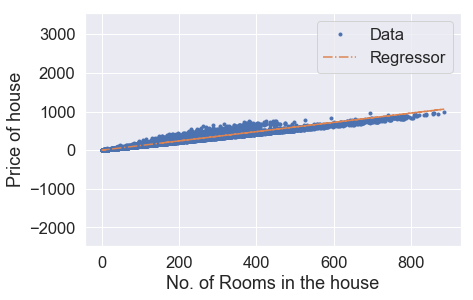

Iteration: 2581,Cost = 942.8782156223314,theta = [0.14192263 1.19832679]
Iteration: 2581,Cost_val = 947.1455049823372,theta = [0.14192263 1.19832679]


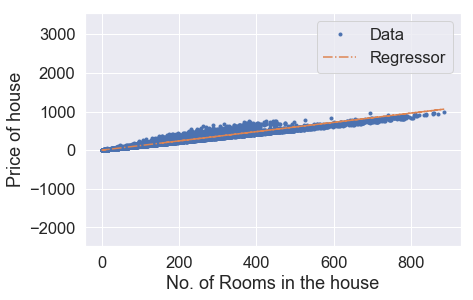

Iteration: 2591,Cost = 942.8756014170104,theta = [0.14243392 1.19832511]
Iteration: 2591,Cost_val = 947.1429360348731,theta = [0.14243392 1.19832511]


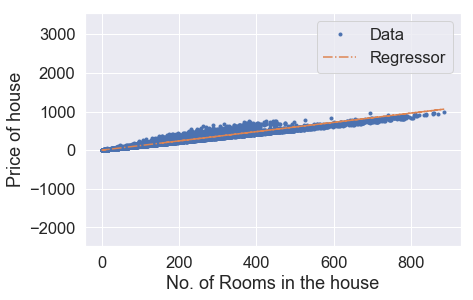

Iteration: 2601,Cost = 942.8729874698112,theta = [0.14294519 1.19832344]
Iteration: 2601,Cost_val = 947.1403673406336,theta = [0.14294519 1.19832344]


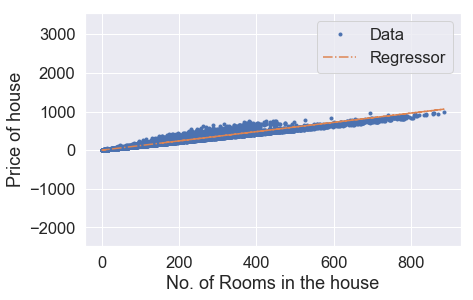

Iteration: 2611,Cost = 942.8703737807319,theta = [0.14345643 1.19832176]
Iteration: 2611,Cost_val = 947.137798899587,theta = [0.14345643 1.19832176]


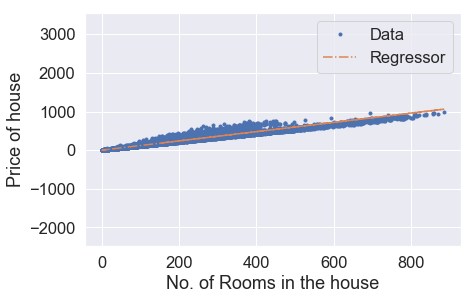

Iteration: 2621,Cost = 942.8677603497423,theta = [0.14396764 1.19832008]
Iteration: 2621,Cost_val = 947.1352307117214,theta = [0.14396764 1.19832008]


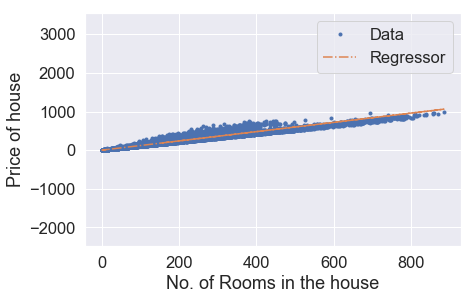

Iteration: 2631,Cost = 942.8651471768278,theta = [0.14447883 1.19831841]
Iteration: 2631,Cost_val = 947.1326627770023,theta = [0.14447883 1.19831841]


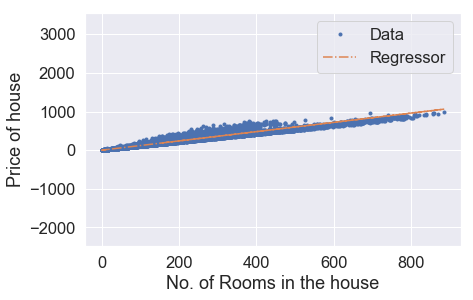

Iteration: 2641,Cost = 942.8625342619531,theta = [0.14499    1.19831673]
Iteration: 2641,Cost_val = 947.130095095409,theta = [0.14499    1.19831673]


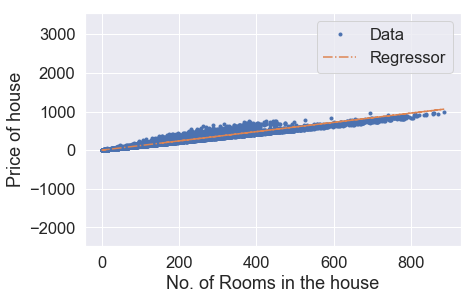

Iteration: 2651,Cost = 942.8599216050807,theta = [0.14550114 1.19831506]
Iteration: 2651,Cost_val = 947.1275276669118,theta = [0.14550114 1.19831506]


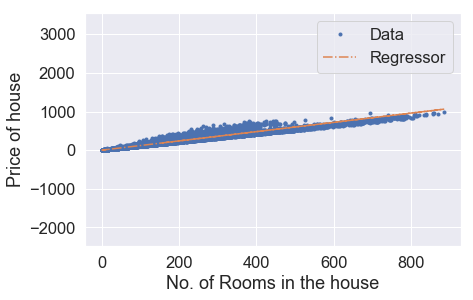

Iteration: 2661,Cost = 942.8573092062027,theta = [0.14601225 1.19831338]
Iteration: 2661,Cost_val = 947.1249604914947,theta = [0.14601225 1.19831338]


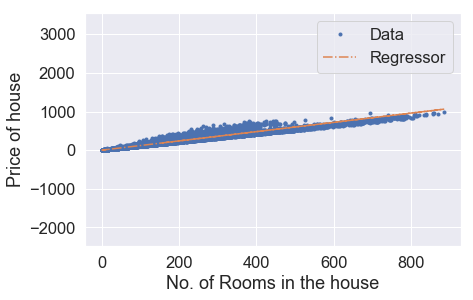

Iteration: 2671,Cost = 942.8546970652887,theta = [0.14652334 1.1983117 ]
Iteration: 2671,Cost_val = 947.1223935691175,theta = [0.14652334 1.1983117 ]


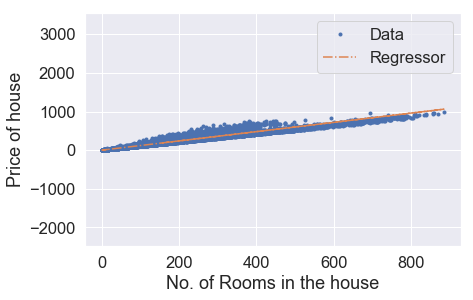

Iteration: 2681,Cost = 942.8520851823101,theta = [0.14703441 1.19831003]
Iteration: 2681,Cost_val = 947.1198268997703,theta = [0.14703441 1.19831003]


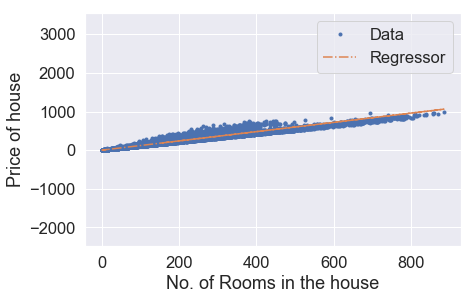

Iteration: 2691,Cost = 942.8494735572407,theta = [0.14754544 1.19830835]
Iteration: 2691,Cost_val = 947.1172604834243,theta = [0.14754544 1.19830835]


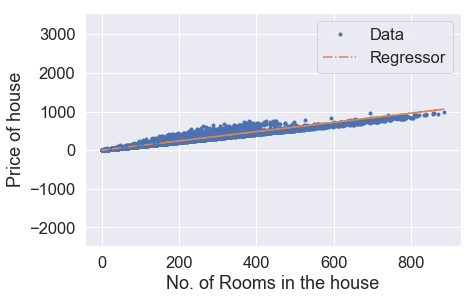

Iteration: 2701,Cost = 942.8468621900562,theta = [0.14805646 1.19830668]
Iteration: 2701,Cost_val = 947.1146943200478,theta = [0.14805646 1.19830668]


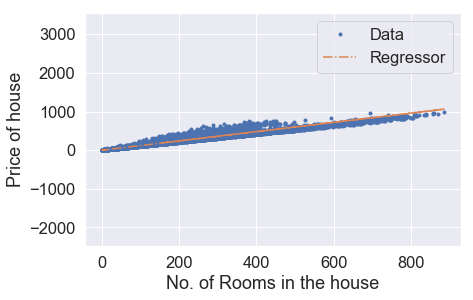

Iteration: 2711,Cost = 942.8442510807421,theta = [0.14856745 1.198305  ]
Iteration: 2711,Cost_val = 947.1121284096258,theta = [0.14856745 1.198305  ]


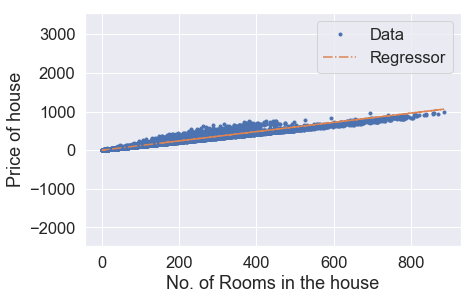

Iteration: 2721,Cost = 942.8416402292565,theta = [0.14907841 1.19830333]
Iteration: 2721,Cost_val = 947.1095627521278,theta = [0.14907841 1.19830333]


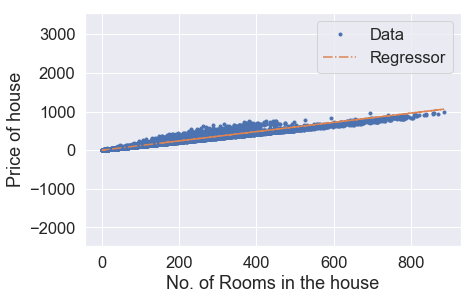

Iteration: 2731,Cost = 942.8390296355877,theta = [0.14958935 1.19830165]
Iteration: 2731,Cost_val = 947.106997347526,theta = [0.14958935 1.19830165]


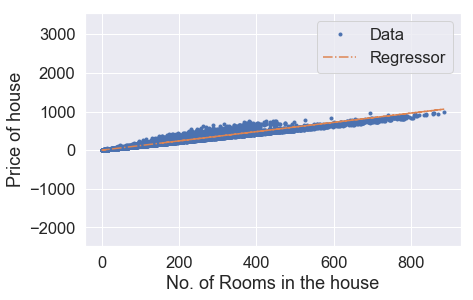

Iteration: 2741,Cost = 942.8364192996938,theta = [0.15010026 1.19829998]
Iteration: 2741,Cost_val = 947.1044321957983,theta = [0.15010026 1.19829998]


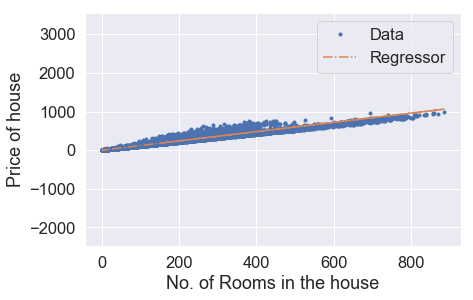

Iteration: 2751,Cost = 942.8338092215774,theta = [0.15061115 1.1982983 ]
Iteration: 2751,Cost_val = 947.1018672969228,theta = [0.15061115 1.1982983 ]


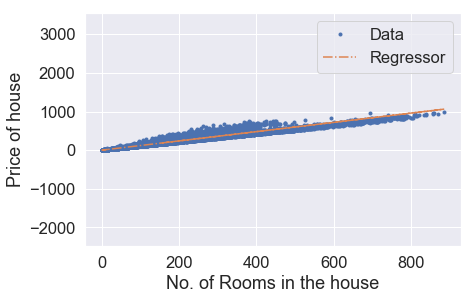

Iteration: 2761,Cost = 942.8311994011792,theta = [0.15112201 1.19829662]
Iteration: 2761,Cost_val = 947.0993026508722,theta = [0.15112201 1.19829662]


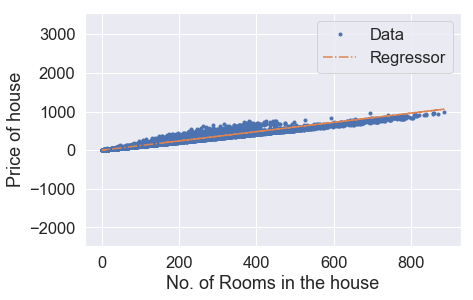

Iteration: 2771,Cost = 942.8285898384947,theta = [0.15163284 1.19829495]
Iteration: 2771,Cost_val = 947.0967382576174,theta = [0.15163284 1.19829495]


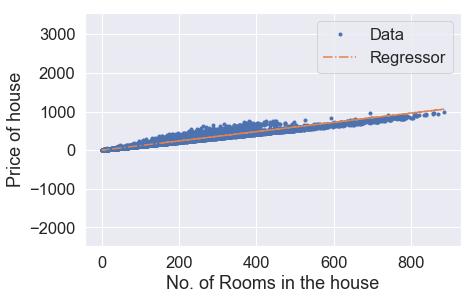

Iteration: 2781,Cost = 942.825980533494,theta = [0.15214366 1.19829327]
Iteration: 2781,Cost_val = 947.0941741171389,theta = [0.15214366 1.19829327]


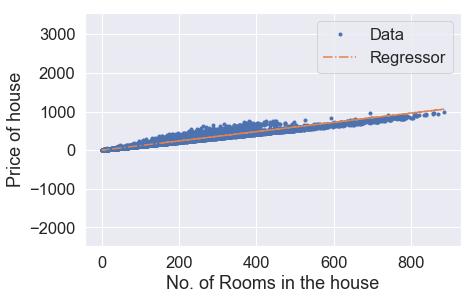

Iteration: 2791,Cost = 942.8233714861524,theta = [0.15265444 1.1982916 ]
Iteration: 2791,Cost_val = 947.0916102294145,theta = [0.15265444 1.1982916 ]


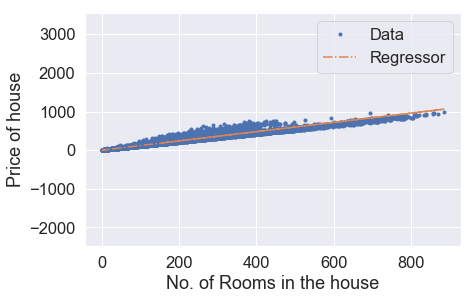

Iteration: 2801,Cost = 942.8207626964339,theta = [0.1531652  1.19828993]
Iteration: 2801,Cost_val = 947.0890465944112,theta = [0.1531652  1.19828993]


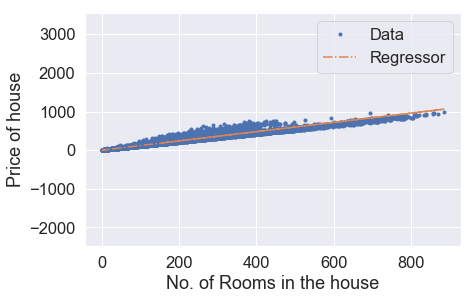

Iteration: 2811,Cost = 942.8181541643247,theta = [0.15367594 1.19828825]
Iteration: 2811,Cost_val = 947.0864832121114,theta = [0.15367594 1.19828825]


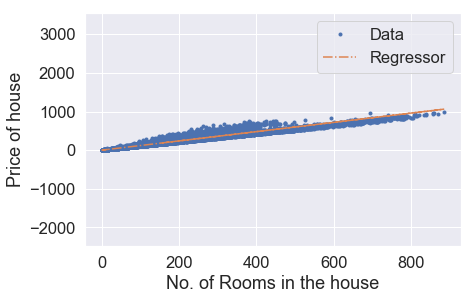

Iteration: 2821,Cost = 942.8155458897985,theta = [0.15418665 1.19828658]
Iteration: 2821,Cost_val = 947.0839200824829,theta = [0.15418665 1.19828658]


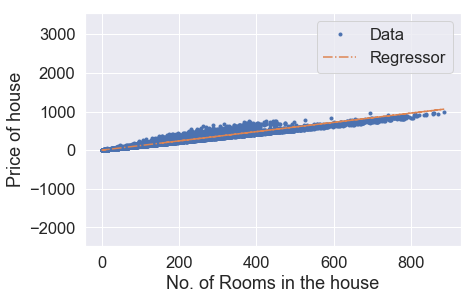

Iteration: 2831,Cost = 942.8129378728266,theta = [0.15469733 1.1982849 ]
Iteration: 2831,Cost_val = 947.0813572055043,theta = [0.15469733 1.1982849 ]


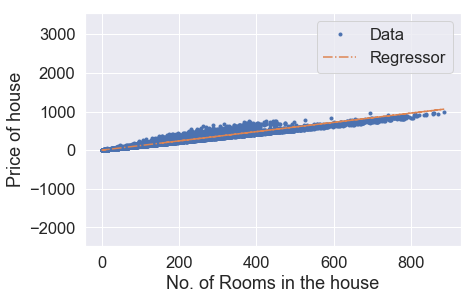

Iteration: 2841,Cost = 942.810330113393,theta = [0.15520799 1.19828323]
Iteration: 2841,Cost_val = 947.0787945811537,theta = [0.15520799 1.19828323]


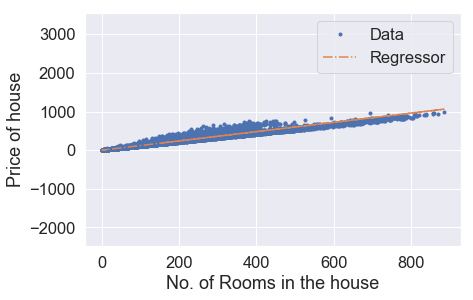

Iteration: 2851,Cost = 942.8077226114531,theta = [0.15571863 1.19828155]
Iteration: 2851,Cost_val = 947.0762322094005,theta = [0.15571863 1.19828155]


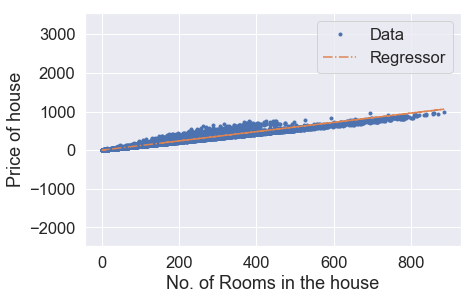

Iteration: 2861,Cost = 942.805115367003,theta = [0.15622924 1.19827988]
Iteration: 2861,Cost_val = 947.073670090223,theta = [0.15622924 1.19827988]


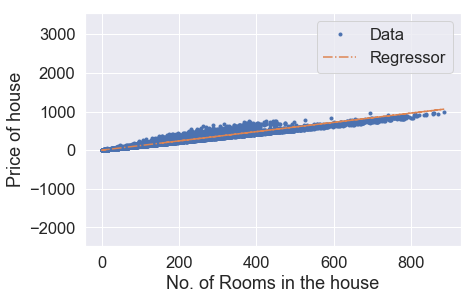

Iteration: 2871,Cost = 942.8025083800057,theta = [0.15673982 1.1982782 ]
Iteration: 2871,Cost_val = 947.0711082235958,theta = [0.15673982 1.1982782 ]


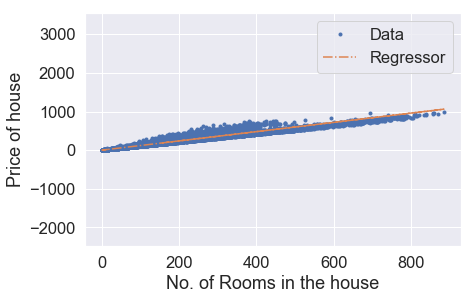

Iteration: 2881,Cost = 942.7999016504267,theta = [0.15725038 1.19827653]
Iteration: 2881,Cost_val = 947.0685466094951,theta = [0.15725038 1.19827653]


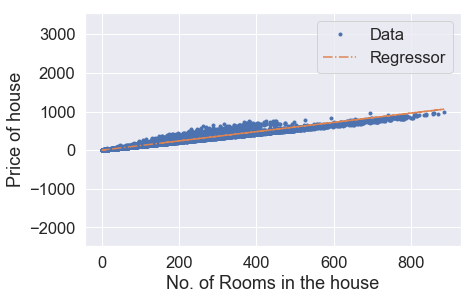

Iteration: 2891,Cost = 942.7972951782573,theta = [0.15776092 1.19827486]
Iteration: 2891,Cost_val = 947.0659852478964,theta = [0.15776092 1.19827486]


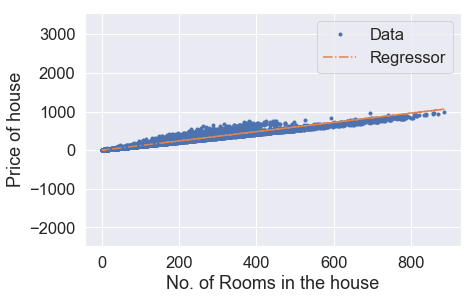

Iteration: 2901,Cost = 942.794688963471,theta = [0.15827143 1.19827318]
Iteration: 2901,Cost_val = 947.0634241387723,theta = [0.15827143 1.19827318]


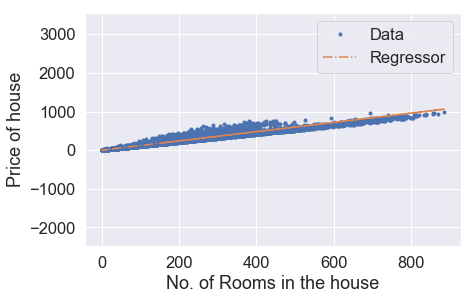

Iteration: 2911,Cost = 942.7920830060286,theta = [0.15878191 1.19827151]
Iteration: 2911,Cost_val = 947.0608632820971,theta = [0.15878191 1.19827151]


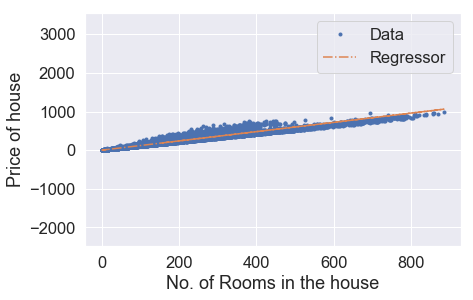

Iteration: 2921,Cost = 942.7894773059265,theta = [0.15929237 1.19826983]
Iteration: 2921,Cost_val = 947.0583026778527,theta = [0.15929237 1.19826983]


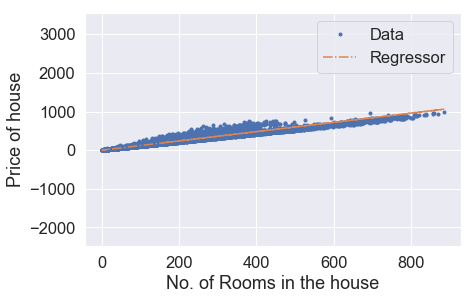

Iteration: 2931,Cost = 942.7868718631121,theta = [0.1598028  1.19826816]
Iteration: 2931,Cost_val = 947.0557423260027,theta = [0.1598028  1.19826816]


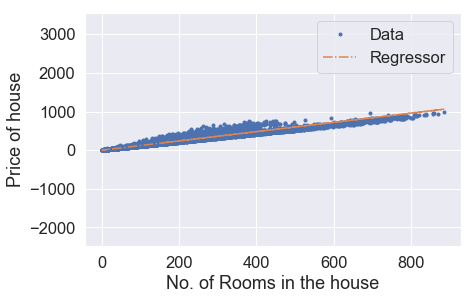

Iteration: 2941,Cost = 942.7842666775769,theta = [0.16031321 1.19826649]
Iteration: 2941,Cost_val = 947.05318222653,theta = [0.16031321 1.19826649]


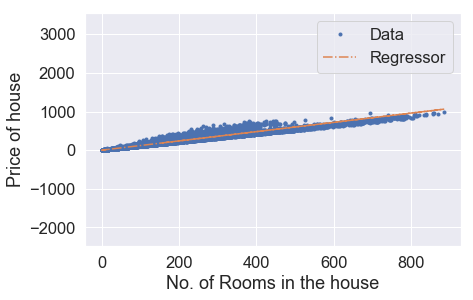

Iteration: 2951,Cost = 942.7816617492939,theta = [0.16082359 1.19826481]
Iteration: 2951,Cost_val = 947.0506223794138,theta = [0.16082359 1.19826481]


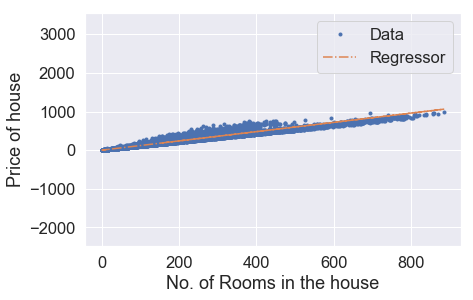

Iteration: 2961,Cost = 942.7790570782355,theta = [0.16133395 1.19826314]
Iteration: 2961,Cost_val = 947.0480627846185,theta = [0.16133395 1.19826314]


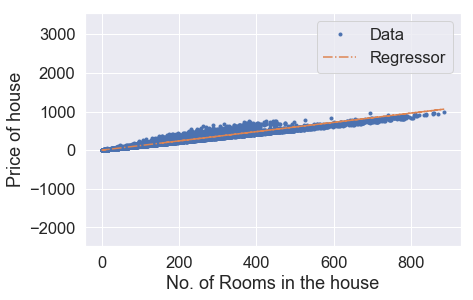

Iteration: 2971,Cost = 942.7764526643818,theta = [0.16184428 1.19826147]
Iteration: 2971,Cost_val = 947.0455034421268,theta = [0.16184428 1.19826147]


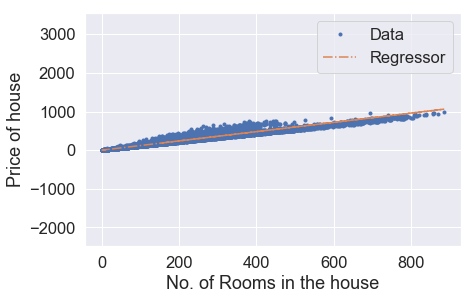

Iteration: 2981,Cost = 942.7738485076974,theta = [0.16235459 1.19825979]
Iteration: 2981,Cost_val = 947.0429443519113,theta = [0.16235459 1.19825979]


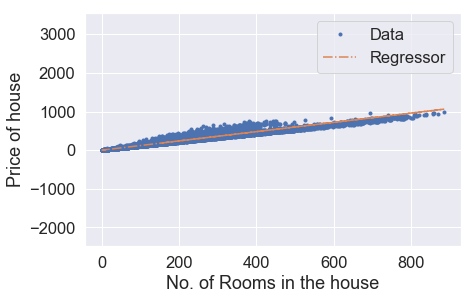

Iteration: 2991,Cost = 942.7712446081705,theta = [0.16286487 1.19825812]
Iteration: 2991,Cost_val = 947.040385513946,theta = [0.16286487 1.19825812]


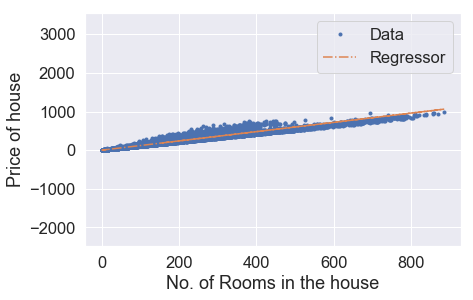

Iteration: 3001,Cost = 942.7686409657572,theta = [0.16337513 1.19825645]
Iteration: 3001,Cost_val = 947.037826928211,theta = [0.16337513 1.19825645]


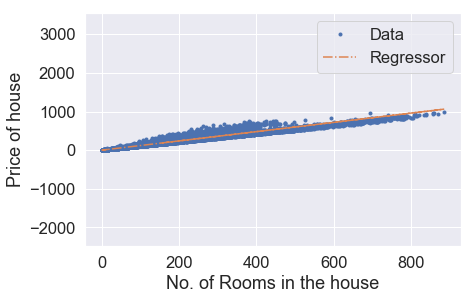

Iteration: 3011,Cost = 942.7660375804422,theta = [0.16388536 1.19825477]
Iteration: 3011,Cost_val = 947.035268594673,theta = [0.16388536 1.19825477]


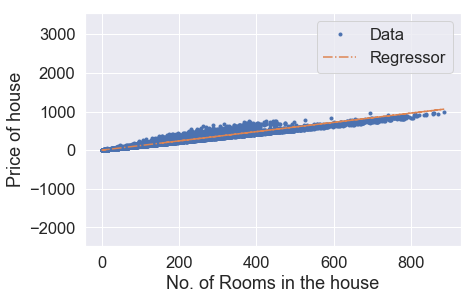

Iteration: 3021,Cost = 942.7634344522054,theta = [0.16439557 1.1982531 ]
Iteration: 3021,Cost_val = 947.0327105133156,theta = [0.16439557 1.1982531 ]


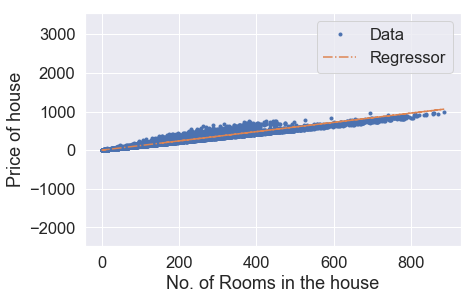

Iteration: 3031,Cost = 942.7608315810114,theta = [0.16490575 1.19825143]
Iteration: 3031,Cost_val = 947.0301526841084,theta = [0.16490575 1.19825143]


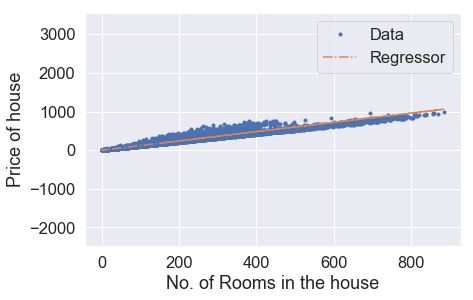

Iteration: 3041,Cost = 942.7582289668492,theta = [0.1654159  1.19824975]
Iteration: 3041,Cost_val = 947.0275951070299,theta = [0.1654159  1.19824975]


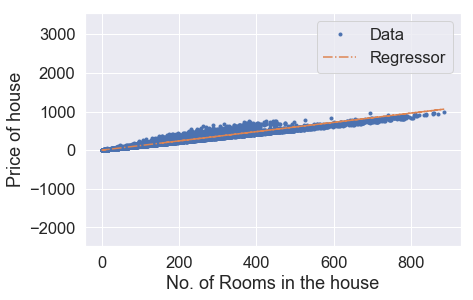

Iteration: 3051,Cost = 942.7556266096689,theta = [0.16592603 1.19824808]
Iteration: 3051,Cost_val = 947.0250377820544,theta = [0.16592603 1.19824808]


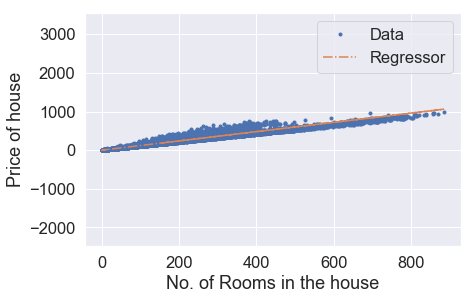

Iteration: 3061,Cost = 942.753024509467,theta = [0.16643614 1.19824641]
Iteration: 3061,Cost_val = 947.0224807091519,theta = [0.16643614 1.19824641]


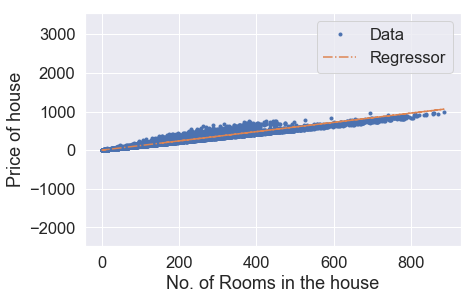

Iteration: 3071,Cost = 942.7504226662126,theta = [0.16694622 1.19824474]
Iteration: 3071,Cost_val = 947.0199238883041,theta = [0.16694622 1.19824474]


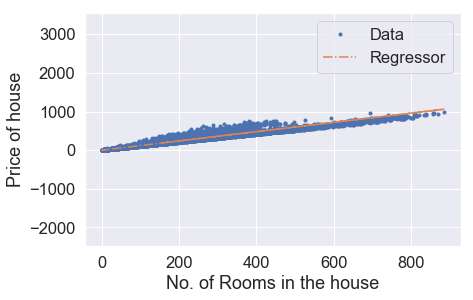

Iteration: 3081,Cost = 942.747821079879,theta = [0.16745628 1.19824306]
Iteration: 3081,Cost_val = 947.0173673194851,theta = [0.16745628 1.19824306]


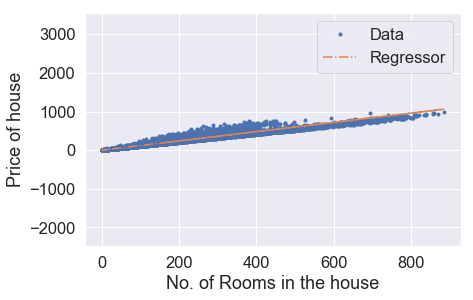

Iteration: 3091,Cost = 942.7452197504414,theta = [0.16796631 1.19824139]
Iteration: 3091,Cost_val = 947.0148110026674,theta = [0.16796631 1.19824139]


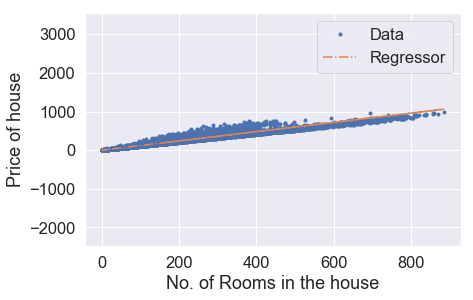

Iteration: 3101,Cost = 942.742618677869,theta = [0.16847631 1.19823972]
Iteration: 3101,Cost_val = 947.0122549378314,theta = [0.16847631 1.19823972]


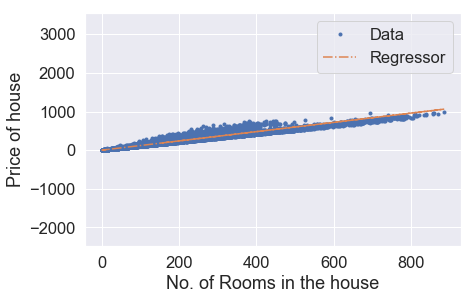

Iteration: 3111,Cost = 942.7400178621617,theta = [0.16898629 1.19823805]
Iteration: 3111,Cost_val = 947.0096991249467,theta = [0.16898629 1.19823805]


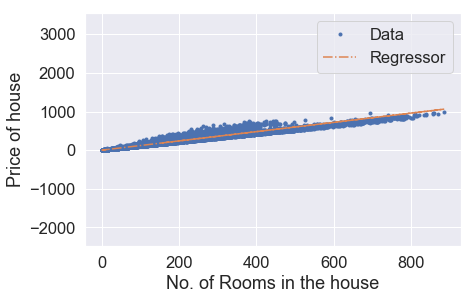

Iteration: 3121,Cost = 942.7374173032431,theta = [0.16949625 1.19823637]
Iteration: 3121,Cost_val = 947.0071435639885,theta = [0.16949625 1.19823637]


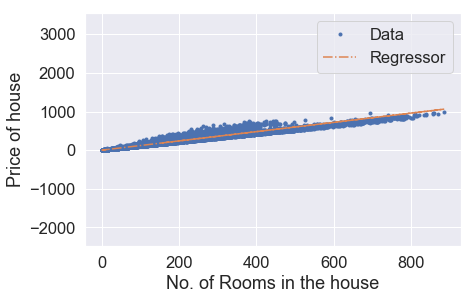

Iteration: 3131,Cost = 942.7348170011347,theta = [0.17000618 1.1982347 ]
Iteration: 3131,Cost_val = 947.0045882549339,theta = [0.17000618 1.1982347 ]


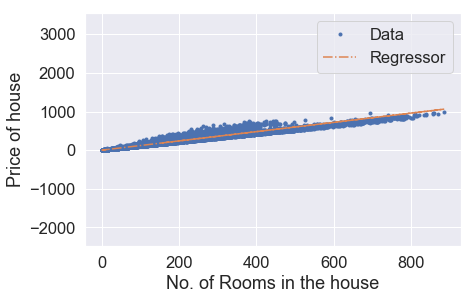

Iteration: 3141,Cost = 942.7322169557948,theta = [0.17051608 1.19823303]
Iteration: 3141,Cost_val = 947.002033197758,theta = [0.17051608 1.19823303]


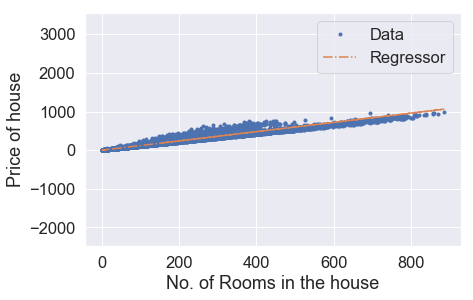

Iteration: 3151,Cost = 942.7296171671974,theta = [0.17102596 1.19823136]
Iteration: 3151,Cost_val = 946.9994783924386,theta = [0.17102596 1.19823136]


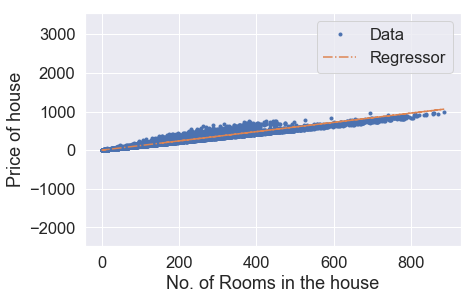

Iteration: 3161,Cost = 942.7270176353104,theta = [0.17153581 1.19822969]
Iteration: 3161,Cost_val = 946.996923838946,theta = [0.17153581 1.19822969]


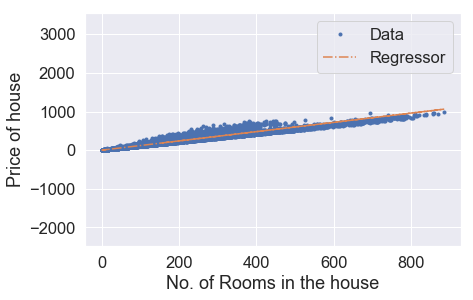

Iteration: 3171,Cost = 942.7244183601275,theta = [0.17204564 1.19822802]
Iteration: 3171,Cost_val = 946.9943695372563,theta = [0.17204564 1.19822802]


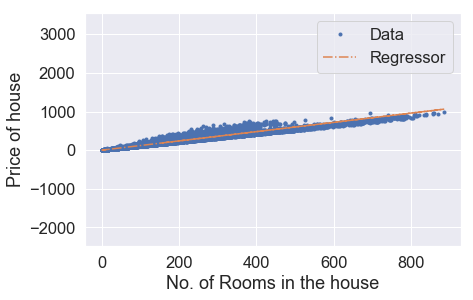

Iteration: 3181,Cost = 942.7218193415983,theta = [0.17255545 1.19822634]
Iteration: 3181,Cost_val = 946.991815487349,theta = [0.17255545 1.19822634]


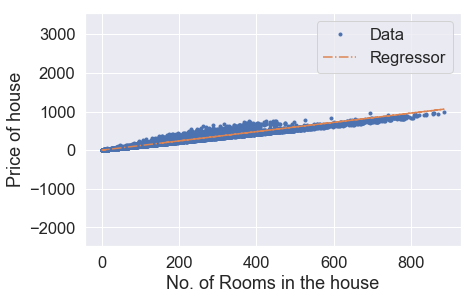

Iteration: 3191,Cost = 942.7192205797276,theta = [0.17306522 1.19822467]
Iteration: 3191,Cost_val = 946.989261689189,theta = [0.17306522 1.19822467]


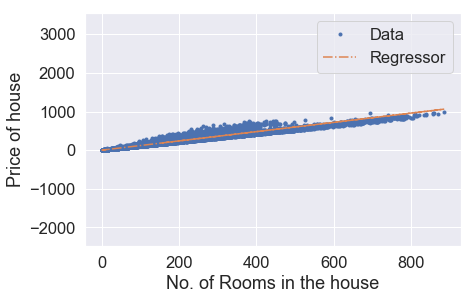

Iteration: 3201,Cost = 942.7166220744514,theta = [0.17357498 1.198223  ]
Iteration: 3201,Cost_val = 946.9867081427662,theta = [0.17357498 1.198223  ]


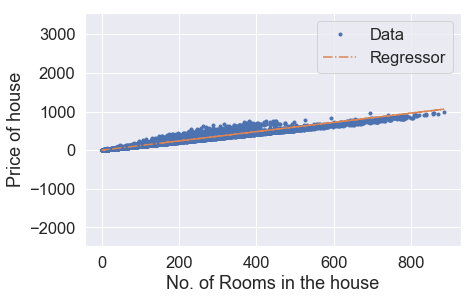

Iteration: 3211,Cost = 942.7140238257779,theta = [0.17408471 1.19822133]
Iteration: 3211,Cost_val = 946.9841548480468,theta = [0.17408471 1.19822133]


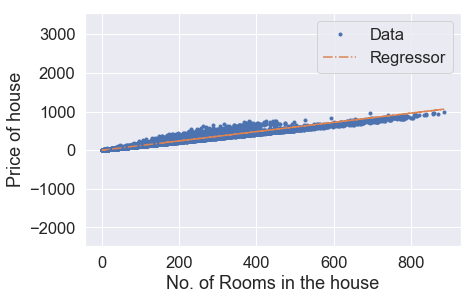

Iteration: 3221,Cost = 942.7114258336891,theta = [0.17459441 1.19821966]
Iteration: 3221,Cost_val = 946.9816018050034,theta = [0.17459441 1.19821966]


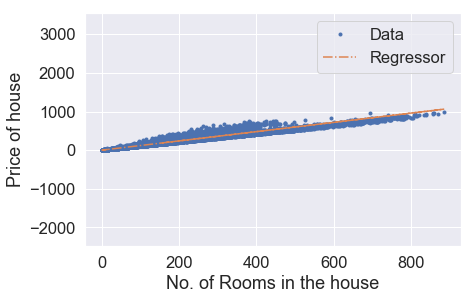

Iteration: 3231,Cost = 942.7088280981172,theta = [0.17510409 1.19821799]
Iteration: 3231,Cost_val = 946.9790490136203,theta = [0.17510409 1.19821799]


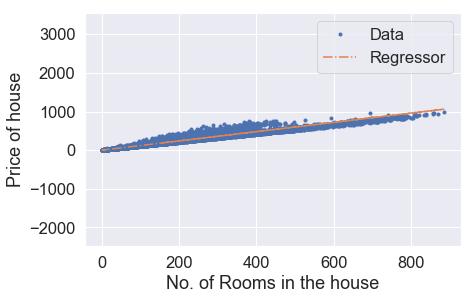

Iteration: 3241,Cost = 942.7062306190566,theta = [0.17561374 1.19821632]
Iteration: 3241,Cost_val = 946.9764964738614,theta = [0.17561374 1.19821632]


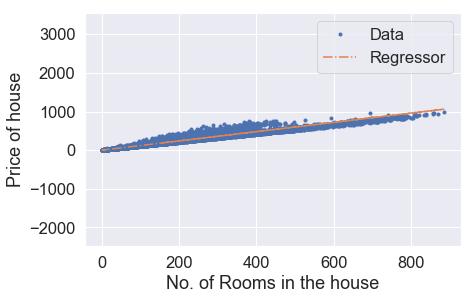

Iteration: 3251,Cost = 942.7036333964991,theta = [0.17612337 1.19821464]
Iteration: 3251,Cost_val = 946.9739441857084,theta = [0.17612337 1.19821464]


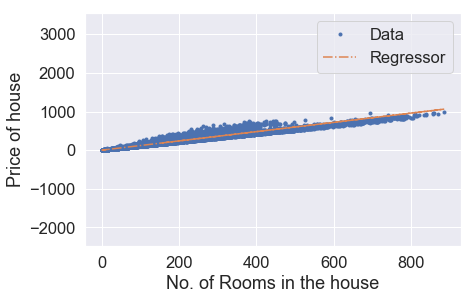

Iteration: 3261,Cost = 942.7010364304082,theta = [0.17663297 1.19821297]
Iteration: 3261,Cost_val = 946.9713921491435,theta = [0.17663297 1.19821297]


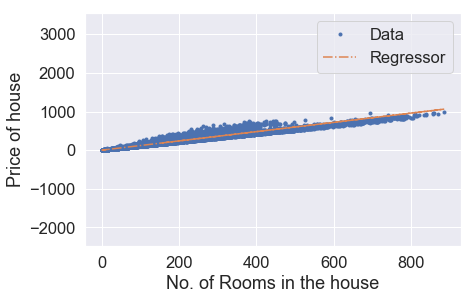

Iteration: 3271,Cost = 942.6984397207534,theta = [0.17714255 1.1982113 ]
Iteration: 3271,Cost_val = 946.9688403641236,theta = [0.17714255 1.1982113 ]


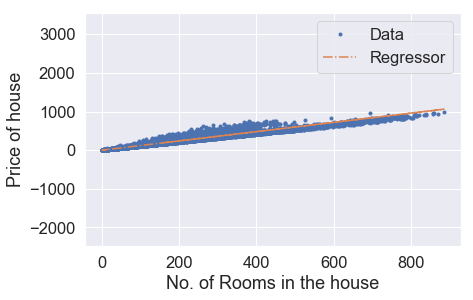

Iteration: 3281,Cost = 942.6958432675033,theta = [0.1776521  1.19820963]
Iteration: 3281,Cost_val = 946.9662888306408,theta = [0.1776521  1.19820963]


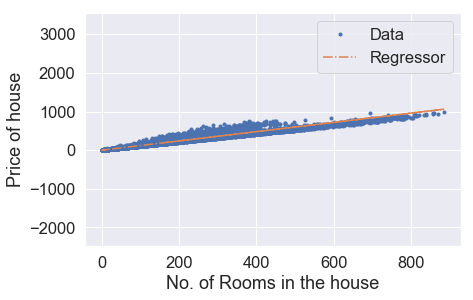

Iteration: 3291,Cost = 942.6932470706574,theta = [0.17816162 1.19820796]
Iteration: 3291,Cost_val = 946.9637375486645,theta = [0.17816162 1.19820796]


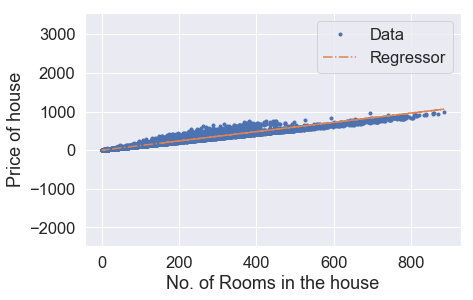

Iteration: 3301,Cost = 942.6906511301663,theta = [0.17867113 1.19820629]
Iteration: 3301,Cost_val = 946.9611865181654,theta = [0.17867113 1.19820629]


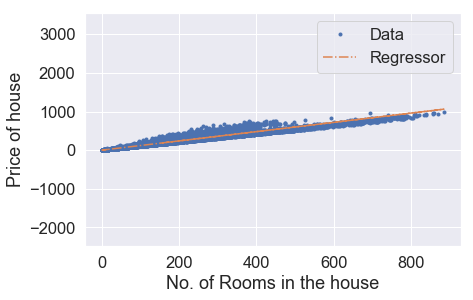

Iteration: 3311,Cost = 942.6880554460089,theta = [0.1791806  1.19820462]
Iteration: 3311,Cost_val = 946.958635739131,theta = [0.1791806  1.19820462]


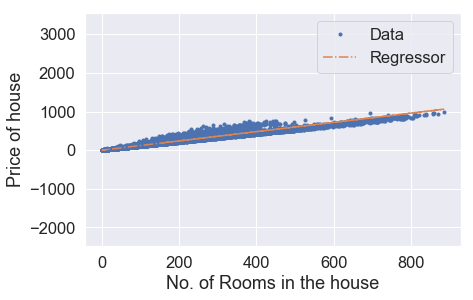

Iteration: 3321,Cost = 942.6854600181671,theta = [0.17969005 1.19820295]
Iteration: 3321,Cost_val = 946.9560852115192,theta = [0.17969005 1.19820295]


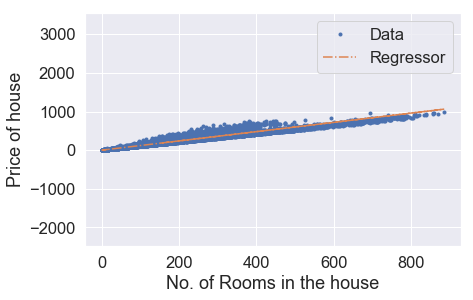

Iteration: 3331,Cost = 942.6828648466146,theta = [0.18019948 1.19820128]
Iteration: 3331,Cost_val = 946.9535349353185,theta = [0.18019948 1.19820128]


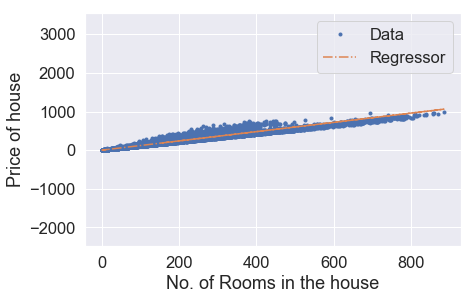

Iteration: 3341,Cost = 942.6802699313141,theta = [0.18070888 1.19819961]
Iteration: 3341,Cost_val = 946.950984910496,theta = [0.18070888 1.19819961]


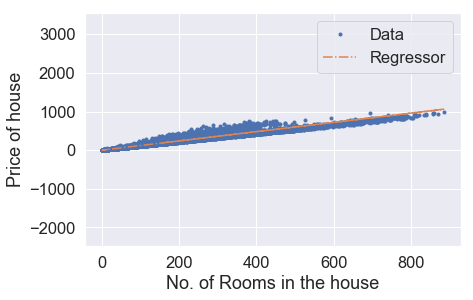

Iteration: 3351,Cost = 942.6776752722612,theta = [0.18121826 1.19819794]
Iteration: 3351,Cost_val = 946.9484351370335,theta = [0.18121826 1.19819794]


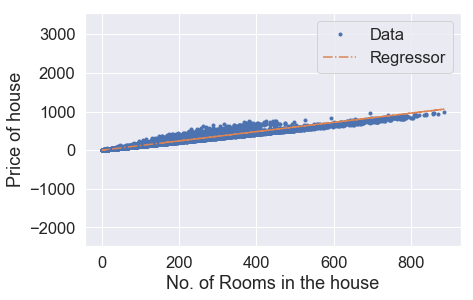

Iteration: 3361,Cost = 942.6750808694144,theta = [0.18172761 1.19819627]
Iteration: 3361,Cost_val = 946.9458856149056,theta = [0.18172761 1.19819627]


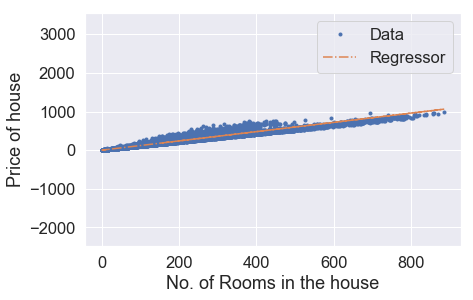

Iteration: 3371,Cost = 942.6724867227622,theta = [0.18223693 1.1981946 ]
Iteration: 3371,Cost_val = 946.9433363440819,theta = [0.18223693 1.1981946 ]


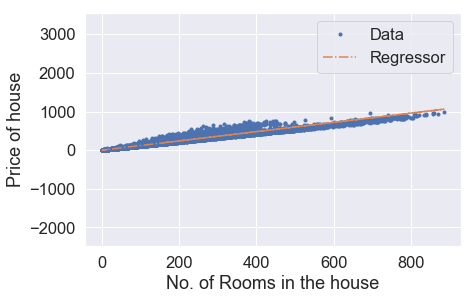

Iteration: 3381,Cost = 942.6698928322597,theta = [0.18274623 1.19819293]
Iteration: 3381,Cost_val = 946.9407873245441,theta = [0.18274623 1.19819293]


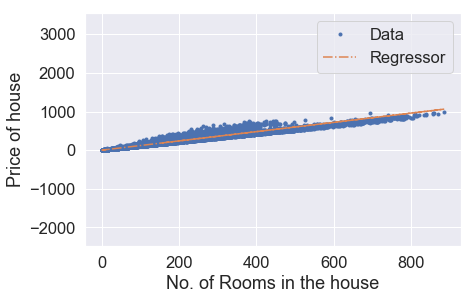

Iteration: 3391,Cost = 942.6672991978983,theta = [0.18325551 1.19819126]
Iteration: 3391,Cost_val = 946.9382385562614,theta = [0.18325551 1.19819126]


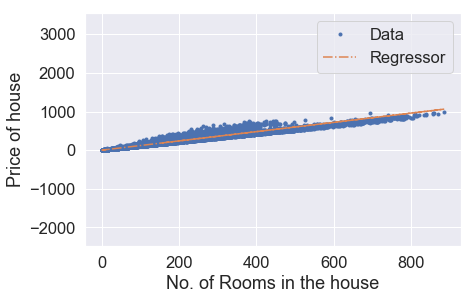

Iteration: 3401,Cost = 942.6647058196507,theta = [0.18376476 1.19818959]
Iteration: 3401,Cost_val = 946.9356900392096,theta = [0.18376476 1.19818959]


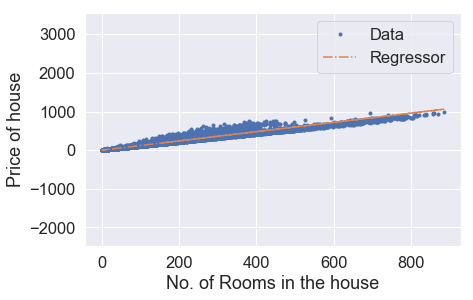

Iteration: 3411,Cost = 942.6621126974728,theta = [0.18427398 1.19818792]
Iteration: 3411,Cost_val = 946.9331417733764,theta = [0.18427398 1.19818792]


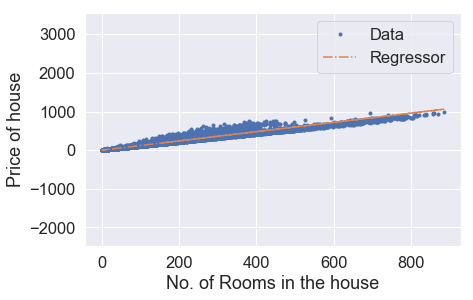

Iteration: 3421,Cost = 942.6595198313759,theta = [0.18478318 1.19818625]
Iteration: 3421,Cost_val = 946.930593758717,theta = [0.18478318 1.19818625]


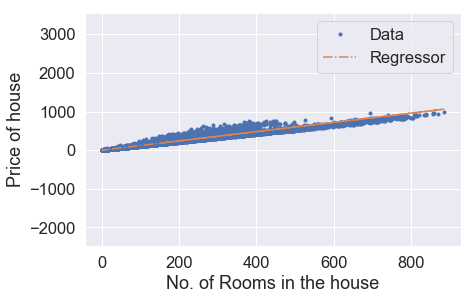

Iteration: 3431,Cost = 942.6569272212918,theta = [0.18529236 1.19818458]
Iteration: 3431,Cost_val = 946.9280459952204,theta = [0.18529236 1.19818458]


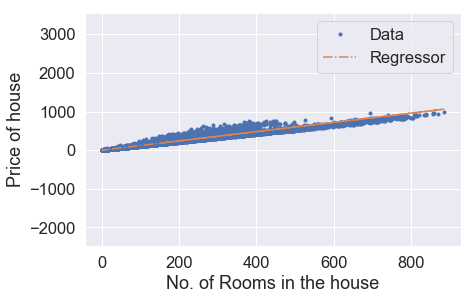

Iteration: 3441,Cost = 942.6543348672329,theta = [0.18580151 1.19818291]
Iteration: 3441,Cost_val = 946.9254984828563,theta = [0.18580151 1.19818291]


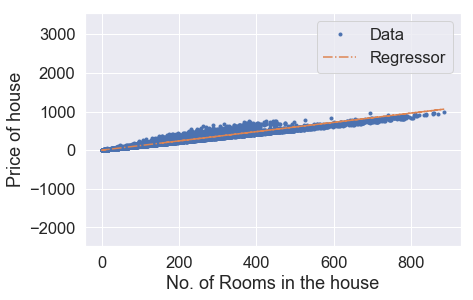

Iteration: 3451,Cost = 942.651742769151,theta = [0.18631063 1.19818124]
Iteration: 3451,Cost_val = 946.9229512216035,theta = [0.18631063 1.19818124]


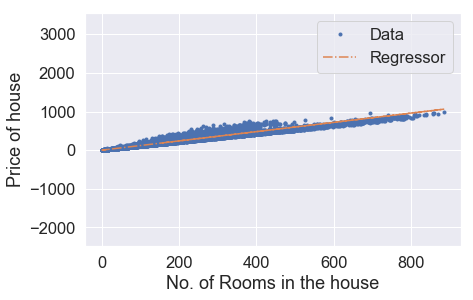

Iteration: 3461,Cost = 942.64915092703,theta = [0.18681973 1.19817957]
Iteration: 3461,Cost_val = 946.9204042114314,theta = [0.18681973 1.19817957]


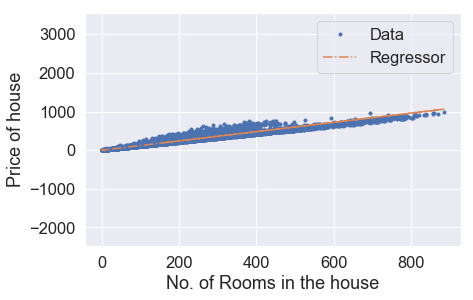

Iteration: 3471,Cost = 942.646559340835,theta = [0.18732881 1.1981779 ]
Iteration: 3471,Cost_val = 946.917857452322,theta = [0.18732881 1.1981779 ]


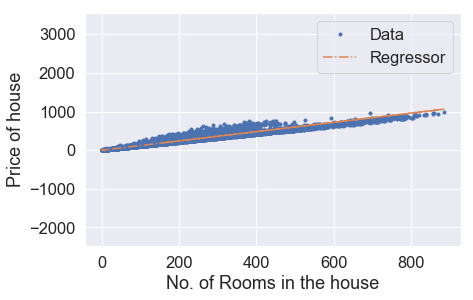

Iteration: 3481,Cost = 942.6439680105545,theta = [0.18783785 1.19817623]
Iteration: 3481,Cost_val = 946.9153109442514,theta = [0.18783785 1.19817623]


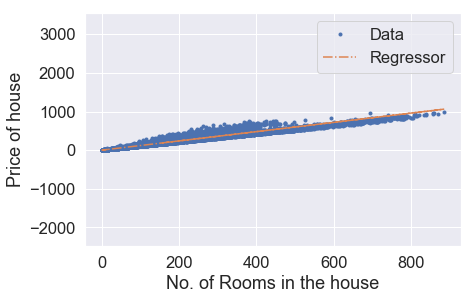

Iteration: 3491,Cost = 942.6413769361641,theta = [0.18834688 1.19817456]
Iteration: 3491,Cost_val = 946.9127646871843,theta = [0.18834688 1.19817456]


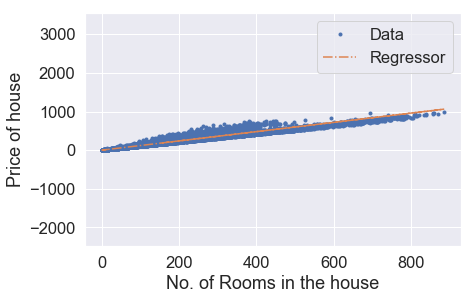

Iteration: 3501,Cost = 942.638786117617,theta = [0.18885588 1.19817289]
Iteration: 3501,Cost_val = 946.9102186811064,theta = [0.18885588 1.19817289]


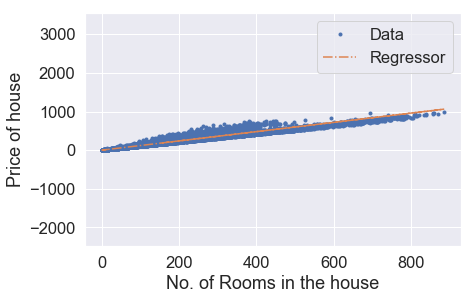

Iteration: 3511,Cost = 942.636195554907,theta = [0.18936485 1.19817123]
Iteration: 3511,Cost_val = 946.9076729259892,theta = [0.18936485 1.19817123]


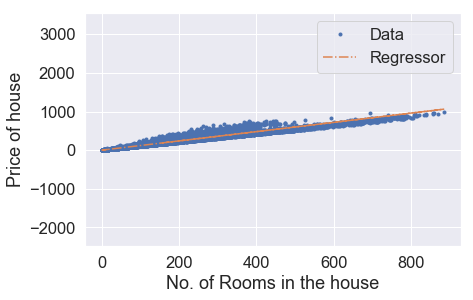

Iteration: 3521,Cost = 942.633605248006,theta = [0.1898738  1.19816956]
Iteration: 3521,Cost_val = 946.9051274218049,theta = [0.1898738  1.19816956]


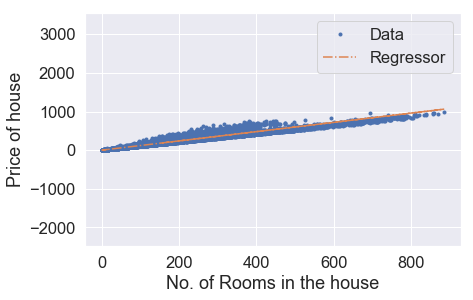

Iteration: 3531,Cost = 942.6310151968837,theta = [0.19038272 1.19816789]
Iteration: 3531,Cost_val = 946.9025821685339,theta = [0.19038272 1.19816789]


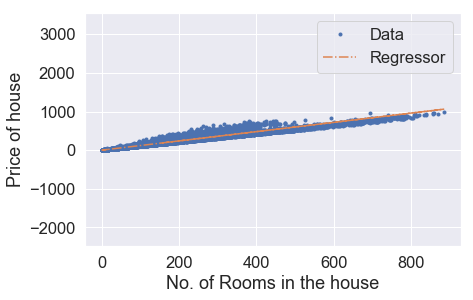

Iteration: 3541,Cost = 942.6284254015222,theta = [0.19089162 1.19816622]
Iteration: 3541,Cost_val = 946.9000371661516,theta = [0.19089162 1.19816622]


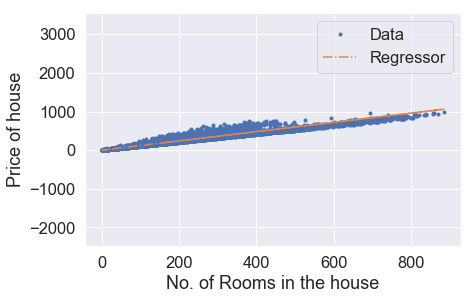

Iteration: 3551,Cost = 942.6258358618762,theta = [0.19140049 1.19816455]
Iteration: 3551,Cost_val = 946.8974924146286,theta = [0.19140049 1.19816455]


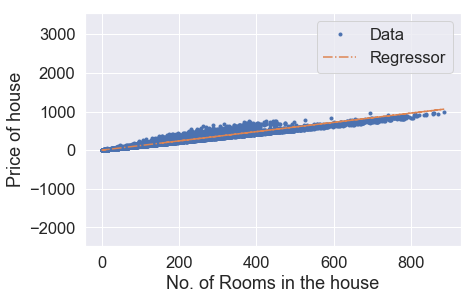

Iteration: 3561,Cost = 942.6232465779525,theta = [0.19190934 1.19816288]
Iteration: 3561,Cost_val = 946.8949479139427,theta = [0.19190934 1.19816288]


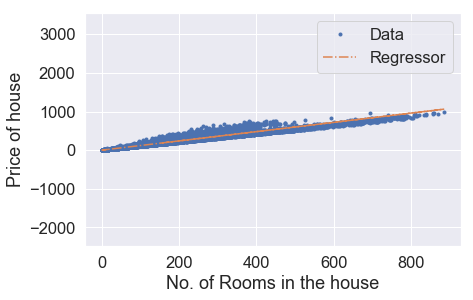

Iteration: 3571,Cost = 942.620657549713,theta = [0.19241816 1.19816121]
Iteration: 3571,Cost_val = 946.892403664071,theta = [0.19241816 1.19816121]


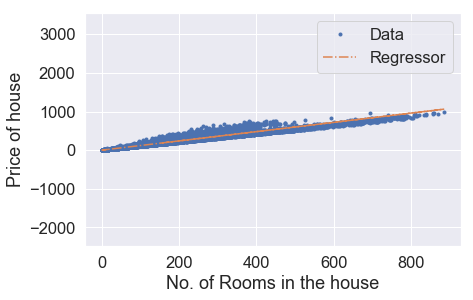

Iteration: 3581,Cost = 942.6180687771231,theta = [0.19292696 1.19815954]
Iteration: 3581,Cost_val = 946.8898596649824,theta = [0.19292696 1.19815954]


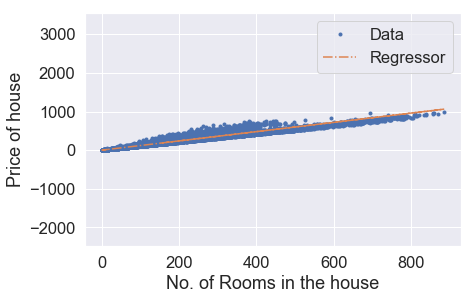

Iteration: 3591,Cost = 942.6154802601558,theta = [0.19343573 1.19815788]
Iteration: 3591,Cost_val = 946.8873159166584,theta = [0.19343573 1.19815788]


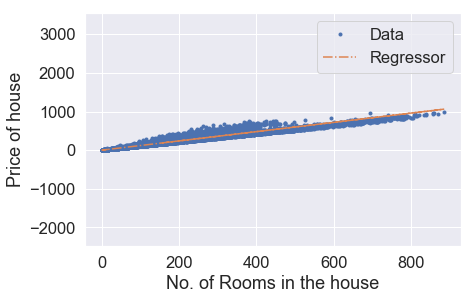

Iteration: 3601,Cost = 942.6128919987966,theta = [0.19394448 1.19815621]
Iteration: 3601,Cost_val = 946.8847724190725,theta = [0.19394448 1.19815621]


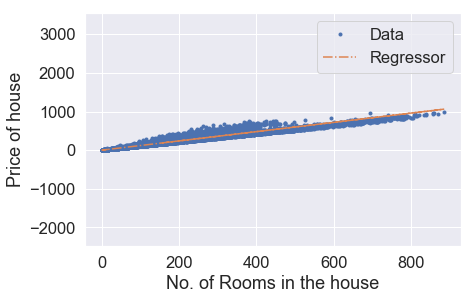

Iteration: 3611,Cost = 942.610303993025,theta = [0.1944532  1.19815454]
Iteration: 3611,Cost_val = 946.8822291722043,theta = [0.1944532  1.19815454]


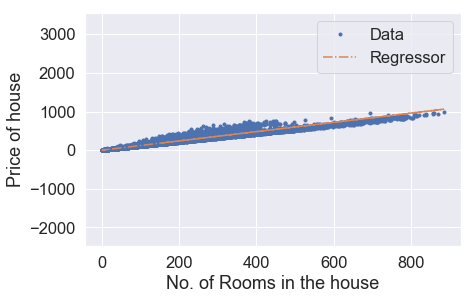

Iteration: 3621,Cost = 942.607716242794,theta = [0.1949619  1.19815287]
Iteration: 3621,Cost_val = 946.8796861760177,theta = [0.1949619  1.19815287]


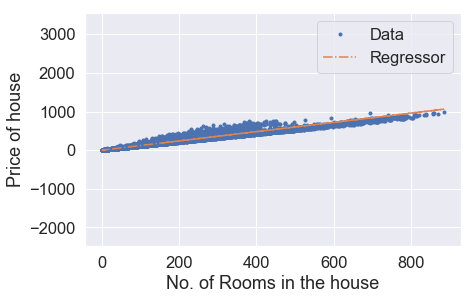

Iteration: 3631,Cost = 942.6051287481081,theta = [0.19547057 1.1981512 ]
Iteration: 3631,Cost_val = 946.8771434305008,theta = [0.19547057 1.1981512 ]


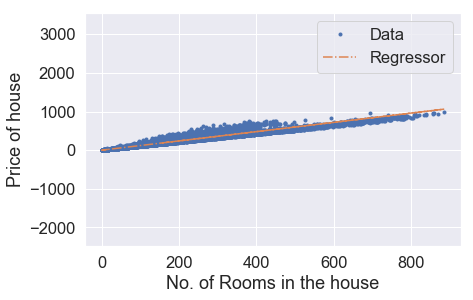

Iteration: 3641,Cost = 942.6025415089163,theta = [0.19597922 1.19814954]
Iteration: 3641,Cost_val = 946.874600935618,theta = [0.19597922 1.19814954]


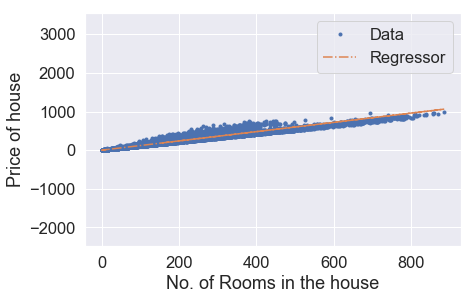

Iteration: 3651,Cost = 942.5999545252042,theta = [0.19648784 1.19814787]
Iteration: 3651,Cost_val = 946.8720586913535,theta = [0.19648784 1.19814787]


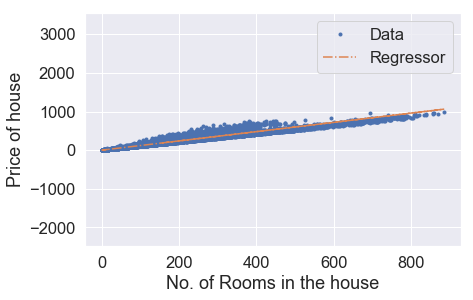

Iteration: 3661,Cost = 942.5973677969471,theta = [0.19699644 1.1981462 ]
Iteration: 3661,Cost_val = 946.8695166976746,theta = [0.19699644 1.1981462 ]


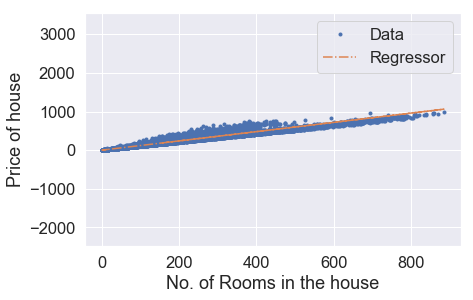

Iteration: 3671,Cost = 942.5947813241091,theta = [0.19750501 1.19814453]
Iteration: 3671,Cost_val = 946.8669749545627,theta = [0.19750501 1.19814453]


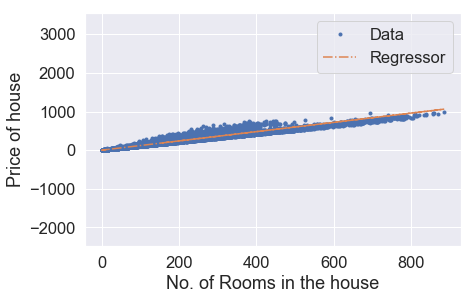

Iteration: 3681,Cost = 942.592195106683,theta = [0.19801356 1.19814287]
Iteration: 3681,Cost_val = 946.8644334619926,theta = [0.19801356 1.19814287]


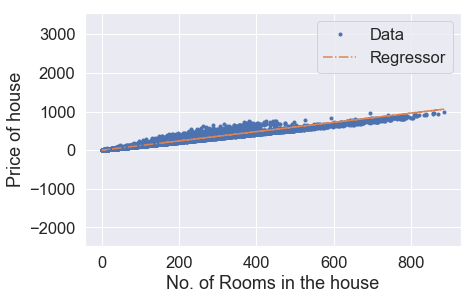

Iteration: 3691,Cost = 942.589609144636,theta = [0.19852208 1.1981412 ]
Iteration: 3691,Cost_val = 946.8618922199332,theta = [0.19852208 1.1981412 ]


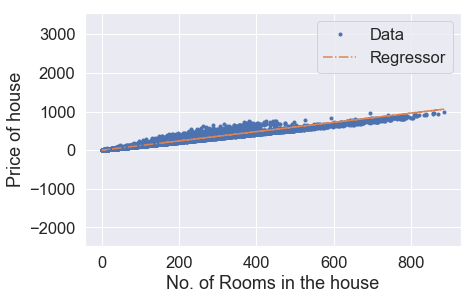

Iteration: 3701,Cost = 942.587023437947,theta = [0.19903058 1.19813953]
Iteration: 3701,Cost_val = 946.8593512283684,theta = [0.19903058 1.19813953]


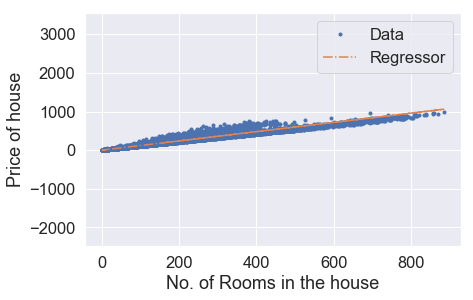

Iteration: 3711,Cost = 942.5844379865703,theta = [0.19953905 1.19813786]
Iteration: 3711,Cost_val = 946.8568104872702,theta = [0.19953905 1.19813786]


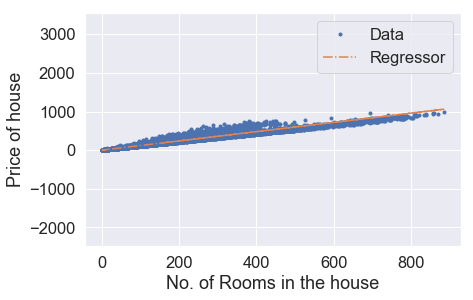

Iteration: 3721,Cost = 942.5818527905042,theta = [0.20004749 1.1981362 ]
Iteration: 3721,Cost_val = 946.854269996612,theta = [0.20004749 1.1981362 ]


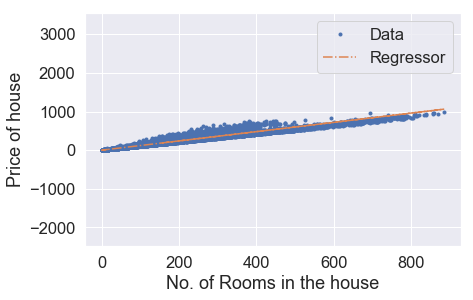

Iteration: 3731,Cost = 942.579267849712,theta = [0.20055591 1.19813453]
Iteration: 3731,Cost_val = 946.8517297563675,theta = [0.20055591 1.19813453]


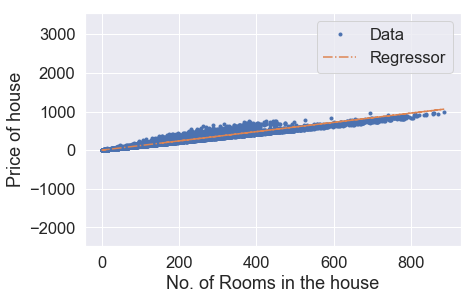

Iteration: 3741,Cost = 942.5766831641729,theta = [0.20106431 1.19813286]
Iteration: 3741,Cost_val = 946.8491897665205,theta = [0.20106431 1.19813286]


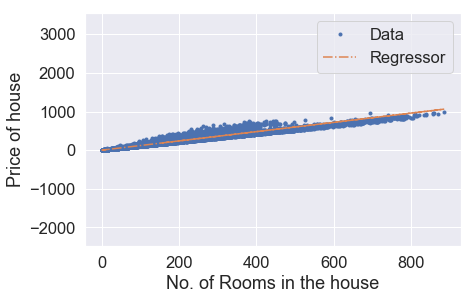

Iteration: 3751,Cost = 942.5740987338623,theta = [0.20157268 1.1981312 ]
Iteration: 3751,Cost_val = 946.8466500270382,theta = [0.20157268 1.1981312 ]


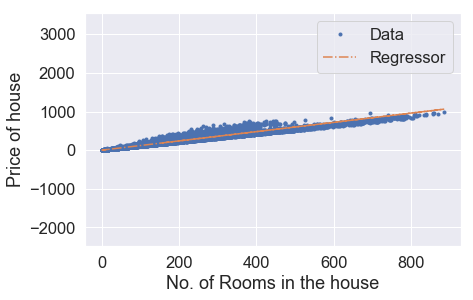

Iteration: 3761,Cost = 942.571514558743,theta = [0.20208103 1.19812953]
Iteration: 3761,Cost_val = 946.8441105378977,theta = [0.20208103 1.19812953]


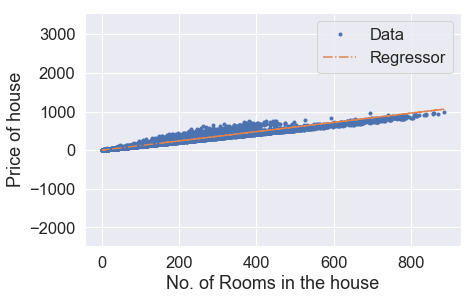

Iteration: 3771,Cost = 942.5689306388142,theta = [0.20258935 1.19812786]
Iteration: 3771,Cost_val = 946.8415712990763,theta = [0.20258935 1.19812786]


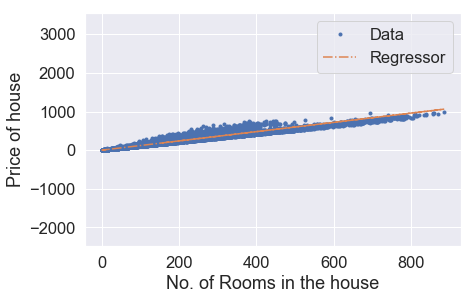

Iteration: 3781,Cost = 942.5663469740249,theta = [0.20309764 1.19812619]
Iteration: 3781,Cost_val = 946.8390323105505,theta = [0.20309764 1.19812619]


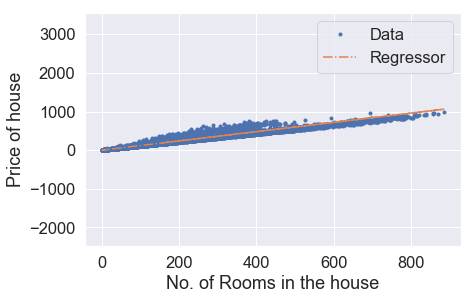

Iteration: 3791,Cost = 942.563763564374,theta = [0.20360591 1.19812453]
Iteration: 3791,Cost_val = 946.8364935722819,theta = [0.20360591 1.19812453]


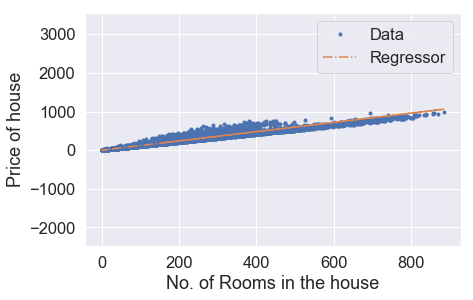

Iteration: 3801,Cost = 942.5611804098054,theta = [0.20411416 1.19812286]
Iteration: 3801,Cost_val = 946.8339550842666,theta = [0.20411416 1.19812286]


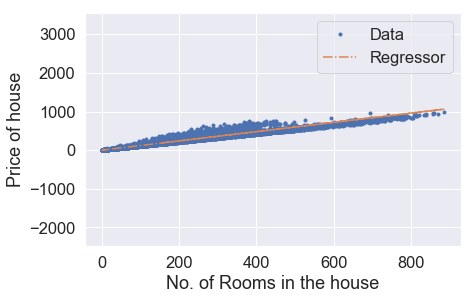

Iteration: 3811,Cost = 942.5585975103348,theta = [0.20462238 1.1981212 ]
Iteration: 3811,Cost_val = 946.8314168464668,theta = [0.20462238 1.1981212 ]


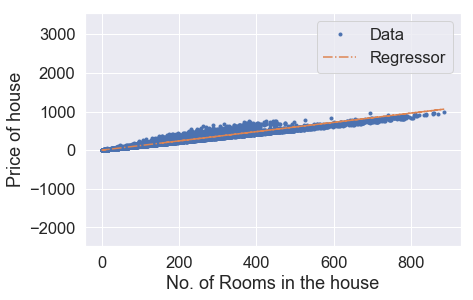

Iteration: 3821,Cost = 942.5560148659043,theta = [0.20513057 1.19811953]
Iteration: 3821,Cost_val = 946.8288788588651,theta = [0.20513057 1.19811953]


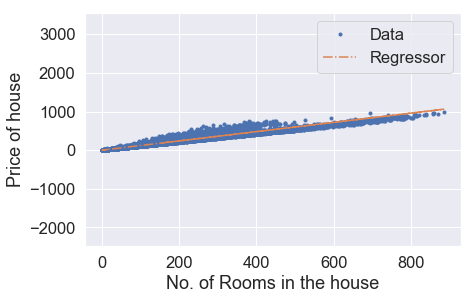

Iteration: 3831,Cost = 942.5534324764978,theta = [0.20563874 1.19811786]
Iteration: 3831,Cost_val = 946.8263411214291,theta = [0.20563874 1.19811786]


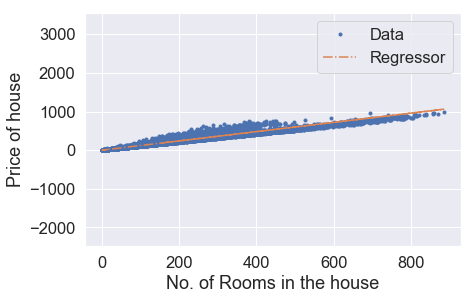

Iteration: 3841,Cost = 942.5508503420849,theta = [0.20614689 1.1981162 ]
Iteration: 3841,Cost_val = 946.8238036341442,theta = [0.20614689 1.1981162 ]


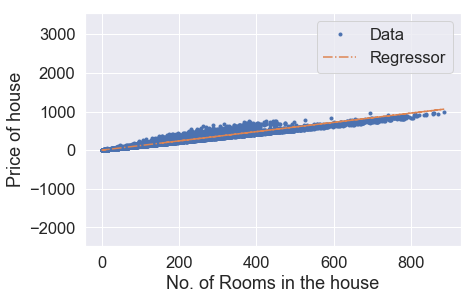

Iteration: 3851,Cost = 942.5482684626465,theta = [0.20665501 1.19811453]
Iteration: 3851,Cost_val = 946.8212663969747,theta = [0.20665501 1.19811453]


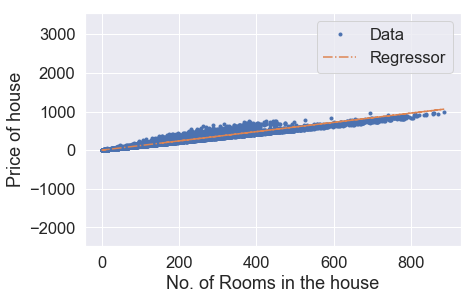

Iteration: 3861,Cost = 942.5456868381718,theta = [0.2071631  1.19811286]
Iteration: 3861,Cost_val = 946.8187294099005,theta = [0.2071631  1.19811286]


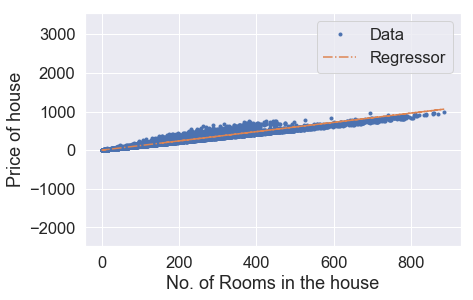

Iteration: 3871,Cost = 942.5431054686165,theta = [0.20767117 1.1981112 ]
Iteration: 3871,Cost_val = 946.8161926728978,theta = [0.20767117 1.1981112 ]


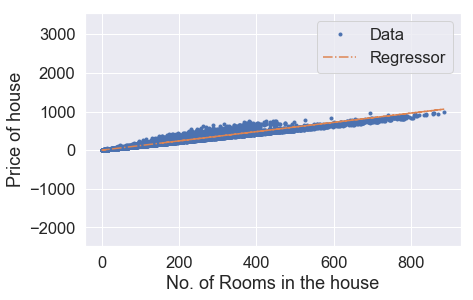

Iteration: 3881,Cost = 942.5405243539542,theta = [0.20817922 1.19810953]
Iteration: 3881,Cost_val = 946.813656185939,theta = [0.20817922 1.19810953]


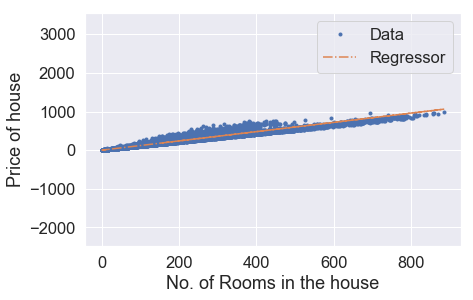

Iteration: 3891,Cost = 942.5379434941508,theta = [0.20868724 1.19810787]
Iteration: 3891,Cost_val = 946.8111199490098,theta = [0.20868724 1.19810787]


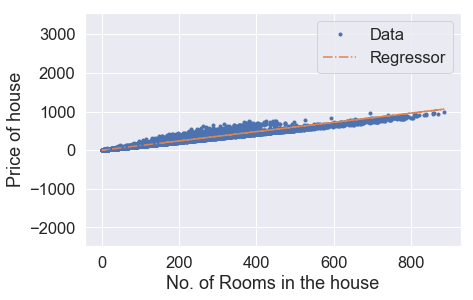

Iteration: 3901,Cost = 942.5353628892203,theta = [0.20919523 1.1981062 ]
Iteration: 3901,Cost_val = 946.8085839620686,theta = [0.20919523 1.1981062 ]


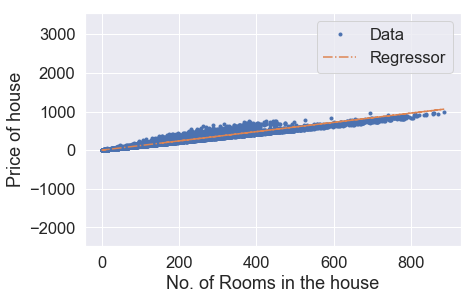

Iteration: 3911,Cost = 942.5327825391065,theta = [0.2097032  1.19810453]
Iteration: 3911,Cost_val = 946.8060482251061,theta = [0.2097032  1.19810453]


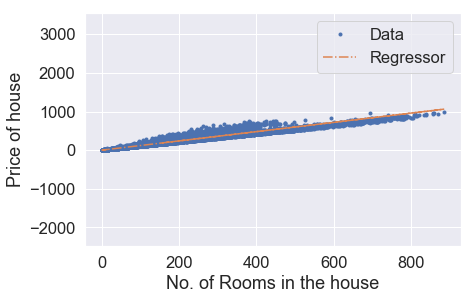

Iteration: 3921,Cost = 942.5302024437965,theta = [0.21021115 1.19810287]
Iteration: 3921,Cost_val = 946.8035127380874,theta = [0.21021115 1.19810287]


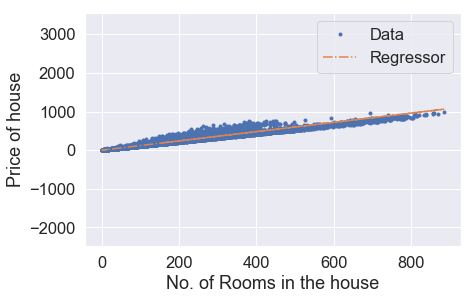

Iteration: 3931,Cost = 942.5276226032516,theta = [0.21071906 1.1981012 ]
Iteration: 3931,Cost_val = 946.8009775009881,theta = [0.21071906 1.1981012 ]


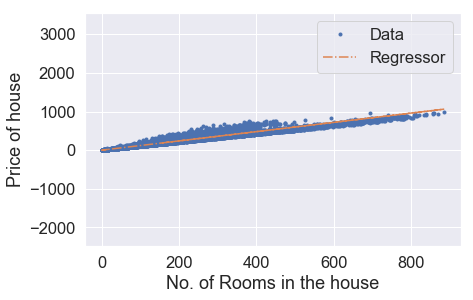

Iteration: 3941,Cost = 942.5250430174622,theta = [0.21122696 1.19809954]
Iteration: 3941,Cost_val = 946.7984425137953,theta = [0.21122696 1.19809954]


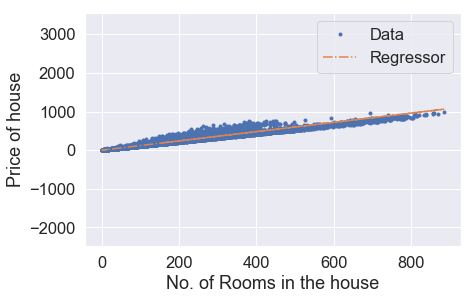

Iteration: 3951,Cost = 942.5224636863777,theta = [0.21173483 1.19809787]
Iteration: 3951,Cost_val = 946.7959077764713,theta = [0.21173483 1.19809787]


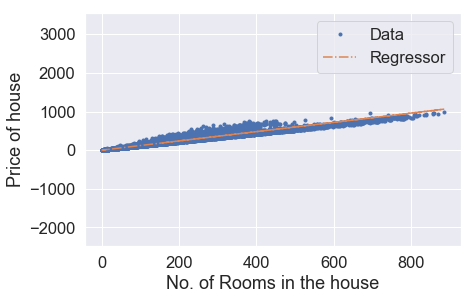

Iteration: 3961,Cost = 942.519884610005,theta = [0.21224267 1.19809621]
Iteration: 3961,Cost_val = 946.7933732889978,theta = [0.21224267 1.19809621]


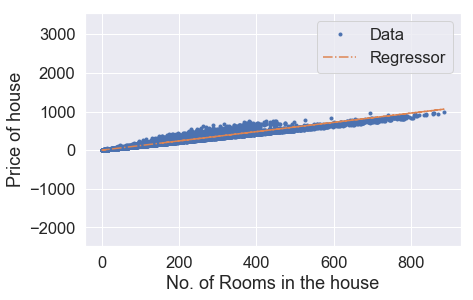

Iteration: 3971,Cost = 942.5173057883065,theta = [0.21275049 1.19809454]
Iteration: 3971,Cost_val = 946.7908390513461,theta = [0.21275049 1.19809454]


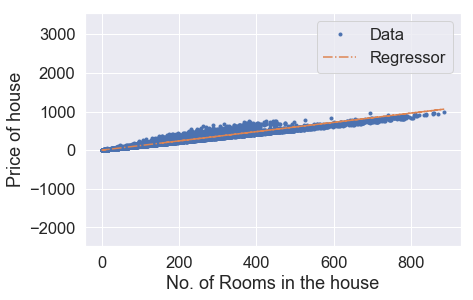

Iteration: 3981,Cost = 942.5147272212508,theta = [0.21325828 1.19809288]
Iteration: 3981,Cost_val = 946.7883050634987,theta = [0.21325828 1.19809288]


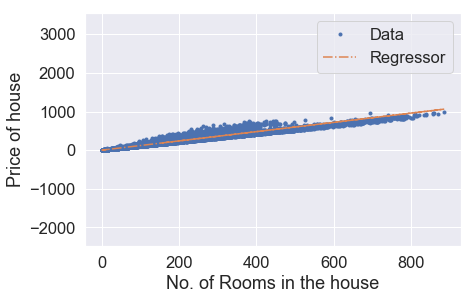

Iteration: 3991,Cost = 942.5121489088187,theta = [0.21376605 1.19809121]
Iteration: 3991,Cost_val = 946.7857713254251,theta = [0.21376605 1.19809121]


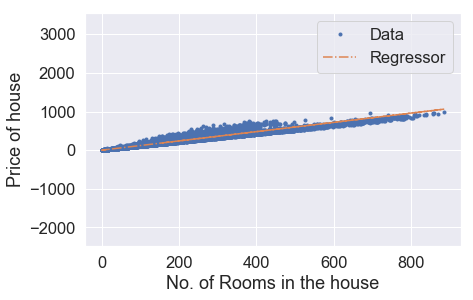

Iteration: 4001,Cost = 942.5095708509848,theta = [0.2142738  1.19808955]
Iteration: 4001,Cost_val = 946.7832378370988,theta = [0.2142738  1.19808955]


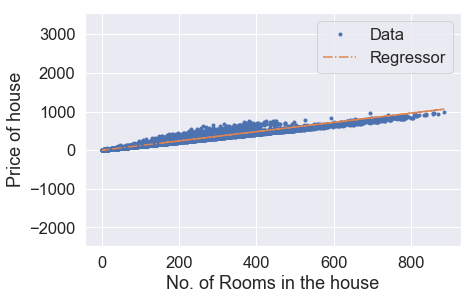

Iteration: 4011,Cost = 942.506993047726,theta = [0.21478152 1.19808788]
Iteration: 4011,Cost_val = 946.7807045985002,theta = [0.21478152 1.19808788]


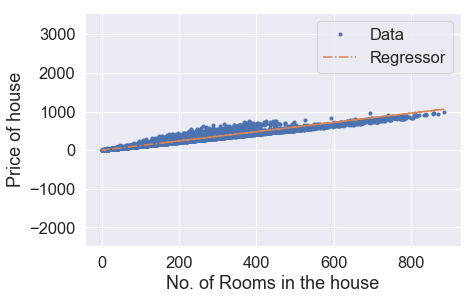

Iteration: 4021,Cost = 942.5044154990061,theta = [0.21528921 1.19808622]
Iteration: 4021,Cost_val = 946.7781716096002,theta = [0.21528921 1.19808622]


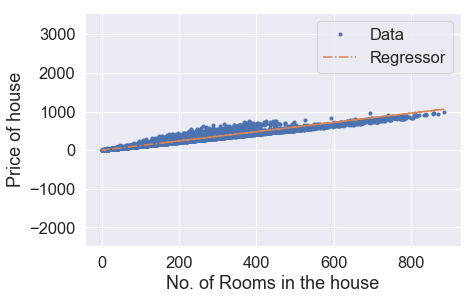

Iteration: 4031,Cost = 942.5018382048056,theta = [0.21579688 1.19808455]
Iteration: 4031,Cost_val = 946.7756388703805,theta = [0.21579688 1.19808455]


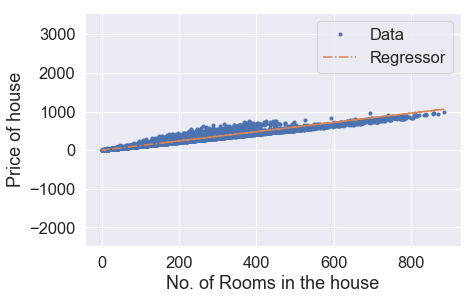

Iteration: 4041,Cost = 942.4992611651015,theta = [0.21630452 1.19808289]
Iteration: 4041,Cost_val = 946.773106380814,theta = [0.21630452 1.19808289]


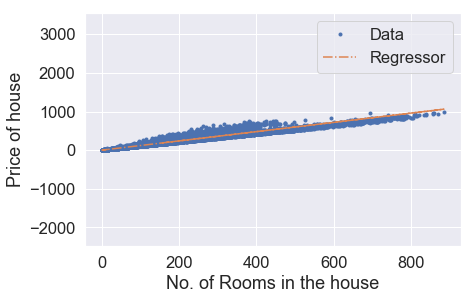

Iteration: 4051,Cost = 942.4966843798837,theta = [0.21681214 1.19808122]
Iteration: 4051,Cost_val = 946.7705741408682,theta = [0.21681214 1.19808122]


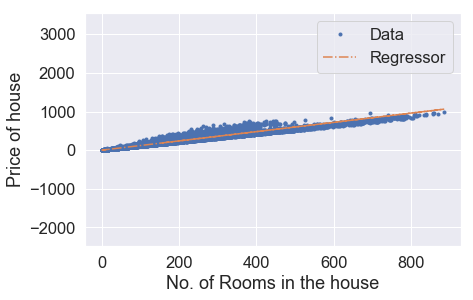

Iteration: 4061,Cost = 942.4941078491031,theta = [0.21731973 1.19807956]
Iteration: 4061,Cost_val = 946.7680421505297,theta = [0.21731973 1.19807956]


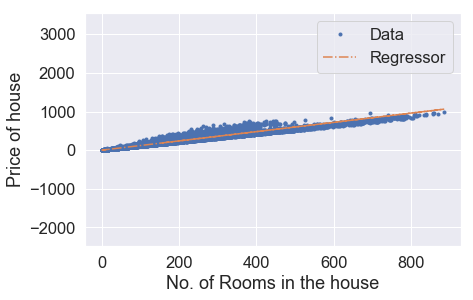

Iteration: 4071,Cost = 942.4915315727472,theta = [0.2178273 1.1980779]
Iteration: 4071,Cost_val = 946.7655104097701,theta = [0.2178273 1.1980779]


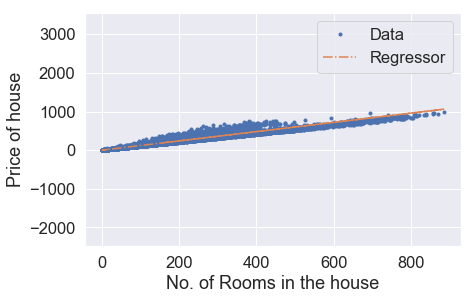

Iteration: 4081,Cost = 942.4889555507867,theta = [0.21833484 1.19807623]
Iteration: 4081,Cost_val = 946.7629789185615,theta = [0.21833484 1.19807623]


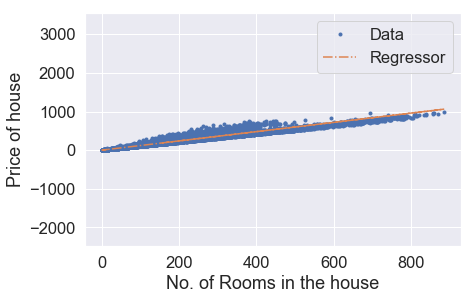

Iteration: 4091,Cost = 942.4863797832015,theta = [0.21884236 1.19807457]
Iteration: 4091,Cost_val = 946.7604476768774,theta = [0.21884236 1.19807457]


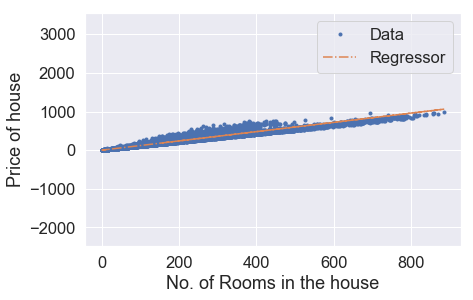

Iteration: 4101,Cost = 942.4838042699529,theta = [0.21934985 1.1980729 ]
Iteration: 4101,Cost_val = 946.757916684707,theta = [0.21934985 1.1980729 ]


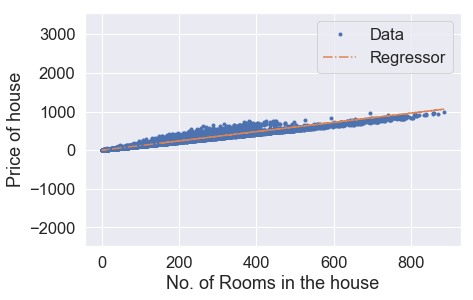

Iteration: 4111,Cost = 942.4812290110252,theta = [0.21985732 1.19807124]
Iteration: 4111,Cost_val = 946.755385942011,theta = [0.21985732 1.19807124]


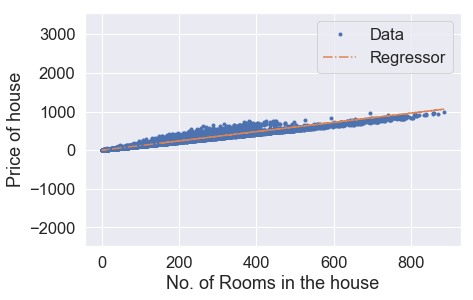

Iteration: 4121,Cost = 942.4786540063942,theta = [0.22036477 1.19806958]
Iteration: 4121,Cost_val = 946.7528554487662,theta = [0.22036477 1.19806958]


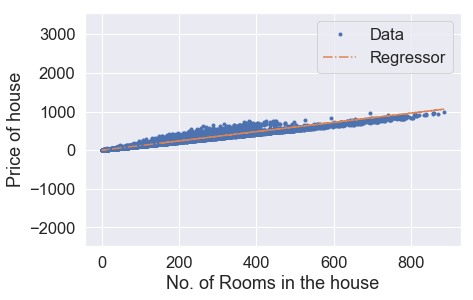

Iteration: 4131,Cost = 942.4760792560394,theta = [0.22087218 1.19806791]
Iteration: 4131,Cost_val = 946.7503252049571,theta = [0.22087218 1.19806791]


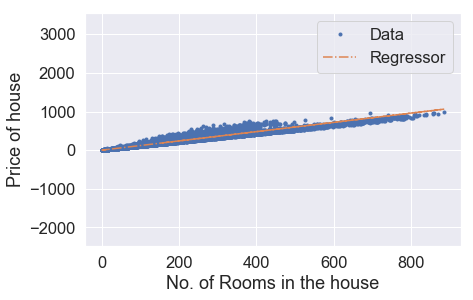

Iteration: 4141,Cost = 942.4735047599248,theta = [0.22137958 1.19806625]
Iteration: 4141,Cost_val = 946.74779521055,theta = [0.22137958 1.19806625]


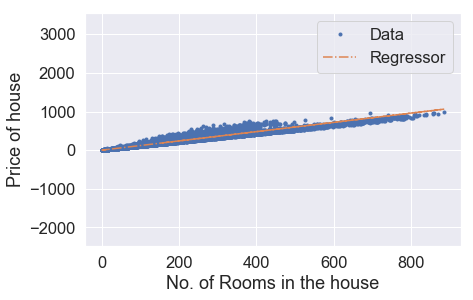

Iteration: 4151,Cost = 942.4709305180296,theta = [0.22188694 1.19806458]
Iteration: 4151,Cost_val = 946.7452654655305,theta = [0.22188694 1.19806458]


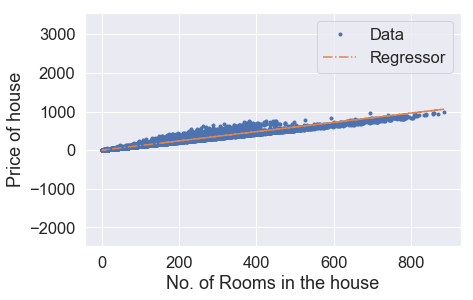

Iteration: 4161,Cost = 942.4683565303383,theta = [0.22239429 1.19806292]
Iteration: 4161,Cost_val = 946.742735969856,theta = [0.22239429 1.19806292]


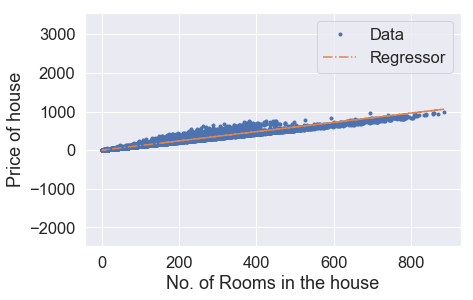

Iteration: 4171,Cost = 942.4657827968084,theta = [0.2229016  1.19806126]
Iteration: 4171,Cost_val = 946.7402067235263,theta = [0.2229016  1.19806126]


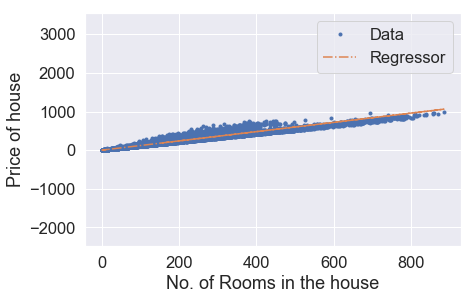

Iteration: 4181,Cost = 942.4632093174243,theta = [0.2234089  1.19805959]
Iteration: 4181,Cost_val = 946.7376777264988,theta = [0.2234089  1.19805959]


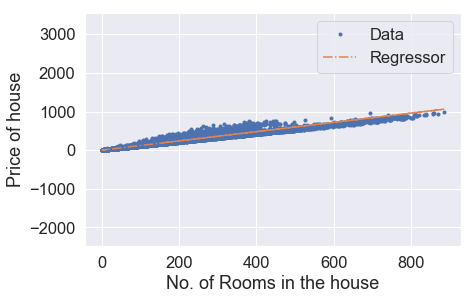

Iteration: 4191,Cost = 942.460636092162,theta = [0.22391616 1.19805793]
Iteration: 4191,Cost_val = 946.7351489787535,theta = [0.22391616 1.19805793]


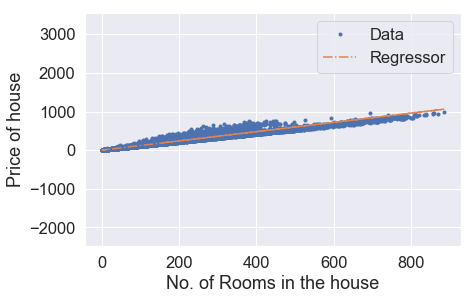

Iteration: 4201,Cost = 942.4580631209896,theta = [0.22442341 1.19805627]
Iteration: 4201,Cost_val = 946.7326204802628,theta = [0.22442341 1.19805627]


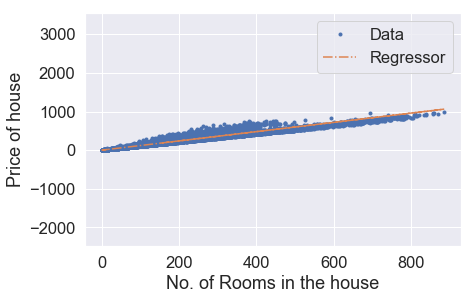

Iteration: 4211,Cost = 942.4554904038911,theta = [0.22493062 1.1980546 ]
Iteration: 4211,Cost_val = 946.7300922310103,theta = [0.22493062 1.1980546 ]


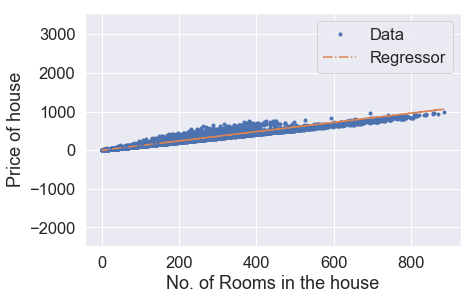

Iteration: 4221,Cost = 942.4529179408385,theta = [0.22543782 1.19805294]
Iteration: 4221,Cost_val = 946.727564230966,theta = [0.22543782 1.19805294]


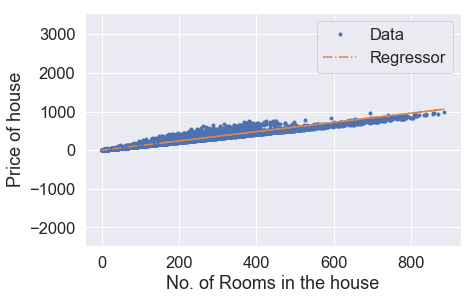

Iteration: 4231,Cost = 942.4503457318107,theta = [0.22594498 1.19805128]
Iteration: 4231,Cost_val = 946.7250364801043,theta = [0.22594498 1.19805128]


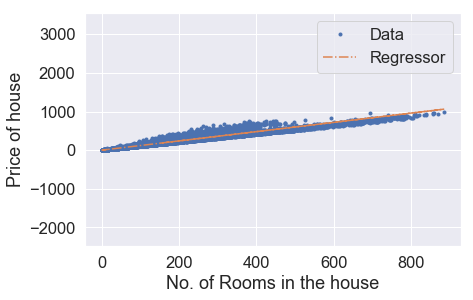

Iteration: 4241,Cost = 942.4477737767588,theta = [0.22645213 1.19804961]
Iteration: 4241,Cost_val = 946.7225089784025,theta = [0.22645213 1.19804961]


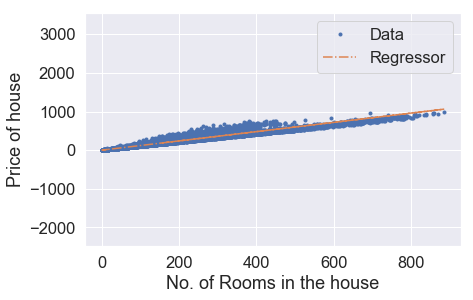

Iteration: 4251,Cost = 942.445202075687,theta = [0.22695924 1.19804795]
Iteration: 4251,Cost_val = 946.719981725834,theta = [0.22695924 1.19804795]


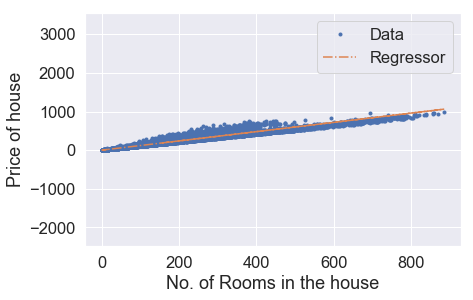

Iteration: 4261,Cost = 942.44263062857,theta = [0.22746634 1.19804629]
Iteration: 4261,Cost_val = 946.7174547223816,theta = [0.22746634 1.19804629]


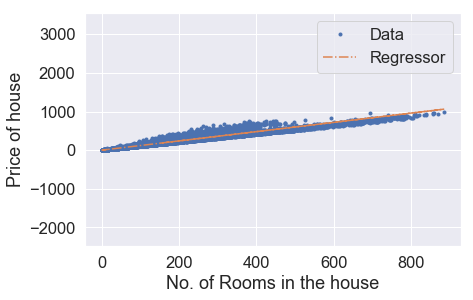

Iteration: 4271,Cost = 942.440059435361,theta = [0.2279734  1.19804463]
Iteration: 4271,Cost_val = 946.7149279680128,theta = [0.2279734  1.19804463]


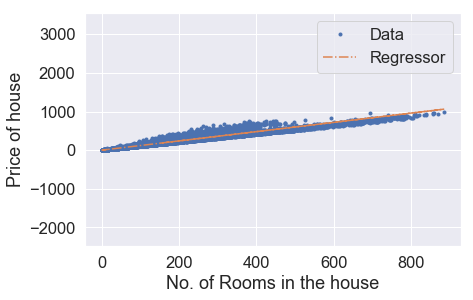

Iteration: 4281,Cost = 942.4374884960525,theta = [0.22848045 1.19804296]
Iteration: 4281,Cost_val = 946.7124014627001,theta = [0.22848045 1.19804296]


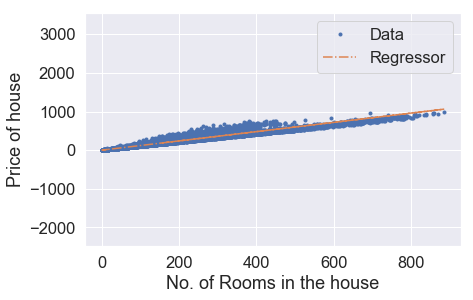

Iteration: 4291,Cost = 942.4349178106048,theta = [0.22898746 1.1980413 ]
Iteration: 4291,Cost_val = 946.7098752064279,theta = [0.22898746 1.1980413 ]


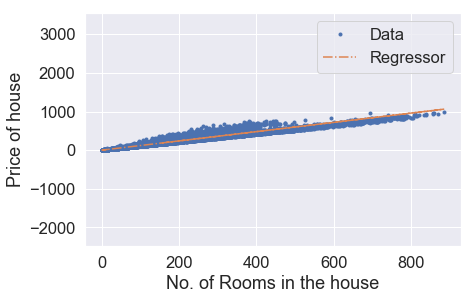

Iteration: 4301,Cost = 942.4323473790089,theta = [0.22949446 1.19803964]
Iteration: 4301,Cost_val = 946.7073491991731,theta = [0.22949446 1.19803964]


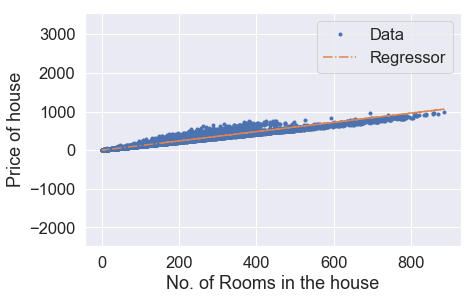

Iteration: 4311,Cost = 942.4297772012268,theta = [0.23000142 1.19803798]
Iteration: 4311,Cost_val = 946.7048234408983,theta = [0.23000142 1.19803798]


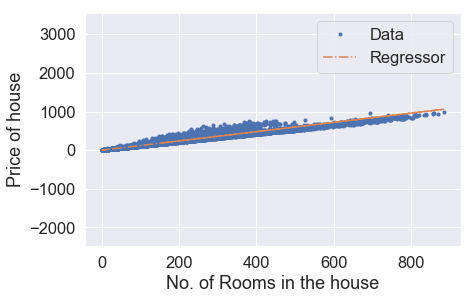

Iteration: 4321,Cost = 942.4272072772386,theta = [0.23050836 1.19803631]
Iteration: 4321,Cost_val = 946.7022979315916,theta = [0.23050836 1.19803631]


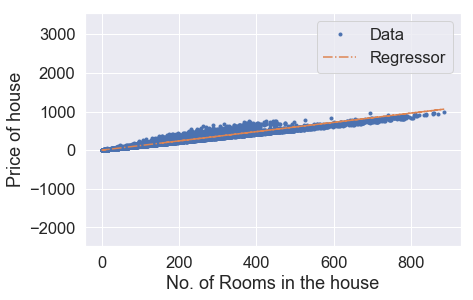

Iteration: 4331,Cost = 942.4246376070245,theta = [0.23101528 1.19803465]
Iteration: 4331,Cost_val = 946.699772671221,theta = [0.23101528 1.19803465]


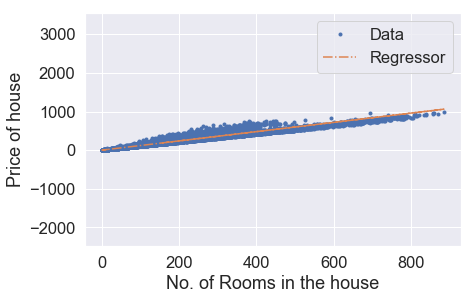

Iteration: 4341,Cost = 942.4220681905479,theta = [0.23152217 1.19803299]
Iteration: 4341,Cost_val = 946.6972476597659,theta = [0.23152217 1.19803299]


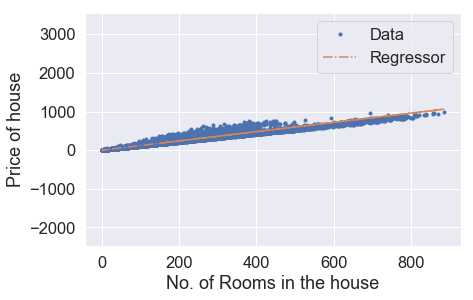

Iteration: 4351,Cost = 942.4194990278013,theta = [0.23202904 1.19803133]
Iteration: 4351,Cost_val = 946.6947228972022,theta = [0.23202904 1.19803133]


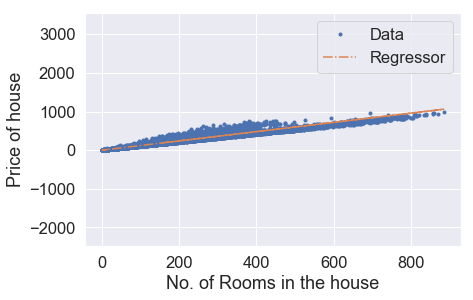

Iteration: 4361,Cost = 942.4169301187325,theta = [0.23253588 1.19802967]
Iteration: 4361,Cost_val = 946.6921983834983,theta = [0.23253588 1.19802967]


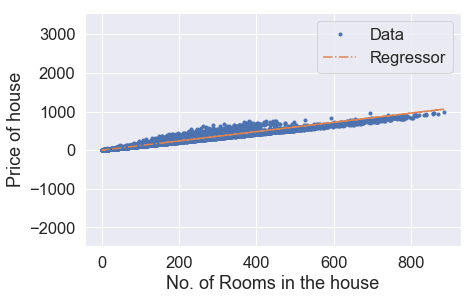

Iteration: 4371,Cost = 942.4143614633439,theta = [0.2330427 1.198028 ]
Iteration: 4371,Cost_val = 946.6896741186375,theta = [0.2330427 1.198028 ]


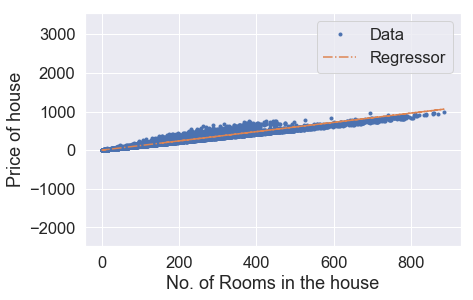

Iteration: 4381,Cost = 942.4117930615912,theta = [0.23354949 1.19802634]
Iteration: 4381,Cost_val = 946.6871501025914,theta = [0.23354949 1.19802634]


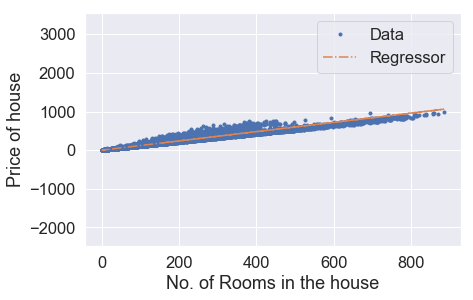

Iteration: 4391,Cost = 942.4092249134643,theta = [0.23405626 1.19802468]
Iteration: 4391,Cost_val = 946.684626335338,theta = [0.23405626 1.19802468]


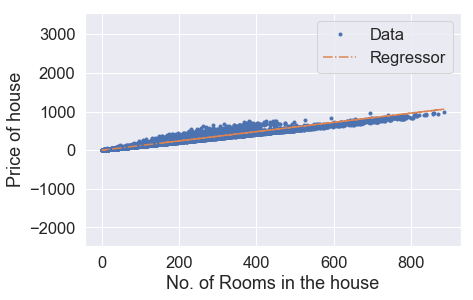

Iteration: 4401,Cost = 942.4066570189203,theta = [0.234563   1.19802302]
Iteration: 4401,Cost_val = 946.6821028168507,theta = [0.234563   1.19802302]


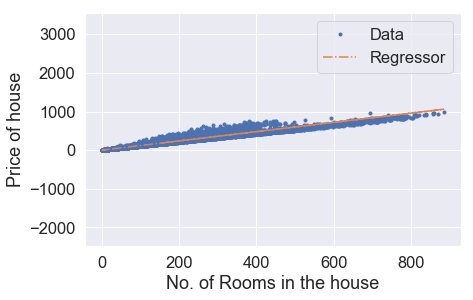

Iteration: 4411,Cost = 942.4040893779552,theta = [0.23506972 1.19802136]
Iteration: 4411,Cost_val = 946.6795795471044,theta = [0.23506972 1.19802136]


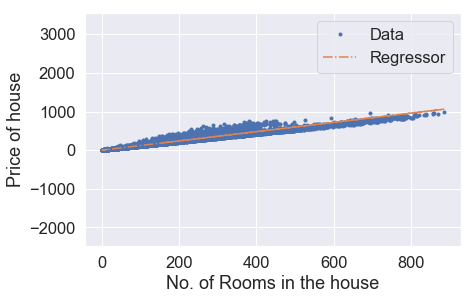

Iteration: 4421,Cost = 942.4015219905253,theta = [0.23557641 1.1980197 ]
Iteration: 4421,Cost_val = 946.6770565260761,theta = [0.23557641 1.1980197 ]


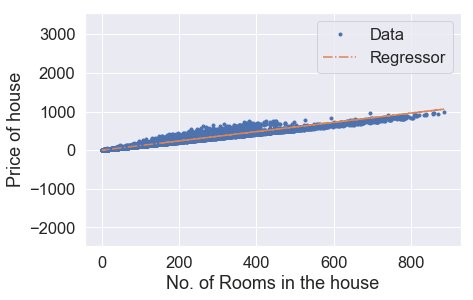

Iteration: 4431,Cost = 942.3989548566209,theta = [0.23608308 1.19801803]
Iteration: 4431,Cost_val = 946.6745337537436,theta = [0.23608308 1.19801803]


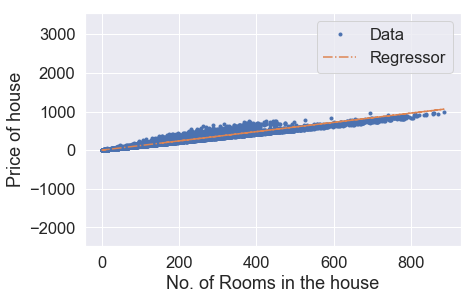

Iteration: 4441,Cost = 942.3963879762064,theta = [0.23658972 1.19801637]
Iteration: 4441,Cost_val = 946.672011230075,theta = [0.23658972 1.19801637]


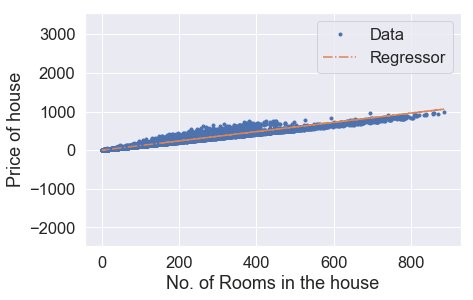

Iteration: 4451,Cost = 942.393821349263,theta = [0.23709633 1.19801471]
Iteration: 4451,Cost_val = 946.6694889550532,theta = [0.23709633 1.19801471]


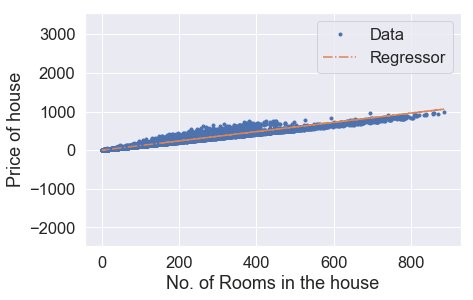

Iteration: 4461,Cost = 942.3912549757554,theta = [0.23760293 1.19801305]
Iteration: 4461,Cost_val = 946.6669669286525,theta = [0.23760293 1.19801305]


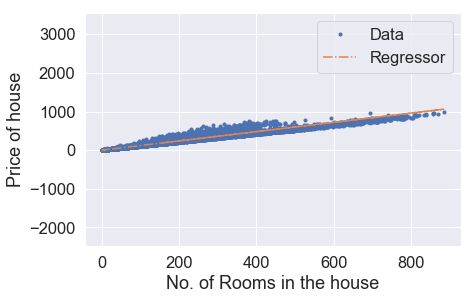

Iteration: 4471,Cost = 942.3886888556774,theta = [0.23810949 1.19801139]
Iteration: 4471,Cost_val = 946.6644451508441,theta = [0.23810949 1.19801139]


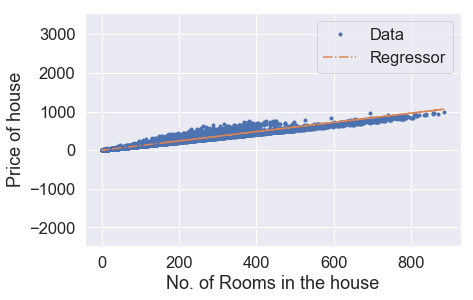

Iteration: 4481,Cost = 942.3861229889965,theta = [0.23861603 1.19800973]
Iteration: 4481,Cost_val = 946.6619236216065,theta = [0.23861603 1.19800973]


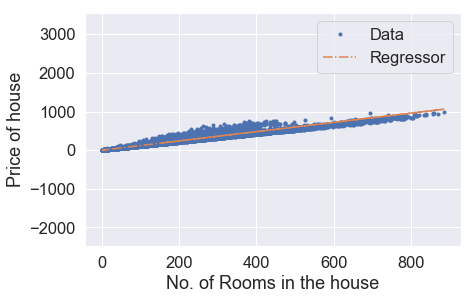

Iteration: 4491,Cost = 942.3835573756618,theta = [0.23912255 1.19800807]
Iteration: 4491,Cost_val = 946.6594023409178,theta = [0.23912255 1.19800807]


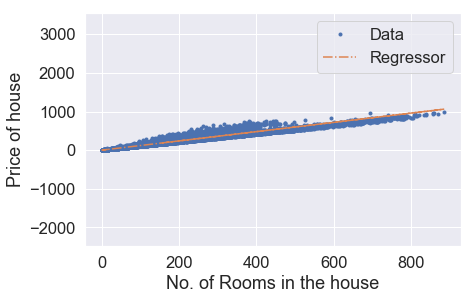

Iteration: 4501,Cost = 942.380992015679,theta = [0.23962904 1.19800641]
Iteration: 4501,Cost_val = 946.65688130875,theta = [0.23962904 1.19800641]


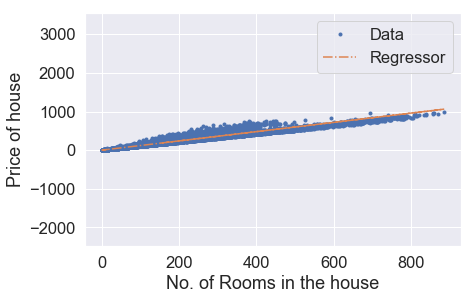

Iteration: 4511,Cost = 942.378426909027,theta = [0.24013551 1.19800475]
Iteration: 4511,Cost_val = 946.6543605250755,theta = [0.24013551 1.19800475]


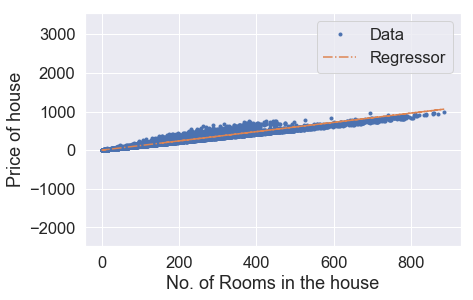

Iteration: 4521,Cost = 942.3758620556519,theta = [0.24064195 1.19800309]
Iteration: 4521,Cost_val = 946.6518399898711,theta = [0.24064195 1.19800309]


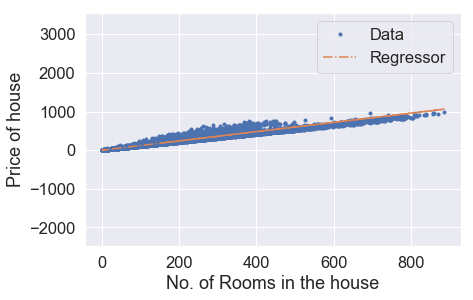

Iteration: 4531,Cost = 942.3732974555596,theta = [0.24114837 1.19800142]
Iteration: 4531,Cost_val = 946.6493197031209,theta = [0.24114837 1.19800142]


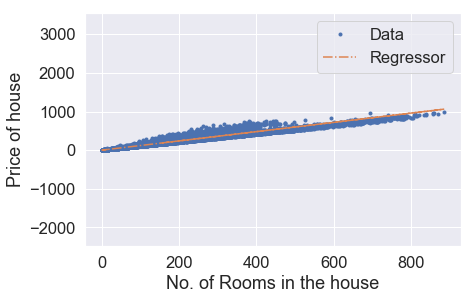

Iteration: 4541,Cost = 942.3707331087004,theta = [0.24165476 1.19799976]
Iteration: 4541,Cost_val = 946.6467996647892,theta = [0.24165476 1.19799976]


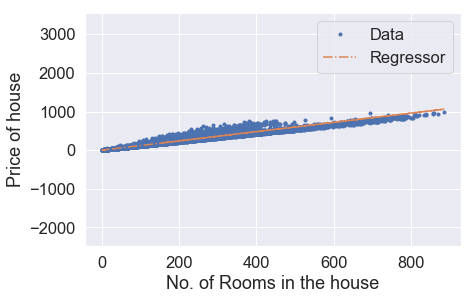

Iteration: 4551,Cost = 942.3681690150585,theta = [0.24216113 1.1979981 ]
Iteration: 4551,Cost_val = 946.6442798748623,theta = [0.24216113 1.1979981 ]


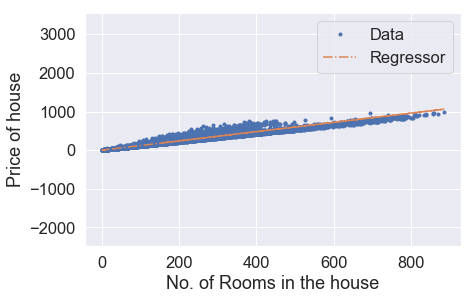

Iteration: 4561,Cost = 942.3656051746142,theta = [0.24266747 1.19799644]
Iteration: 4561,Cost_val = 946.6417603333041,theta = [0.24266747 1.19799644]


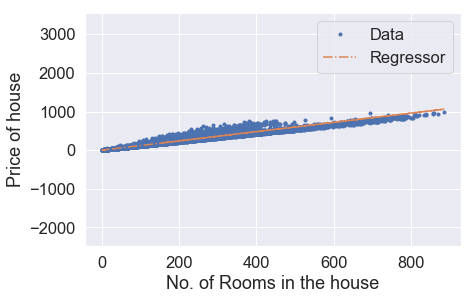

Iteration: 4571,Cost = 942.3630415873425,theta = [0.24317379 1.19799478]
Iteration: 4571,Cost_val = 946.6392410400957,theta = [0.24317379 1.19799478]


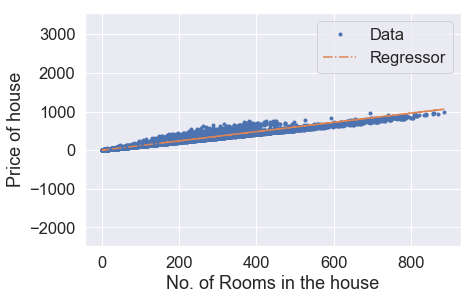

Iteration: 4581,Cost = 942.3604782532019,theta = [0.24368008 1.19799312]
Iteration: 4581,Cost_val = 946.6367219952143,theta = [0.24368008 1.19799312]


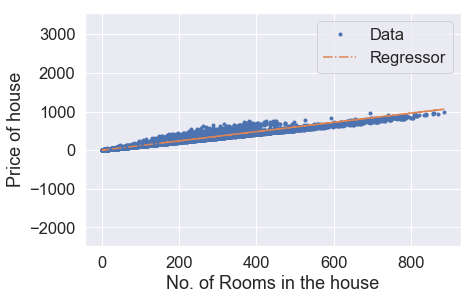

Iteration: 4591,Cost = 942.3579151721885,theta = [0.24418634 1.19799146]
Iteration: 4591,Cost_val = 946.6342031986375,theta = [0.24418634 1.19799146]


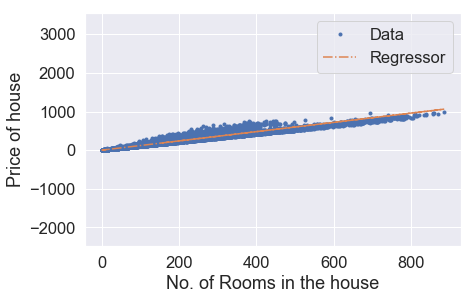

Iteration: 4601,Cost = 942.3553523442662,theta = [0.24469259 1.1979898 ]
Iteration: 4601,Cost_val = 946.6316846503289,theta = [0.24469259 1.1979898 ]


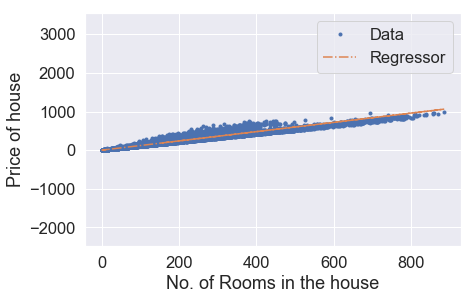

Iteration: 4611,Cost = 942.3527897694057,theta = [0.2451988  1.19798814]
Iteration: 4611,Cost_val = 946.6291663502786,theta = [0.2451988  1.19798814]


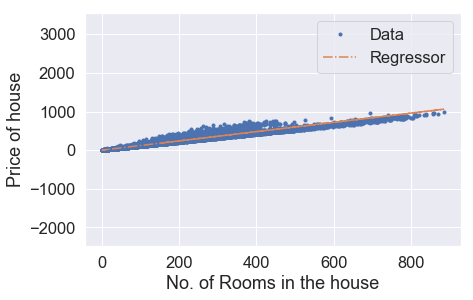

Iteration: 4621,Cost = 942.3502274476075,theta = [0.24570499 1.19798648]
Iteration: 4621,Cost_val = 946.6266482984533,theta = [0.24570499 1.19798648]


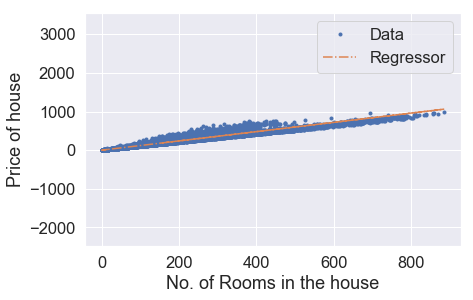

Iteration: 4631,Cost = 942.3476653788005,theta = [0.24621116 1.19798482]
Iteration: 4631,Cost_val = 946.6241304948323,theta = [0.24621116 1.19798482]


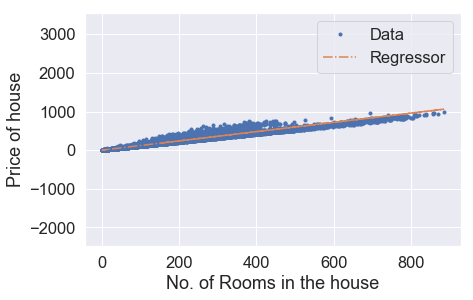

Iteration: 4641,Cost = 942.3451035630056,theta = [0.2467173  1.19798316]
Iteration: 4641,Cost_val = 946.6216129393879,theta = [0.2467173  1.19798316]


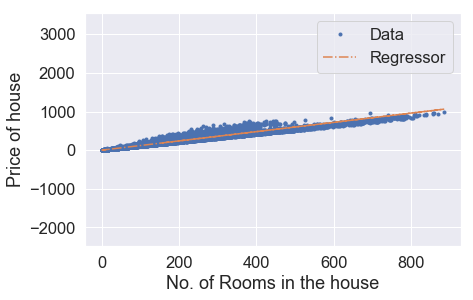

Iteration: 4651,Cost = 942.3425420001648,theta = [0.24722342 1.1979815 ]
Iteration: 4651,Cost_val = 946.6190956321003,theta = [0.24722342 1.1979815 ]


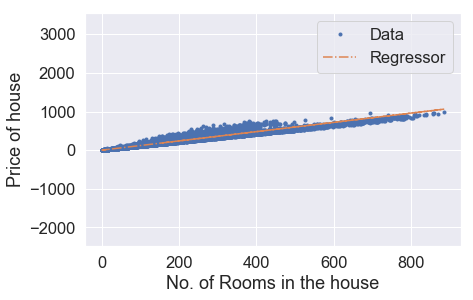

Iteration: 4661,Cost = 942.3399806902834,theta = [0.24772951 1.19797985]
Iteration: 4661,Cost_val = 946.6165785729346,theta = [0.24772951 1.19797985]


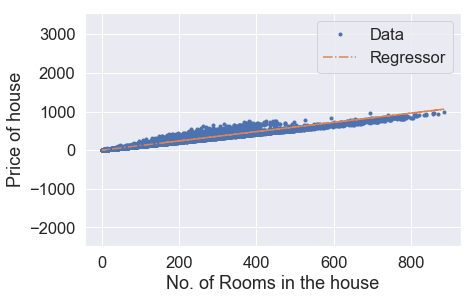

Iteration: 4671,Cost = 942.3374196333153,theta = [0.24823558 1.19797819]
Iteration: 4671,Cost_val = 946.6140617618834,theta = [0.24823558 1.19797819]


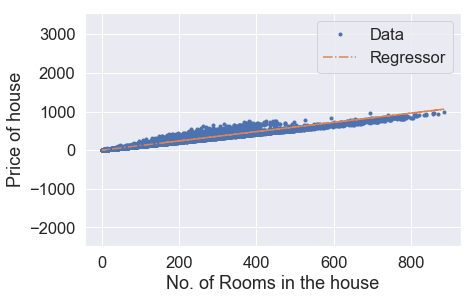

Iteration: 4681,Cost = 942.3348588292313,theta = [0.24874162 1.19797653]
Iteration: 4681,Cost_val = 946.6115451989048,theta = [0.24874162 1.19797653]


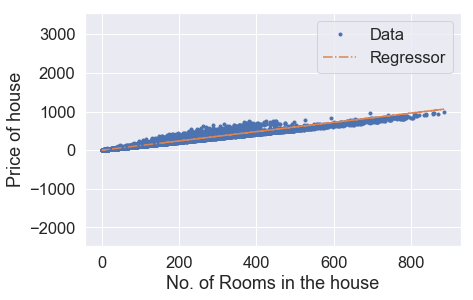

Iteration: 4691,Cost = 942.3322982780313,theta = [0.24924764 1.19797487]
Iteration: 4691,Cost_val = 946.609028883991,theta = [0.24924764 1.19797487]


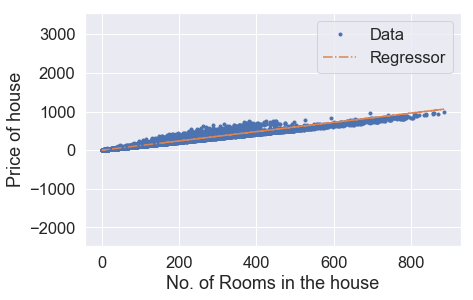

Iteration: 4701,Cost = 942.3297379796606,theta = [0.24975363 1.19797321]
Iteration: 4701,Cost_val = 946.6065128170995,theta = [0.24975363 1.19797321]


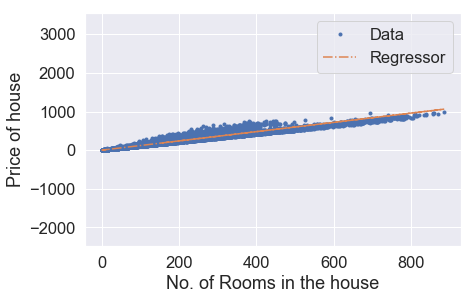

Iteration: 4711,Cost = 942.3271779341167,theta = [0.25025959 1.19797155]
Iteration: 4711,Cost_val = 946.6039969982196,theta = [0.25025959 1.19797155]


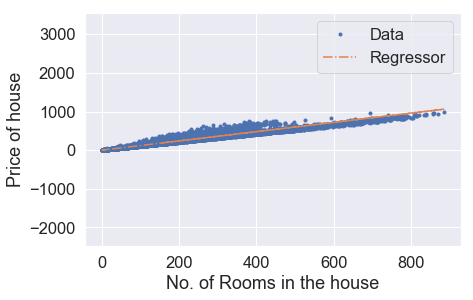

Iteration: 4721,Cost = 942.3246181413609,theta = [0.25076554 1.19796989]
Iteration: 4721,Cost_val = 946.6014814273199,theta = [0.25076554 1.19796989]


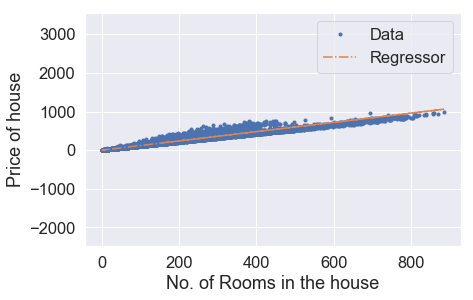

Iteration: 4731,Cost = 942.3220586013845,theta = [0.25127145 1.19796823]
Iteration: 4731,Cost_val = 946.5989661043789,theta = [0.25127145 1.19796823]


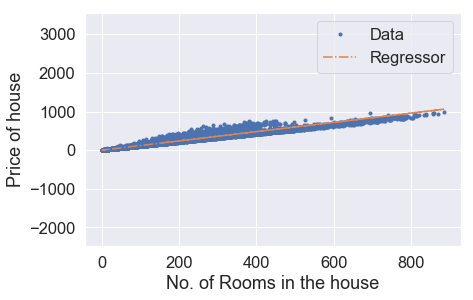

Iteration: 4741,Cost = 942.3194993141328,theta = [0.25177735 1.19796657]
Iteration: 4741,Cost_val = 946.5964510293742,theta = [0.25177735 1.19796657]


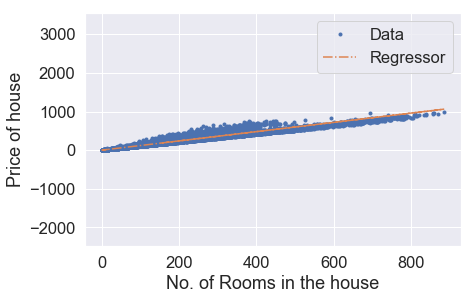

Iteration: 4751,Cost = 942.3169402796067,theta = [0.25228321 1.19796491]
Iteration: 4751,Cost_val = 946.5939362022749,theta = [0.25228321 1.19796491]


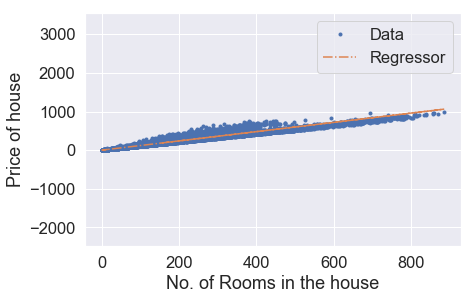

Iteration: 4761,Cost = 942.3143814977699,theta = [0.25278905 1.19796325]
Iteration: 4761,Cost_val = 946.5914216230655,theta = [0.25278905 1.19796325]


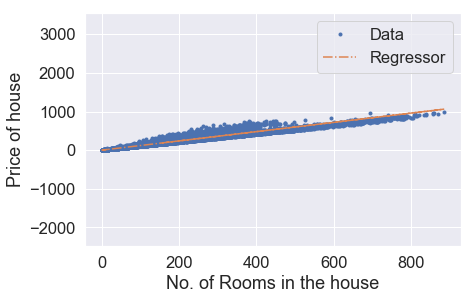

Iteration: 4771,Cost = 942.3118229686169,theta = [0.25329487 1.1979616 ]
Iteration: 4771,Cost_val = 946.5889072917095,theta = [0.25329487 1.1979616 ]


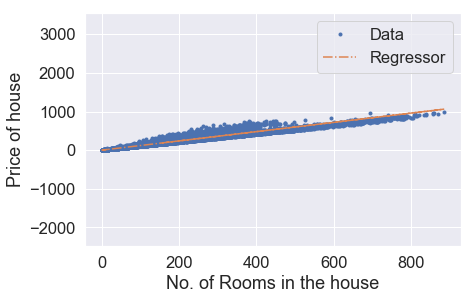

Iteration: 4781,Cost = 942.3092646921077,theta = [0.25380066 1.19795994]
Iteration: 4781,Cost_val = 946.5863932081937,theta = [0.25380066 1.19795994]


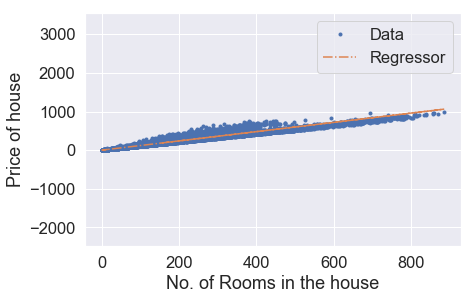

Iteration: 4791,Cost = 942.3067066682047,theta = [0.25430643 1.19795828]
Iteration: 4791,Cost_val = 946.5838793724851,theta = [0.25430643 1.19795828]


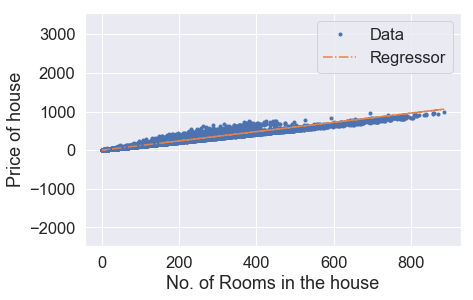

Iteration: 4801,Cost = 942.304148896894,theta = [0.25481217 1.19795662]
Iteration: 4801,Cost_val = 946.5813657845696,theta = [0.25481217 1.19795662]


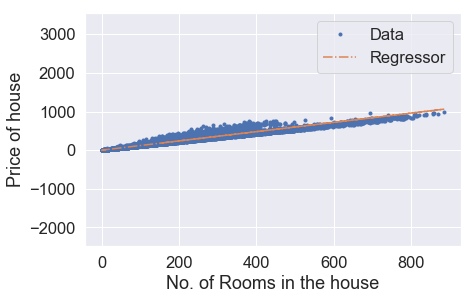

Iteration: 4811,Cost = 942.3015913781546,theta = [0.25531789 1.19795496]
Iteration: 4811,Cost_val = 946.5788524444091,theta = [0.25531789 1.19795496]


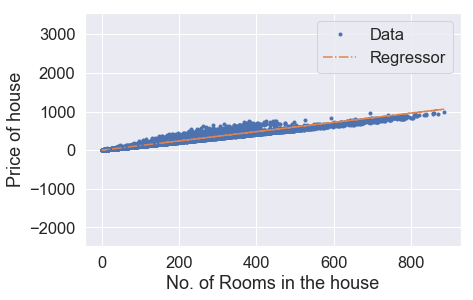

Iteration: 4821,Cost = 942.2990341119561,theta = [0.25582358 1.1979533 ]
Iteration: 4821,Cost_val = 946.5763393519971,theta = [0.25582358 1.1979533 ]


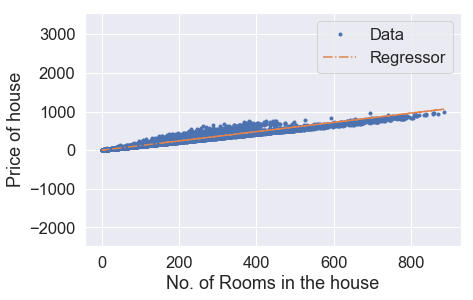

Iteration: 4831,Cost = 942.296477098288,theta = [0.25632925 1.19795165]
Iteration: 4831,Cost_val = 946.5738265072888,theta = [0.25632925 1.19795165]


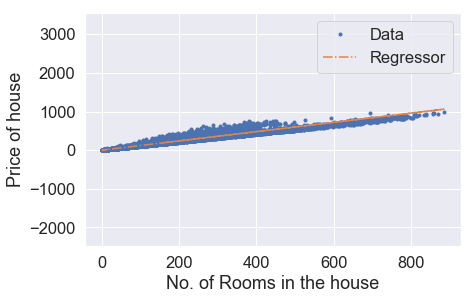

Iteration: 4841,Cost = 942.2939203371135,theta = [0.25683489 1.19794999]
Iteration: 4841,Cost_val = 946.5713139102692,theta = [0.25683489 1.19794999]


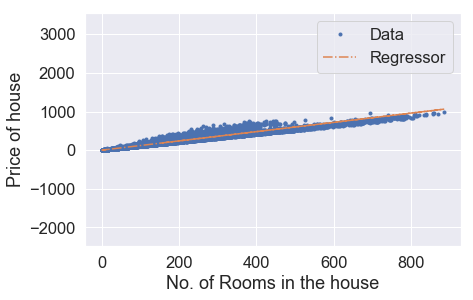

Iteration: 4851,Cost = 942.2913638283926,theta = [0.25734051 1.19794833]
Iteration: 4851,Cost_val = 946.5688015609221,theta = [0.25734051 1.19794833]


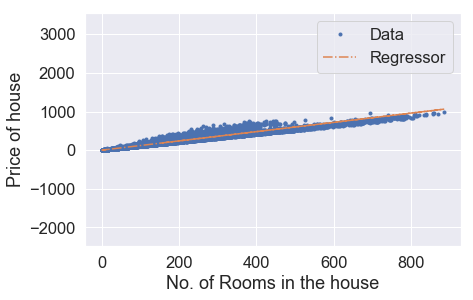

Iteration: 4861,Cost = 942.2888075721262,theta = [0.2578461  1.19794667]
Iteration: 4861,Cost_val = 946.5662894592143,theta = [0.2578461  1.19794667]


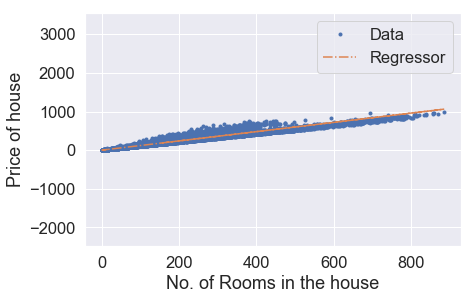

Iteration: 4871,Cost = 942.2862515682729,theta = [0.25835167 1.19794501]
Iteration: 4871,Cost_val = 946.5637776051213,theta = [0.25835167 1.19794501]


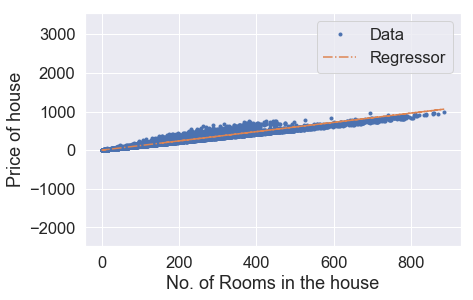

Iteration: 4881,Cost = 942.2836958168309,theta = [0.25885721 1.19794336]
Iteration: 4881,Cost_val = 946.5612659986155,theta = [0.25885721 1.19794336]


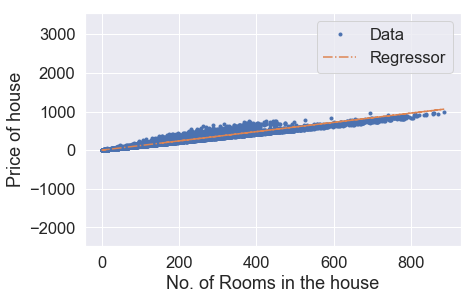

Iteration: 4891,Cost = 942.2811403177503,theta = [0.25936273 1.1979417 ]
Iteration: 4891,Cost_val = 946.5587546396778,theta = [0.25936273 1.1979417 ]


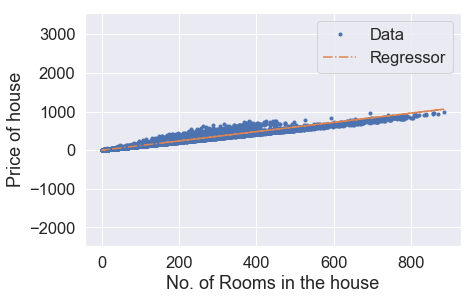

Iteration: 4901,Cost = 942.2785850710061,theta = [0.25986822 1.19794004]
Iteration: 4901,Cost_val = 946.5562435282843,theta = [0.25986822 1.19794004]


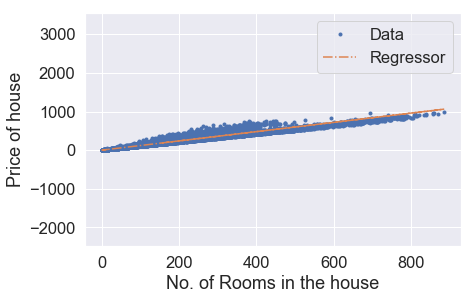

Iteration: 4911,Cost = 942.2760300765962,theta = [0.26037369 1.19793838]
Iteration: 4911,Cost_val = 946.5537326644079,theta = [0.26037369 1.19793838]


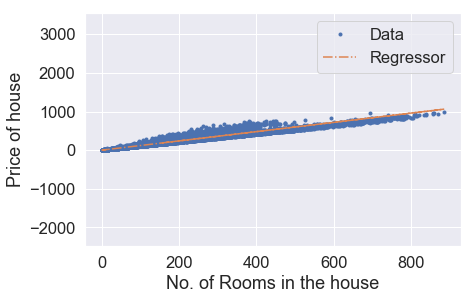

Iteration: 4921,Cost = 942.2734753344607,theta = [0.26087913 1.19793673]
Iteration: 4921,Cost_val = 946.5512220480254,theta = [0.26087913 1.19793673]


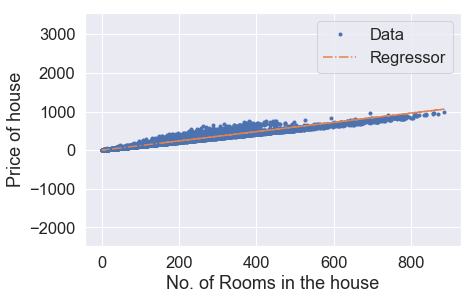

Iteration: 4931,Cost = 942.2709208446025,theta = [0.26138455 1.19793507]
Iteration: 4931,Cost_val = 946.5487116791156,theta = [0.26138455 1.19793507]


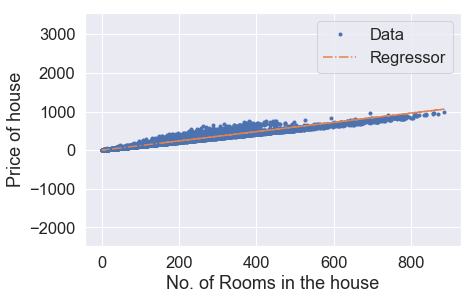

Iteration: 4941,Cost = 942.2683666069945,theta = [0.26188994 1.19793341]
Iteration: 4941,Cost_val = 946.5462015576469,theta = [0.26188994 1.19793341]


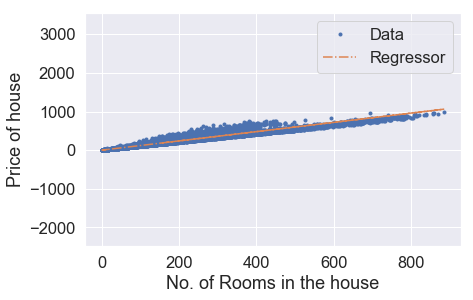

Iteration: 4951,Cost = 942.2658126215971,theta = [0.26239531 1.19793176]
Iteration: 4951,Cost_val = 946.5436916835998,theta = [0.26239531 1.19793176]


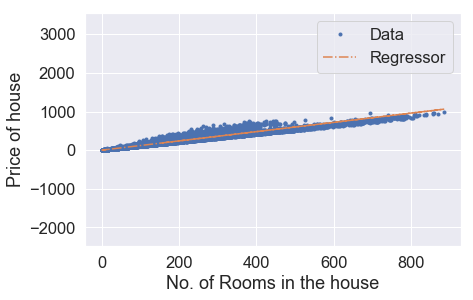

Iteration: 4961,Cost = 942.263258888401,theta = [0.26290065 1.1979301 ]
Iteration: 4961,Cost_val = 946.541182056948,theta = [0.26290065 1.1979301 ]


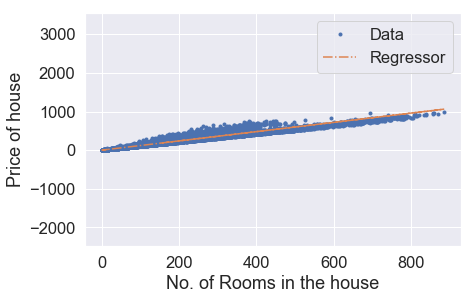

Iteration: 4971,Cost = 942.260705407385,theta = [0.26340597 1.19792844]
Iteration: 4971,Cost_val = 946.5386726776644,theta = [0.26340597 1.19792844]


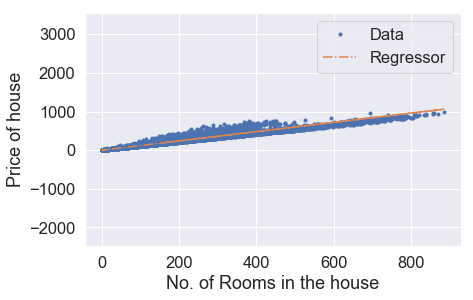

Iteration: 4981,Cost = 942.2581521784972,theta = [0.26391126 1.19792678]
Iteration: 4981,Cost_val = 946.5361635457313,theta = [0.26391126 1.19792678]


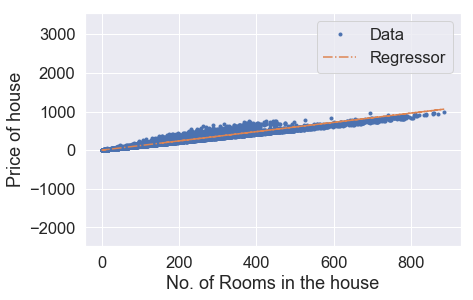

Iteration: 4991,Cost = 942.2555992017391,theta = [0.26441653 1.19792513]
Iteration: 4991,Cost_val = 946.5336546611221,theta = [0.26441653 1.19792513]


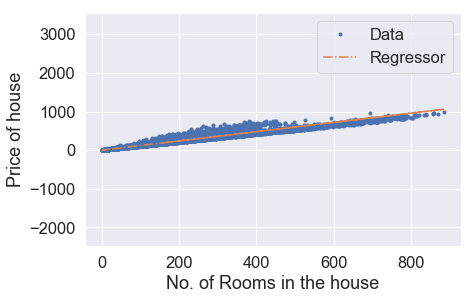

Iteration: 5001,Cost = 942.2530464770693,theta = [0.26492177 1.19792347]
Iteration: 5001,Cost_val = 946.5311460238141,theta = [0.26492177 1.19792347]


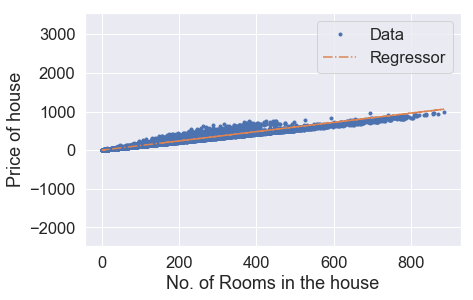

Iteration: 5011,Cost = 942.2504940044857,theta = [0.26542699 1.19792181]
Iteration: 5011,Cost_val = 946.5286376337725,theta = [0.26542699 1.19792181]


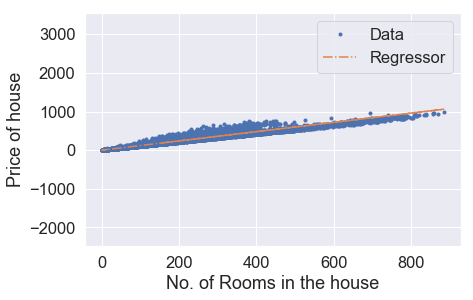

Iteration: 5021,Cost = 942.2479417839266,theta = [0.26593218 1.19792016]
Iteration: 5021,Cost_val = 946.5261294909841,theta = [0.26593218 1.19792016]


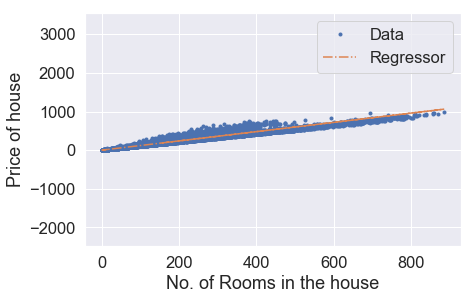

Iteration: 5031,Cost = 942.2453898154022,theta = [0.26643735 1.1979185 ]
Iteration: 5031,Cost_val = 946.5236215954253,theta = [0.26643735 1.1979185 ]


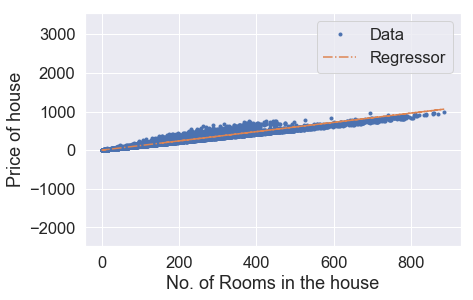

Iteration: 5041,Cost = 942.2428380988687,theta = [0.26694249 1.19791684]
Iteration: 5041,Cost_val = 946.5211139470616,theta = [0.26694249 1.19791684]


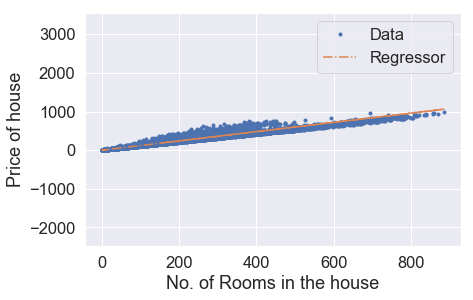

Iteration: 5051,Cost = 942.2402866343043,theta = [0.26744761 1.19791519]
Iteration: 5051,Cost_val = 946.5186065458736,theta = [0.26744761 1.19791519]


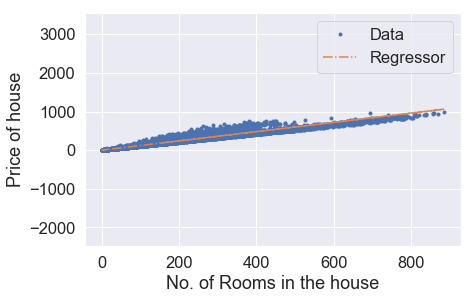

Iteration: 5061,Cost = 942.2377354216896,theta = [0.2679527  1.19791353]
Iteration: 5061,Cost_val = 946.5160993918375,theta = [0.2679527  1.19791353]


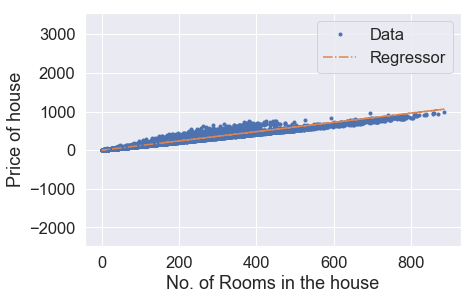

Iteration: 5071,Cost = 942.235184460997,theta = [0.26845777 1.19791188]
Iteration: 5071,Cost_val = 946.5135924849391,theta = [0.26845777 1.19791188]


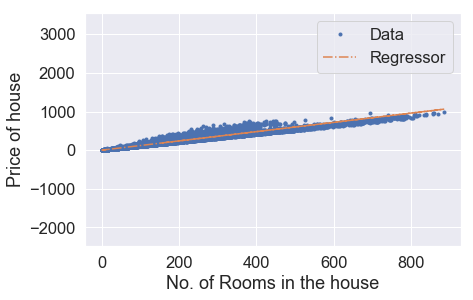

Iteration: 5081,Cost = 942.2326337521993,theta = [0.26896282 1.19791022]
Iteration: 5081,Cost_val = 946.5110858251348,theta = [0.26896282 1.19791022]


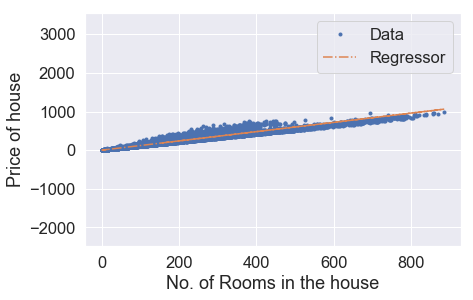

Iteration: 5091,Cost = 942.2300832952691,theta = [0.26946783 1.19790856]
Iteration: 5091,Cost_val = 946.5085794124105,theta = [0.26946783 1.19790856]


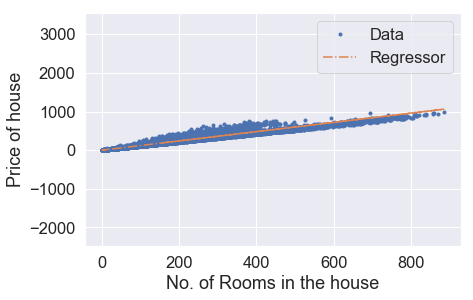

Iteration: 5101,Cost = 942.2275330901941,theta = [0.26997283 1.19790691]
Iteration: 5101,Cost_val = 946.5060732467435,theta = [0.26997283 1.19790691]


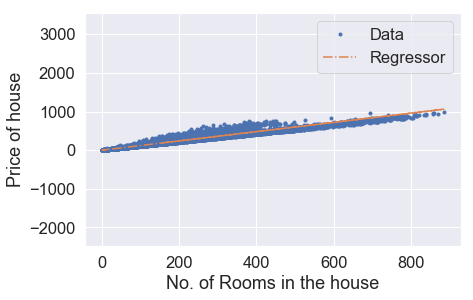

Iteration: 5111,Cost = 942.2249831369306,theta = [0.2704778  1.19790525]
Iteration: 5111,Cost_val = 946.5035673281058,theta = [0.2704778  1.19790525]


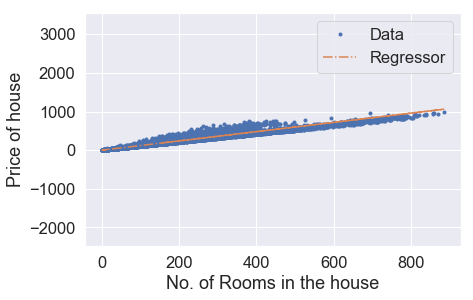

Iteration: 5121,Cost = 942.2224334354631,theta = [0.27098274 1.1979036 ]
Iteration: 5121,Cost_val = 946.5010616564703,theta = [0.27098274 1.1979036 ]


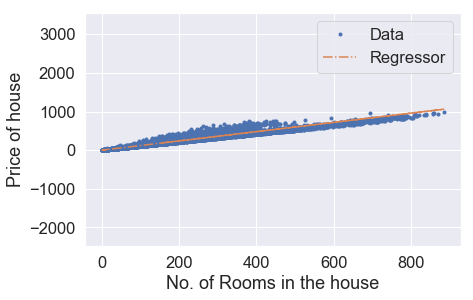

Iteration: 5131,Cost = 942.2198839857828,theta = [0.27148766 1.19790194]
Iteration: 5131,Cost_val = 946.4985562318193,theta = [0.27148766 1.19790194]


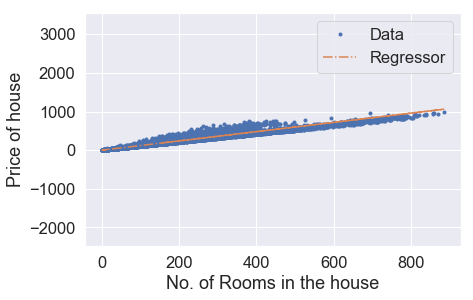

Iteration: 5141,Cost = 942.2173347878364,theta = [0.27199255 1.19790029]
Iteration: 5141,Cost_val = 946.4960510541246,theta = [0.27199255 1.19790029]


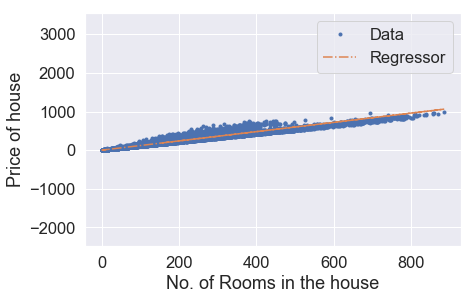

Iteration: 5151,Cost = 942.2147858416193,theta = [0.27249742 1.19789863]
Iteration: 5151,Cost_val = 946.4935461233656,theta = [0.27249742 1.19789863]


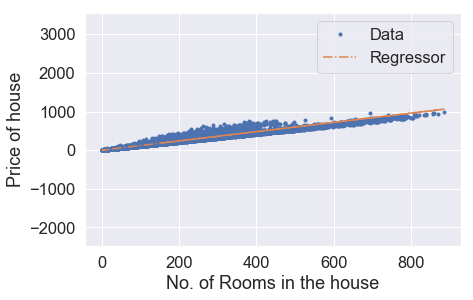

Iteration: 5161,Cost = 942.2122371470945,theta = [0.27300226 1.19789697]
Iteration: 5161,Cost_val = 946.491041439509,theta = [0.27300226 1.19789697]


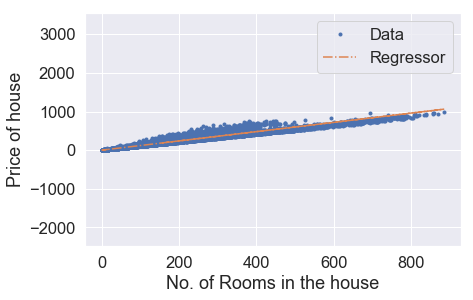

Iteration: 5171,Cost = 942.209688704234,theta = [0.27350708 1.19789532]
Iteration: 5171,Cost_val = 946.488537002543,theta = [0.27350708 1.19789532]


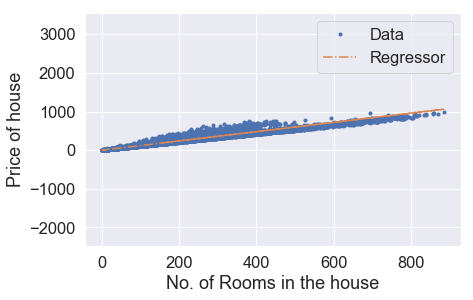

Iteration: 5181,Cost = 942.2071405130437,theta = [0.27401188 1.19789366]
Iteration: 5181,Cost_val = 946.4860328124337,theta = [0.27401188 1.19789366]


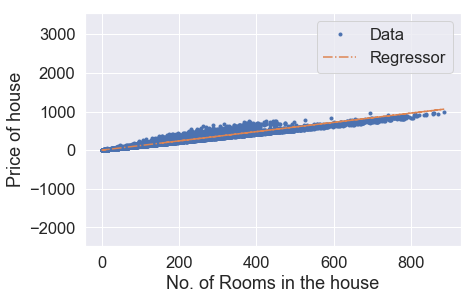

Iteration: 5191,Cost = 942.2045925734551,theta = [0.27451665 1.19789201]
Iteration: 5191,Cost_val = 946.4835288691572,theta = [0.27451665 1.19789201]


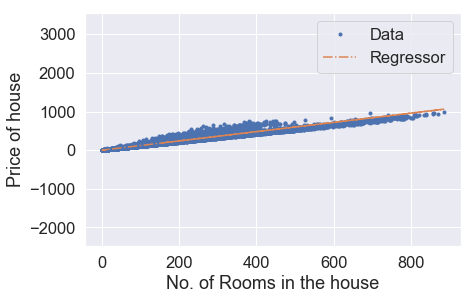

Iteration: 5201,Cost = 942.2020448854742,theta = [0.27502139 1.19789035]
Iteration: 5201,Cost_val = 946.4810251726935,theta = [0.27502139 1.19789035]


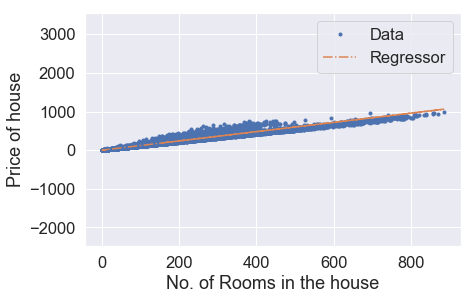

Iteration: 5211,Cost = 942.199497449078,theta = [0.27552611 1.1978887 ]
Iteration: 5211,Cost_val = 946.4785217230202,theta = [0.27552611 1.1978887 ]


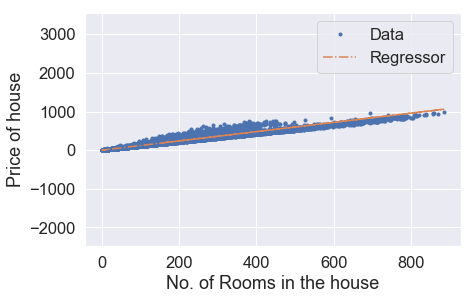

Iteration: 5221,Cost = 942.1969502642128,theta = [0.2760308  1.19788704]
Iteration: 5221,Cost_val = 946.4760185201028,theta = [0.2760308  1.19788704]


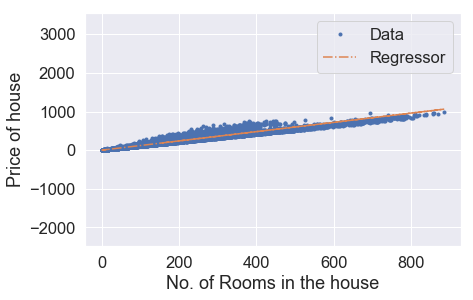

Iteration: 5231,Cost = 942.1944033308677,theta = [0.27653547 1.19788539]
Iteration: 5231,Cost_val = 946.473515563926,theta = [0.27653547 1.19788539]


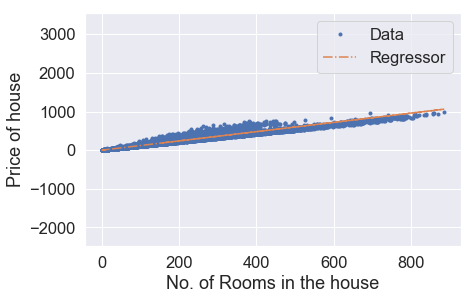

Iteration: 5241,Cost = 942.191856649032,theta = [0.27704012 1.19788373]
Iteration: 5241,Cost_val = 946.4710128544609,theta = [0.27704012 1.19788373]


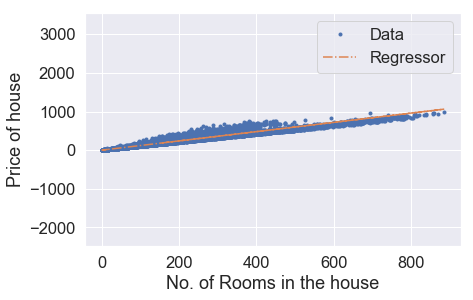

Iteration: 5251,Cost = 942.1893102186602,theta = [0.27754474 1.19788208]
Iteration: 5251,Cost_val = 946.4685103916879,theta = [0.27754474 1.19788208]


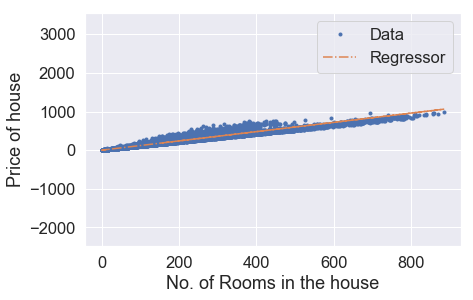

Iteration: 5261,Cost = 942.1867640397535,theta = [0.27804933 1.19788043]
Iteration: 5261,Cost_val = 946.4660081755799,theta = [0.27804933 1.19788043]


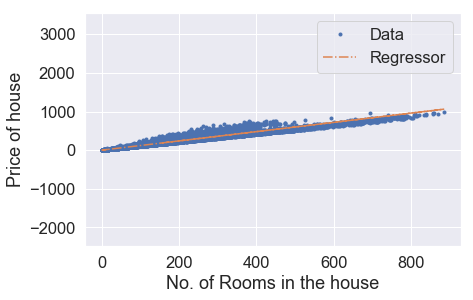

Iteration: 5271,Cost = 942.1842181122644,theta = [0.2785539  1.19787877]
Iteration: 5271,Cost_val = 946.4635062061114,theta = [0.2785539  1.19787877]


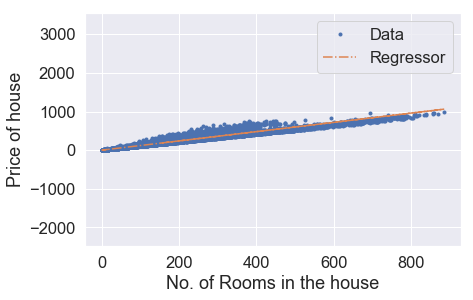

Iteration: 5281,Cost = 942.1816724361688,theta = [0.27905845 1.19787712]
Iteration: 5281,Cost_val = 946.4610044832568,theta = [0.27905845 1.19787712]


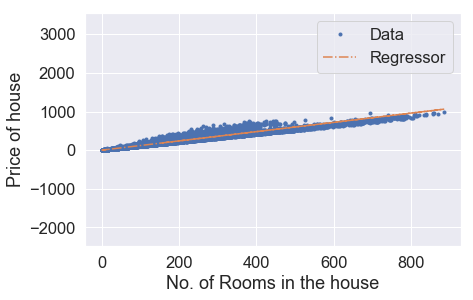

Iteration: 5291,Cost = 942.1791270114553,theta = [0.27956297 1.19787546]
Iteration: 5291,Cost_val = 946.4585030069942,theta = [0.27956297 1.19787546]


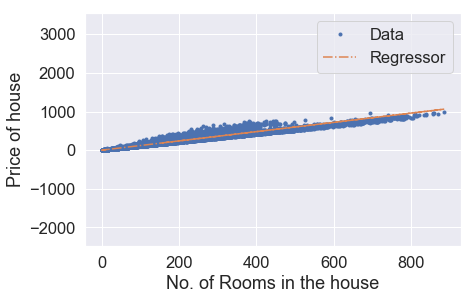

Iteration: 5301,Cost = 942.176581838072,theta = [0.28006746 1.19787381]
Iteration: 5301,Cost_val = 946.4560017773,theta = [0.28006746 1.19787381]


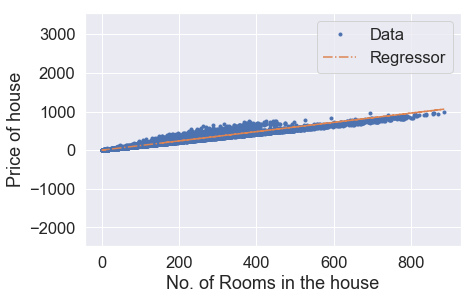

Iteration: 5311,Cost = 942.1740369160372,theta = [0.28057193 1.19787215]
Iteration: 5311,Cost_val = 946.453500794154,theta = [0.28057193 1.19787215]


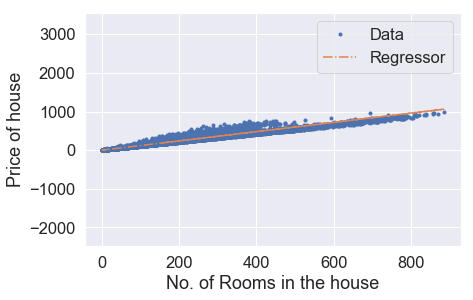

Iteration: 5321,Cost = 942.1714922452944,theta = [0.28107638 1.1978705 ]
Iteration: 5321,Cost_val = 946.4510000575228,theta = [0.28107638 1.1978705 ]


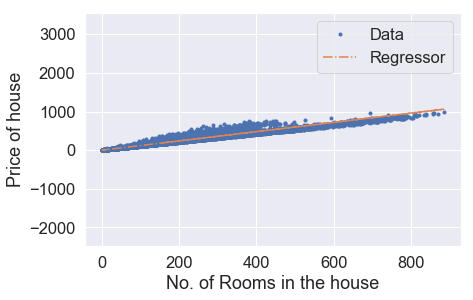

Iteration: 5331,Cost = 942.1689478258314,theta = [0.2815808  1.19786885]
Iteration: 5331,Cost_val = 946.4484995673879,theta = [0.2815808  1.19786885]


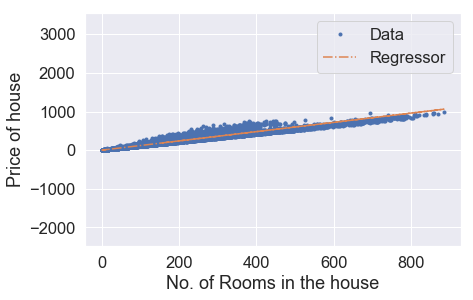

Iteration: 5341,Cost = 942.1664036576141,theta = [0.28208519 1.19786719]
Iteration: 5341,Cost_val = 946.4459993237208,theta = [0.28208519 1.19786719]


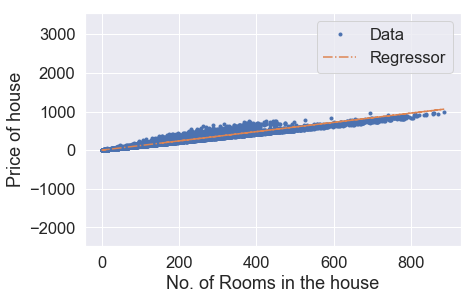

Iteration: 5351,Cost = 942.1638597406112,theta = [0.28258956 1.19786554]
Iteration: 5351,Cost_val = 946.4434993264963,theta = [0.28258956 1.19786554]


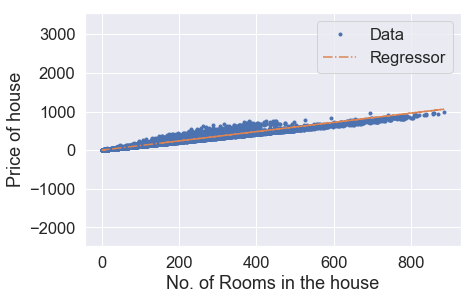

Iteration: 5361,Cost = 942.1613160748327,theta = [0.28309391 1.19786388]
Iteration: 5361,Cost_val = 946.4409995756984,theta = [0.28309391 1.19786388]


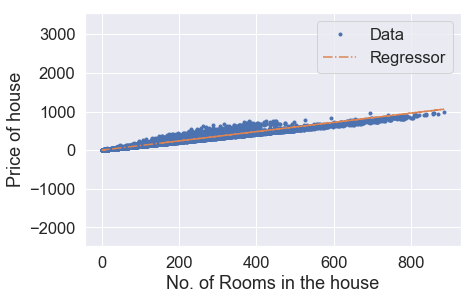

Iteration: 5371,Cost = 942.1587726602069,theta = [0.28359823 1.19786223]
Iteration: 5371,Cost_val = 946.4385000712967,theta = [0.28359823 1.19786223]


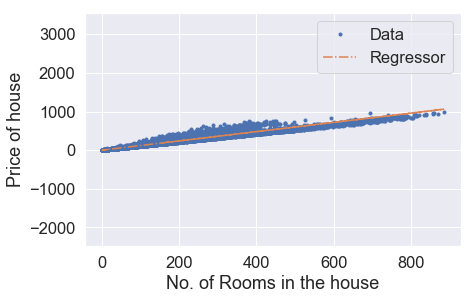

Iteration: 5381,Cost = 942.1562294967431,theta = [0.28410253 1.19786058]
Iteration: 5381,Cost_val = 946.4360008132687,theta = [0.28410253 1.19786058]


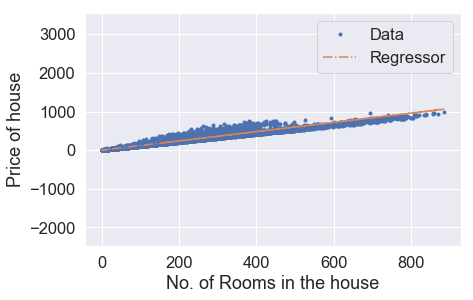

Iteration: 5391,Cost = 942.1536865844027,theta = [0.2846068  1.19785892]
Iteration: 5391,Cost_val = 946.4335018015952,theta = [0.2846068  1.19785892]


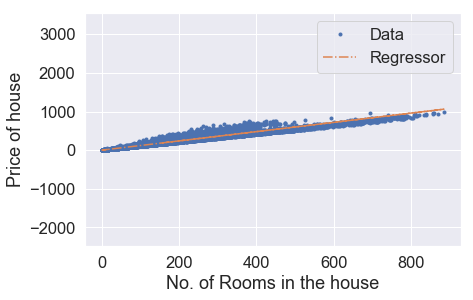

Iteration: 5401,Cost = 942.1511439231654,theta = [0.28511104 1.19785727]
Iteration: 5401,Cost_val = 946.4310030362335,theta = [0.28511104 1.19785727]


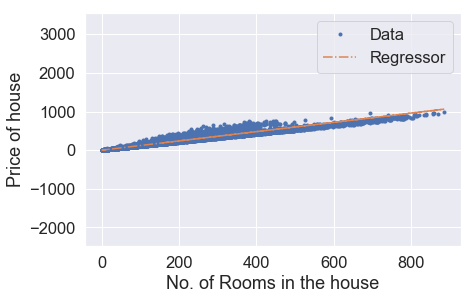

Iteration: 5411,Cost = 942.148601513007,theta = [0.28561526 1.19785562]
Iteration: 5411,Cost_val = 946.4285045171825,theta = [0.28561526 1.19785562]


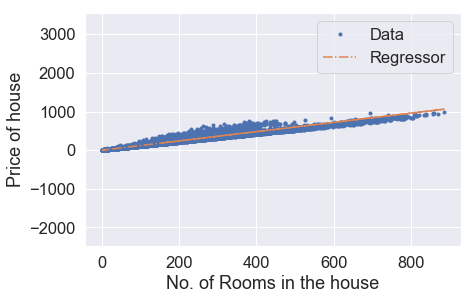

Iteration: 5421,Cost = 942.1460593538942,theta = [0.28611946 1.19785396]
Iteration: 5421,Cost_val = 946.4260062444,theta = [0.28611946 1.19785396]


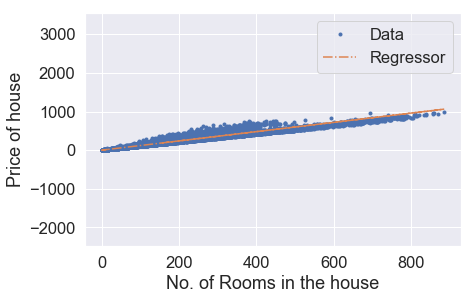

Iteration: 5431,Cost = 942.1435174458132,theta = [0.28662363 1.19785231]
Iteration: 5431,Cost_val = 946.4235082178724,theta = [0.28662363 1.19785231]


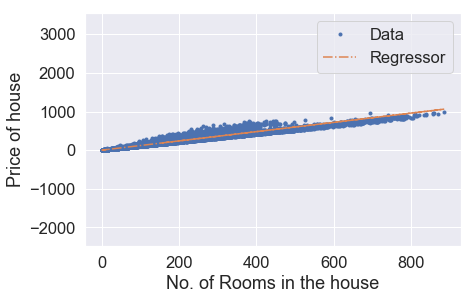

Iteration: 5441,Cost = 942.1409757887446,theta = [0.28712778 1.19785066]
Iteration: 5441,Cost_val = 946.4210104375702,theta = [0.28712778 1.19785066]


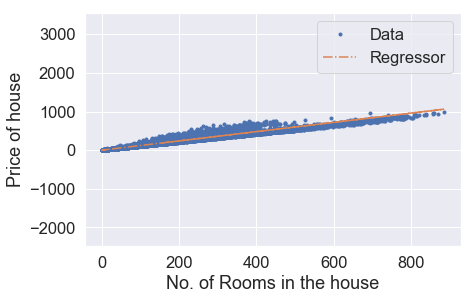

Iteration: 5451,Cost = 942.1384343826417,theta = [0.2876319 1.197849 ]
Iteration: 5451,Cost_val = 946.418512903474,theta = [0.2876319 1.197849 ]


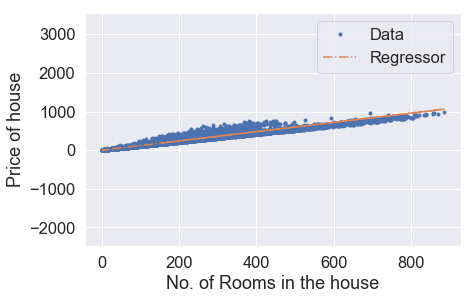

Iteration: 5461,Cost = 942.1358932274918,theta = [0.288136   1.19784735]
Iteration: 5461,Cost_val = 946.4160156155558,theta = [0.288136   1.19784735]


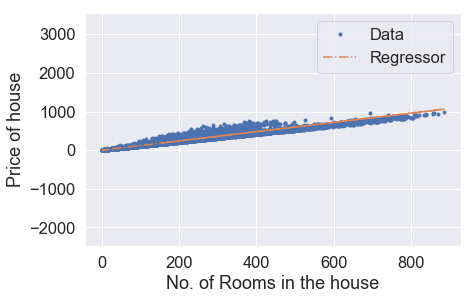

Iteration: 5471,Cost = 942.1333523232732,theta = [0.28864007 1.1978457 ]
Iteration: 5471,Cost_val = 946.4135185737886,theta = [0.28864007 1.1978457 ]


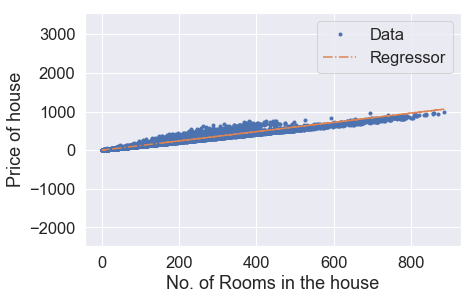

Iteration: 5481,Cost = 942.1308116699512,theta = [0.28914411 1.19784404]
Iteration: 5481,Cost_val = 946.4110217781524,theta = [0.28914411 1.19784404]


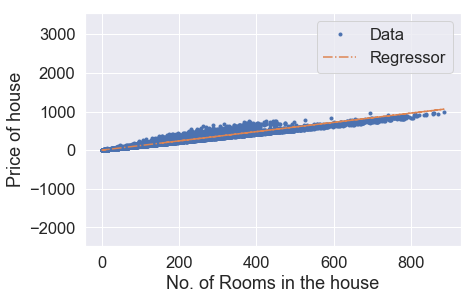

Iteration: 5491,Cost = 942.1282712675134,theta = [0.28964814 1.19784239]
Iteration: 5491,Cost_val = 946.4085252286278,theta = [0.28964814 1.19784239]


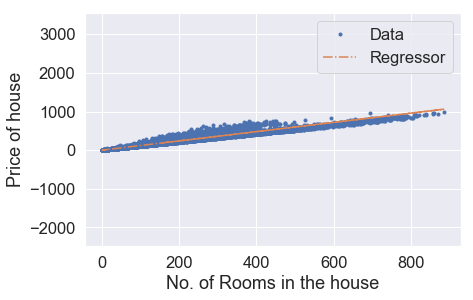

Iteration: 5501,Cost = 942.1257311159318,theta = [0.29015213 1.19784074]
Iteration: 5501,Cost_val = 946.4060289251771,theta = [0.29015213 1.19784074]


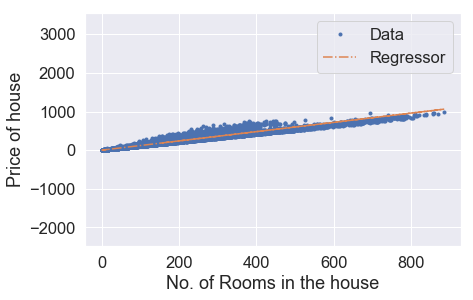

Iteration: 5511,Cost = 942.1231912151771,theta = [0.29065611 1.19783909]
Iteration: 5511,Cost_val = 946.4035328677876,theta = [0.29065611 1.19783909]


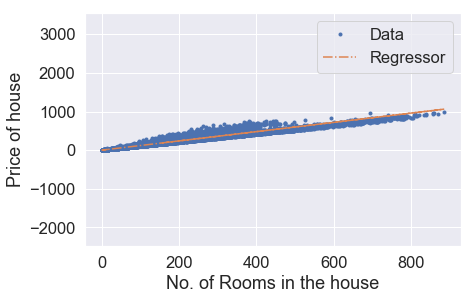

Iteration: 5521,Cost = 942.1206515652273,theta = [0.29116005 1.19783743]
Iteration: 5521,Cost_val = 946.4010370564308,theta = [0.29116005 1.19783743]


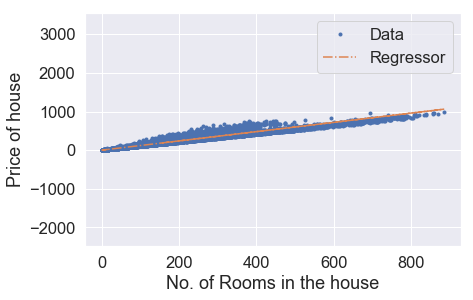

Iteration: 5531,Cost = 942.118112166048,theta = [0.29166398 1.19783578]
Iteration: 5531,Cost_val = 946.3985414910825,theta = [0.29166398 1.19783578]


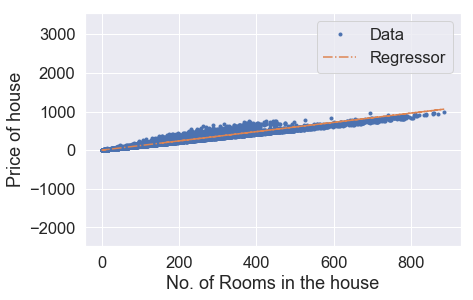

Iteration: 5541,Cost = 942.1155730176363,theta = [0.29216787 1.19783413]
Iteration: 5541,Cost_val = 946.3960461717156,theta = [0.29216787 1.19783413]


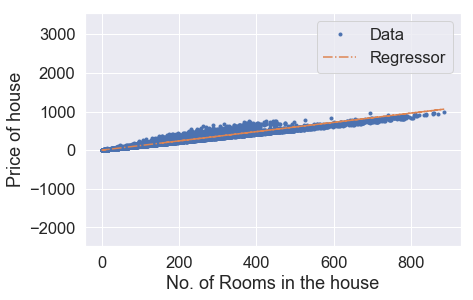

Iteration: 5551,Cost = 942.1130341199454,theta = [0.29267175 1.19783248]
Iteration: 5551,Cost_val = 946.3935510983116,theta = [0.29267175 1.19783248]


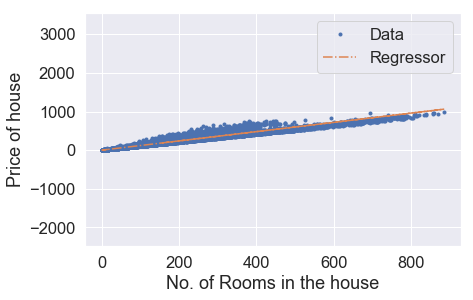

Iteration: 5561,Cost = 942.1104954729683,theta = [0.29317559 1.19783083]
Iteration: 5561,Cost_val = 946.3910562708421,theta = [0.29317559 1.19783083]


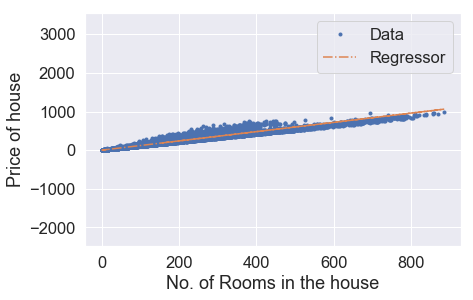

Iteration: 5571,Cost = 942.1079570766616,theta = [0.29367942 1.19782917]
Iteration: 5571,Cost_val = 946.3885616892867,theta = [0.29367942 1.19782917]


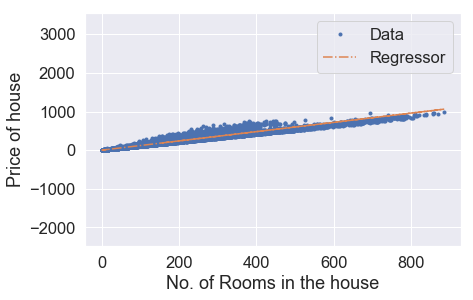

Iteration: 5581,Cost = 942.1054189310108,theta = [0.29418321 1.19782752]
Iteration: 5581,Cost_val = 946.3860673536146,theta = [0.29418321 1.19782752]


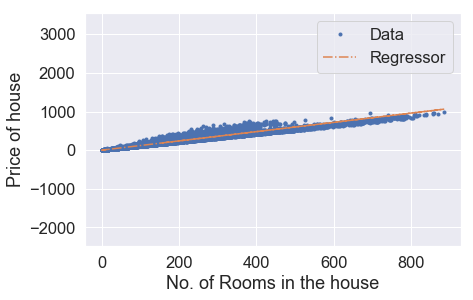

Iteration: 5591,Cost = 942.102881035993,theta = [0.29468699 1.19782587]
Iteration: 5591,Cost_val = 946.3835732638129,theta = [0.29468699 1.19782587]


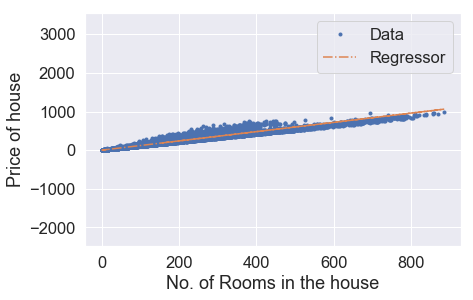

Iteration: 5601,Cost = 942.100343391588,theta = [0.29519074 1.19782422]
Iteration: 5601,Cost_val = 946.3810794198387,theta = [0.29519074 1.19782422]


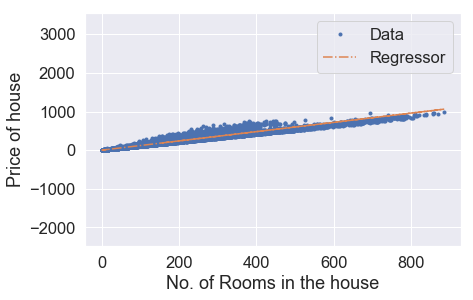

Iteration: 5611,Cost = 942.0978059977676,theta = [0.29569446 1.19782257]
Iteration: 5611,Cost_val = 946.378585821688,theta = [0.29569446 1.19782257]


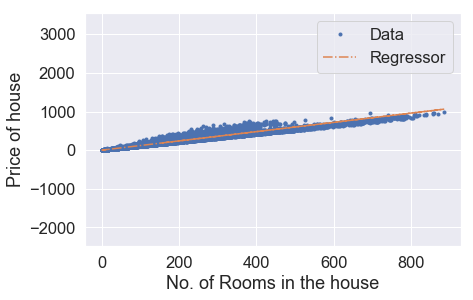

Iteration: 5621,Cost = 942.0952688544827,theta = [0.29619816 1.19782091]
Iteration: 5621,Cost_val = 946.3760924693261,theta = [0.29619816 1.19782091]


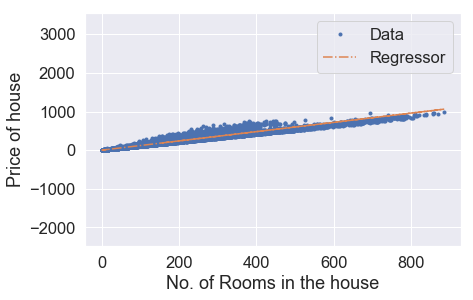

Iteration: 5631,Cost = 942.0927319617527,theta = [0.29670183 1.19781926]
Iteration: 5631,Cost_val = 946.3735993627279,theta = [0.29670183 1.19781926]


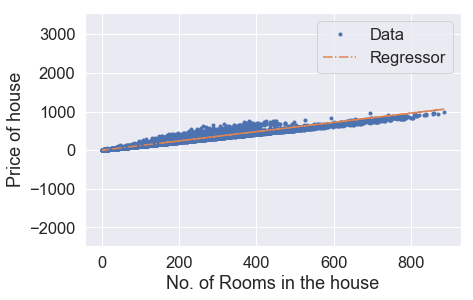

Iteration: 5641,Cost = 942.0901953195207,theta = [0.29720548 1.19781761]
Iteration: 5641,Cost_val = 946.3711065018726,theta = [0.29720548 1.19781761]


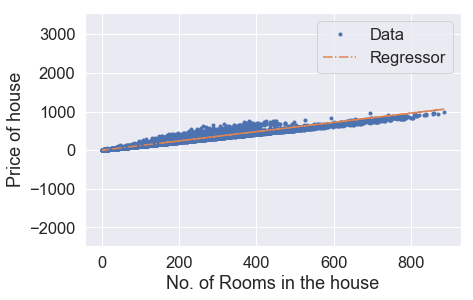

Iteration: 5651,Cost = 942.0876589277748,theta = [0.2977091  1.19781596]
Iteration: 5651,Cost_val = 946.368613886738,theta = [0.2977091  1.19781596]


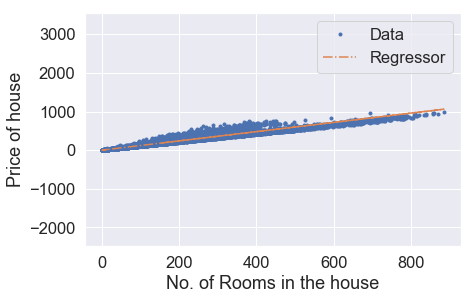

Iteration: 5661,Cost = 942.0851227864825,theta = [0.2982127  1.19781431]
Iteration: 5661,Cost_val = 946.3661215172908,theta = [0.2982127  1.19781431]


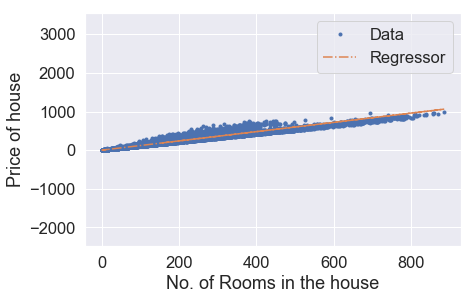

Iteration: 5671,Cost = 942.0825868956218,theta = [0.29871628 1.19781266]
Iteration: 5671,Cost_val = 946.3636293935183,theta = [0.29871628 1.19781266]


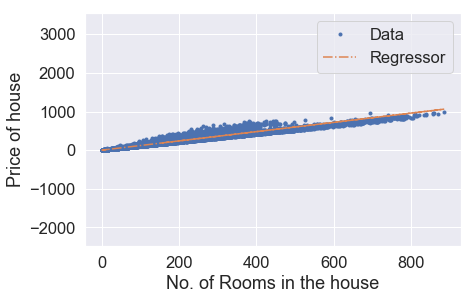

Iteration: 5681,Cost = 942.0800512551681,theta = [0.29921983 1.19781101]
Iteration: 5681,Cost_val = 946.3611375153844,theta = [0.29921983 1.19781101]


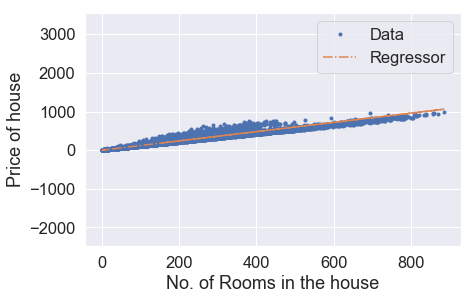

Iteration: 5691,Cost = 942.0775158650977,theta = [0.29972335 1.19780936]
Iteration: 5691,Cost_val = 946.3586458828761,theta = [0.29972335 1.19780936]


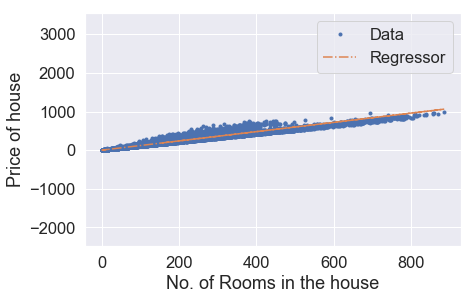

Iteration: 5701,Cost = 942.074980725394,theta = [0.30022685 1.1978077 ]
Iteration: 5701,Cost_val = 946.3561544959638,theta = [0.30022685 1.1978077 ]


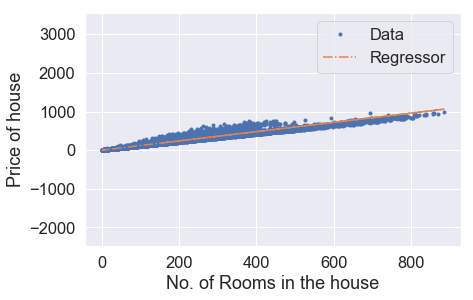

Iteration: 5711,Cost = 942.0724458360131,theta = [0.30073033 1.19780605]
Iteration: 5711,Cost_val = 946.353663354621,theta = [0.30073033 1.19780605]


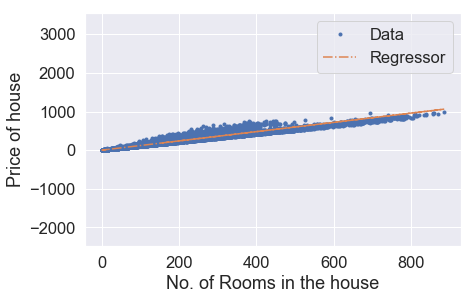

Iteration: 5721,Cost = 942.0699111969489,theta = [0.30123378 1.1978044 ]
Iteration: 5721,Cost_val = 946.3511724588273,theta = [0.30123378 1.1978044 ]


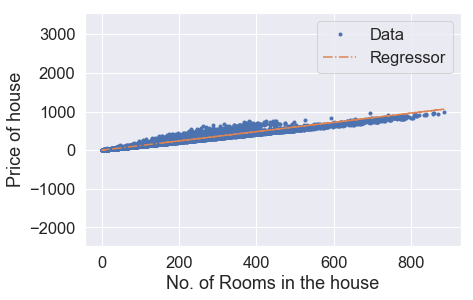

Iteration: 5731,Cost = 942.06737680817,theta = [0.3017372  1.19780275]
Iteration: 5731,Cost_val = 946.348681808558,theta = [0.3017372  1.19780275]


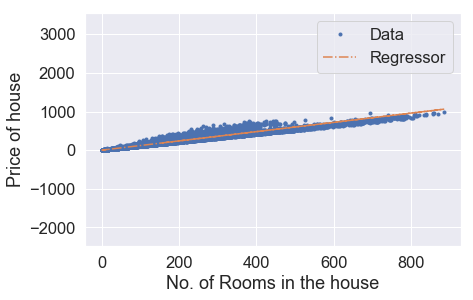

Iteration: 5741,Cost = 942.0648426696465,theta = [0.3022406 1.1978011]
Iteration: 5741,Cost_val = 946.3461914037867,theta = [0.3022406 1.1978011]


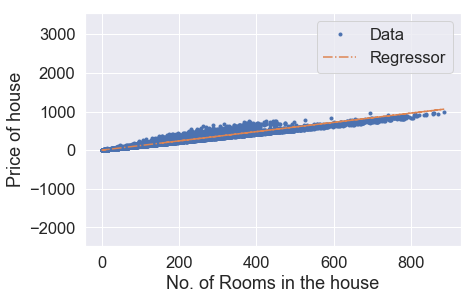

Iteration: 5751,Cost = 942.062308781364,theta = [0.30274398 1.19779945]
Iteration: 5751,Cost_val = 946.3437012444955,theta = [0.30274398 1.19779945]


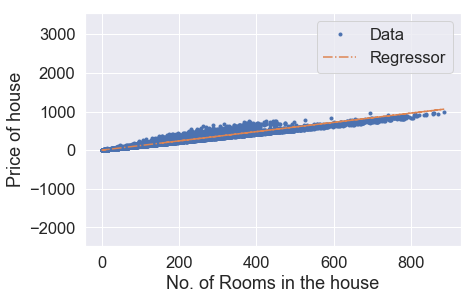

Iteration: 5761,Cost = 942.0597751432922,theta = [0.30324733 1.1977978 ]
Iteration: 5761,Cost_val = 946.3412113306533,theta = [0.30324733 1.1977978 ]


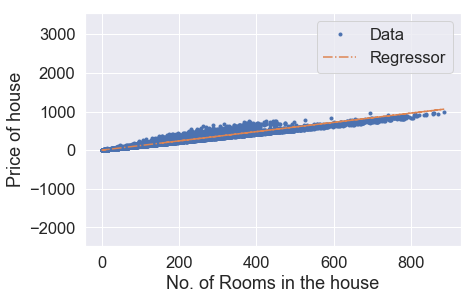

Iteration: 5771,Cost = 942.0572417553884,theta = [0.30375065 1.19779615]
Iteration: 5771,Cost_val = 946.3387216622356,theta = [0.30375065 1.19779615]


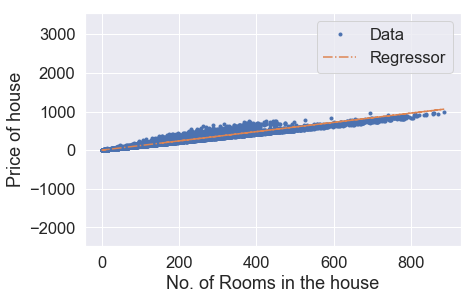

Iteration: 5781,Cost = 942.0547086176708,theta = [0.30425395 1.1977945 ]
Iteration: 5781,Cost_val = 946.3362322392189,theta = [0.30425395 1.1977945 ]


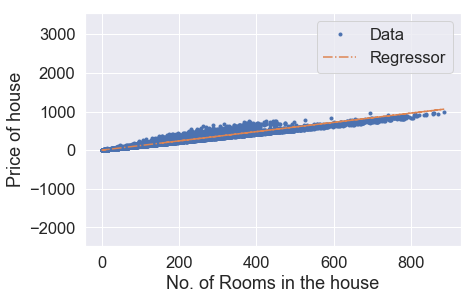

Iteration: 5791,Cost = 942.0521757300684,theta = [0.30475723 1.19779285]
Iteration: 5791,Cost_val = 946.3337430615811,theta = [0.30475723 1.19779285]


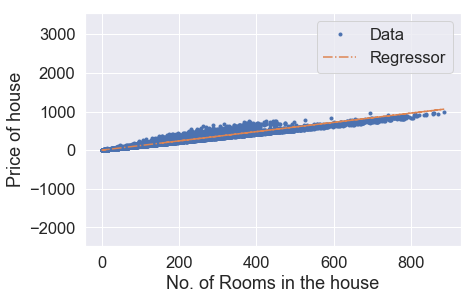

Iteration: 5801,Cost = 942.0496430925941,theta = [0.30526048 1.1977912 ]
Iteration: 5801,Cost_val = 946.3312541293009,theta = [0.30526048 1.1977912 ]


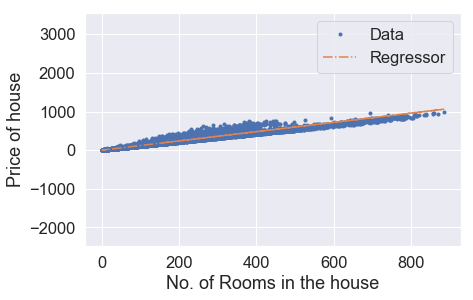

Iteration: 5811,Cost = 942.0471107051999,theta = [0.30576371 1.19778955]
Iteration: 5811,Cost_val = 946.3287654423481,theta = [0.30576371 1.19778955]


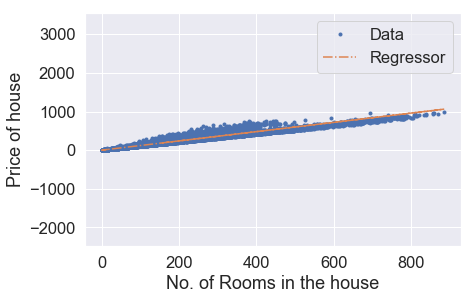

Iteration: 5821,Cost = 942.0445785678728,theta = [0.30626691 1.1977879 ]
Iteration: 5821,Cost_val = 946.3262770007021,theta = [0.30626691 1.1977879 ]


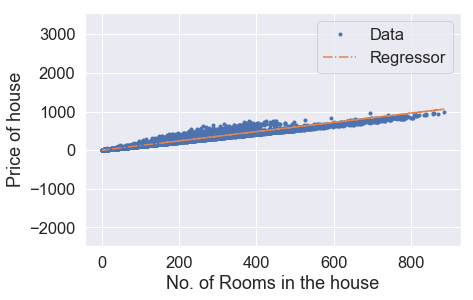

Iteration: 5831,Cost = 942.0420466805708,theta = [0.30677008 1.19778625]
Iteration: 5831,Cost_val = 946.3237888043361,theta = [0.30677008 1.19778625]


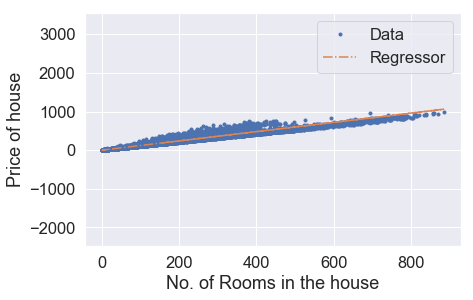

Iteration: 5841,Cost = 942.0395150432984,theta = [0.30727324 1.1977846 ]
Iteration: 5841,Cost_val = 946.3213008532294,theta = [0.30727324 1.1977846 ]


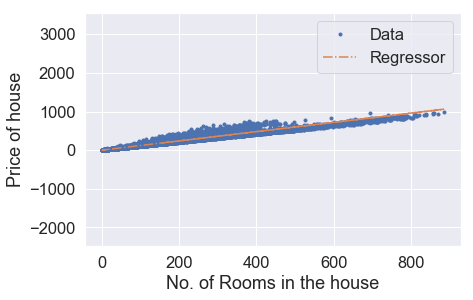

Iteration: 5851,Cost = 942.0369836560071,theta = [0.30777636 1.19778295]
Iteration: 5851,Cost_val = 946.318813147353,theta = [0.30777636 1.19778295]


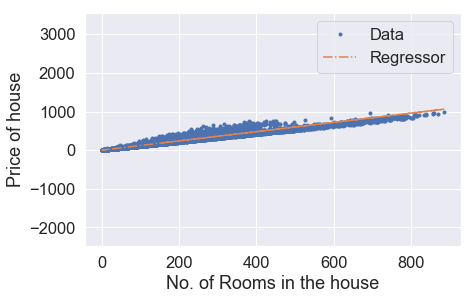

Iteration: 5861,Cost = 942.0344525186783,theta = [0.30827946 1.1977813 ]
Iteration: 5861,Cost_val = 946.3163256866901,theta = [0.30827946 1.1977813 ]


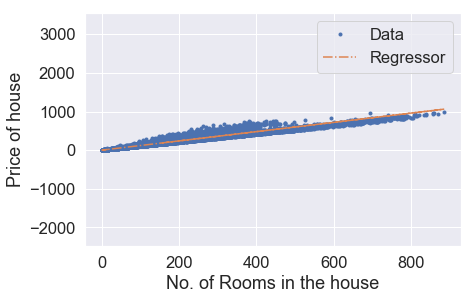

Iteration: 5871,Cost = 942.0319216312912,theta = [0.30878254 1.19777965]
Iteration: 5871,Cost_val = 946.3138384712103,theta = [0.30878254 1.19777965]


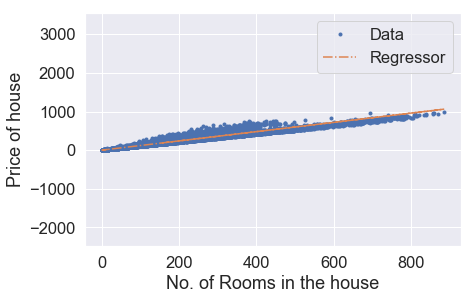

Iteration: 5881,Cost = 942.0293909938109,theta = [0.30928559 1.197778  ]
Iteration: 5881,Cost_val = 946.3113515008941,theta = [0.30928559 1.197778  ]


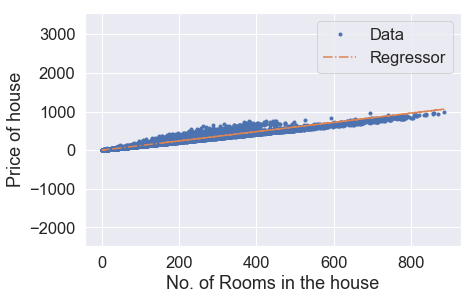

Iteration: 5891,Cost = 942.0268606062144,theta = [0.30978862 1.19777635]
Iteration: 5891,Cost_val = 946.3088647757072,theta = [0.30978862 1.19777635]


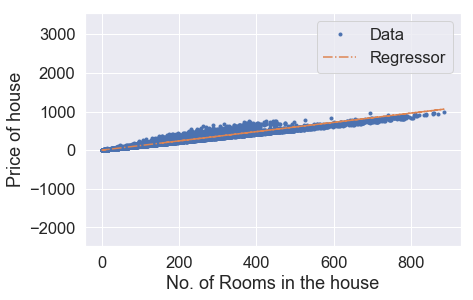

Iteration: 5901,Cost = 942.0243304684986,theta = [0.31029162 1.1977747 ]
Iteration: 5901,Cost_val = 946.3063782956384,theta = [0.31029162 1.1977747 ]


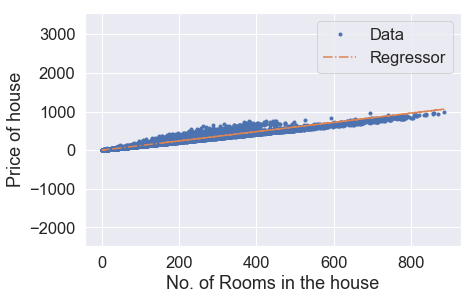

Iteration: 5911,Cost = 942.021800580611,theta = [0.3107946  1.19777305]
Iteration: 5911,Cost_val = 946.3038920606537,theta = [0.3107946  1.19777305]


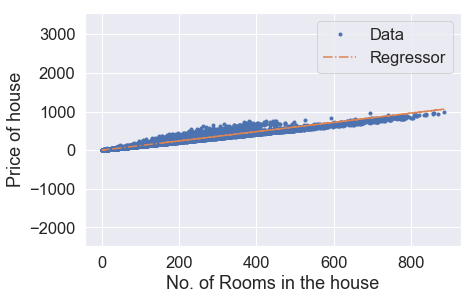

Iteration: 5921,Cost = 942.0192709425503,theta = [0.31129756 1.1977714 ]
Iteration: 5921,Cost_val = 946.3014060707369,theta = [0.31129756 1.1977714 ]


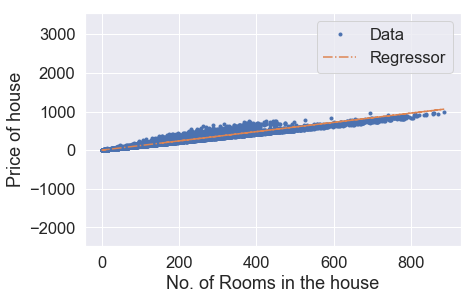

Iteration: 5931,Cost = 942.0167415542752,theta = [0.31180048 1.19776975]
Iteration: 5931,Cost_val = 946.2989203258547,theta = [0.31180048 1.19776975]


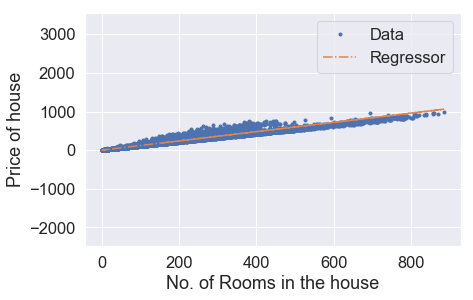

Iteration: 5941,Cost = 942.0142124157519,theta = [0.31230339 1.1977681 ]
Iteration: 5941,Cost_val = 946.2964348259939,theta = [0.31230339 1.1977681 ]


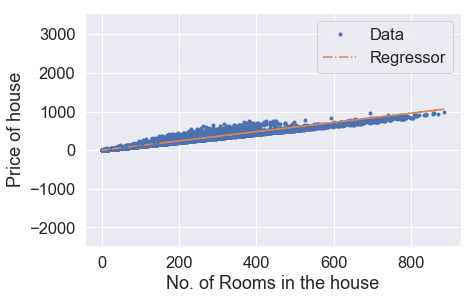

Iteration: 5951,Cost = 942.0116835269905,theta = [0.31280627 1.19776646]
Iteration: 5951,Cost_val = 946.2939495711191,theta = [0.31280627 1.19776646]


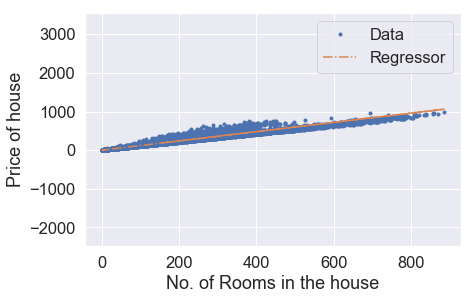

Iteration: 5961,Cost = 942.0091548879391,theta = [0.31330912 1.19776481]
Iteration: 5961,Cost_val = 946.2914645612161,theta = [0.31330912 1.19776481]


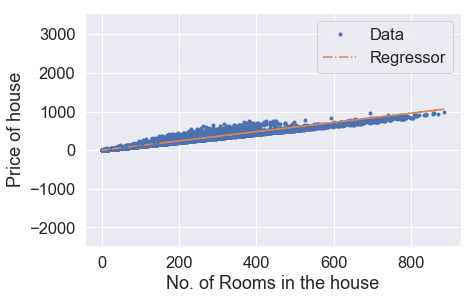

Iteration: 5971,Cost = 942.0066264985786,theta = [0.31381195 1.19776316]
Iteration: 5971,Cost_val = 946.2889797962512,theta = [0.31381195 1.19776316]


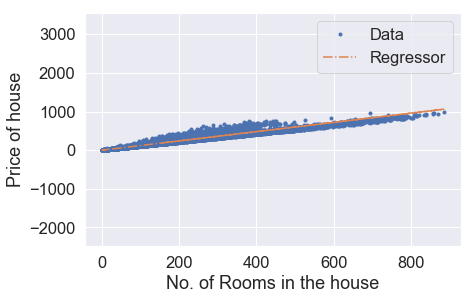

Iteration: 5981,Cost = 942.0040983588975,theta = [0.31431475 1.19776151]
Iteration: 5981,Cost_val = 946.2864952762094,theta = [0.31431475 1.19776151]


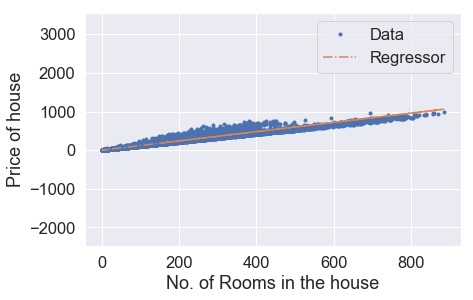

Iteration: 5991,Cost = 942.0015704688417,theta = [0.31481753 1.19775986]
Iteration: 5991,Cost_val = 946.2840110010623,theta = [0.31481753 1.19775986]


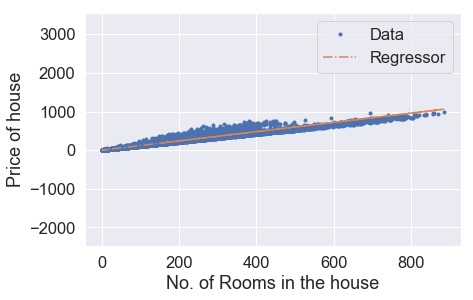

Iteration: 6001,Cost = 941.9990428284079,theta = [0.31532029 1.19775821]
Iteration: 6001,Cost_val = 946.2815269707827,theta = [0.31532029 1.19775821]


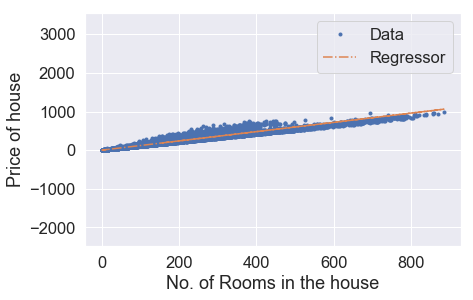

Iteration: 6011,Cost = 941.996515437568,theta = [0.31582301 1.19775656]
Iteration: 6011,Cost_val = 946.2790431853483,theta = [0.31582301 1.19775656]


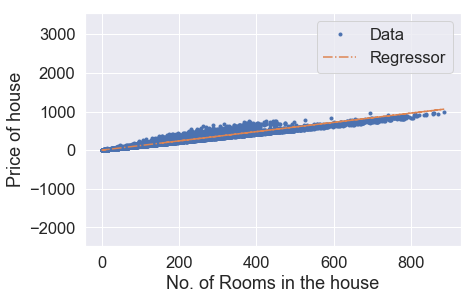

Iteration: 6021,Cost = 941.9939882963002,theta = [0.31632572 1.19775492]
Iteration: 6021,Cost_val = 946.2765596447375,theta = [0.31632572 1.19775492]


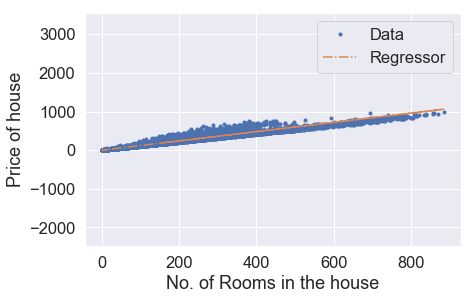

Iteration: 6031,Cost = 941.9914614045873,theta = [0.3168284  1.19775327]
Iteration: 6031,Cost_val = 946.2740763489273,theta = [0.3168284  1.19775327]


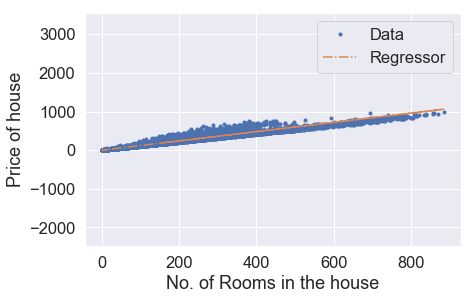

Iteration: 6041,Cost = 941.9889347623778,theta = [0.31733105 1.19775162]
Iteration: 6041,Cost_val = 946.2715932978923,theta = [0.31733105 1.19775162]


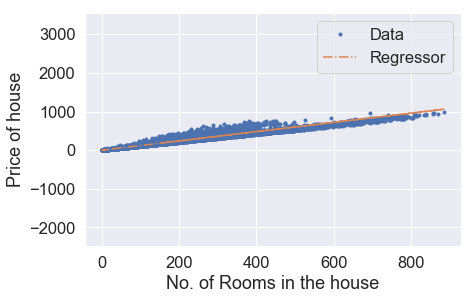

Iteration: 6051,Cost = 941.9864083696706,theta = [0.31783368 1.19774997]
Iteration: 6051,Cost_val = 946.2691104916049,theta = [0.31783368 1.19774997]


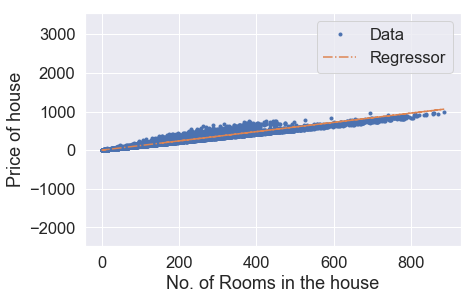

Iteration: 6061,Cost = 941.9838822264312,theta = [0.31833629 1.19774832]
Iteration: 6061,Cost_val = 946.2666279300424,theta = [0.31833629 1.19774832]


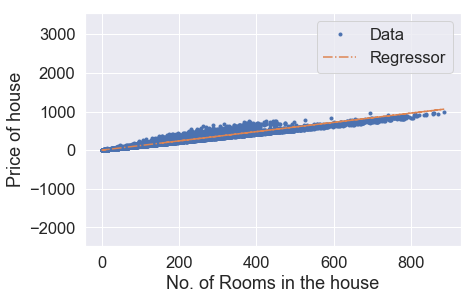

Iteration: 6071,Cost = 941.9813563326328,theta = [0.31883887 1.19774667]
Iteration: 6071,Cost_val = 946.2641456131822,theta = [0.31883887 1.19774667]


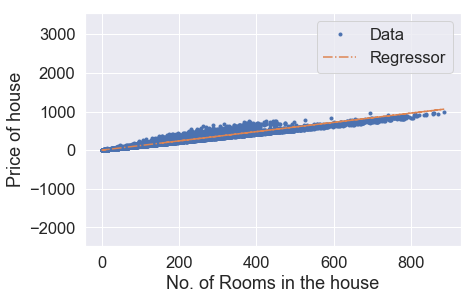

Iteration: 6081,Cost = 941.9788306882617,theta = [0.31934143 1.19774503]
Iteration: 6081,Cost_val = 946.2616635409946,theta = [0.31934143 1.19774503]


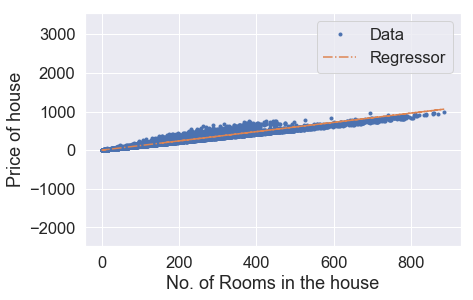

Iteration: 6091,Cost = 941.9763052932885,theta = [0.31984396 1.19774338]
Iteration: 6091,Cost_val = 946.2591817134672,theta = [0.31984396 1.19774338]


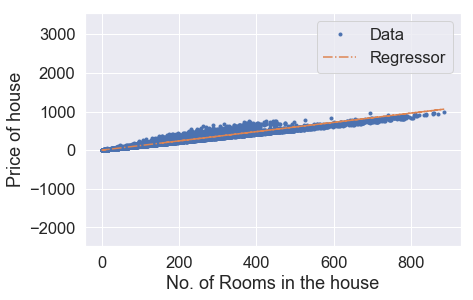

Iteration: 6101,Cost = 941.9737801476838,theta = [0.32034646 1.19774173]
Iteration: 6101,Cost_val = 946.2567001305634,theta = [0.32034646 1.19774173]


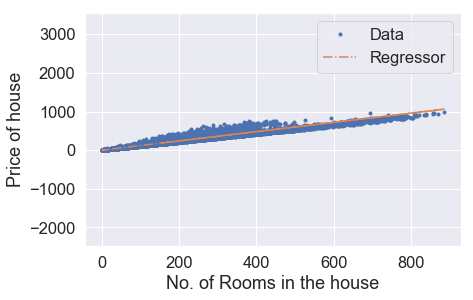

Iteration: 6111,Cost = 941.9712552514227,theta = [0.32084895 1.19774008]
Iteration: 6111,Cost_val = 946.2542187922749,theta = [0.32084895 1.19774008]


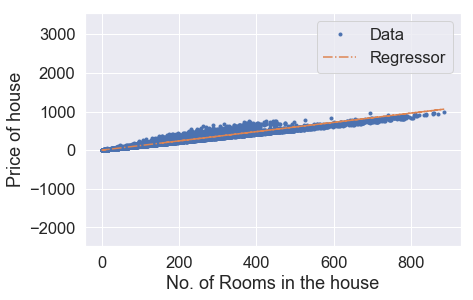

Iteration: 6121,Cost = 941.9687306044885,theta = [0.3213514  1.19773844]
Iteration: 6121,Cost_val = 946.2517376985543,theta = [0.3213514  1.19773844]


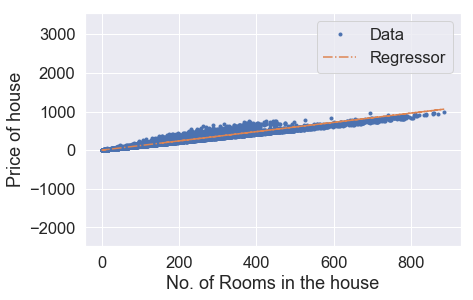

Iteration: 6131,Cost = 941.9662062068531,theta = [0.32185383 1.19773679]
Iteration: 6131,Cost_val = 946.2492568493948,theta = [0.32185383 1.19773679]


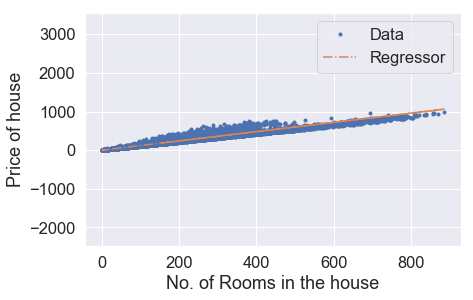

Iteration: 6141,Cost = 941.9636820584889,theta = [0.32235624 1.19773514]
Iteration: 6141,Cost_val = 946.2467762447653,theta = [0.32235624 1.19773514]


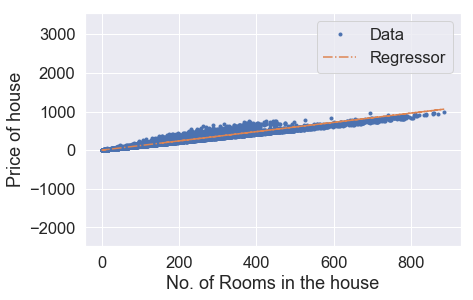

Iteration: 6151,Cost = 941.961158159378,theta = [0.32285862 1.19773349]
Iteration: 6151,Cost_val = 946.2442958846482,theta = [0.32285862 1.19773349]


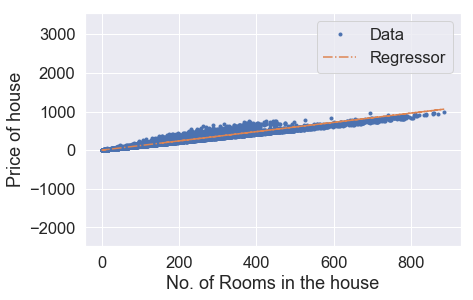

Iteration: 6161,Cost = 941.9586345094842,theta = [0.32336098 1.19773185]
Iteration: 6161,Cost_val = 946.2418157690153,theta = [0.32336098 1.19773185]


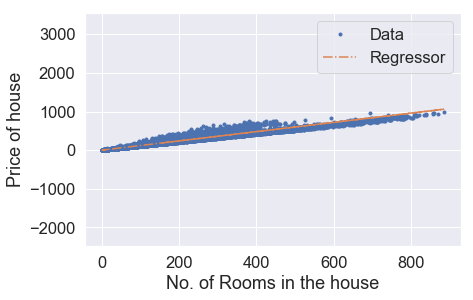

Iteration: 6171,Cost = 941.956111108802,theta = [0.32386331 1.1977302 ]
Iteration: 6171,Cost_val = 946.239335897844,theta = [0.32386331 1.1977302 ]


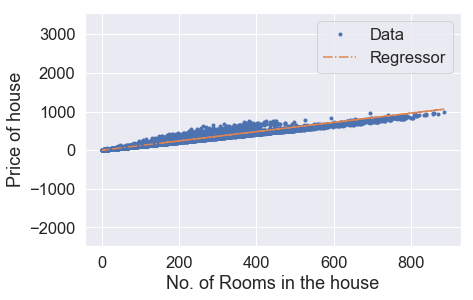

Iteration: 6181,Cost = 941.9535879572712,theta = [0.32436562 1.19772855]
Iteration: 6181,Cost_val = 946.2368562711056,theta = [0.32436562 1.19772855]


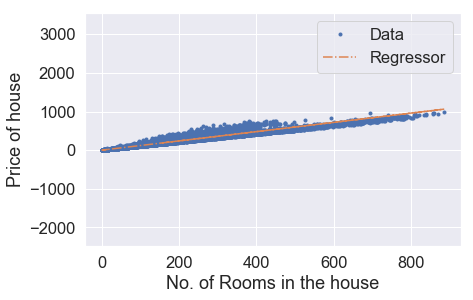

Iteration: 6191,Cost = 941.9510650549096,theta = [0.3248679  1.19772691]
Iteration: 6191,Cost_val = 946.2343768887774,theta = [0.3248679  1.19772691]


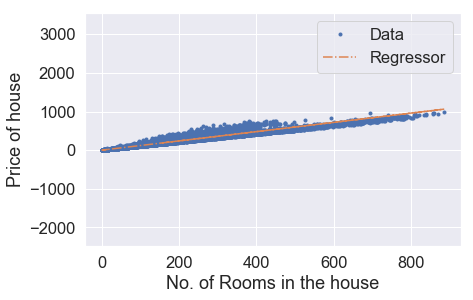

Iteration: 6201,Cost = 941.9485424016773,theta = [0.32537016 1.19772526]
Iteration: 6201,Cost_val = 946.2318977508422,theta = [0.32537016 1.19772526]


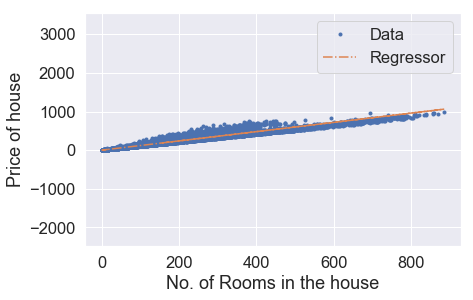

Iteration: 6211,Cost = 941.946019997528,theta = [0.32587239 1.19772361]
Iteration: 6211,Cost_val = 946.2294188572681,theta = [0.32587239 1.19772361]


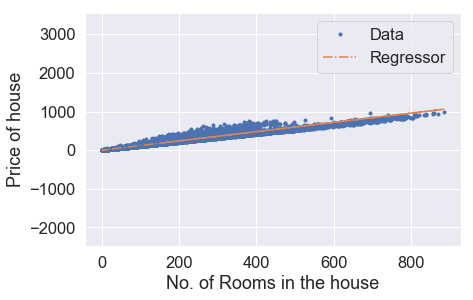

Iteration: 6221,Cost = 941.9434978424741,theta = [0.3263746  1.19772196]
Iteration: 6221,Cost_val = 946.2269402080328,theta = [0.3263746  1.19772196]


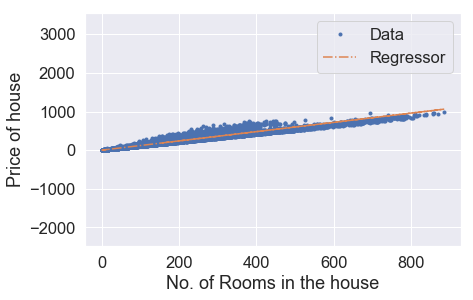

Iteration: 6231,Cost = 941.9409759364581,theta = [0.32687679 1.19772032]
Iteration: 6231,Cost_val = 946.2244618031139,theta = [0.32687679 1.19772032]


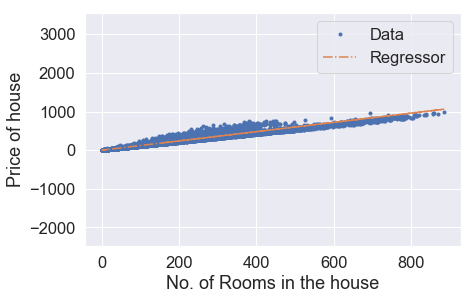

Iteration: 6241,Cost = 941.9384542794751,theta = [0.32737895 1.19771867]
Iteration: 6241,Cost_val = 946.2219836424842,theta = [0.32737895 1.19771867]


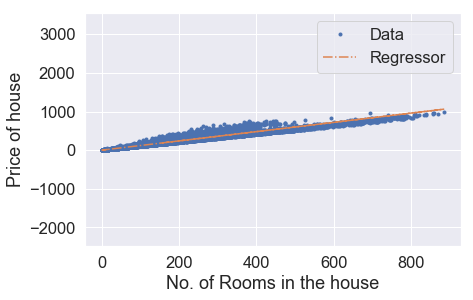

Iteration: 6251,Cost = 941.9359328714906,theta = [0.32788108 1.19771702]
Iteration: 6251,Cost_val = 946.2195057261271,theta = [0.32788108 1.19771702]


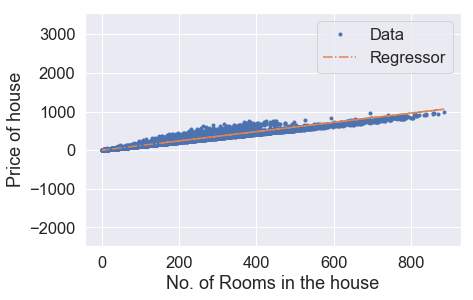

Iteration: 6261,Cost = 941.9334117124935,theta = [0.32838319 1.19771538]
Iteration: 6261,Cost_val = 946.2170280540109,theta = [0.32838319 1.19771538]


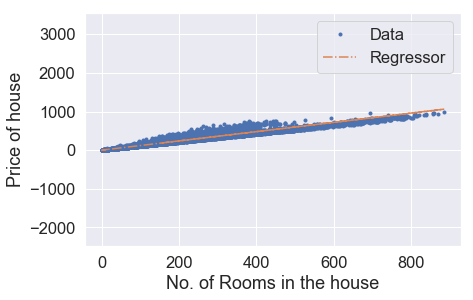

Iteration: 6271,Cost = 941.9308908024392,theta = [0.32888527 1.19771373]
Iteration: 6271,Cost_val = 946.2145506261097,theta = [0.32888527 1.19771373]


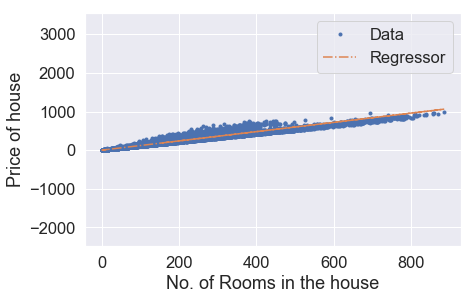

Iteration: 6281,Cost = 941.9283701413137,theta = [0.32938733 1.19771209]
Iteration: 6281,Cost_val = 946.2120734424076,theta = [0.32938733 1.19771209]


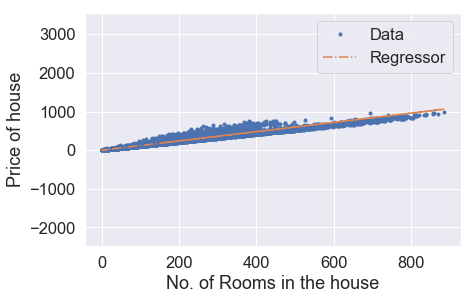

Iteration: 6291,Cost = 941.9258497291067,theta = [0.32988937 1.19771044]
Iteration: 6291,Cost_val = 946.2095965028734,theta = [0.32988937 1.19771044]


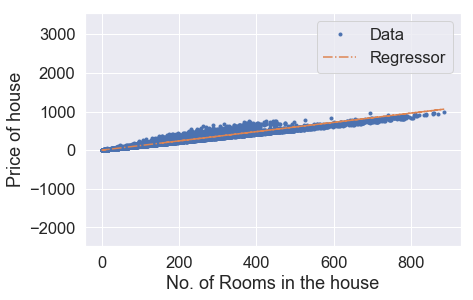

Iteration: 6301,Cost = 941.9233295657654,theta = [0.33039138 1.19770879]
Iteration: 6301,Cost_val = 946.2071198074891,theta = [0.33039138 1.19770879]


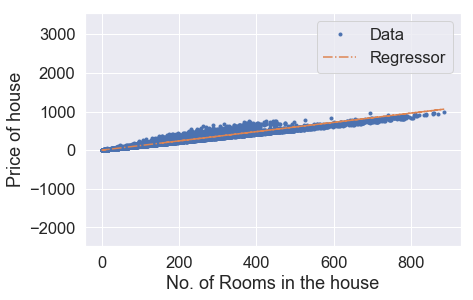

Iteration: 6311,Cost = 941.9208096512907,theta = [0.33089336 1.19770715]
Iteration: 6311,Cost_val = 946.2046433562265,theta = [0.33089336 1.19770715]


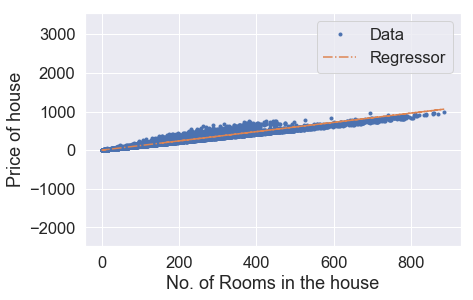

Iteration: 6321,Cost = 941.918289985627,theta = [0.33139533 1.1977055 ]
Iteration: 6321,Cost_val = 946.2021671490637,theta = [0.33139533 1.1977055 ]


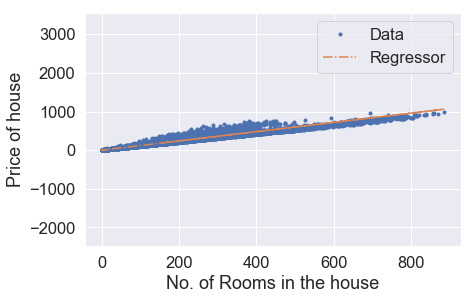

Iteration: 6331,Cost = 941.9157705687852,theta = [0.33189726 1.19770386]
Iteration: 6331,Cost_val = 946.1996911859735,theta = [0.33189726 1.19770386]


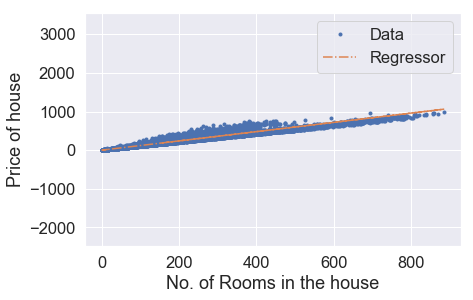

Iteration: 6341,Cost = 941.9132514007296,theta = [0.33239917 1.19770221]
Iteration: 6341,Cost_val = 946.1972154669326,theta = [0.33239917 1.19770221]


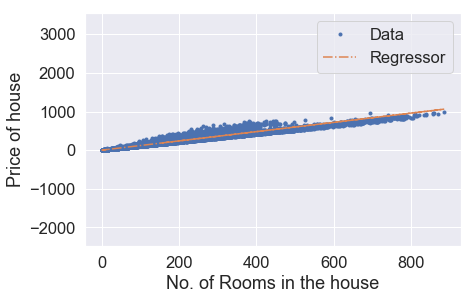

Iteration: 6351,Cost = 941.9107324814225,theta = [0.33290106 1.19770056]
Iteration: 6351,Cost_val = 946.1947399919221,theta = [0.33290106 1.19770056]


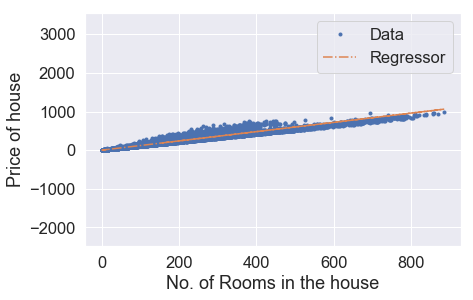

Iteration: 6361,Cost = 941.9082138108428,theta = [0.33340292 1.19769892]
Iteration: 6361,Cost_val = 946.1922647609139,theta = [0.33340292 1.19769892]


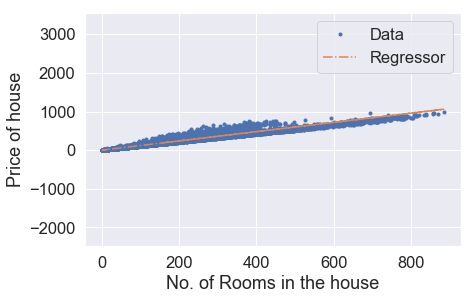

Iteration: 6371,Cost = 941.9056953889792,theta = [0.33390476 1.19769727]
Iteration: 6371,Cost_val = 946.1897897738816,theta = [0.33390476 1.19769727]


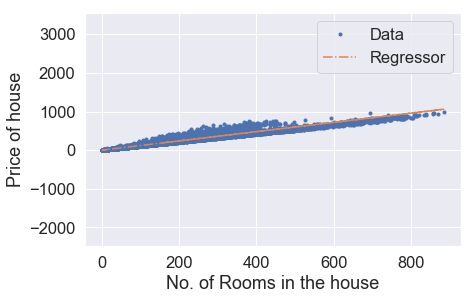

Iteration: 6381,Cost = 941.9031772157925,theta = [0.33440657 1.19769563]
Iteration: 6381,Cost_val = 946.1873150308028,theta = [0.33440657 1.19769563]


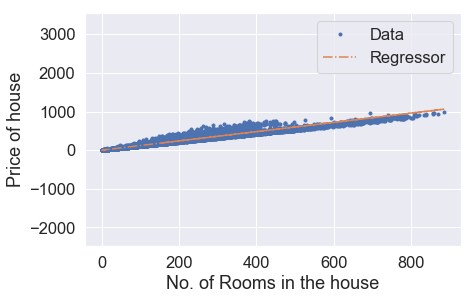

Iteration: 6391,Cost = 941.9006592912763,theta = [0.33490836 1.19769398]
Iteration: 6391,Cost_val = 946.1848405316528,theta = [0.33490836 1.19769398]


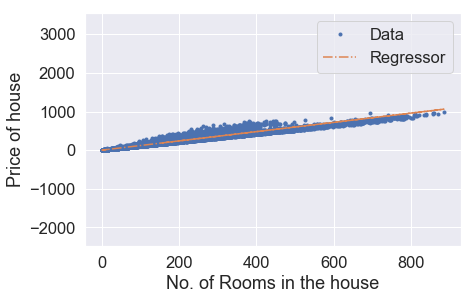

Iteration: 6401,Cost = 941.8981416153904,theta = [0.33541012 1.19769234]
Iteration: 6401,Cost_val = 946.1823662764134,theta = [0.33541012 1.19769234]


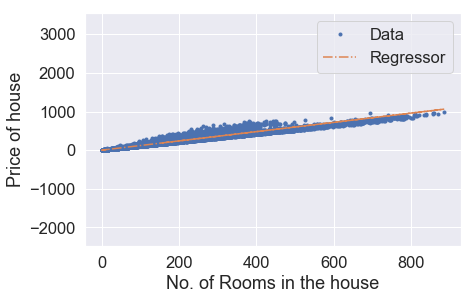

Iteration: 6411,Cost = 941.8956241881032,theta = [0.33591186 1.19769069]
Iteration: 6411,Cost_val = 946.1798922650523,theta = [0.33591186 1.19769069]


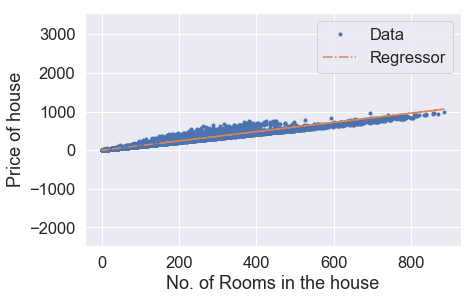

Iteration: 6421,Cost = 941.8931070094031,theta = [0.33641357 1.19768905]
Iteration: 6421,Cost_val = 946.1774184975525,theta = [0.33641357 1.19768905]


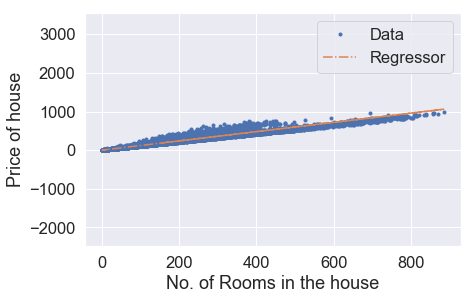

Iteration: 6431,Cost = 941.8905900792729,theta = [0.33691526 1.1976874 ]
Iteration: 6431,Cost_val = 946.1749449738825,theta = [0.33691526 1.1976874 ]


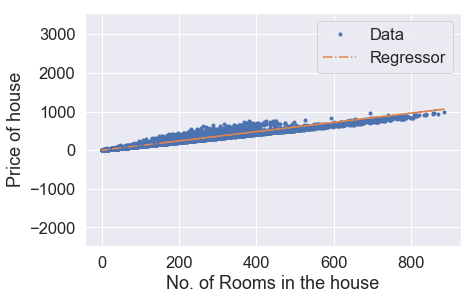

Iteration: 6441,Cost = 941.8880733976747,theta = [0.33741692 1.19768576]
Iteration: 6441,Cost_val = 946.1724716940272,theta = [0.33741692 1.19768576]


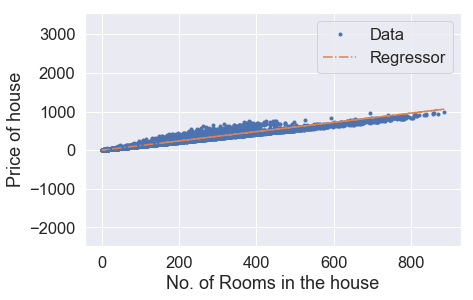

Iteration: 6451,Cost = 941.8855569645787,theta = [0.33791856 1.19768411]
Iteration: 6451,Cost_val = 946.1699986579524,theta = [0.33791856 1.19768411]


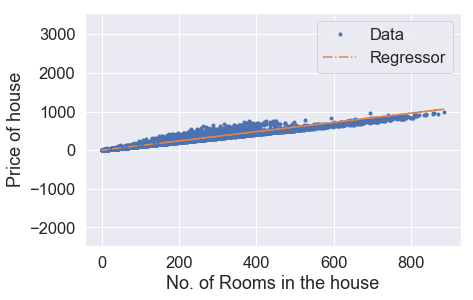

Iteration: 6461,Cost = 941.883040779984,theta = [0.33842017 1.19768247]
Iteration: 6461,Cost_val = 946.1675258656416,theta = [0.33842017 1.19768247]


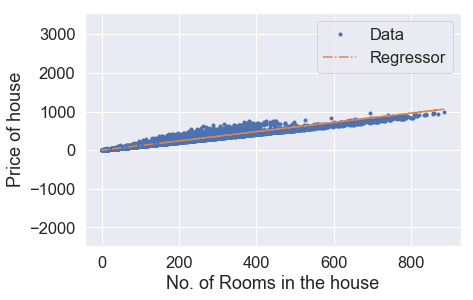

Iteration: 6471,Cost = 941.8805248438446,theta = [0.33892176 1.19768082]
Iteration: 6471,Cost_val = 946.1650533170688,theta = [0.33892176 1.19768082]


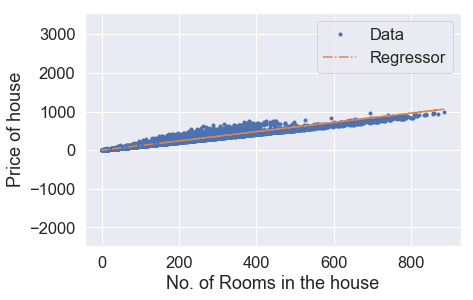

Iteration: 6481,Cost = 941.8780091561374,theta = [0.33942333 1.19767918]
Iteration: 6481,Cost_val = 946.1625810122097,theta = [0.33942333 1.19767918]


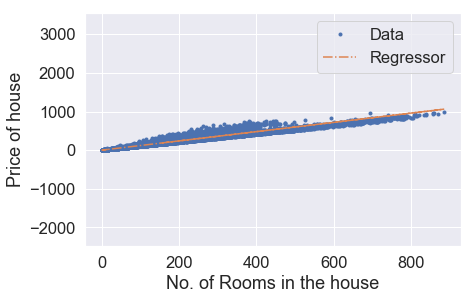

Iteration: 6491,Cost = 941.87549371686,theta = [0.33992486 1.19767753]
Iteration: 6491,Cost_val = 946.1601089510405,theta = [0.33992486 1.19767753]


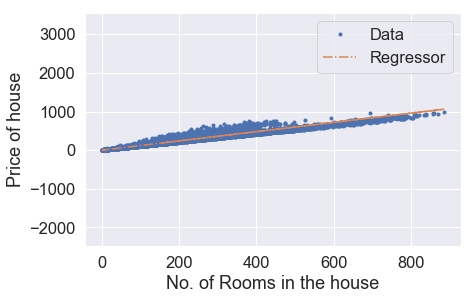

Iteration: 6501,Cost = 941.8729785259574,theta = [0.34042638 1.19767589]
Iteration: 6501,Cost_val = 946.1576371335351,theta = [0.34042638 1.19767589]


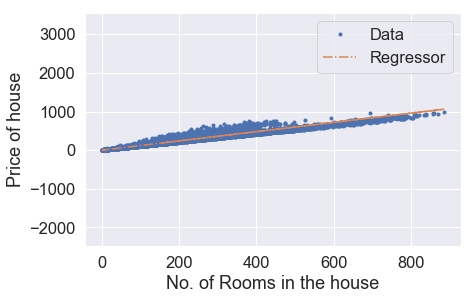

Iteration: 6511,Cost = 941.8704635834151,theta = [0.34092787 1.19767424]
Iteration: 6511,Cost_val = 946.1551655596732,theta = [0.34092787 1.19767424]


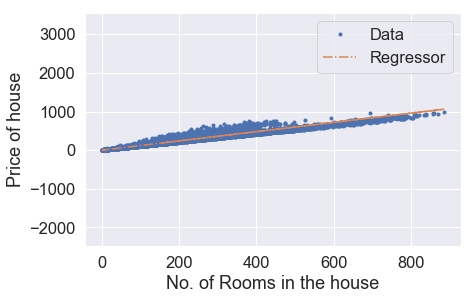

Iteration: 6521,Cost = 941.8679488892276,theta = [0.34142933 1.1976726 ]
Iteration: 6521,Cost_val = 946.1526942294258,theta = [0.34142933 1.1976726 ]


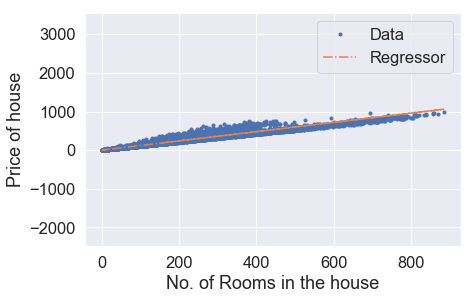

Iteration: 6531,Cost = 941.8654344433421,theta = [0.34193078 1.19767096]
Iteration: 6531,Cost_val = 946.1502231427786,theta = [0.34193078 1.19767096]


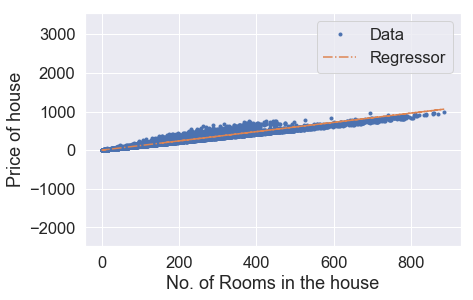

Iteration: 6541,Cost = 941.8629202457616,theta = [0.34243219 1.19766931]
Iteration: 6541,Cost_val = 946.1477522996913,theta = [0.34243219 1.19766931]


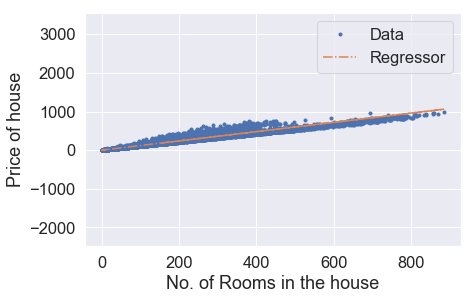

Iteration: 6551,Cost = 941.8604062964334,theta = [0.34293358 1.19766767]
Iteration: 6551,Cost_val = 946.145281700156,theta = [0.34293358 1.19766767]


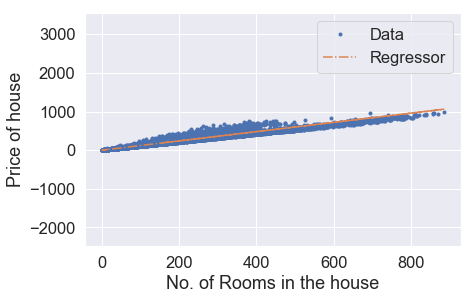

Iteration: 6561,Cost = 941.8578925953511,theta = [0.34343495 1.19766602]
Iteration: 6561,Cost_val = 946.1428113441372,theta = [0.34343495 1.19766602]


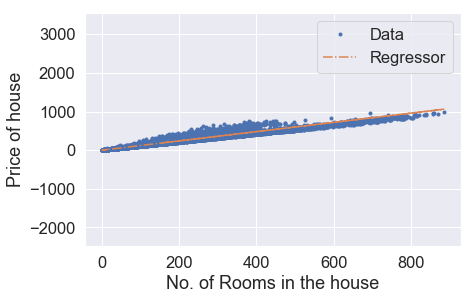

Iteration: 6571,Cost = 941.8553791424923,theta = [0.34393629 1.19766438]
Iteration: 6571,Cost_val = 946.1403412316222,theta = [0.34393629 1.19766438]


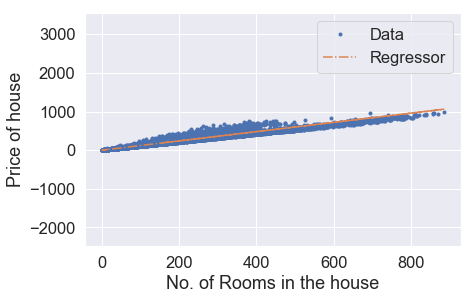

Iteration: 6581,Cost = 941.8528659378162,theta = [0.34443761 1.19766274]
Iteration: 6581,Cost_val = 946.1378713625807,theta = [0.34443761 1.19766274]


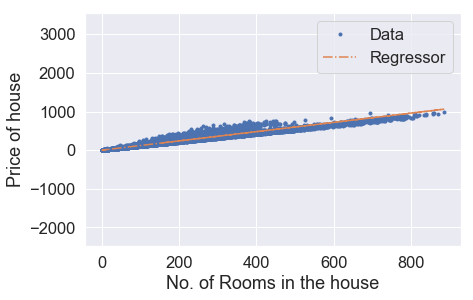

Iteration: 6591,Cost = 941.8503529813075,theta = [0.3449389  1.19766109]
Iteration: 6591,Cost_val = 946.1354017369854,theta = [0.3449389  1.19766109]


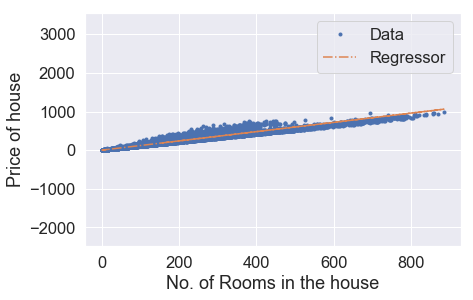

Iteration: 6601,Cost = 941.8478402729563,theta = [0.34544017 1.19765945]
Iteration: 6601,Cost_val = 946.1329323548102,theta = [0.34544017 1.19765945]


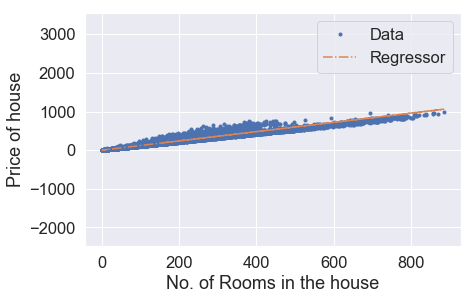

Iteration: 6611,Cost = 941.845327812708,theta = [0.34594141 1.1976578 ]
Iteration: 6611,Cost_val = 946.1304632160419,theta = [0.34594141 1.1976578 ]


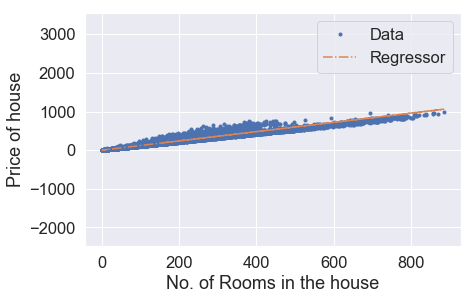

Iteration: 6621,Cost = 941.8428156005622,theta = [0.34644263 1.19765616]
Iteration: 6621,Cost_val = 946.1279943206499,theta = [0.34644263 1.19765616]


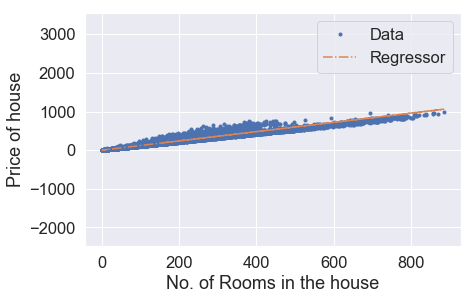

Iteration: 6631,Cost = 941.8403036364898,theta = [0.34694382 1.19765452]
Iteration: 6631,Cost_val = 946.1255256686105,theta = [0.34694382 1.19765452]


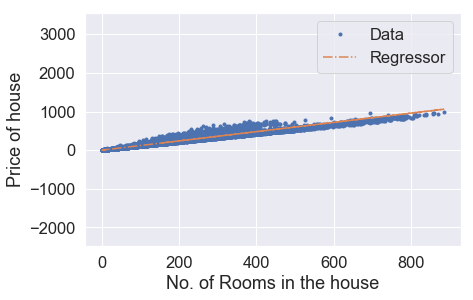

Iteration: 6641,Cost = 941.8377919204551,theta = [0.34744499 1.19765287]
Iteration: 6641,Cost_val = 946.1230572599007,theta = [0.34744499 1.19765287]


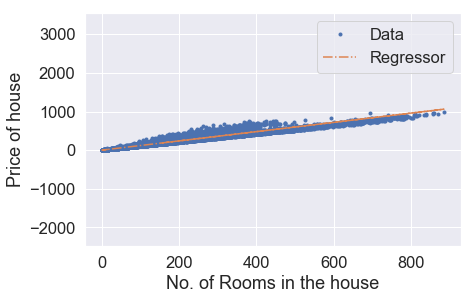

Iteration: 6651,Cost = 941.8352804524436,theta = [0.34794613 1.19765123]
Iteration: 6651,Cost_val = 946.1205890944992,theta = [0.34794613 1.19765123]


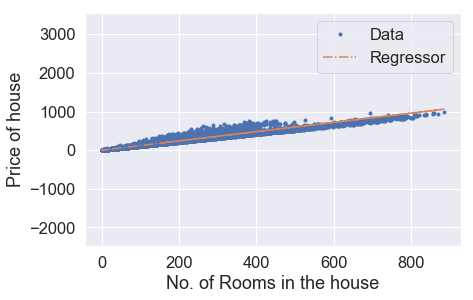

Iteration: 6661,Cost = 941.8327692324336,theta = [0.34844725 1.19764959]
Iteration: 6661,Cost_val = 946.1181211723733,theta = [0.34844725 1.19764959]


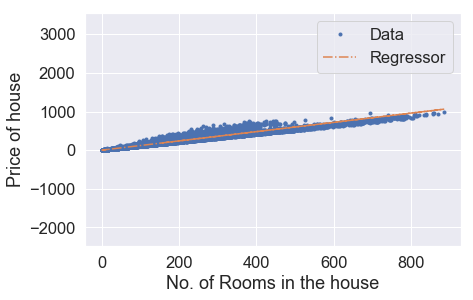

Iteration: 6671,Cost = 941.8302582603894,theta = [0.34894834 1.19764794]
Iteration: 6671,Cost_val = 946.1156534935063,theta = [0.34894834 1.19764794]


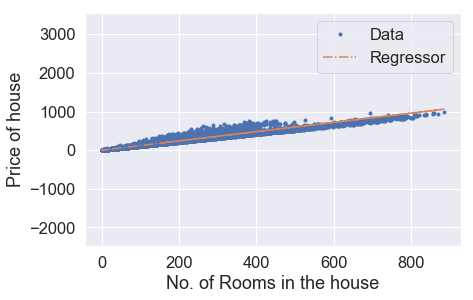

Iteration: 6681,Cost = 941.8277475362961,theta = [0.34944941 1.1976463 ]
Iteration: 6681,Cost_val = 946.1131860578748,theta = [0.34944941 1.1976463 ]


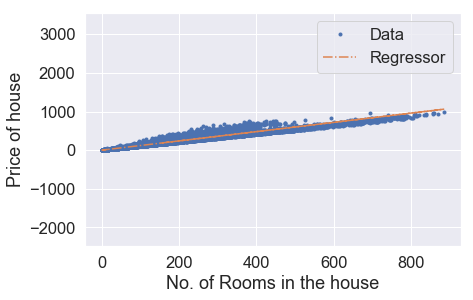

Iteration: 6691,Cost = 941.825237060129,theta = [0.34995046 1.19764466]
Iteration: 6691,Cost_val = 946.1107188654529,theta = [0.34995046 1.19764466]


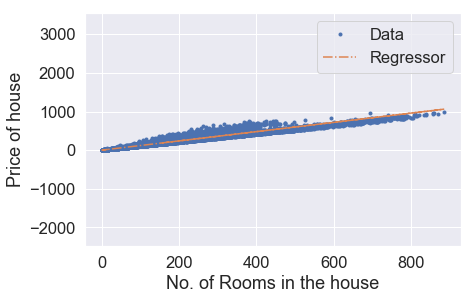

Iteration: 6701,Cost = 941.8227268318465,theta = [0.35045148 1.19764302]
Iteration: 6701,Cost_val = 946.1082519162106,theta = [0.35045148 1.19764302]


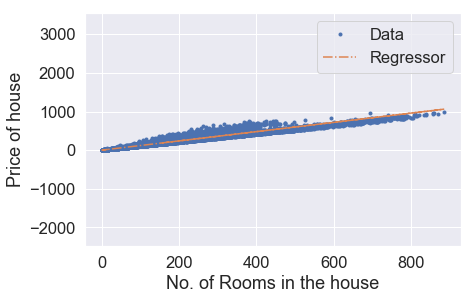

Iteration: 6711,Cost = 941.8202168514496,theta = [0.35095247 1.19764137]
Iteration: 6711,Cost_val = 946.1057852101333,theta = [0.35095247 1.19764137]


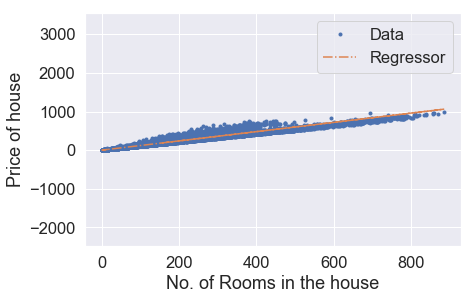

Iteration: 6721,Cost = 941.8177071188985,theta = [0.35145344 1.19763973]
Iteration: 6721,Cost_val = 946.1033187471953,theta = [0.35145344 1.19763973]


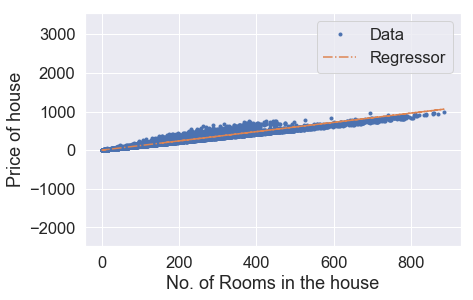

Iteration: 6731,Cost = 941.8151976341805,theta = [0.35195439 1.19763809]
Iteration: 6731,Cost_val = 946.1008525273695,theta = [0.35195439 1.19763809]


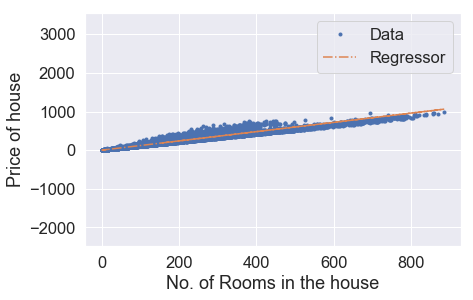

Iteration: 6741,Cost = 941.8126883972602,theta = [0.35245531 1.19763645]
Iteration: 6741,Cost_val = 946.0983865506316,theta = [0.35245531 1.19763645]


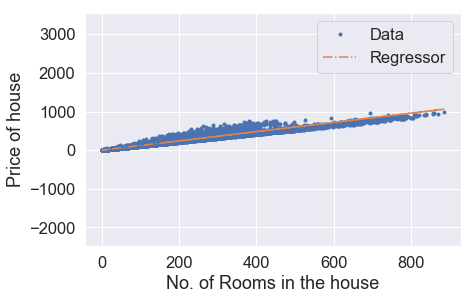

Iteration: 6751,Cost = 941.8101794081133,theta = [0.3529562 1.1976348]
Iteration: 6751,Cost_val = 946.0959208169567,theta = [0.3529562 1.1976348]


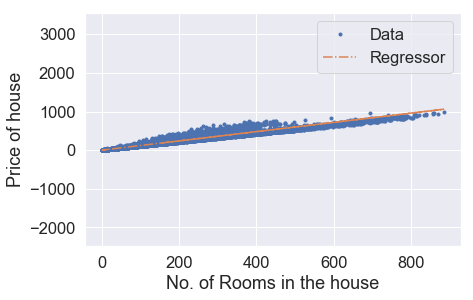

Iteration: 6761,Cost = 941.8076706667201,theta = [0.35345707 1.19763316]
Iteration: 6761,Cost_val = 946.0934553263277,theta = [0.35345707 1.19763316]


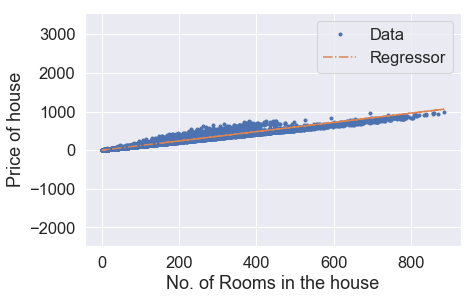

Iteration: 6771,Cost = 941.8051621730558,theta = [0.35395792 1.19763152]
Iteration: 6771,Cost_val = 946.0909900787091,theta = [0.35395792 1.19763152]


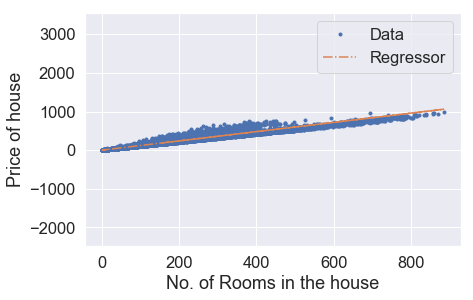

Iteration: 6781,Cost = 941.8026539270771,theta = [0.35445874 1.19762988]
Iteration: 6781,Cost_val = 946.0885250740904,theta = [0.35445874 1.19762988]


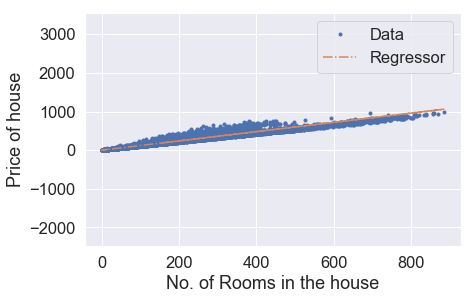

Iteration: 6791,Cost = 941.8001459288075,theta = [0.35495954 1.19762823]
Iteration: 6791,Cost_val = 946.0860603124364,theta = [0.35495954 1.19762823]


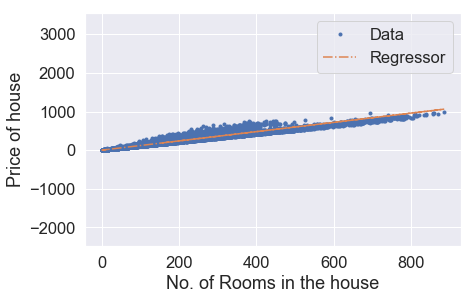

Iteration: 6801,Cost = 941.7976381781638,theta = [0.35546031 1.19762659]
Iteration: 6801,Cost_val = 946.0835957937335,theta = [0.35546031 1.19762659]


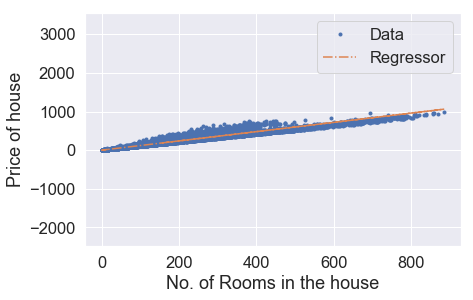

Iteration: 6811,Cost = 941.7951306751594,theta = [0.35596106 1.19762495]
Iteration: 6811,Cost_val = 946.0811315179508,theta = [0.35596106 1.19762495]


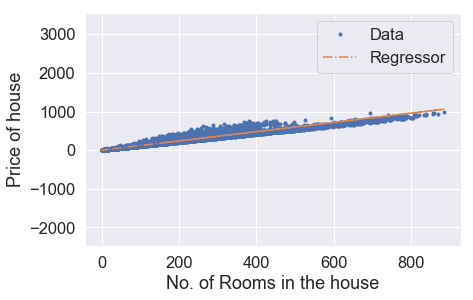

Iteration: 6821,Cost = 941.7926234197694,theta = [0.35646178 1.19762331]
Iteration: 6821,Cost_val = 946.0786674850624,theta = [0.35646178 1.19762331]


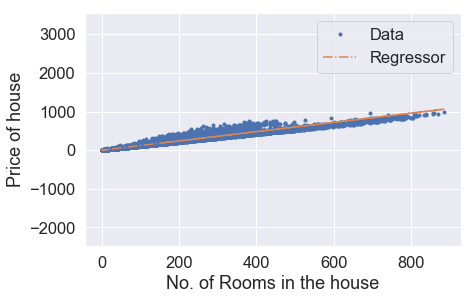

Iteration: 6831,Cost = 941.790116411951,theta = [0.35696248 1.19762167]
Iteration: 6831,Cost_val = 946.0762036950497,theta = [0.35696248 1.19762167]


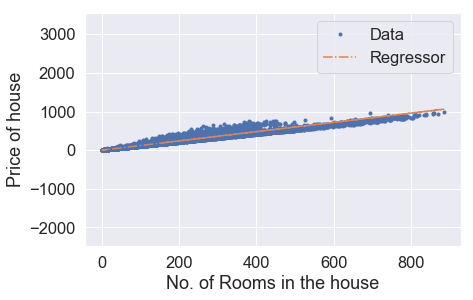

Iteration: 6841,Cost = 941.7876096516943,theta = [0.35746315 1.19762002]
Iteration: 6841,Cost_val = 946.0737401478889,theta = [0.35746315 1.19762002]


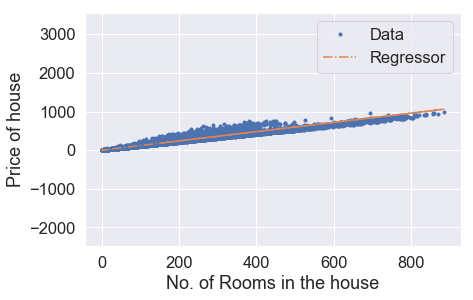

Iteration: 6851,Cost = 941.7851031389584,theta = [0.3579638  1.19761838]
Iteration: 6851,Cost_val = 946.071276843549,theta = [0.3579638  1.19761838]


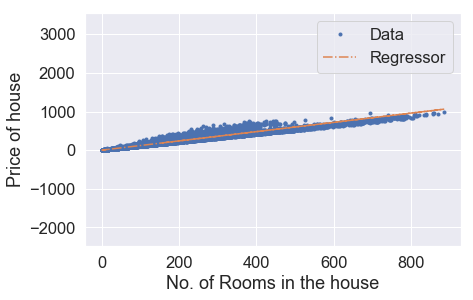

Iteration: 6861,Cost = 941.7825968737378,theta = [0.35846443 1.19761674]
Iteration: 6861,Cost_val = 946.0688137820132,theta = [0.35846443 1.19761674]


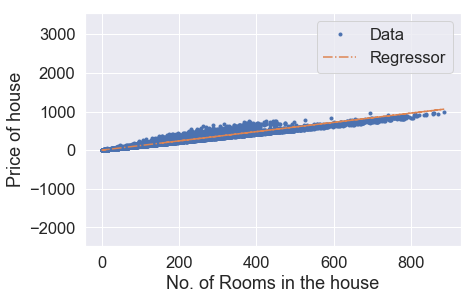

Iteration: 6871,Cost = 941.7800908559973,theta = [0.35896503 1.1976151 ]
Iteration: 6871,Cost_val = 946.0663509632532,theta = [0.35896503 1.1976151 ]


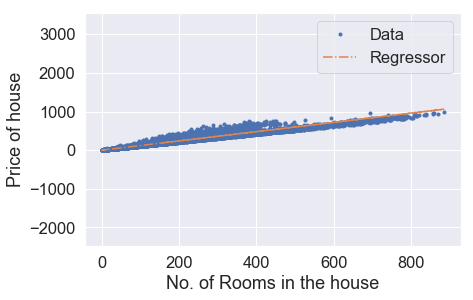

Iteration: 6881,Cost = 941.7775850857197,theta = [0.3594656  1.19761346]
Iteration: 6881,Cost_val = 946.0638883872484,theta = [0.3594656  1.19761346]


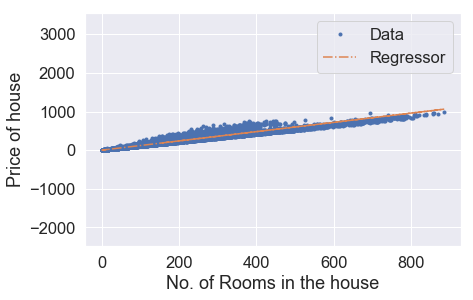

Iteration: 6891,Cost = 941.7750795628671,theta = [0.35996615 1.19761182]
Iteration: 6891,Cost_val = 946.0614260539721,theta = [0.35996615 1.19761182]


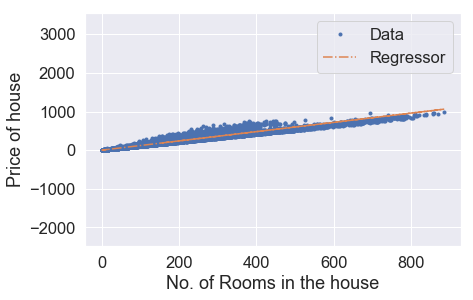

Iteration: 6901,Cost = 941.7725742874395,theta = [0.36046668 1.19761018]
Iteration: 6901,Cost_val = 946.0589639634014,theta = [0.36046668 1.19761018]


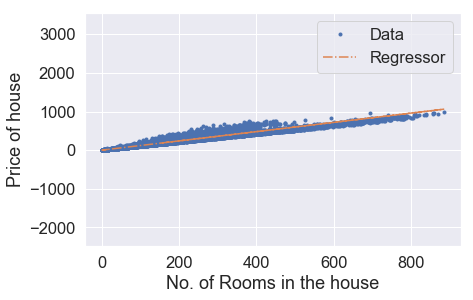

Iteration: 6911,Cost = 941.7700692593799,theta = [0.36096718 1.19760853]
Iteration: 6911,Cost_val = 946.0565021155123,theta = [0.36096718 1.19760853]


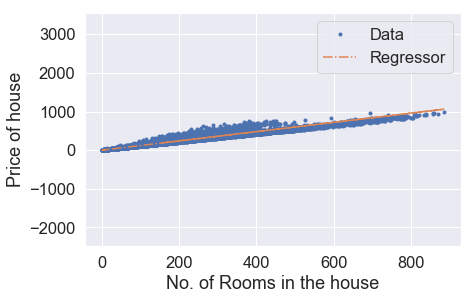

Iteration: 6921,Cost = 941.76756447869,theta = [0.36146765 1.19760689]
Iteration: 6921,Cost_val = 946.0540405102821,theta = [0.36146765 1.19760689]


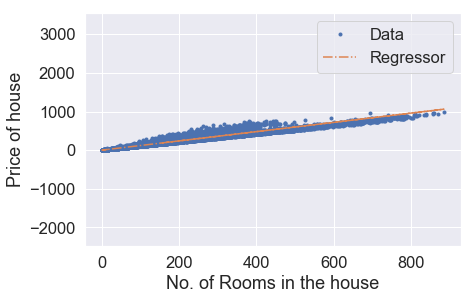

Iteration: 6931,Cost = 941.7650599453476,theta = [0.3619681  1.19760525]
Iteration: 6931,Cost_val = 946.051579147686,theta = [0.3619681  1.19760525]


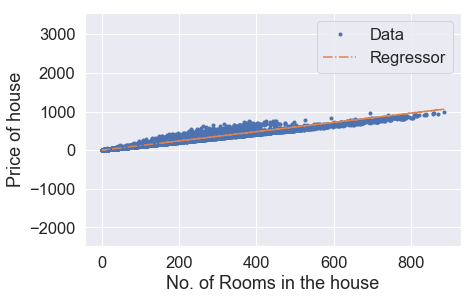

Iteration: 6941,Cost = 941.7625556592899,theta = [0.36246853 1.19760361]
Iteration: 6941,Cost_val = 946.049118027699,theta = [0.36246853 1.19760361]


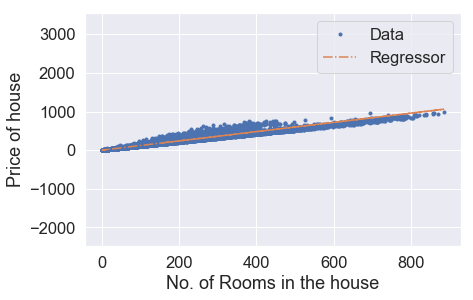

Iteration: 6951,Cost = 941.7600516205324,theta = [0.36296893 1.19760197]
Iteration: 6951,Cost_val = 946.046657150303,theta = [0.36296893 1.19760197]


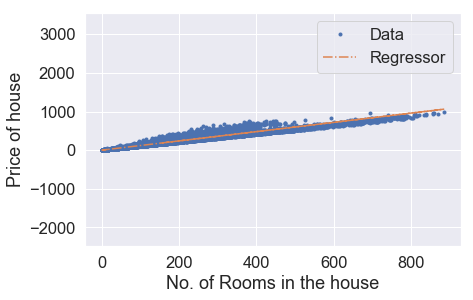

Iteration: 6961,Cost = 941.757547829041,theta = [0.36346931 1.19760033]
Iteration: 6961,Cost_val = 946.0441965154617,theta = [0.36346931 1.19760033]


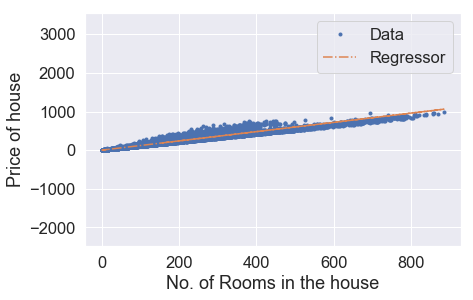

Iteration: 6971,Cost = 941.7550442847939,theta = [0.36396966 1.19759869]
Iteration: 6971,Cost_val = 946.0417361231652,theta = [0.36396966 1.19759869]


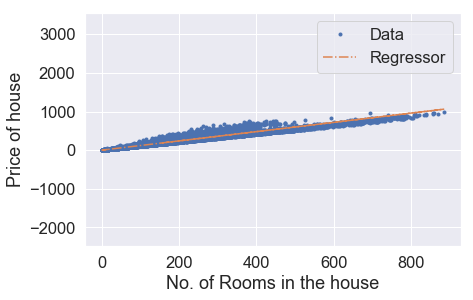

Iteration: 6981,Cost = 941.7525409877464,theta = [0.36446999 1.19759705]
Iteration: 6981,Cost_val = 946.0392759733812,theta = [0.36446999 1.19759705]


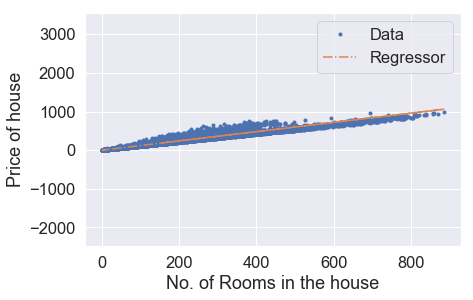

Iteration: 6991,Cost = 941.7500379378969,theta = [0.36497029 1.19759541]
Iteration: 6991,Cost_val = 946.0368160660873,theta = [0.36497029 1.19759541]


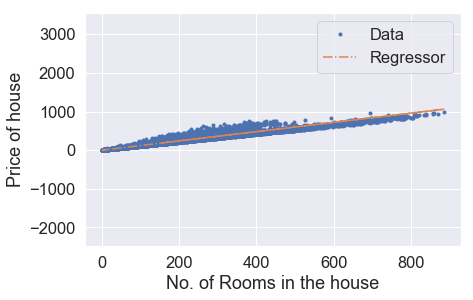

Iteration: 7001,Cost = 941.7475351352051,theta = [0.36547057 1.19759377]
Iteration: 7001,Cost_val = 946.0343564012566,theta = [0.36547057 1.19759377]


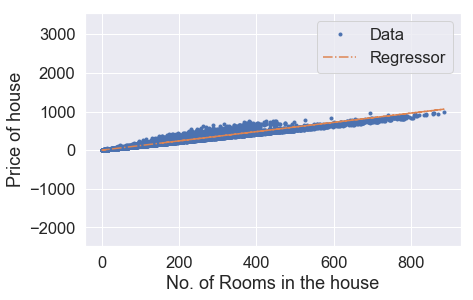

Iteration: 7011,Cost = 941.7450325796677,theta = [0.36597082 1.19759213]
Iteration: 7011,Cost_val = 946.0318969788703,theta = [0.36597082 1.19759213]


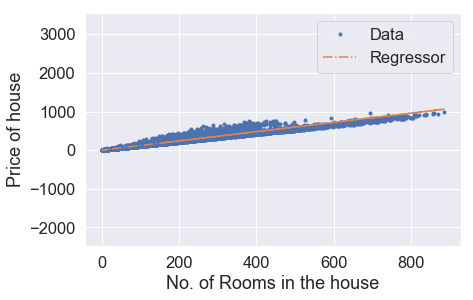

Iteration: 7021,Cost = 941.7425302712322,theta = [0.36647105 1.19759049]
Iteration: 7021,Cost_val = 946.029437798904,theta = [0.36647105 1.19759049]


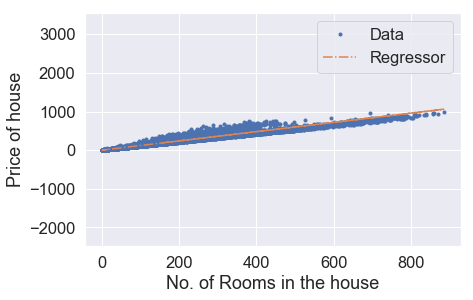

Iteration: 7031,Cost = 941.7400282099029,theta = [0.36697126 1.19758885]
Iteration: 7031,Cost_val = 946.0269788613306,theta = [0.36697126 1.19758885]


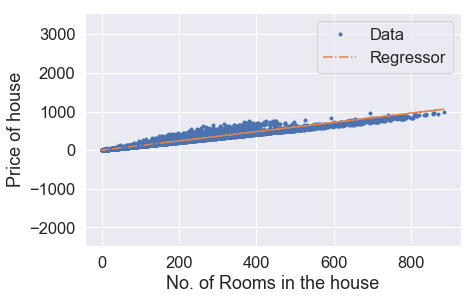

Iteration: 7041,Cost = 941.7375263956321,theta = [0.36747143 1.19758721]
Iteration: 7041,Cost_val = 946.0245201661301,theta = [0.36747143 1.19758721]


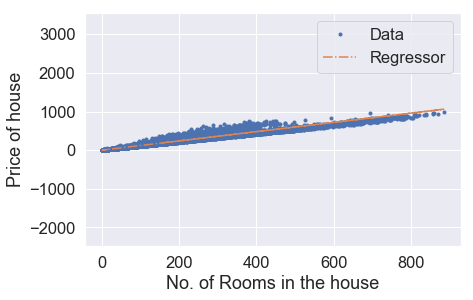

Iteration: 7051,Cost = 941.7350248284075,theta = [0.36797159 1.19758557]
Iteration: 7051,Cost_val = 946.0220617132758,theta = [0.36797159 1.19758557]


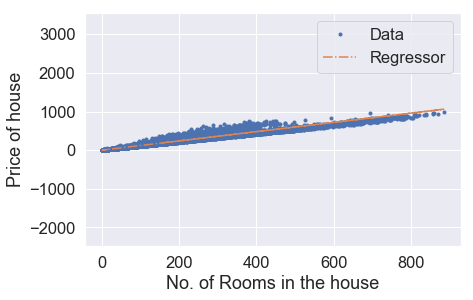

Iteration: 7061,Cost = 941.7325235082071,theta = [0.36847172 1.19758393]
Iteration: 7061,Cost_val = 946.0196035027468,theta = [0.36847172 1.19758393]


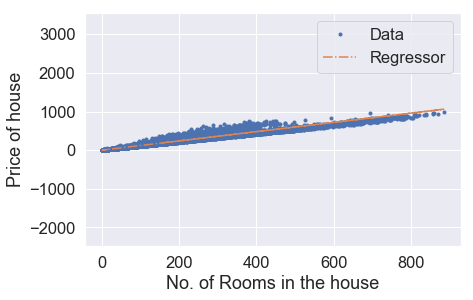

Iteration: 7071,Cost = 941.7300224349908,theta = [0.36897182 1.19758229]
Iteration: 7071,Cost_val = 946.0171455345112,theta = [0.36897182 1.19758229]


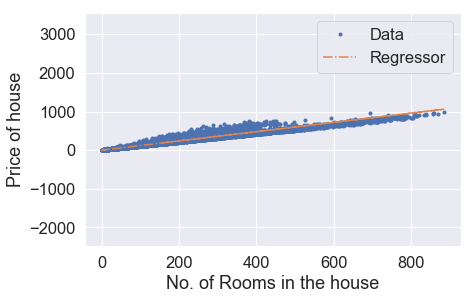

Iteration: 7081,Cost = 941.7275216087447,theta = [0.36947191 1.19758065]
Iteration: 7081,Cost_val = 946.0146878085542,theta = [0.36947191 1.19758065]


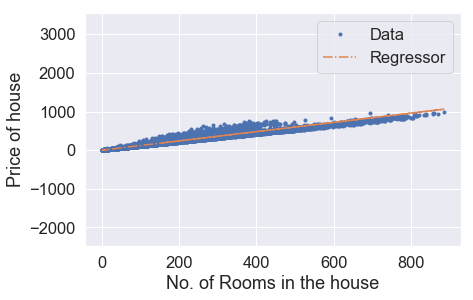

Iteration: 7091,Cost = 941.7250210294565,theta = [0.36997196 1.19757901]
Iteration: 7091,Cost_val = 946.01223032485,theta = [0.36997196 1.19757901]


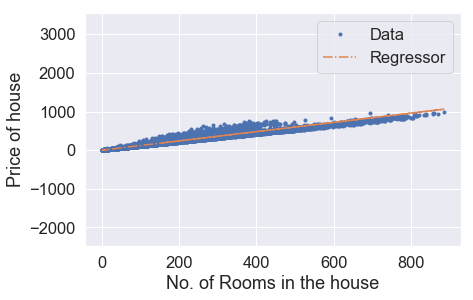

Iteration: 7101,Cost = 941.7225206970814,theta = [0.37047199 1.19757737]
Iteration: 7101,Cost_val = 946.0097730833673,theta = [0.37047199 1.19757737]


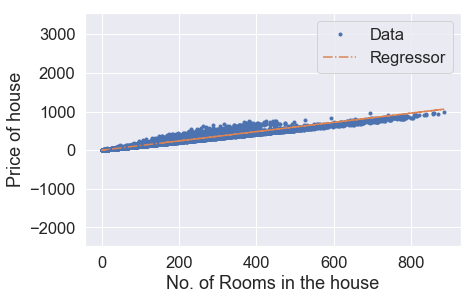

Iteration: 7111,Cost = 941.720020611596,theta = [0.370972   1.19757573]
Iteration: 7111,Cost_val = 946.0073160840944,theta = [0.370972   1.19757573]


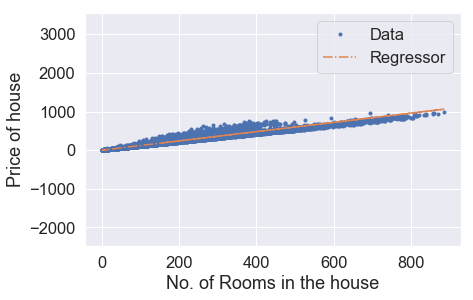

Iteration: 7121,Cost = 941.7175207729898,theta = [0.37147198 1.19757409]
Iteration: 7121,Cost_val = 946.0048593269973,theta = [0.37147198 1.19757409]


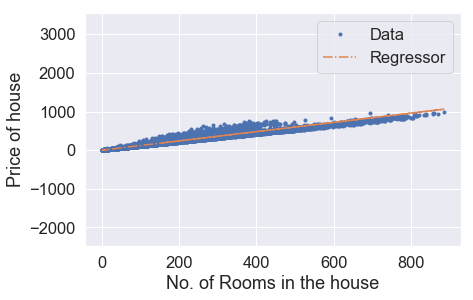

Iteration: 7131,Cost = 941.715021181242,theta = [0.37197194 1.19757245]
Iteration: 7131,Cost_val = 946.002402812059,theta = [0.37197194 1.19757245]


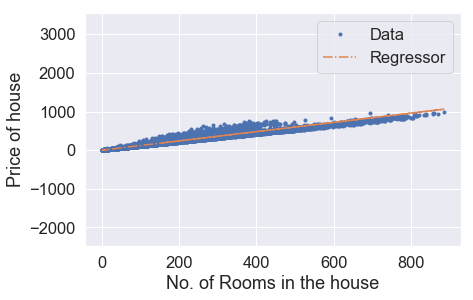

Iteration: 7141,Cost = 941.7125218363057,theta = [0.37247187 1.19757081]
Iteration: 7141,Cost_val = 945.9999465392519,theta = [0.37247187 1.19757081]


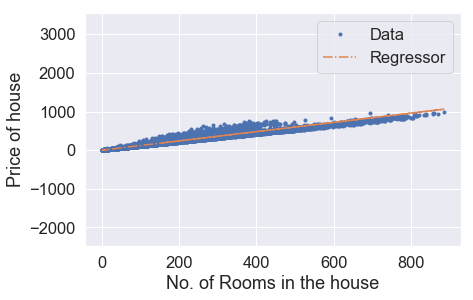

Iteration: 7151,Cost = 941.7100227381699,theta = [0.37297178 1.19756917]
Iteration: 7151,Cost_val = 945.9974905085475,theta = [0.37297178 1.19756917]


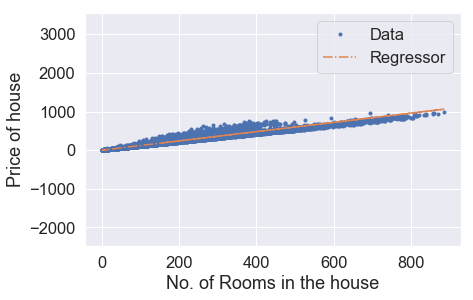

Iteration: 7161,Cost = 941.7075238868131,theta = [0.37347166 1.19756753]
Iteration: 7161,Cost_val = 945.995034719931,theta = [0.37347166 1.19756753]


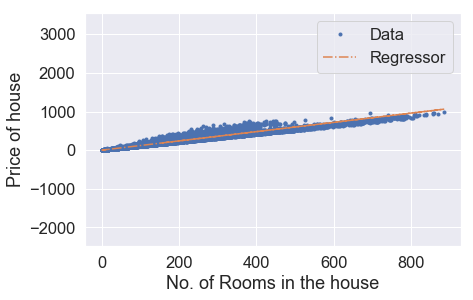

Iteration: 7171,Cost = 941.7050252822046,theta = [0.37397152 1.19756589]
Iteration: 7171,Cost_val = 945.9925791733766,theta = [0.37397152 1.19756589]


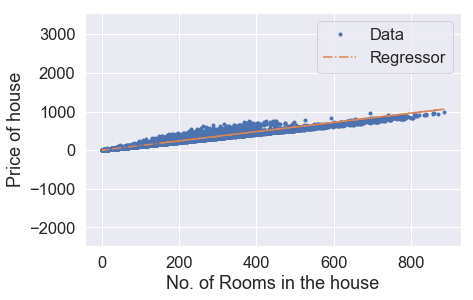

Iteration: 7181,Cost = 941.7025269243268,theta = [0.37447135 1.19756425]
Iteration: 7181,Cost_val = 945.9901238688541,theta = [0.37447135 1.19756425]


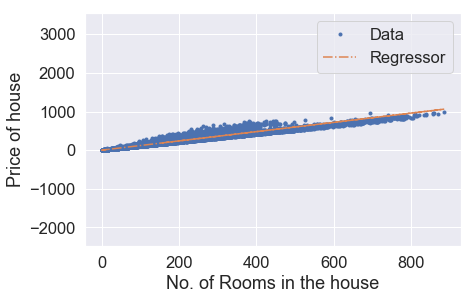

Iteration: 7191,Cost = 941.7000288131507,theta = [0.37497116 1.19756261]
Iteration: 7191,Cost_val = 945.9876688063498,theta = [0.37497116 1.19756261]


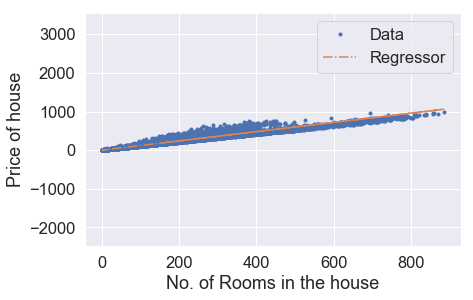

Iteration: 7201,Cost = 941.6975309486437,theta = [0.37547095 1.19756098]
Iteration: 7201,Cost_val = 945.9852139858307,theta = [0.37547095 1.19756098]


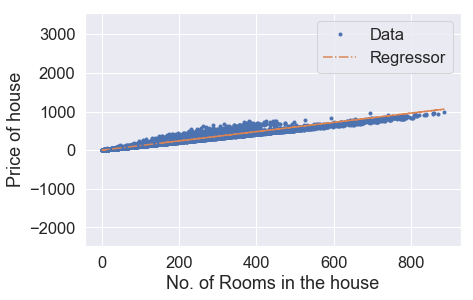

Iteration: 7211,Cost = 941.6950333307992,theta = [0.37597071 1.19755934]
Iteration: 7211,Cost_val = 945.9827594072752,theta = [0.37597071 1.19755934]


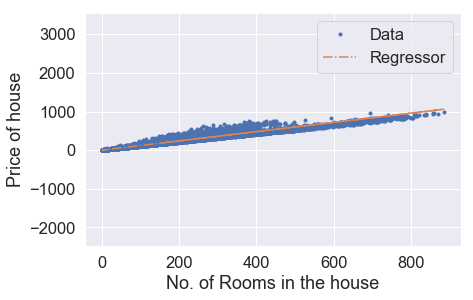

Iteration: 7221,Cost = 941.6925359595734,theta = [0.37647044 1.1975577 ]
Iteration: 7221,Cost_val = 945.9803050706647,theta = [0.37647044 1.1975577 ]


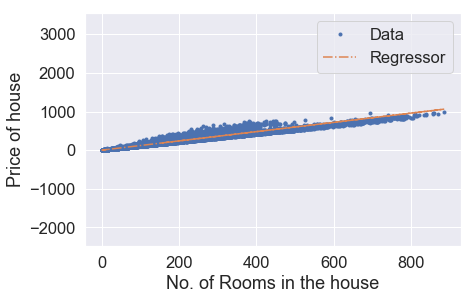

Iteration: 7231,Cost = 941.6900388349651,theta = [0.37697015 1.19755606]
Iteration: 7231,Cost_val = 945.9778509759653,theta = [0.37697015 1.19755606]


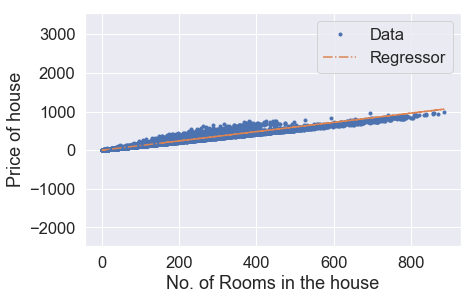

Iteration: 7241,Cost = 941.687541956928,theta = [0.37746984 1.19755442]
Iteration: 7241,Cost_val = 945.9753971231645,theta = [0.37746984 1.19755442]


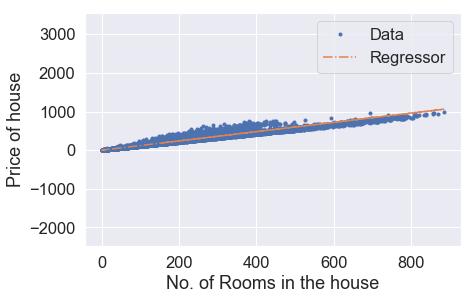

Iteration: 7251,Cost = 941.6850453254496,theta = [0.3779695  1.19755278]
Iteration: 7251,Cost_val = 945.9729435122274,theta = [0.3779695  1.19755278]


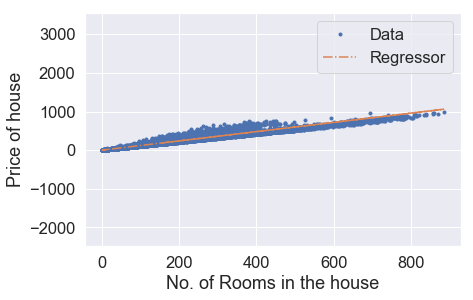

Iteration: 7261,Cost = 941.6825489405142,theta = [0.37846913 1.19755114]
Iteration: 7261,Cost_val = 945.9704901431396,theta = [0.37846913 1.19755114]


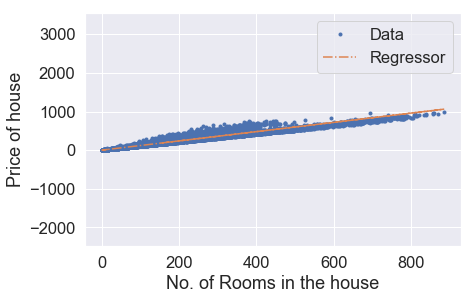

Iteration: 7271,Cost = 941.6800528020651,theta = [0.37896875 1.19754951]
Iteration: 7271,Cost_val = 945.9680370158696,theta = [0.37896875 1.19754951]


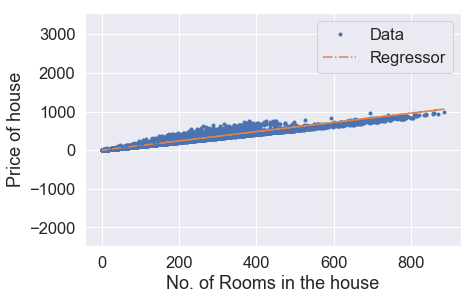

Iteration: 7281,Cost = 941.6775569101093,theta = [0.37946833 1.19754787]
Iteration: 7281,Cost_val = 945.9655841304018,theta = [0.37946833 1.19754787]


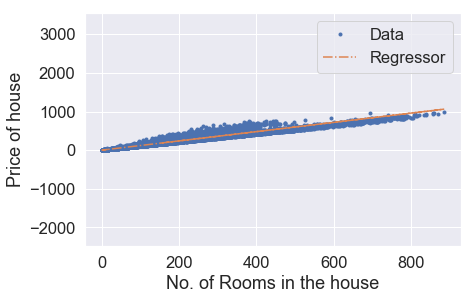

Iteration: 7291,Cost = 941.6750612646084,theta = [0.37996789 1.19754623]
Iteration: 7291,Cost_val = 945.9631314867006,theta = [0.37996789 1.19754623]


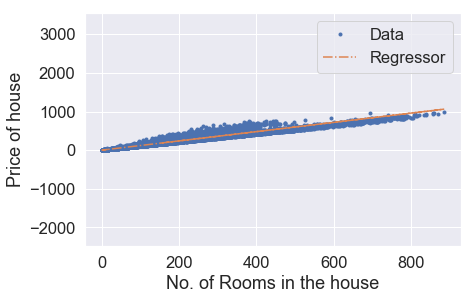

Iteration: 7301,Cost = 941.6725658655406,theta = [0.38046743 1.19754459]
Iteration: 7301,Cost_val = 945.9606790847587,theta = [0.38046743 1.19754459]


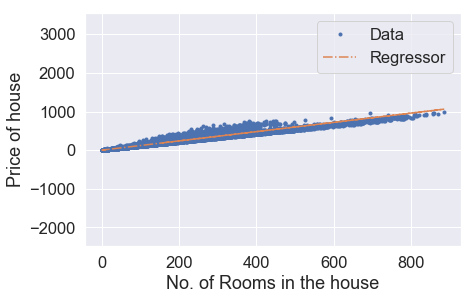

Iteration: 7311,Cost = 941.6700707128865,theta = [0.38096695 1.19754295]
Iteration: 7311,Cost_val = 945.9582269245383,theta = [0.38096695 1.19754295]


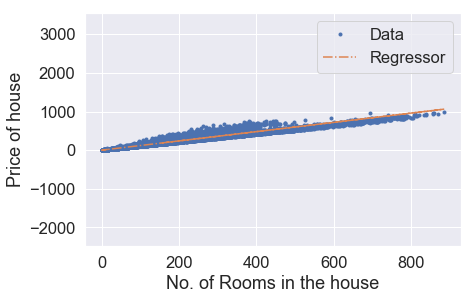

Iteration: 7321,Cost = 941.6675758066215,theta = [0.38146643 1.19754132]
Iteration: 7321,Cost_val = 945.9557750060194,theta = [0.38146643 1.19754132]


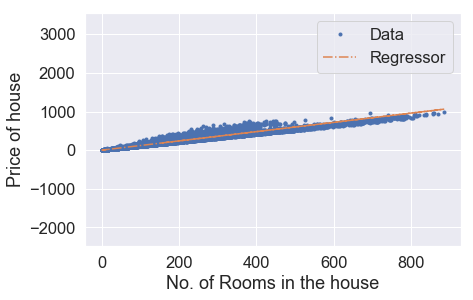

Iteration: 7331,Cost = 941.6650811467127,theta = [0.3819659  1.19753968]
Iteration: 7331,Cost_val = 945.9533233291785,theta = [0.3819659  1.19753968]


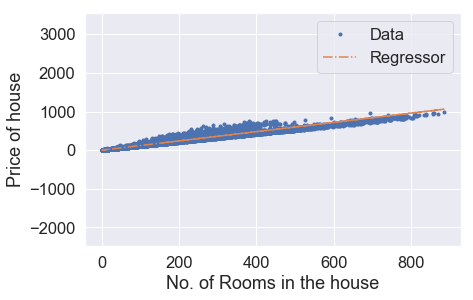

Iteration: 7341,Cost = 941.6625867331381,theta = [0.38246534 1.19753804]
Iteration: 7341,Cost_val = 945.9508718939917,theta = [0.38246534 1.19753804]


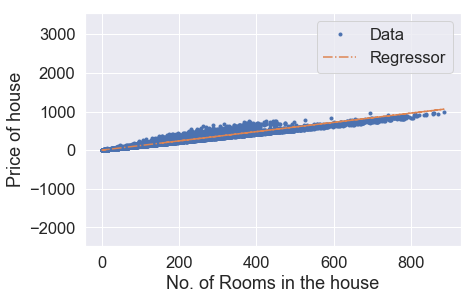

Iteration: 7351,Cost = 941.660092565875,theta = [0.38296475 1.1975364 ]
Iteration: 7351,Cost_val = 945.9484207004411,theta = [0.38296475 1.1975364 ]


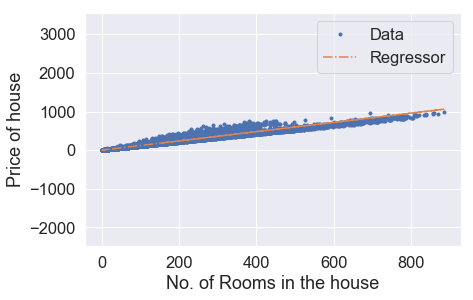

Iteration: 7361,Cost = 941.6575986449211,theta = [0.38346414 1.19753477]
Iteration: 7361,Cost_val = 945.94596974849,theta = [0.38346414 1.19753477]


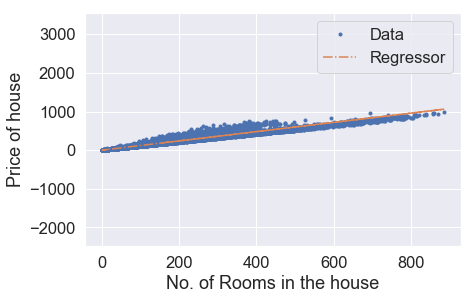

Iteration: 7371,Cost = 941.6551049701935,theta = [0.38396351 1.19753313]
Iteration: 7371,Cost_val = 945.9435190381242,theta = [0.38396351 1.19753313]


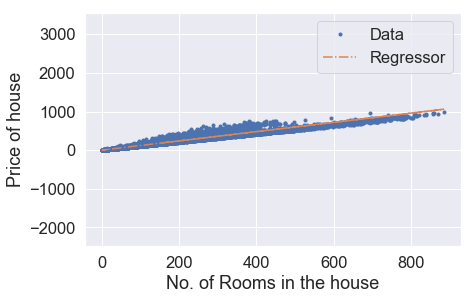

Iteration: 7381,Cost = 941.6526115417331,theta = [0.38446285 1.19753149]
Iteration: 7381,Cost_val = 945.9410685693208,theta = [0.38446285 1.19753149]


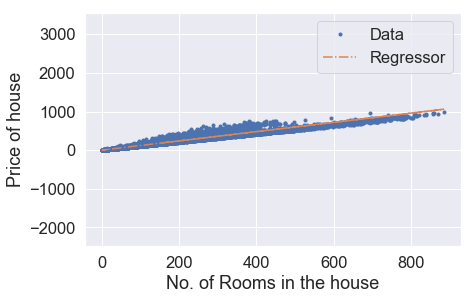

Iteration: 7391,Cost = 941.6501183594867,theta = [0.38496216 1.19752985]
Iteration: 7391,Cost_val = 945.9386183420479,theta = [0.38496216 1.19752985]


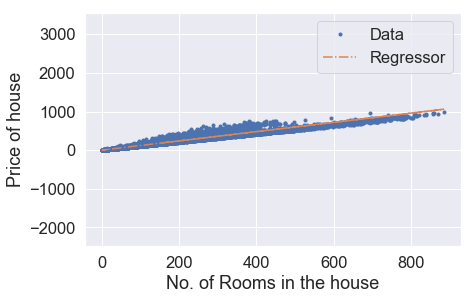

Iteration: 7401,Cost = 941.6476254234209,theta = [0.38546145 1.19752822]
Iteration: 7401,Cost_val = 945.9361683562872,theta = [0.38546145 1.19752822]


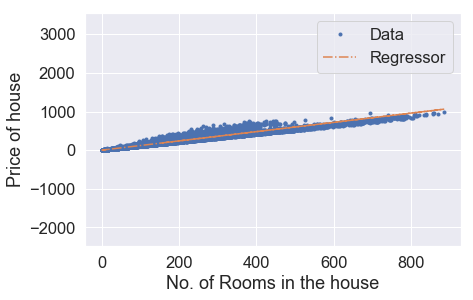

Iteration: 7411,Cost = 941.6451327335262,theta = [0.38596072 1.19752658]
Iteration: 7411,Cost_val = 945.9337186120156,theta = [0.38596072 1.19752658]


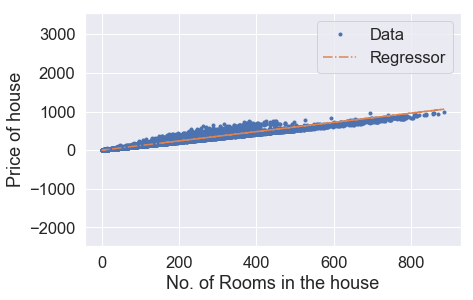

Iteration: 7421,Cost = 941.6426402897738,theta = [0.38645996 1.19752494]
Iteration: 7421,Cost_val = 945.9312691092073,theta = [0.38645996 1.19752494]


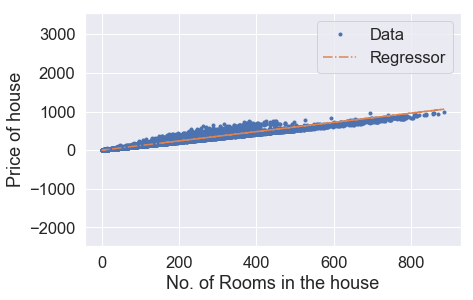

Iteration: 7431,Cost = 941.6401480921442,theta = [0.38695918 1.19752331]
Iteration: 7431,Cost_val = 945.9288198478413,theta = [0.38695918 1.19752331]


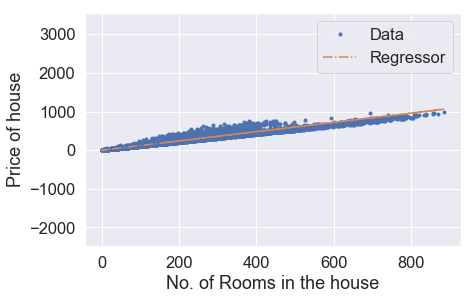

Iteration: 7441,Cost = 941.6376561405962,theta = [0.38745837 1.19752167]
Iteration: 7441,Cost_val = 945.9263708278895,theta = [0.38745837 1.19752167]


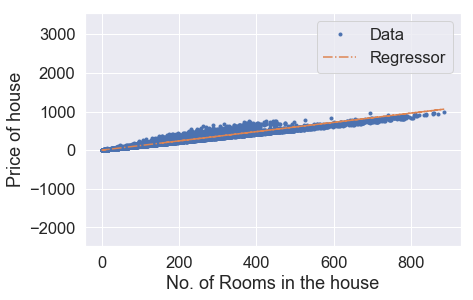

Iteration: 7451,Cost = 941.6351644351342,theta = [0.38795754 1.19752003]
Iteration: 7451,Cost_val = 945.9239220493329,theta = [0.38795754 1.19752003]


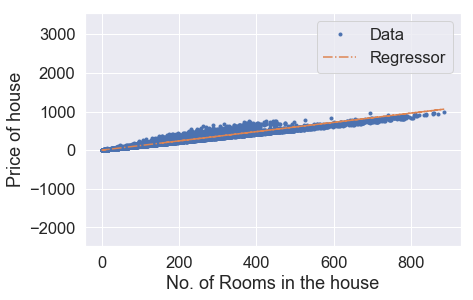

Iteration: 7461,Cost = 941.6326729757039,theta = [0.38845668 1.1975184 ]
Iteration: 7461,Cost_val = 945.9214735121368,theta = [0.38845668 1.1975184 ]


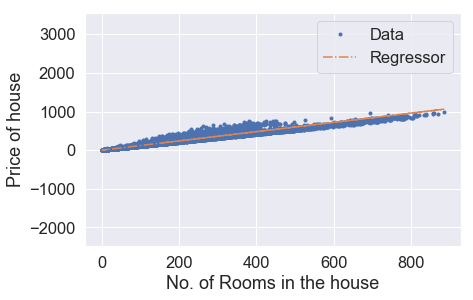

Iteration: 7471,Cost = 941.6301817622959,theta = [0.3889558  1.19751676]
Iteration: 7471,Cost_val = 945.9190252162945,theta = [0.3889558  1.19751676]


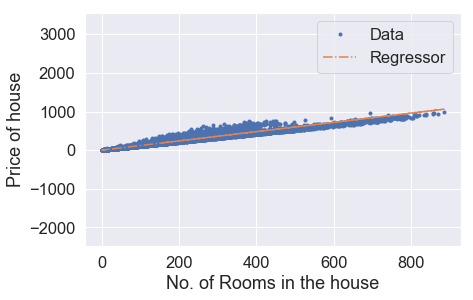

Iteration: 7481,Cost = 941.6276907948911,theta = [0.38945489 1.19751512]
Iteration: 7481,Cost_val = 945.9165771617705,theta = [0.38945489 1.19751512]


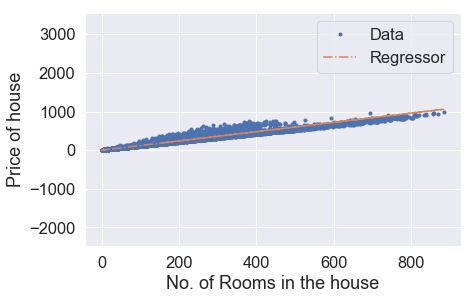

Iteration: 7491,Cost = 941.6252000734662,theta = [0.38995396 1.19751349]
Iteration: 7491,Cost_val = 945.9141293485401,theta = [0.38995396 1.19751349]


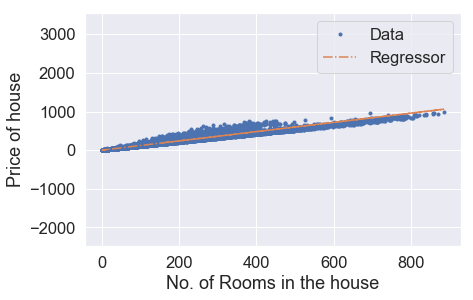

Iteration: 7501,Cost = 941.622709597963,theta = [0.39045301 1.19751185]
Iteration: 7501,Cost_val = 945.9116817765855,theta = [0.39045301 1.19751185]


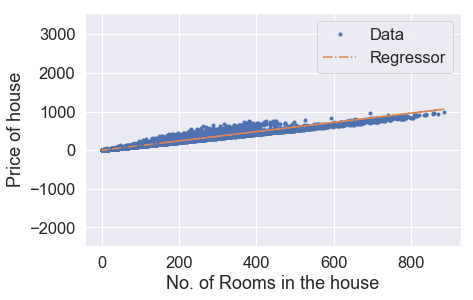

Iteration: 7511,Cost = 941.6202193684002,theta = [0.39095203 1.19751021]
Iteration: 7511,Cost_val = 945.9092344458818,theta = [0.39095203 1.19751021]


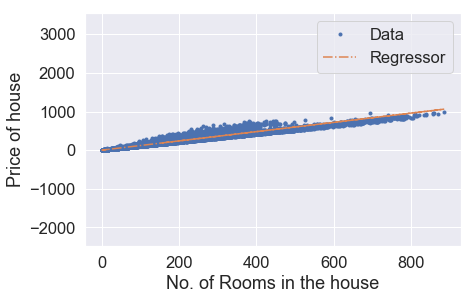

Iteration: 7521,Cost = 941.6177293847345,theta = [0.39145102 1.19750858]
Iteration: 7521,Cost_val = 945.9067873564019,theta = [0.39145102 1.19750858]


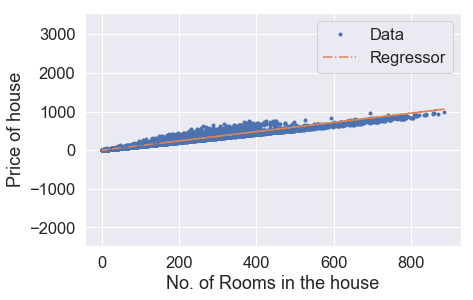

Iteration: 7531,Cost = 941.6152396469446,theta = [0.39194999 1.19750694]
Iteration: 7531,Cost_val = 945.9043405081228,theta = [0.39194999 1.19750694]


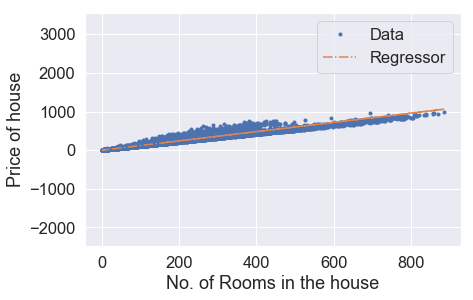

Iteration: 7541,Cost = 941.6127501550035,theta = [0.39244894 1.1975053 ]
Iteration: 7541,Cost_val = 945.9018939010255,theta = [0.39244894 1.1975053 ]


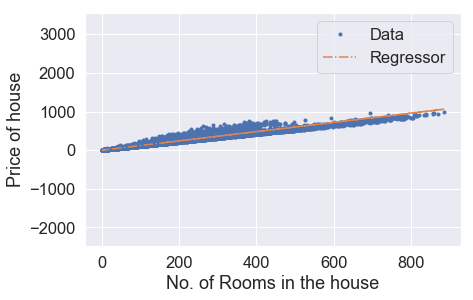

Iteration: 7551,Cost = 941.61026090889,theta = [0.39294786 1.19750367]
Iteration: 7551,Cost_val = 945.8994475350826,theta = [0.39294786 1.19750367]


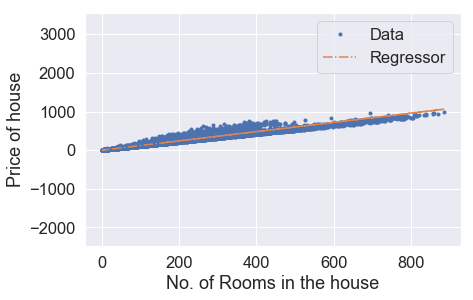

Iteration: 7561,Cost = 941.6077719085861,theta = [0.39344676 1.19750203]
Iteration: 7561,Cost_val = 945.8970014102672,theta = [0.39344676 1.19750203]


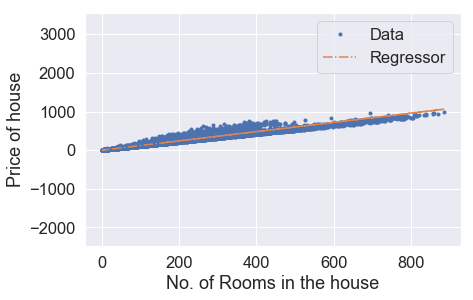

Iteration: 7571,Cost = 941.6052831540487,theta = [0.39394563 1.1975004 ]
Iteration: 7571,Cost_val = 945.8945555265586,theta = [0.39394563 1.1975004 ]


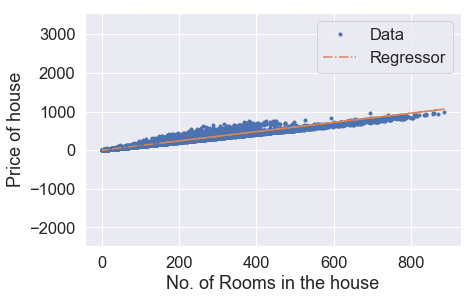

Iteration: 7581,Cost = 941.6027946452692,theta = [0.39444448 1.19749876]
Iteration: 7581,Cost_val = 945.8921098839307,theta = [0.39444448 1.19749876]


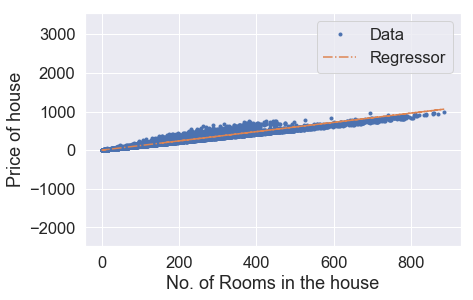

Iteration: 7591,Cost = 941.6003063822237,theta = [0.3949433  1.19749713]
Iteration: 7591,Cost_val = 945.8896644823685,theta = [0.3949433  1.19749713]


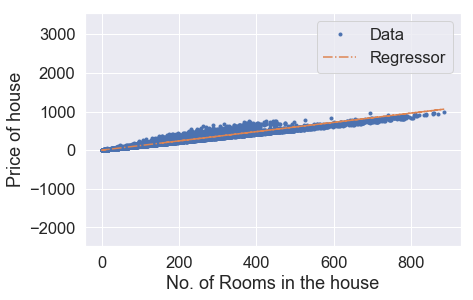

Iteration: 7601,Cost = 941.5978183648784,theta = [0.3954421  1.19749549]
Iteration: 7601,Cost_val = 945.8872193218364,theta = [0.3954421  1.19749549]


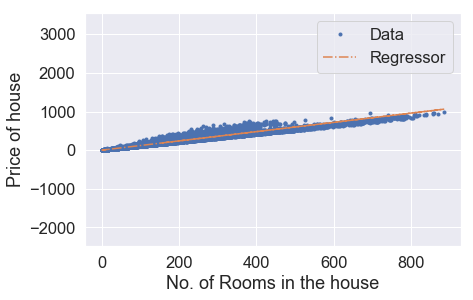

Iteration: 7611,Cost = 941.5953305932094,theta = [0.39594087 1.19749385]
Iteration: 7611,Cost_val = 945.8847744023205,theta = [0.39594087 1.19749385]


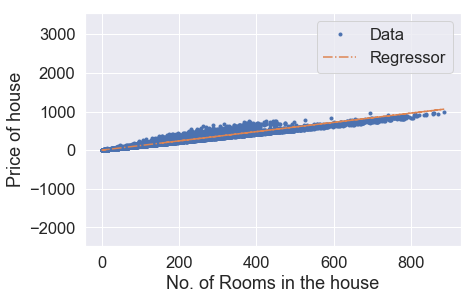

Iteration: 7621,Cost = 941.5928430672054,theta = [0.39643962 1.19749222]
Iteration: 7621,Cost_val = 945.8823297237899,theta = [0.39643962 1.19749222]


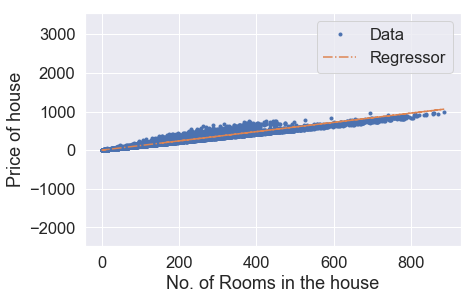

Iteration: 7631,Cost = 941.5903557868371,theta = [0.39693834 1.19749058]
Iteration: 7631,Cost_val = 945.8798852862245,theta = [0.39693834 1.19749058]


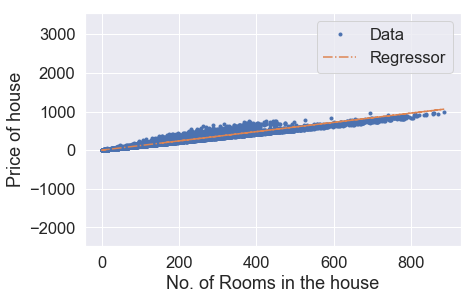

Iteration: 7641,Cost = 941.5878687520709,theta = [0.39743704 1.19748895]
Iteration: 7641,Cost_val = 945.8774410895954,theta = [0.39743704 1.19748895]


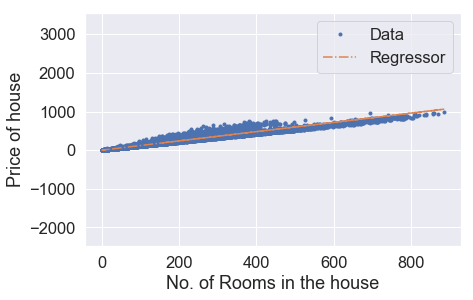

Iteration: 7651,Cost = 941.5853819628765,theta = [0.39793572 1.19748731]
Iteration: 7651,Cost_val = 945.874997133887,theta = [0.39793572 1.19748731]


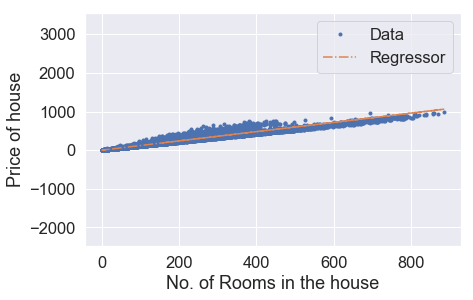

Iteration: 7661,Cost = 941.5828954192594,theta = [0.39843437 1.19748568]
Iteration: 7661,Cost_val = 945.8725534190696,theta = [0.39843437 1.19748568]


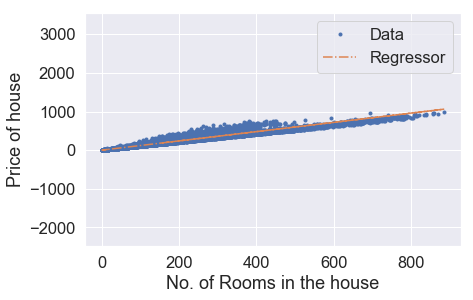

Iteration: 7671,Cost = 941.5804091211669,theta = [0.398933   1.19748404]
Iteration: 7671,Cost_val = 945.8701099451245,theta = [0.398933   1.19748404]


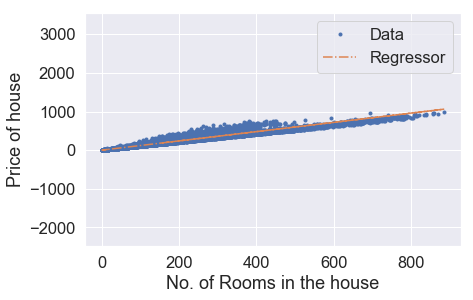

Iteration: 7681,Cost = 941.5779230685898,theta = [0.3994316  1.19748241]
Iteration: 7681,Cost_val = 945.8676667120201,theta = [0.3994316  1.19748241]


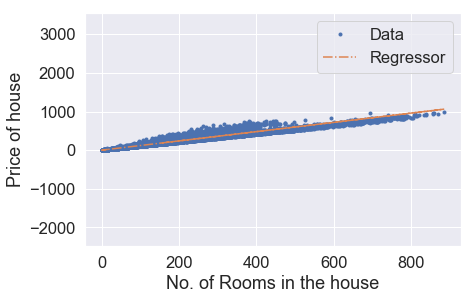

Iteration: 7691,Cost = 941.5754372615098,theta = [0.39993017 1.19748077]
Iteration: 7691,Cost_val = 945.8652237197384,theta = [0.39993017 1.19748077]


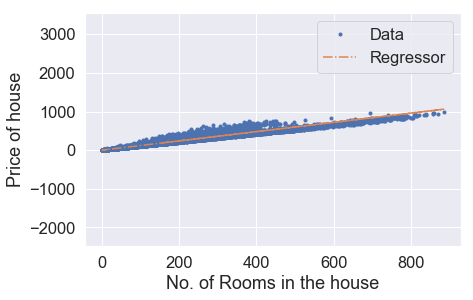

Iteration: 7701,Cost = 941.5729516998815,theta = [0.40042873 1.19747914]
Iteration: 7701,Cost_val = 945.8627809682539,theta = [0.40042873 1.19747914]


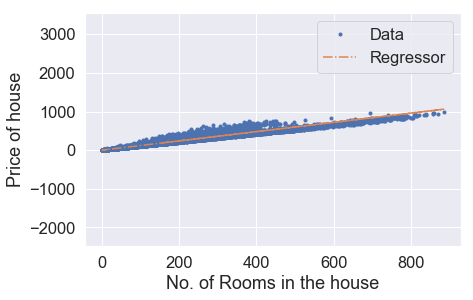

Iteration: 7711,Cost = 941.5704663836946,theta = [0.40092725 1.1974775 ]
Iteration: 7711,Cost_val = 945.8603384575432,theta = [0.40092725 1.1974775 ]


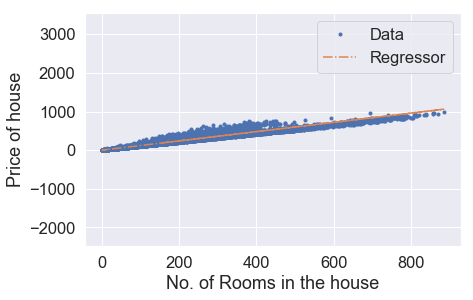

Iteration: 7721,Cost = 941.5679813129161,theta = [0.40142576 1.19747587]
Iteration: 7721,Cost_val = 945.8578961875863,theta = [0.40142576 1.19747587]


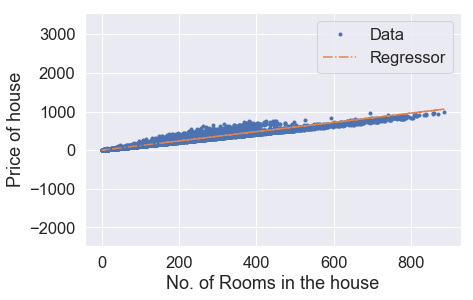

Iteration: 7731,Cost = 941.5654964875378,theta = [0.40192423 1.19747423]
Iteration: 7731,Cost_val = 945.8554541583517,theta = [0.40192423 1.19747423]


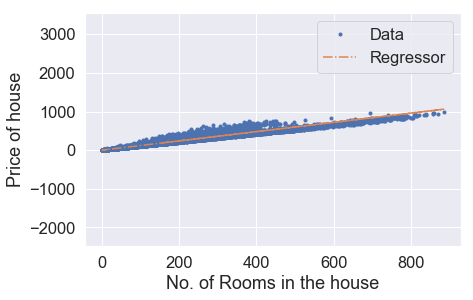

Iteration: 7741,Cost = 941.563011907512,theta = [0.40242269 1.1974726 ]
Iteration: 7741,Cost_val = 945.8530123698197,theta = [0.40242269 1.1974726 ]


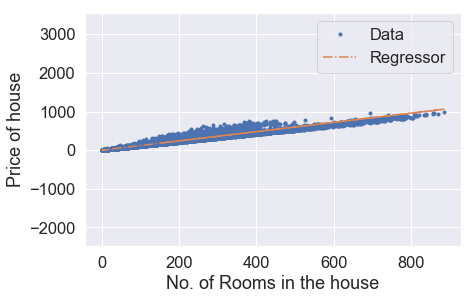

Iteration: 7751,Cost = 941.560527572831,theta = [0.40292112 1.19747097]
Iteration: 7751,Cost_val = 945.8505708219685,theta = [0.40292112 1.19747097]


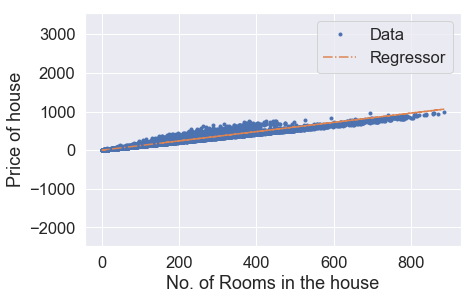

Iteration: 7761,Cost = 941.5580434834759,theta = [0.40341952 1.19746933]
Iteration: 7761,Cost_val = 945.8481295147737,theta = [0.40341952 1.19746933]


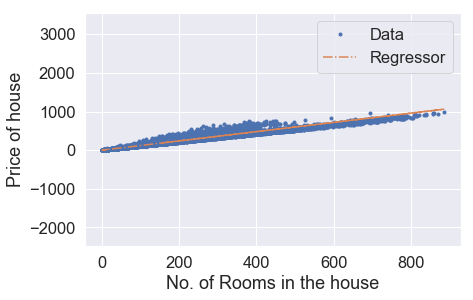

Iteration: 7771,Cost = 941.5555596394045,theta = [0.4039179 1.1974677]
Iteration: 7771,Cost_val = 945.8456884482057,theta = [0.4039179 1.1974677]


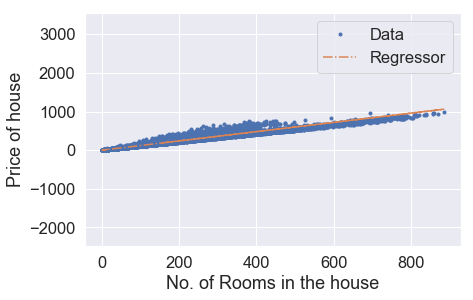

Iteration: 7781,Cost = 941.5530760406133,theta = [0.40441626 1.19746606]
Iteration: 7781,Cost_val = 945.8432476222495,theta = [0.40441626 1.19746606]


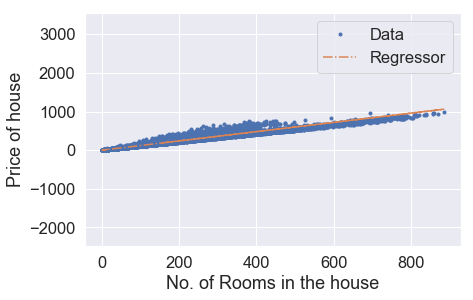

Iteration: 7791,Cost = 941.5505926870557,theta = [0.40491459 1.19746443]
Iteration: 7791,Cost_val = 945.8408070368766,theta = [0.40491459 1.19746443]


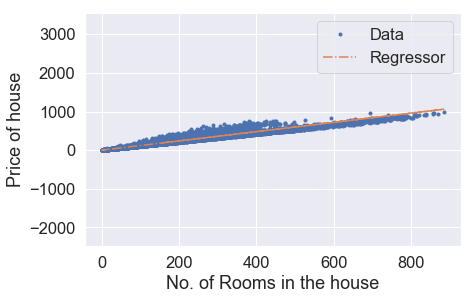

Iteration: 7801,Cost = 941.5481095787298,theta = [0.40541289 1.1974628 ]
Iteration: 7801,Cost_val = 945.8383666920663,theta = [0.40541289 1.1974628 ]


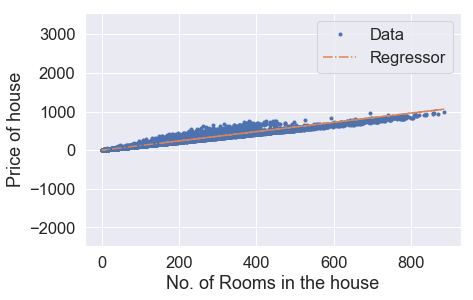

Iteration: 7811,Cost = 941.5456267155835,theta = [0.40591117 1.19746116]
Iteration: 7811,Cost_val = 945.8359265877873,theta = [0.40591117 1.19746116]


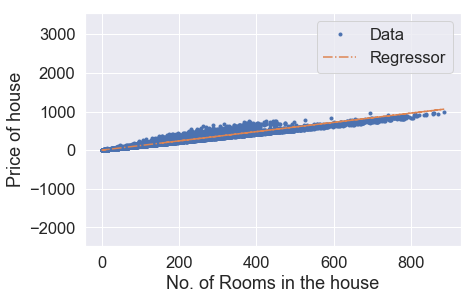

Iteration: 7821,Cost = 941.5431440976259,theta = [0.40640943 1.19745953]
Iteration: 7821,Cost_val = 945.8334867240253,theta = [0.40640943 1.19745953]


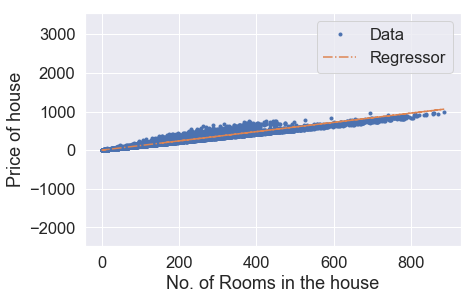

Iteration: 7831,Cost = 941.5406617248068,theta = [0.40690766 1.19745789]
Iteration: 7831,Cost_val = 945.8310471007516,theta = [0.40690766 1.19745789]


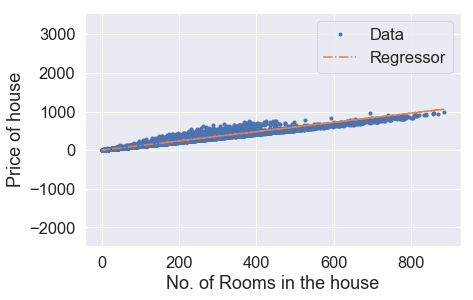

Iteration: 7841,Cost = 941.538179597119,theta = [0.40740587 1.19745626]
Iteration: 7841,Cost_val = 945.8286077179408,theta = [0.40740587 1.19745626]


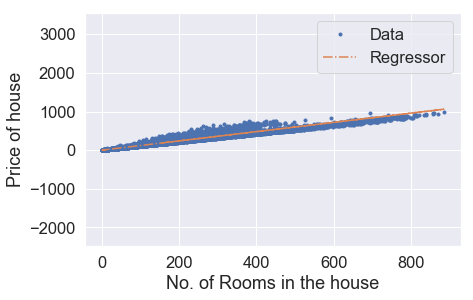

Iteration: 7851,Cost = 941.5356977145159,theta = [0.40790405 1.19745463]
Iteration: 7851,Cost_val = 945.8261685755765,theta = [0.40790405 1.19745463]


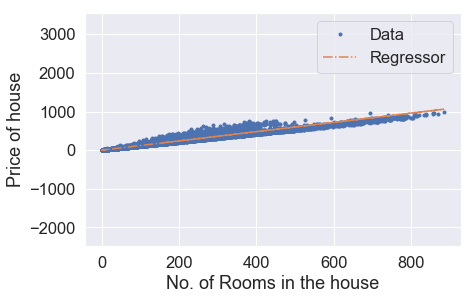

Iteration: 7861,Cost = 941.5332160770071,theta = [0.40840221 1.19745299]
Iteration: 7861,Cost_val = 945.8237296736232,theta = [0.40840221 1.19745299]


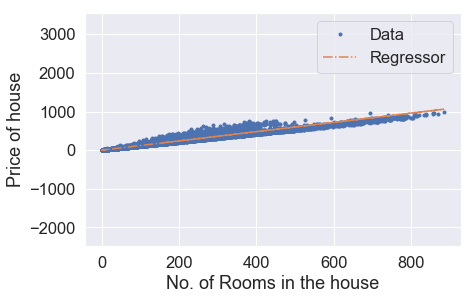

Iteration: 7871,Cost = 941.530734684535,theta = [0.40890034 1.19745136]
Iteration: 7871,Cost_val = 945.8212910120723,theta = [0.40890034 1.19745136]


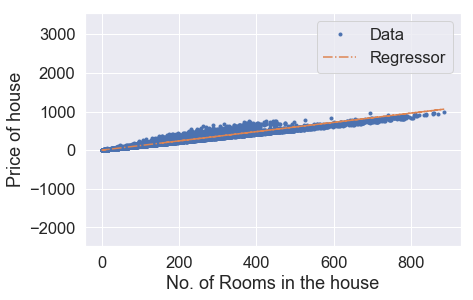

Iteration: 7881,Cost = 941.528253537086,theta = [0.40939845 1.19744973]
Iteration: 7881,Cost_val = 945.8188525908812,theta = [0.40939845 1.19744973]


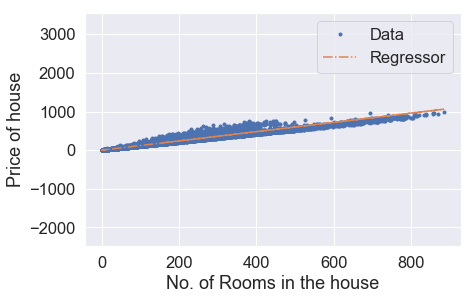

Iteration: 7891,Cost = 941.5257726346532,theta = [0.40989654 1.19744809]
Iteration: 7891,Cost_val = 945.8164144100463,theta = [0.40989654 1.19744809]


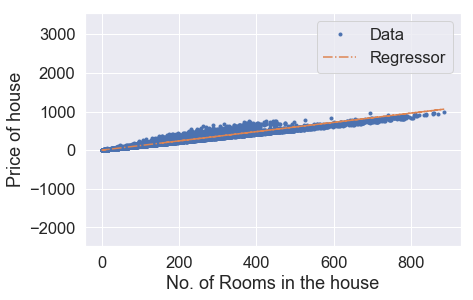

Iteration: 7901,Cost = 941.5232919771944,theta = [0.4103946  1.19744646]
Iteration: 7901,Cost_val = 945.8139764695302,theta = [0.4103946  1.19744646]


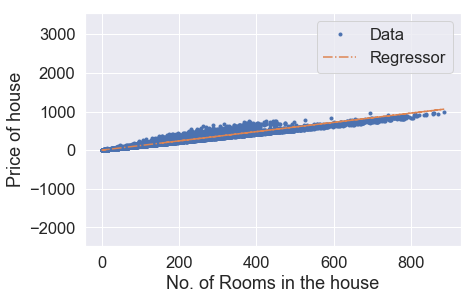

Iteration: 7911,Cost = 941.5208115646844,theta = [0.41089263 1.19744483]
Iteration: 7911,Cost_val = 945.8115387693143,theta = [0.41089263 1.19744483]


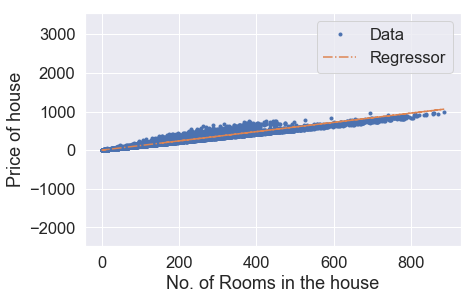

Iteration: 7921,Cost = 941.5183313971086,theta = [0.41139064 1.19744319]
Iteration: 7921,Cost_val = 945.8091013093731,theta = [0.41139064 1.19744319]


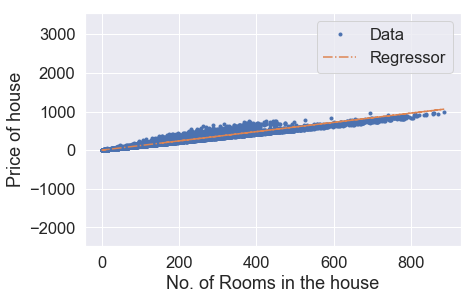

Iteration: 7931,Cost = 941.515851474434,theta = [0.41188863 1.19744156]
Iteration: 7931,Cost_val = 945.8066640896848,theta = [0.41188863 1.19744156]


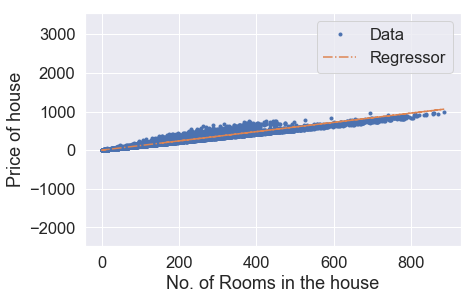

Iteration: 7941,Cost = 941.513371796643,theta = [0.41238659 1.19743993]
Iteration: 7941,Cost_val = 945.8042271102275,theta = [0.41238659 1.19743993]


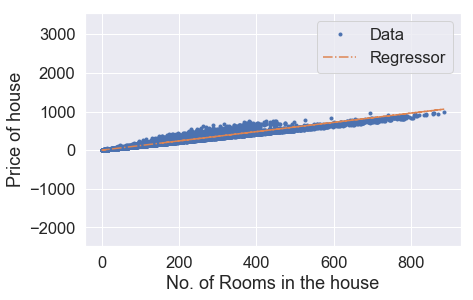

Iteration: 7951,Cost = 941.5108923637138,theta = [0.41288453 1.1974383 ]
Iteration: 7951,Cost_val = 945.8017903709707,theta = [0.41288453 1.1974383 ]


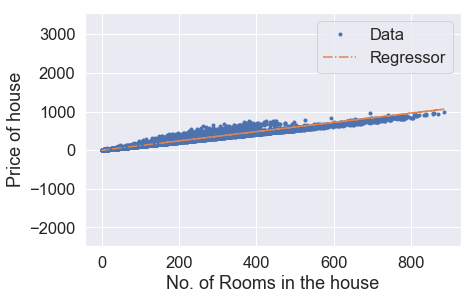

Iteration: 7961,Cost = 941.5084131756134,theta = [0.41338244 1.19743666]
Iteration: 7961,Cost_val = 945.7993538718929,theta = [0.41338244 1.19743666]


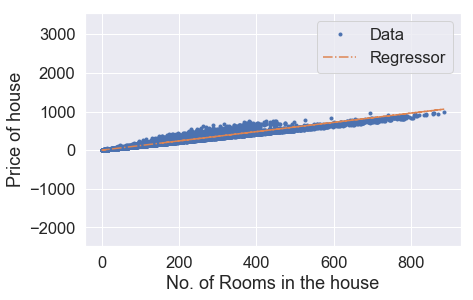

Iteration: 7971,Cost = 941.5059342323232,theta = [0.41388033 1.19743503]
Iteration: 7971,Cost_val = 945.796917612977,theta = [0.41388033 1.19743503]


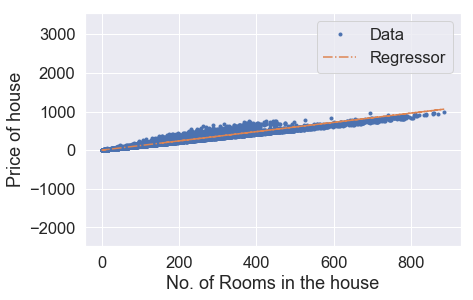

Iteration: 7981,Cost = 941.5034555338204,theta = [0.41437819 1.1974334 ]
Iteration: 7981,Cost_val = 945.7944815941903,theta = [0.41437819 1.1974334 ]


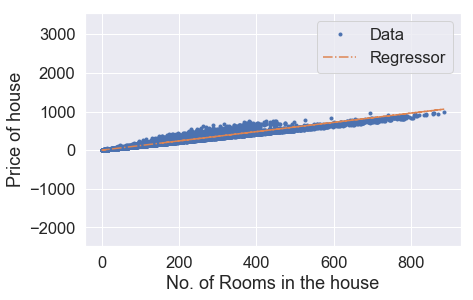

Iteration: 7991,Cost = 941.500977080079,theta = [0.41487603 1.19743177]
Iteration: 7991,Cost_val = 945.7920458155154,theta = [0.41487603 1.19743177]


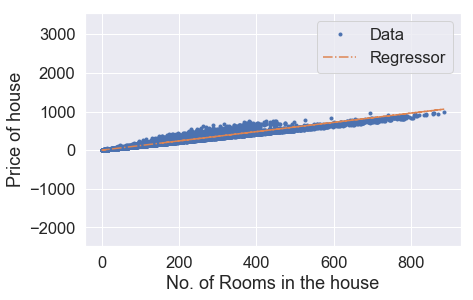

Iteration: 8001,Cost = 941.4984988710694,theta = [0.41537385 1.19743013]
Iteration: 8001,Cost_val = 945.789610276929,theta = [0.41537385 1.19743013]


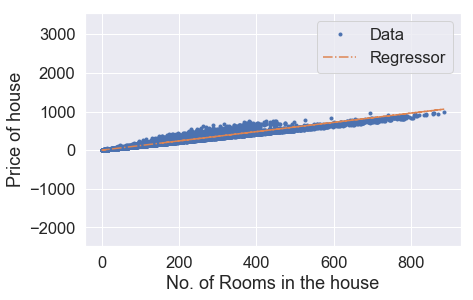

Iteration: 8011,Cost = 941.4960209067794,theta = [0.41587163 1.1974285 ]
Iteration: 8011,Cost_val = 945.7871749784008,theta = [0.41587163 1.1974285 ]


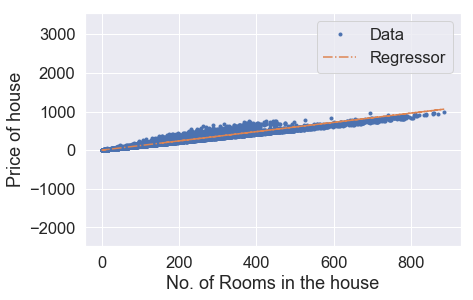

Iteration: 8021,Cost = 941.493543187163,theta = [0.4163694  1.19742687]
Iteration: 8021,Cost_val = 945.7847399199162,theta = [0.4163694  1.19742687]


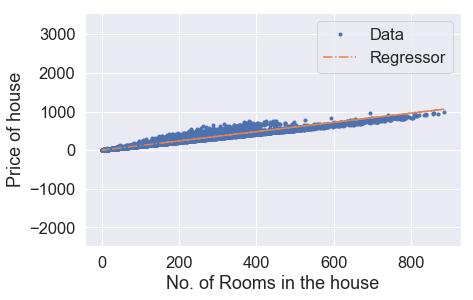

Iteration: 8031,Cost = 941.4910657122282,theta = [0.41686714 1.19742524]
Iteration: 8031,Cost_val = 945.7823051014441,theta = [0.41686714 1.19742524]


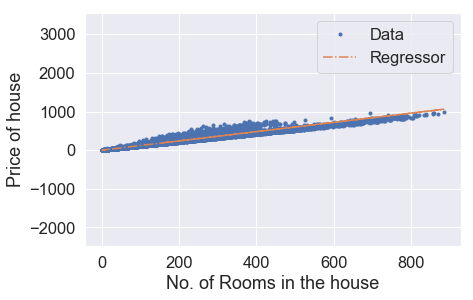

Iteration: 8041,Cost = 941.4885884819236,theta = [0.41736486 1.1974236 ]
Iteration: 8041,Cost_val = 945.7798705229592,theta = [0.41736486 1.1974236 ]


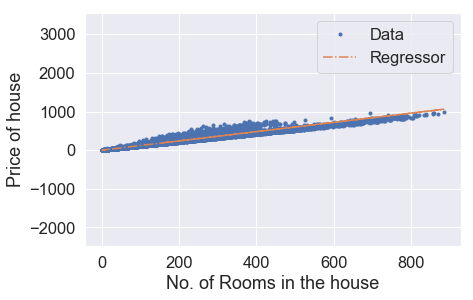

Iteration: 8051,Cost = 941.4861114962381,theta = [0.41786255 1.19742197]
Iteration: 8051,Cost_val = 945.7774361844497,theta = [0.41786255 1.19742197]


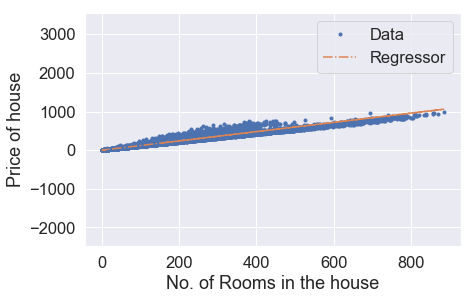

Iteration: 8061,Cost = 941.4836347551446,theta = [0.41836021 1.19742034]
Iteration: 8061,Cost_val = 945.7750020858768,theta = [0.41836021 1.19742034]


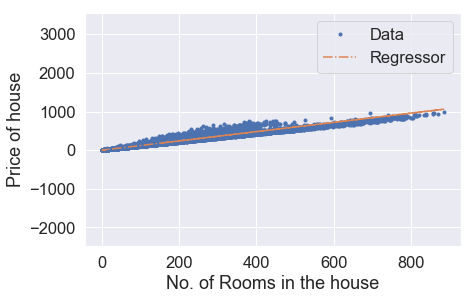

Iteration: 8071,Cost = 941.4811582586098,theta = [0.41885786 1.19741871]
Iteration: 8071,Cost_val = 945.7725682272278,theta = [0.41885786 1.19741871]


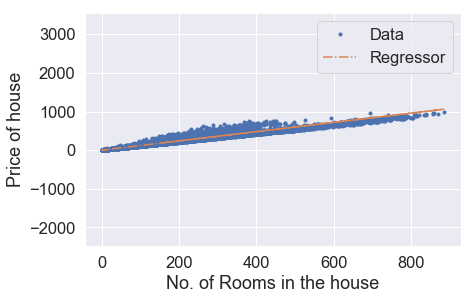

Iteration: 8081,Cost = 941.4786820066349,theta = [0.41935547 1.19741708]
Iteration: 8081,Cost_val = 945.770134608473,theta = [0.41935547 1.19741708]


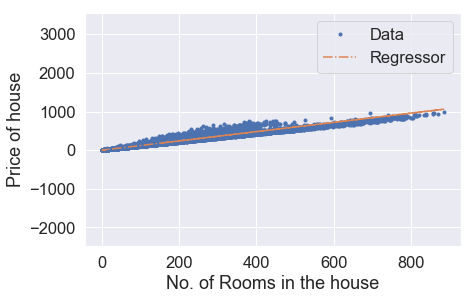

Iteration: 8091,Cost = 941.4762059991668,theta = [0.41985307 1.19741545]
Iteration: 8091,Cost_val = 945.7677012295983,theta = [0.41985307 1.19741545]


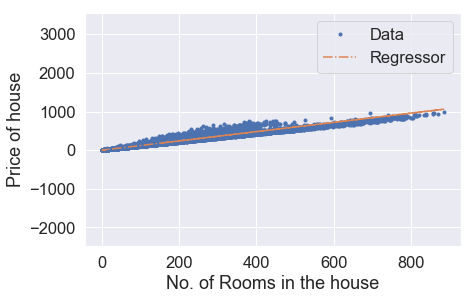

Iteration: 8101,Cost = 941.4737302361931,theta = [0.42035063 1.19741381]
Iteration: 8101,Cost_val = 945.7652680905659,theta = [0.42035063 1.19741381]


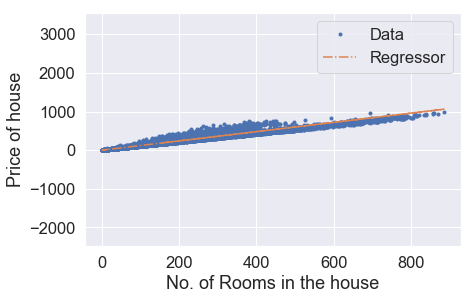

Iteration: 8111,Cost = 941.4712547176932,theta = [0.42084818 1.19741218]
Iteration: 8111,Cost_val = 945.7628351913596,theta = [0.42084818 1.19741218]


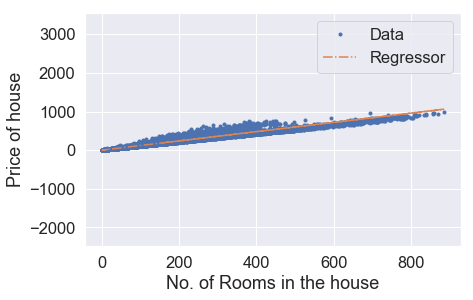

Iteration: 8121,Cost = 941.4687794436376,theta = [0.4213457  1.19741055]
Iteration: 8121,Cost_val = 945.7604025319575,theta = [0.4213457  1.19741055]


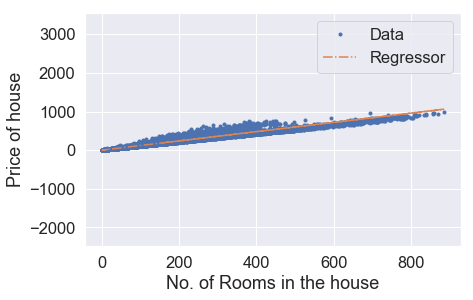

Iteration: 8131,Cost = 941.4663044140193,theta = [0.42184319 1.19740892]
Iteration: 8131,Cost_val = 945.757970112332,theta = [0.42184319 1.19740892]


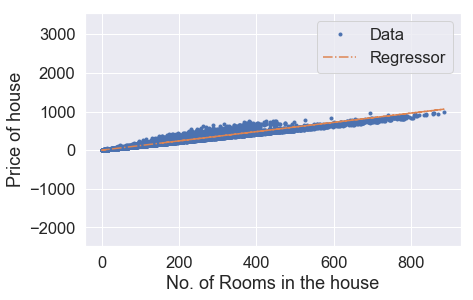

Iteration: 8141,Cost = 941.4638296287769,theta = [0.42234066 1.19740729]
Iteration: 8141,Cost_val = 945.7555379324609,theta = [0.42234066 1.19740729]


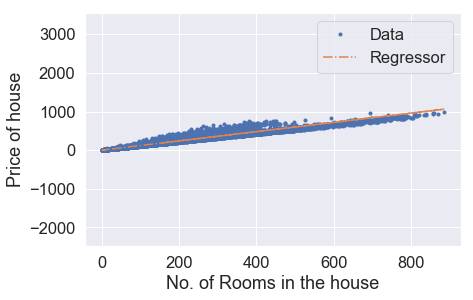

Iteration: 8151,Cost = 941.4613550879261,theta = [0.42283811 1.19740566]
Iteration: 8151,Cost_val = 945.7531059923216,theta = [0.42283811 1.19740566]


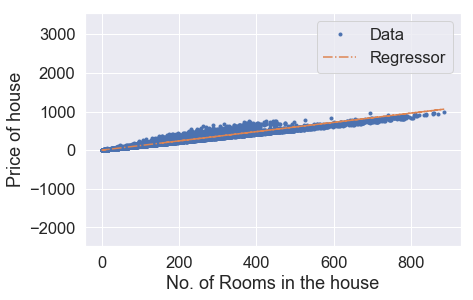

Iteration: 8161,Cost = 941.4588807914145,theta = [0.42333553 1.19740403]
Iteration: 8161,Cost_val = 945.7506742918904,theta = [0.42333553 1.19740403]


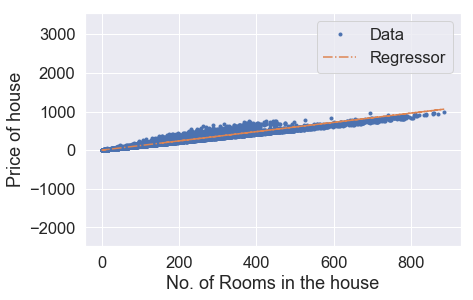

Iteration: 8171,Cost = 941.4564067392313,theta = [0.42383292 1.1974024 ]
Iteration: 8171,Cost_val = 945.7482428311399,theta = [0.42383292 1.1974024 ]


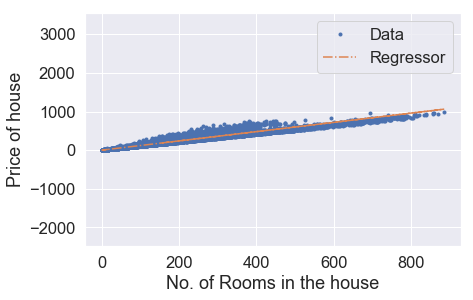

Iteration: 8181,Cost = 941.4539329313565,theta = [0.4243303  1.19740076]
Iteration: 8181,Cost_val = 945.7458116100528,theta = [0.4243303  1.19740076]


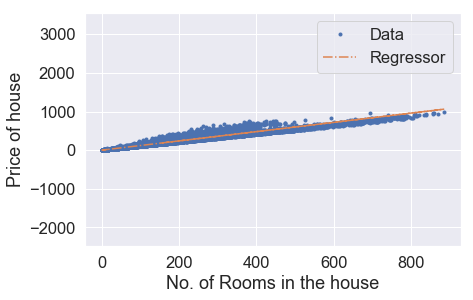

Iteration: 8191,Cost = 941.4514593677433,theta = [0.42482764 1.19739913]
Iteration: 8191,Cost_val = 945.7433806286019,theta = [0.42482764 1.19739913]


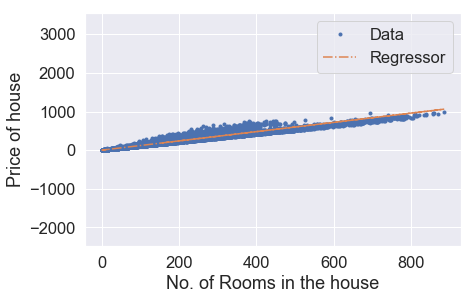

Iteration: 8201,Cost = 941.4489860483977,theta = [0.42532497 1.1973975 ]
Iteration: 8201,Cost_val = 945.740949886766,theta = [0.42532497 1.1973975 ]


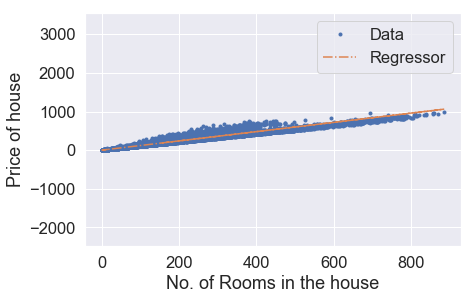

Iteration: 8211,Cost = 941.446512973285,theta = [0.42582226 1.19739587]
Iteration: 8211,Cost_val = 945.7385193845123,theta = [0.42582226 1.19739587]


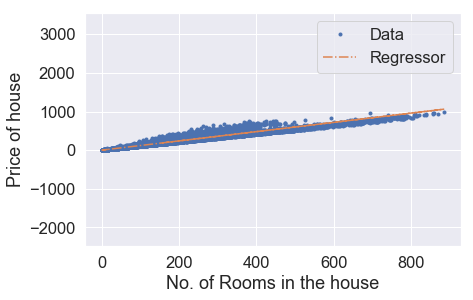

Iteration: 8221,Cost = 941.4440401423673,theta = [0.42631954 1.19739424]
Iteration: 8221,Cost_val = 945.7360891218293,theta = [0.42631954 1.19739424]


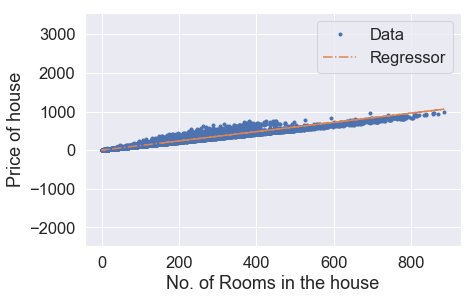

Iteration: 8231,Cost = 941.4415675556371,theta = [0.42681679 1.19739261]
Iteration: 8231,Cost_val = 945.7336590986879,theta = [0.42681679 1.19739261]


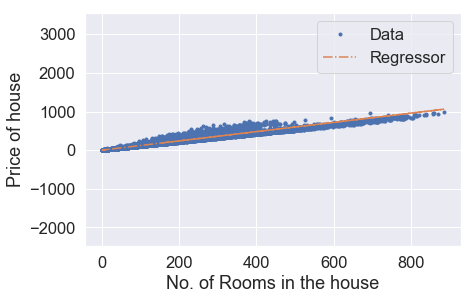

Iteration: 8241,Cost = 941.4390952130639,theta = [0.42731401 1.19739098]
Iteration: 8241,Cost_val = 945.7312293150646,theta = [0.42731401 1.19739098]


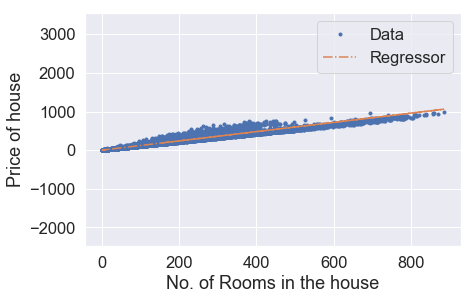

Iteration: 8251,Cost = 941.4366231146225,theta = [0.42781121 1.19738935]
Iteration: 8251,Cost_val = 945.7287997709319,theta = [0.42781121 1.19738935]


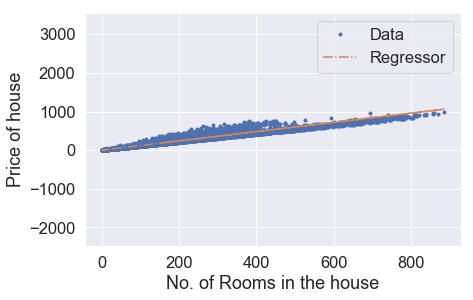

Iteration: 8261,Cost = 941.4341512602889,theta = [0.42830839 1.19738772]
Iteration: 8261,Cost_val = 945.7263704662735,theta = [0.42830839 1.19738772]


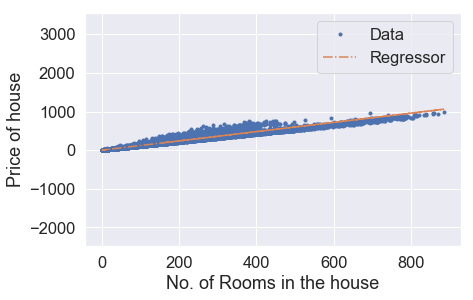

Iteration: 8271,Cost = 941.431679650036,theta = [0.42880554 1.19738609]
Iteration: 8271,Cost_val = 945.7239414010675,theta = [0.42880554 1.19738609]


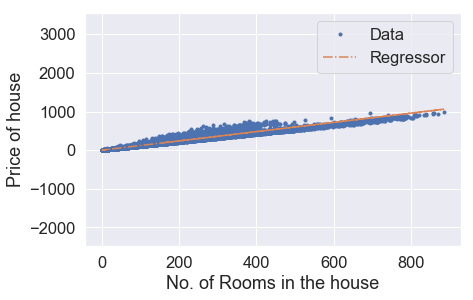

Iteration: 8281,Cost = 941.4292082838482,theta = [0.42930266 1.19738446]
Iteration: 8281,Cost_val = 945.7215125752757,theta = [0.42930266 1.19738446]


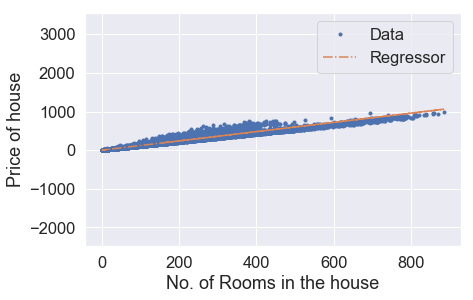

Iteration: 8291,Cost = 941.4267371617033,theta = [0.42979977 1.19738283]
Iteration: 8291,Cost_val = 945.7190839888862,theta = [0.42979977 1.19738283]


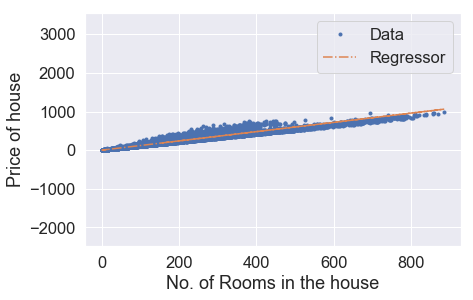

Iteration: 8301,Cost = 941.424266283576,theta = [0.43029684 1.1973812 ]
Iteration: 8301,Cost_val = 945.7166556418789,theta = [0.43029684 1.1973812 ]


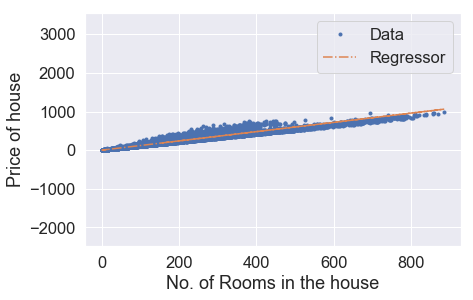

Iteration: 8311,Cost = 941.4217956494203,theta = [0.4307939  1.19737957]
Iteration: 8311,Cost_val = 945.7142275342172,theta = [0.4307939  1.19737957]


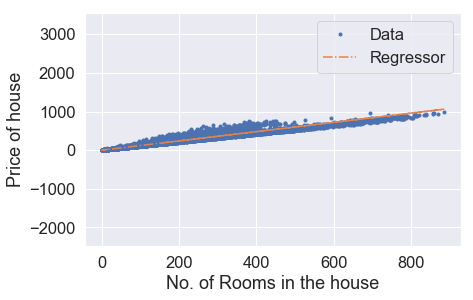

Iteration: 8321,Cost = 941.4193252592358,theta = [0.43129092 1.19737794]
Iteration: 8321,Cost_val = 945.7117996658899,theta = [0.43129092 1.19737794]


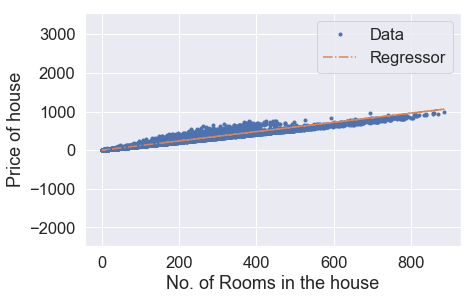

Iteration: 8331,Cost = 941.4168551129848,theta = [0.43178793 1.19737631]
Iteration: 8331,Cost_val = 945.7093720368687,theta = [0.43178793 1.19737631]


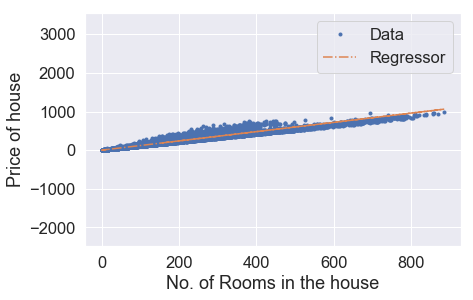

Iteration: 8341,Cost = 941.4143852106587,theta = [0.43228491 1.19737468]
Iteration: 8341,Cost_val = 945.7069446471257,theta = [0.43228491 1.19737468]


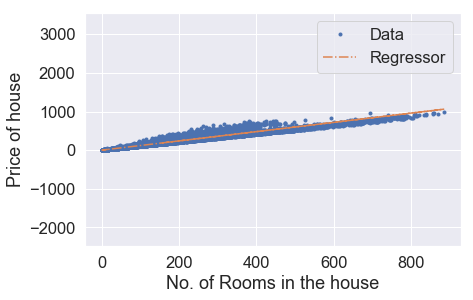

Iteration: 8351,Cost = 941.4119155522216,theta = [0.43278186 1.19737305]
Iteration: 8351,Cost_val = 945.7045174966438,theta = [0.43278186 1.19737305]


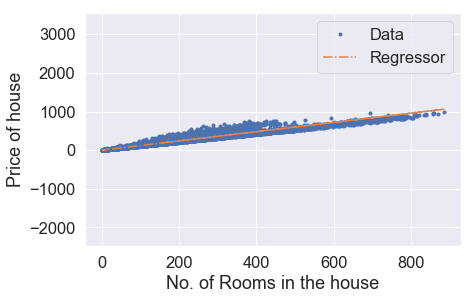

Iteration: 8361,Cost = 941.4094461376613,theta = [0.43327879 1.19737142]
Iteration: 8361,Cost_val = 945.7020905853942,theta = [0.43327879 1.19737142]


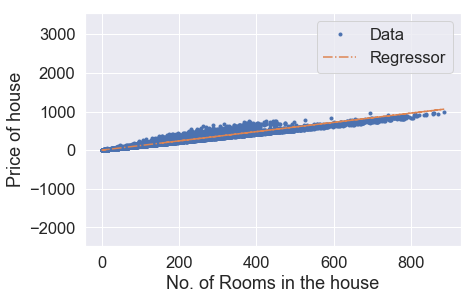

Iteration: 8371,Cost = 941.4069769669214,theta = [0.4337757  1.19736979]
Iteration: 8371,Cost_val = 945.6996639133605,theta = [0.4337757  1.19736979]


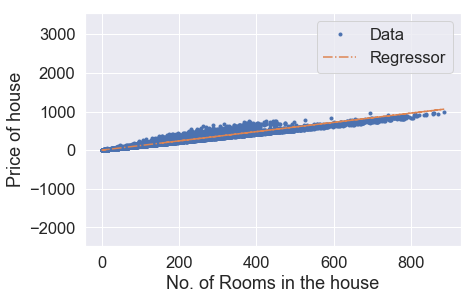

Iteration: 8381,Cost = 941.4045080400282,theta = [0.43427258 1.19736816]
Iteration: 8381,Cost_val = 945.6972374805076,theta = [0.43427258 1.19736816]


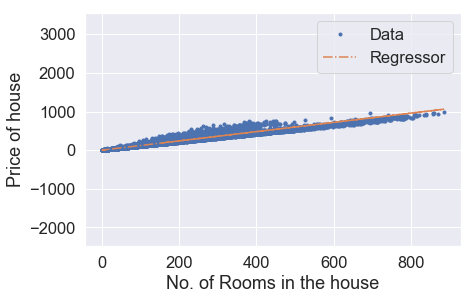

Iteration: 8391,Cost = 941.402039356929,theta = [0.43476943 1.19736653]
Iteration: 8391,Cost_val = 945.6948112868254,theta = [0.43476943 1.19736653]


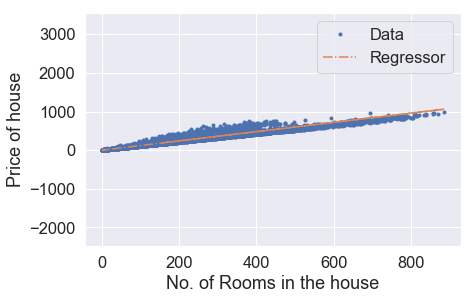

Iteration: 8401,Cost = 941.3995709175856,theta = [0.43526627 1.1973649 ]
Iteration: 8401,Cost_val = 945.6923853322796,theta = [0.43526627 1.1973649 ]


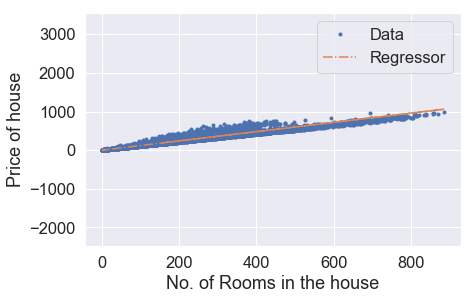

Iteration: 8411,Cost = 941.3971027219891,theta = [0.43576307 1.19736328]
Iteration: 8411,Cost_val = 945.6899596168493,theta = [0.43576307 1.19736328]


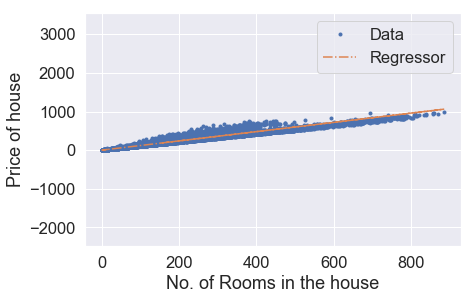

Iteration: 8421,Cost = 941.3946347701283,theta = [0.43625986 1.19736165]
Iteration: 8421,Cost_val = 945.6875341405165,theta = [0.43625986 1.19736165]


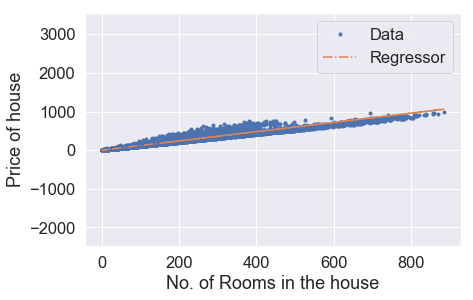

Iteration: 8431,Cost = 941.3921670619588,theta = [0.43675661 1.19736002]
Iteration: 8431,Cost_val = 945.6851089032525,theta = [0.43675661 1.19736002]


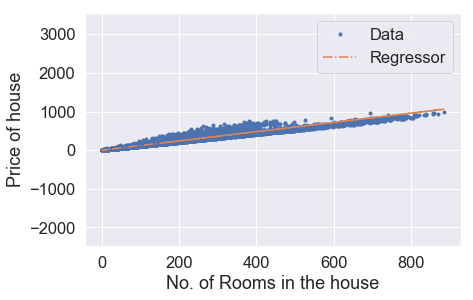

Iteration: 8441,Cost = 941.3896995974684,theta = [0.43725335 1.19735839]
Iteration: 8441,Cost_val = 945.6826839050367,theta = [0.43725335 1.19735839]


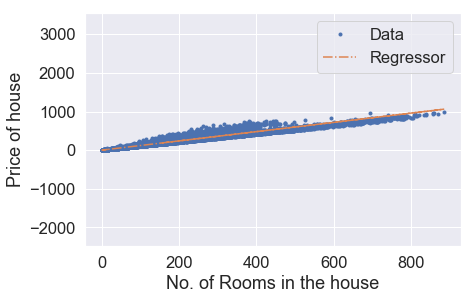

Iteration: 8451,Cost = 941.3872323766258,theta = [0.43775006 1.19735676]
Iteration: 8451,Cost_val = 945.6802591458387,theta = [0.43775006 1.19735676]


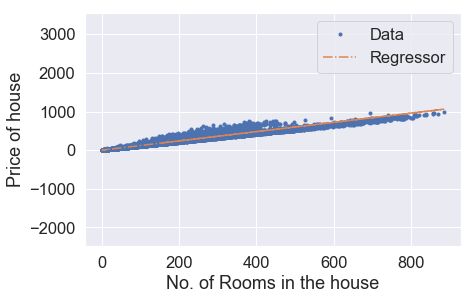

Iteration: 8461,Cost = 941.3847653994255,theta = [0.43824674 1.19735513]
Iteration: 8461,Cost_val = 945.6778346256395,theta = [0.43824674 1.19735513]


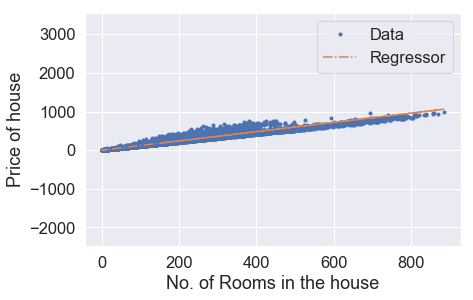

Iteration: 8471,Cost = 941.3822986658129,theta = [0.4387434 1.1973535]
Iteration: 8471,Cost_val = 945.6754103444167,theta = [0.4387434 1.1973535]


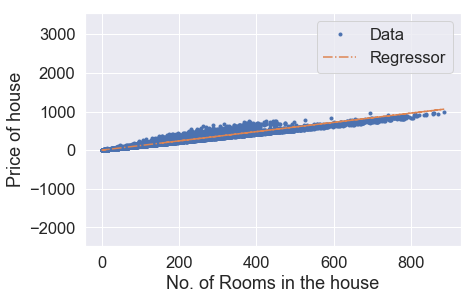

Iteration: 8481,Cost = 941.379832175783,theta = [0.43924004 1.19735187]
Iteration: 8481,Cost_val = 945.6729863021466,theta = [0.43924004 1.19735187]


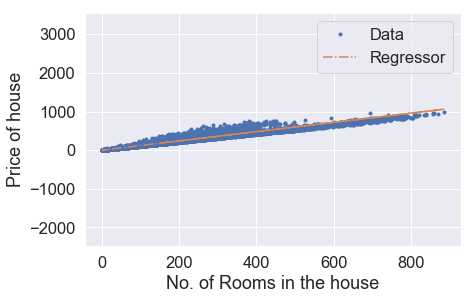

Iteration: 8491,Cost = 941.3773659293099,theta = [0.43973665 1.19735025]
Iteration: 8491,Cost_val = 945.6705624988058,theta = [0.43973665 1.19735025]


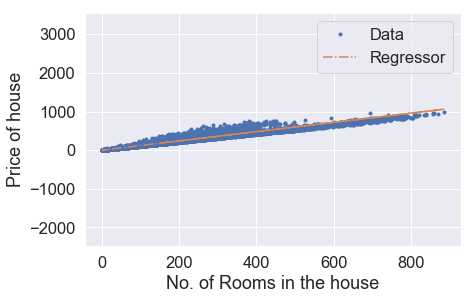

Iteration: 8501,Cost = 941.3748999263668,theta = [0.44023324 1.19734862]
Iteration: 8501,Cost_val = 945.6681389343655,theta = [0.44023324 1.19734862]


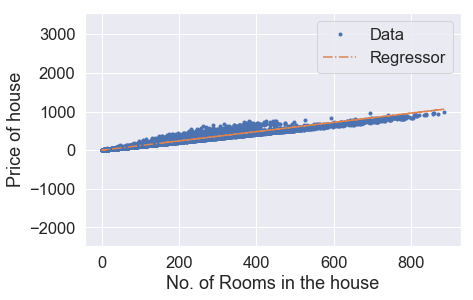

Iteration: 8511,Cost = 941.3724341669457,theta = [0.4407298  1.19734699]
Iteration: 8511,Cost_val = 945.6657156088095,theta = [0.4407298  1.19734699]


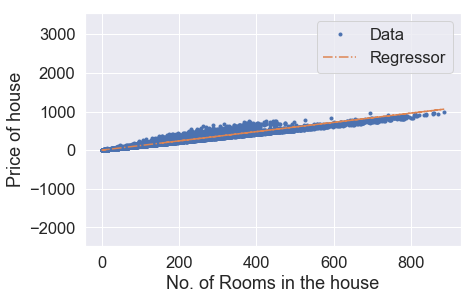

Iteration: 8521,Cost = 941.3699686509752,theta = [0.44122634 1.19734536]
Iteration: 8521,Cost_val = 945.6632925221097,theta = [0.44122634 1.19734536]


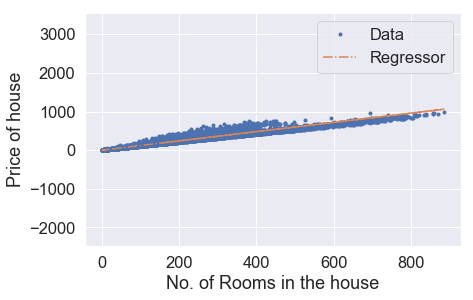

Iteration: 8531,Cost = 941.3675033784885,theta = [0.44172285 1.19734373]
Iteration: 8531,Cost_val = 945.6608696742484,theta = [0.44172285 1.19734373]


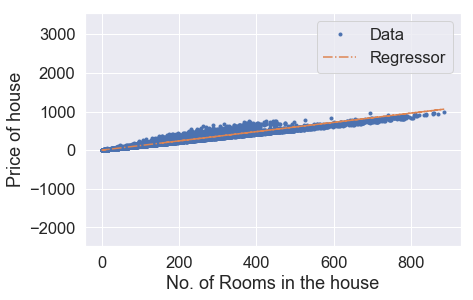

Iteration: 8541,Cost = 941.3650383494295,theta = [0.44221934 1.19734211]
Iteration: 8541,Cost_val = 945.658447065193,theta = [0.44221934 1.19734211]


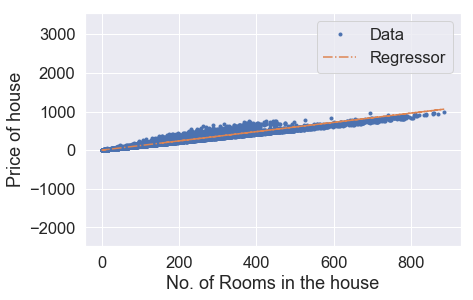

Iteration: 8551,Cost = 941.3625735637811,theta = [0.4427158  1.19734048]
Iteration: 8551,Cost_val = 945.6560246949233,theta = [0.4427158  1.19734048]


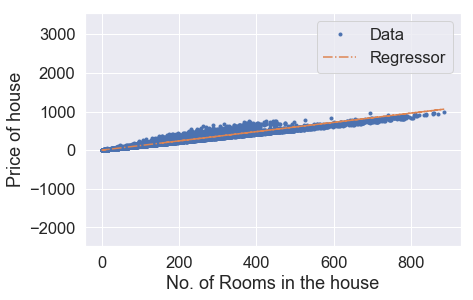

Iteration: 8561,Cost = 941.360109021523,theta = [0.44321224 1.19733885]
Iteration: 8561,Cost_val = 945.6536025634169,theta = [0.44321224 1.19733885]


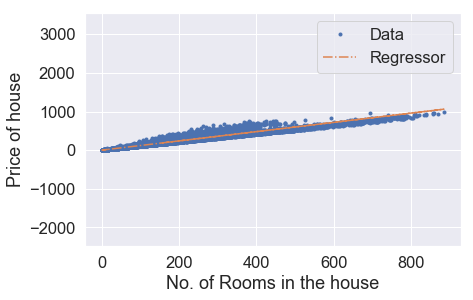

Iteration: 8571,Cost = 941.3576447226172,theta = [0.44370866 1.19733722]
Iteration: 8571,Cost_val = 945.6511806706526,theta = [0.44370866 1.19733722]


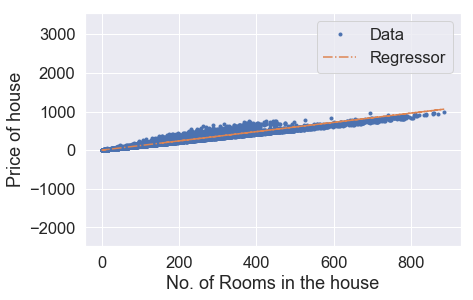

Iteration: 8581,Cost = 941.3551806670613,theta = [0.44420505 1.19733559]
Iteration: 8581,Cost_val = 945.648759016605,theta = [0.44420505 1.19733559]


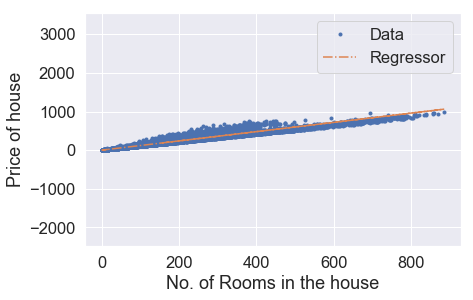

Iteration: 8591,Cost = 941.352716854813,theta = [0.44470141 1.19733397]
Iteration: 8591,Cost_val = 945.6463376012457,theta = [0.44470141 1.19733397]


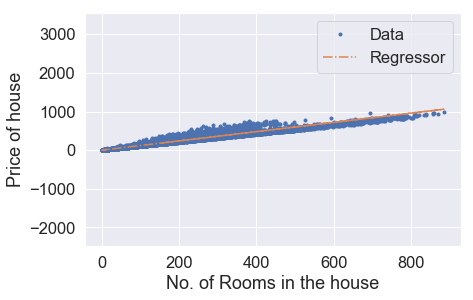

Iteration: 8601,Cost = 941.3502532858629,theta = [0.44519775 1.19733234]
Iteration: 8601,Cost_val = 945.6439164245583,theta = [0.44519775 1.19733234]


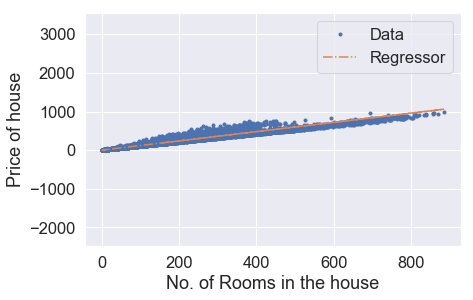

Iteration: 8611,Cost = 941.3477899601733,theta = [0.44569407 1.19733071]
Iteration: 8611,Cost_val = 945.641495486515,theta = [0.44569407 1.19733071]


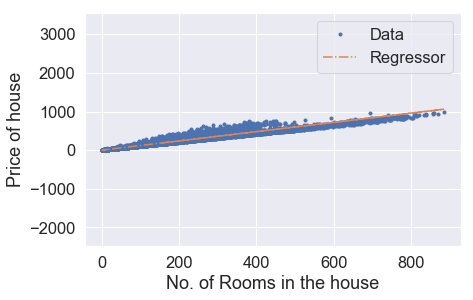

Iteration: 8621,Cost = 941.3453268777282,theta = [0.44619036 1.19732908]
Iteration: 8621,Cost_val = 945.6390747870956,theta = [0.44619036 1.19732908]


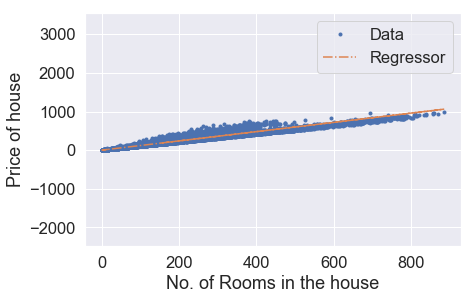

Iteration: 8631,Cost = 941.3428640385083,theta = [0.44668663 1.19732746]
Iteration: 8631,Cost_val = 945.6366543262731,theta = [0.44668663 1.19732746]


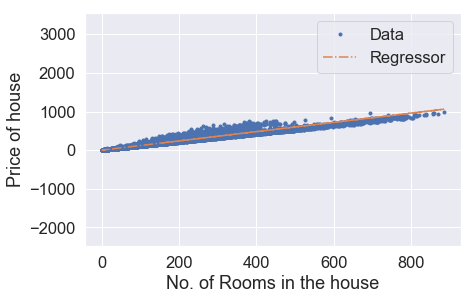

Iteration: 8641,Cost = 941.340401442482,theta = [0.44718287 1.19732583]
Iteration: 8641,Cost_val = 945.6342341040283,theta = [0.44718287 1.19732583]


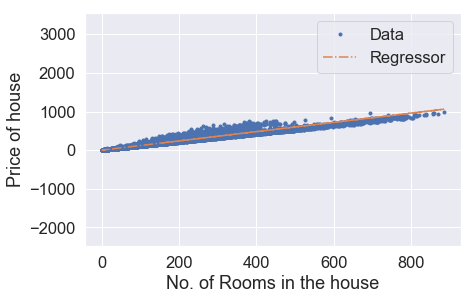

Iteration: 8651,Cost = 941.337939089615,theta = [0.44767909 1.1973242 ]
Iteration: 8651,Cost_val = 945.6318141203317,theta = [0.44767909 1.1973242 ]


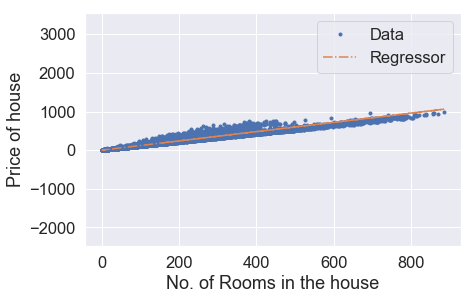

Iteration: 8661,Cost = 941.3354769799067,theta = [0.44817529 1.19732258]
Iteration: 8661,Cost_val = 945.6293943751657,theta = [0.44817529 1.19732258]


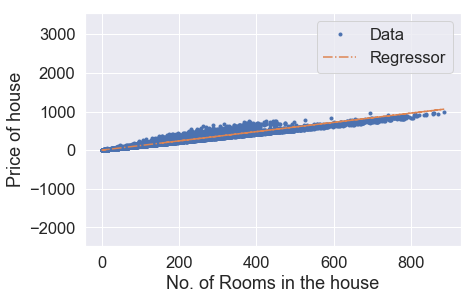

Iteration: 8671,Cost = 941.3330151133129,theta = [0.44867146 1.19732095]
Iteration: 8671,Cost_val = 945.6269748685017,theta = [0.44867146 1.19732095]


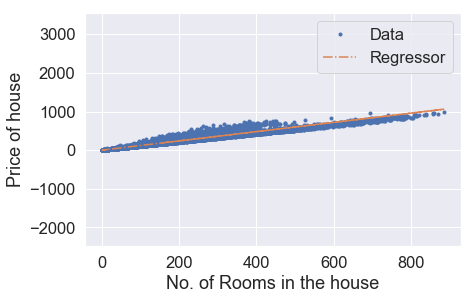

Iteration: 8681,Cost = 941.3305534898147,theta = [0.4491676  1.19731932]
Iteration: 8681,Cost_val = 945.624555600319,theta = [0.4491676  1.19731932]


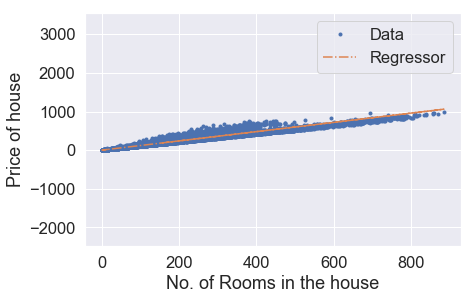

Iteration: 8691,Cost = 941.328092109402,theta = [0.44966372 1.19731769]
Iteration: 8691,Cost_val = 945.6221365705911,theta = [0.44966372 1.19731769]


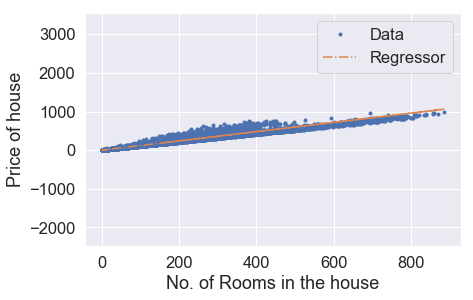

Iteration: 8701,Cost = 941.3256309720326,theta = [0.45015982 1.19731607]
Iteration: 8701,Cost_val = 945.6197177792994,theta = [0.45015982 1.19731607]


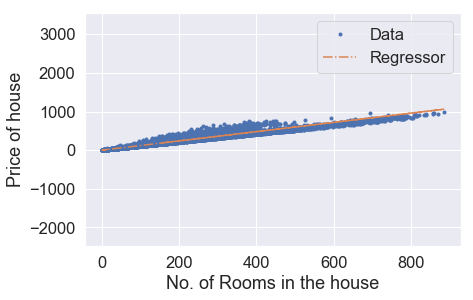

Iteration: 8711,Cost = 941.3231700776887,theta = [0.45065589 1.19731444]
Iteration: 8711,Cost_val = 945.6172992264194,theta = [0.45065589 1.19731444]


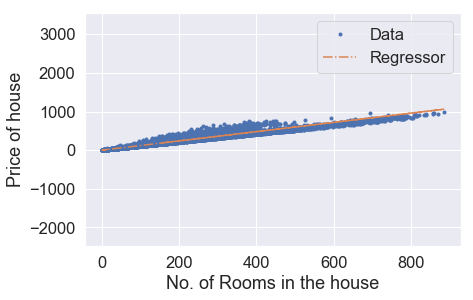

Iteration: 8721,Cost = 941.3207094263574,theta = [0.45115194 1.19731282]
Iteration: 8721,Cost_val = 945.6148809119248,theta = [0.45115194 1.19731282]


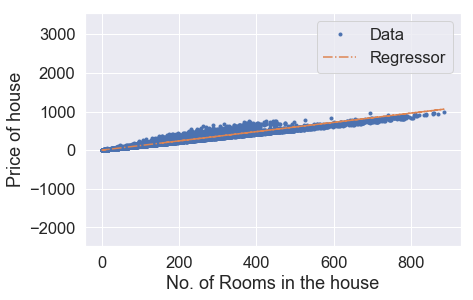

Iteration: 8731,Cost = 941.3182490180034,theta = [0.45164796 1.19731119]
Iteration: 8731,Cost_val = 945.6124628357884,theta = [0.45164796 1.19731119]


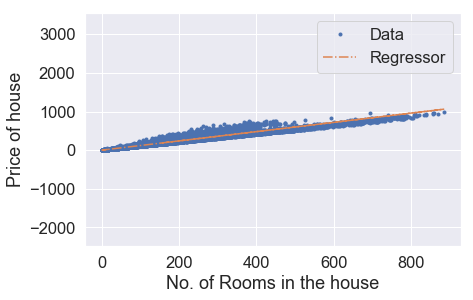

Iteration: 8741,Cost = 941.3157888525883,theta = [0.45214396 1.19730956]
Iteration: 8741,Cost_val = 945.6100449979978,theta = [0.45214396 1.19730956]


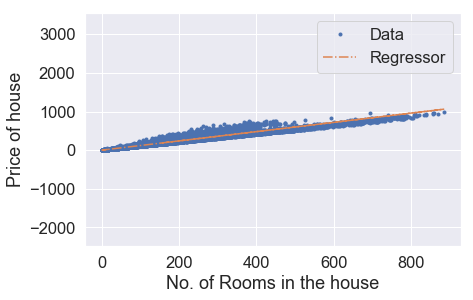

Iteration: 8751,Cost = 941.3133289301188,theta = [0.45263994 1.19730794]
Iteration: 8751,Cost_val = 945.60762739852,theta = [0.45263994 1.19730794]


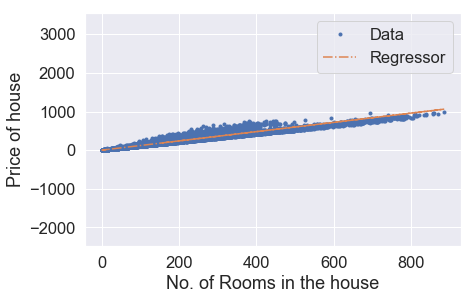

Iteration: 8761,Cost = 941.3108692505566,theta = [0.45313588 1.19730631]
Iteration: 8761,Cost_val = 945.6052100373377,theta = [0.45313588 1.19730631]


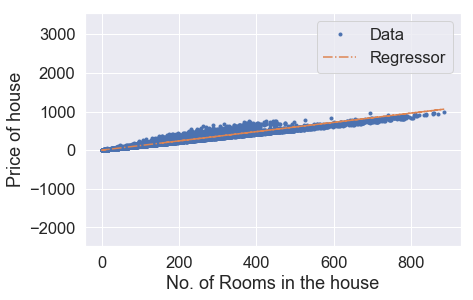

Iteration: 8771,Cost = 941.3084098138605,theta = [0.45363181 1.19730468]
Iteration: 8771,Cost_val = 945.6027929144242,theta = [0.45363181 1.19730468]


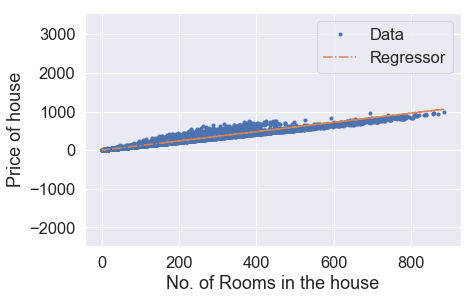

Iteration: 8781,Cost = 941.305950620038,theta = [0.45412771 1.19730306]
Iteration: 8781,Cost_val = 945.6003760297527,theta = [0.45412771 1.19730306]


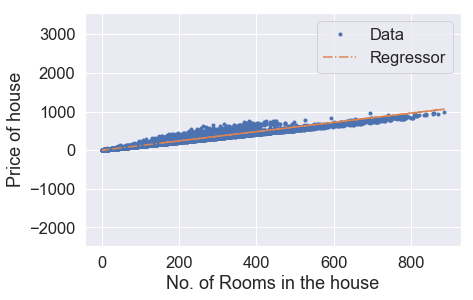

Iteration: 8791,Cost = 941.3034916690495,theta = [0.45462359 1.19730143]
Iteration: 8791,Cost_val = 945.5979593833049,theta = [0.45462359 1.19730143]


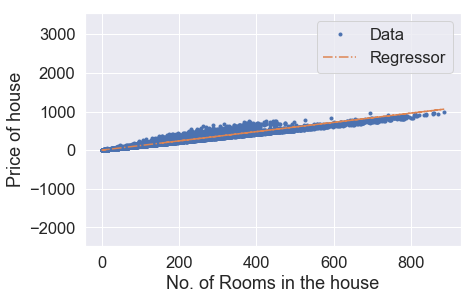

Iteration: 8801,Cost = 941.3010329608704,theta = [0.45511944 1.19729981]
Iteration: 8801,Cost_val = 945.5955429750529,theta = [0.45511944 1.19729981]


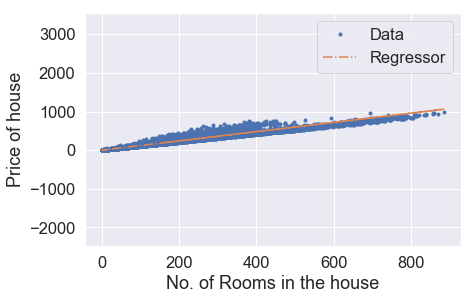

Iteration: 8811,Cost = 941.2985744954724,theta = [0.45561527 1.19729818]
Iteration: 8811,Cost_val = 945.5931268049812,theta = [0.45561527 1.19729818]


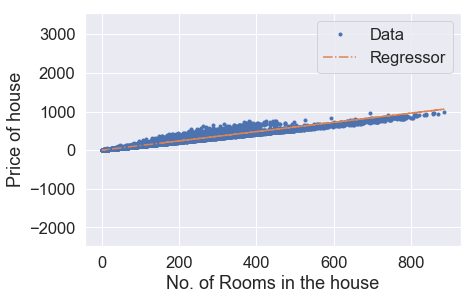

Iteration: 8821,Cost = 941.2961162728487,theta = [0.45611107 1.19729655]
Iteration: 8821,Cost_val = 945.5907108730597,theta = [0.45611107 1.19729655]


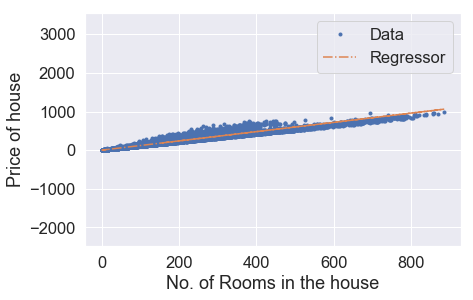

Iteration: 8831,Cost = 941.2936582929511,theta = [0.45660685 1.19729493]
Iteration: 8831,Cost_val = 945.5882951792662,theta = [0.45660685 1.19729493]


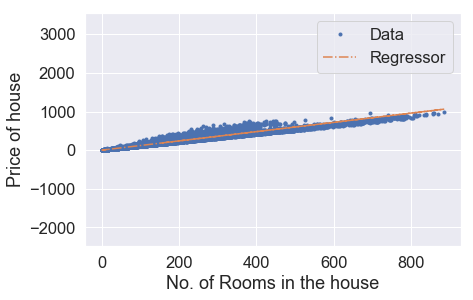

Iteration: 8841,Cost = 941.2912005557729,theta = [0.4571026 1.1972933]
Iteration: 8841,Cost_val = 945.5858797235747,theta = [0.4571026 1.1972933]


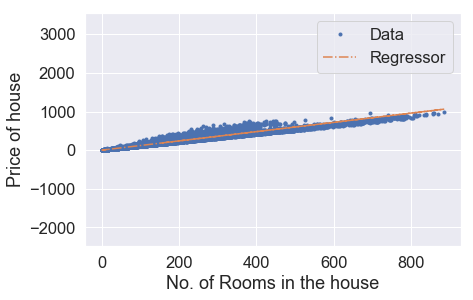

Iteration: 8851,Cost = 941.2887430612845,theta = [0.45759833 1.19729168]
Iteration: 8851,Cost_val = 945.5834645059679,theta = [0.45759833 1.19729168]


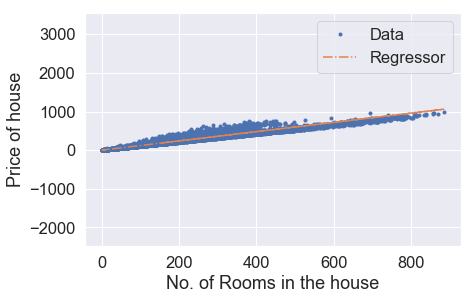

Iteration: 8861,Cost = 941.2862858094667,theta = [0.45809403 1.19729005]
Iteration: 8861,Cost_val = 945.5810495264151,theta = [0.45809403 1.19729005]


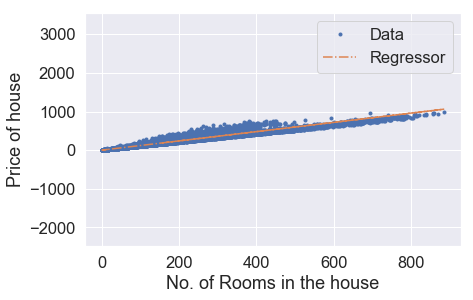

Iteration: 8871,Cost = 941.2838288002907,theta = [0.45858971 1.19728843]
Iteration: 8871,Cost_val = 945.5786347849,theta = [0.45858971 1.19728843]


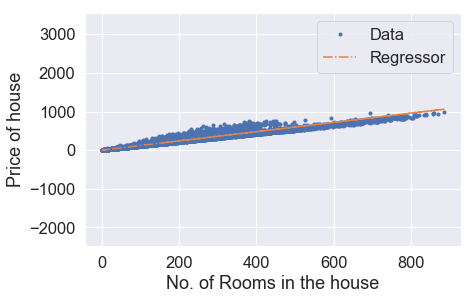

Iteration: 8881,Cost = 941.2813720337332,theta = [0.45908537 1.1972868 ]
Iteration: 8881,Cost_val = 945.5762202813949,theta = [0.45908537 1.1972868 ]


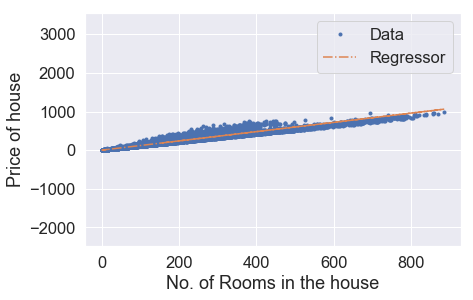

Iteration: 8891,Cost = 941.2789155097804,theta = [0.459581   1.19728518]
Iteration: 8891,Cost_val = 945.5738060158717,theta = [0.459581   1.19728518]


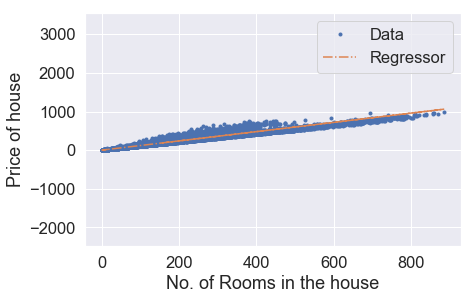

Iteration: 8901,Cost = 941.2764592283772,theta = [0.46007661 1.19728355]
Iteration: 8901,Cost_val = 945.5713919883175,theta = [0.46007661 1.19728355]


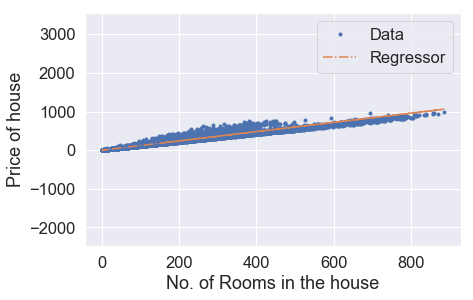

Iteration: 8911,Cost = 941.274003189536,theta = [0.46057219 1.19728193]
Iteration: 8911,Cost_val = 945.5689781987031,theta = [0.46057219 1.19728193]


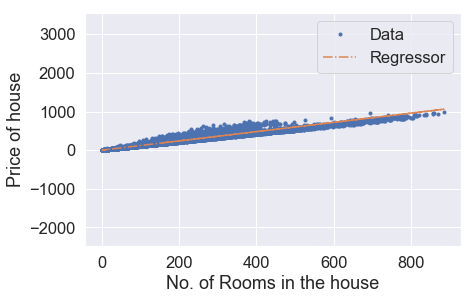

Iteration: 8921,Cost = 941.2715473932132,theta = [0.46106775 1.1972803 ]
Iteration: 8921,Cost_val = 945.5665646470048,theta = [0.46106775 1.1972803 ]


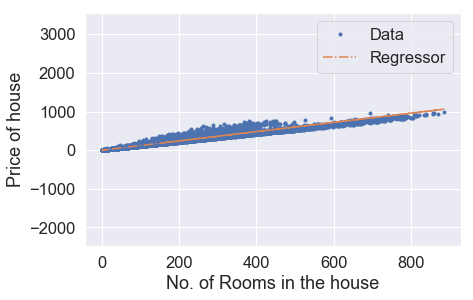

Iteration: 8931,Cost = 941.2690918393902,theta = [0.46156328 1.19727868]
Iteration: 8931,Cost_val = 945.5641513331989,theta = [0.46156328 1.19727868]


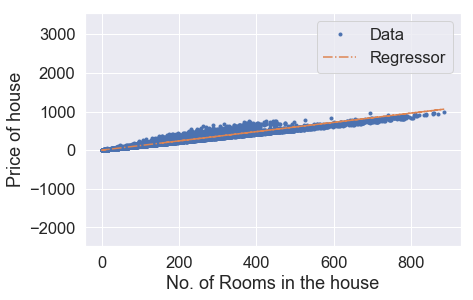

Iteration: 8941,Cost = 941.2666365280481,theta = [0.46205879 1.19727705]
Iteration: 8941,Cost_val = 945.5617382572639,theta = [0.46205879 1.19727705]


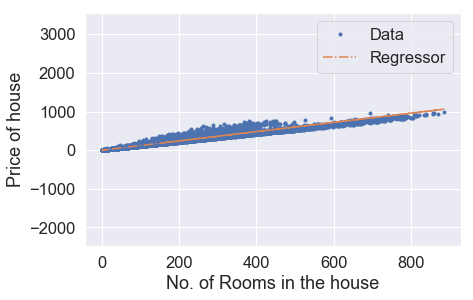

Iteration: 8951,Cost = 941.2641814591482,theta = [0.46255427 1.19727543]
Iteration: 8951,Cost_val = 945.559325419173,theta = [0.46255427 1.19727543]


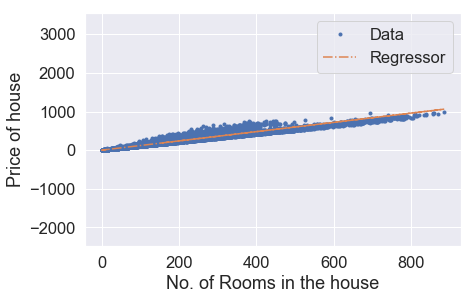

Iteration: 8961,Cost = 941.2617266326852,theta = [0.46304973 1.1972738 ]
Iteration: 8961,Cost_val = 945.5569128189056,theta = [0.46304973 1.1972738 ]


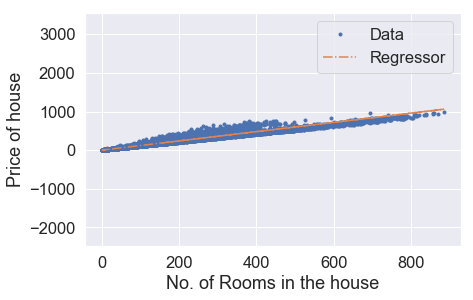

Iteration: 8971,Cost = 941.2592720486228,theta = [0.46354517 1.19727218]
Iteration: 8971,Cost_val = 945.5545004564369,theta = [0.46354517 1.19727218]


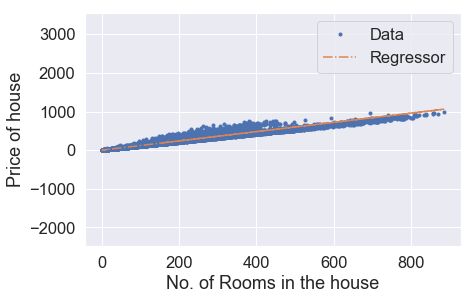

Iteration: 8981,Cost = 941.2568177069381,theta = [0.46404058 1.19727055]
Iteration: 8981,Cost_val = 945.5520883317467,theta = [0.46404058 1.19727055]


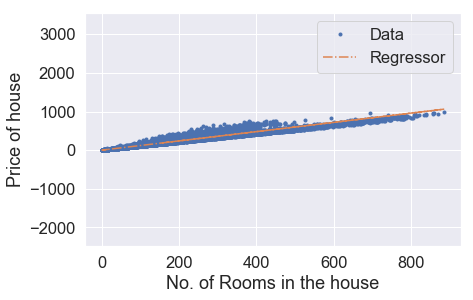

Iteration: 8991,Cost = 941.2543636075997,theta = [0.46453597 1.19726893]
Iteration: 8991,Cost_val = 945.5496764448088,theta = [0.46453597 1.19726893]


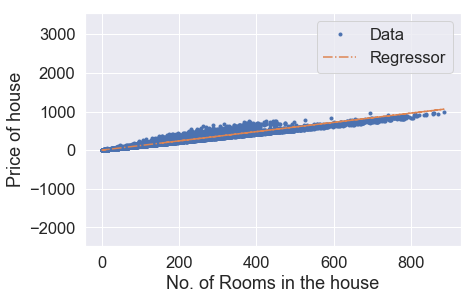

Iteration: 9001,Cost = 941.2519097506134,theta = [0.46503133 1.1972673 ]
Iteration: 9001,Cost_val = 945.5472647955996,theta = [0.46503133 1.1972673 ]


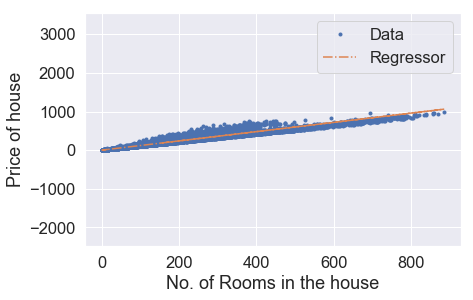

Iteration: 9011,Cost = 941.2494561359175,theta = [0.46552667 1.19726568]
Iteration: 9011,Cost_val = 945.5448533840934,theta = [0.46552667 1.19726568]


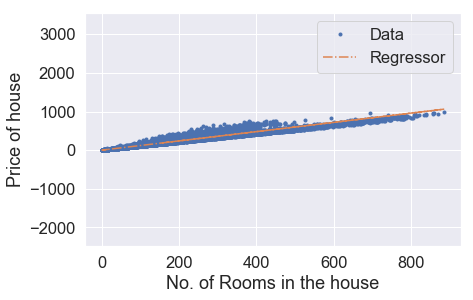

Iteration: 9021,Cost = 941.2470027635127,theta = [0.46602198 1.19726406]
Iteration: 9021,Cost_val = 945.5424422102691,theta = [0.46602198 1.19726406]


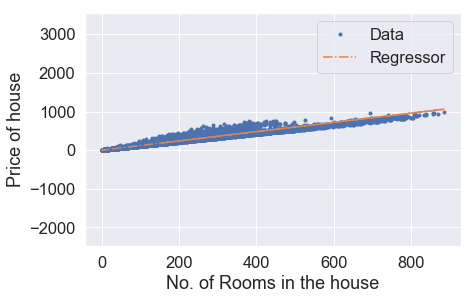

Iteration: 9031,Cost = 941.2445496333635,theta = [0.46651727 1.19726243]
Iteration: 9031,Cost_val = 945.54003127411,theta = [0.46651727 1.19726243]


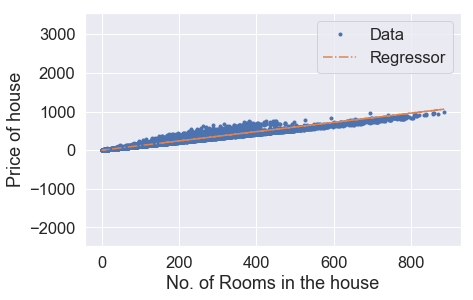

Iteration: 9041,Cost = 941.2420967454576,theta = [0.46701253 1.19726081]
Iteration: 9041,Cost_val = 945.5376205755765,theta = [0.46701253 1.19726081]


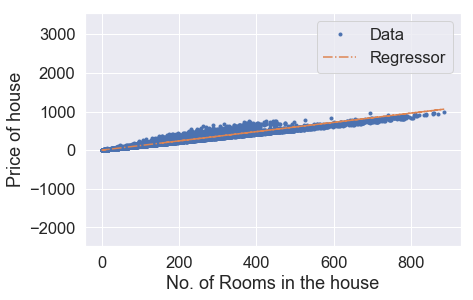

Iteration: 9051,Cost = 941.2396440997594,theta = [0.46750777 1.19725918]
Iteration: 9051,Cost_val = 945.5352101146611,theta = [0.46750777 1.19725918]


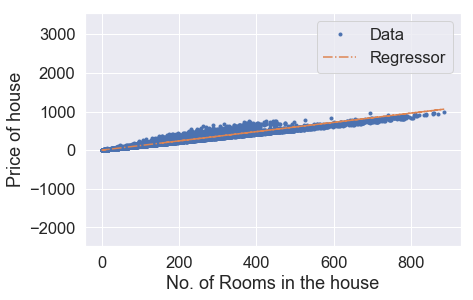

Iteration: 9061,Cost = 941.2371916962471,theta = [0.46800299 1.19725756]
Iteration: 9061,Cost_val = 945.5327998913323,theta = [0.46800299 1.19725756]


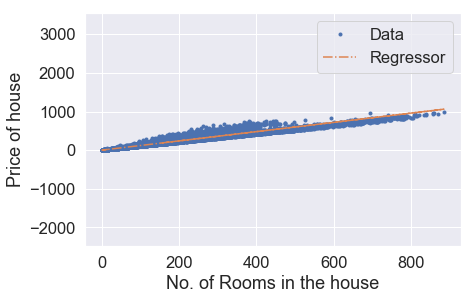

Iteration: 9071,Cost = 941.2347395349091,theta = [0.46849818 1.19725594]
Iteration: 9071,Cost_val = 945.5303899055713,theta = [0.46849818 1.19725594]


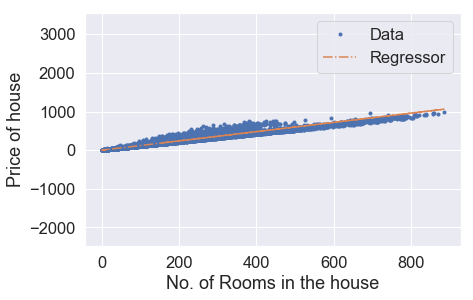

Iteration: 9081,Cost = 941.2322876156942,theta = [0.46899335 1.19725431]
Iteration: 9081,Cost_val = 945.5279801573453,theta = [0.46899335 1.19725431]


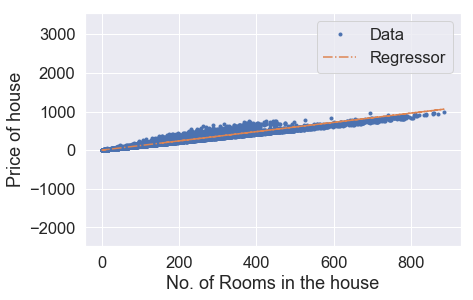

Iteration: 9091,Cost = 941.2298359386062,theta = [0.46948849 1.19725269]
Iteration: 9091,Cost_val = 945.5255706466404,theta = [0.46948849 1.19725269]


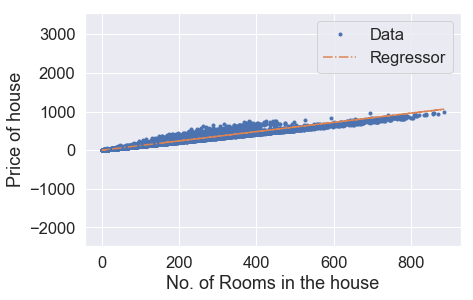

Iteration: 9101,Cost = 941.227384503615,theta = [0.46998361 1.19725107]
Iteration: 9101,Cost_val = 945.5231613734337,theta = [0.46998361 1.19725107]


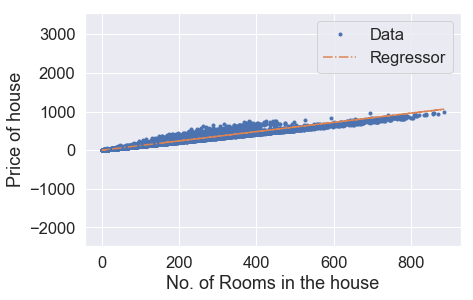

Iteration: 9111,Cost = 941.2249333106838,theta = [0.4704787  1.19724944]
Iteration: 9111,Cost_val = 945.5207523376947,theta = [0.4704787  1.19724944]


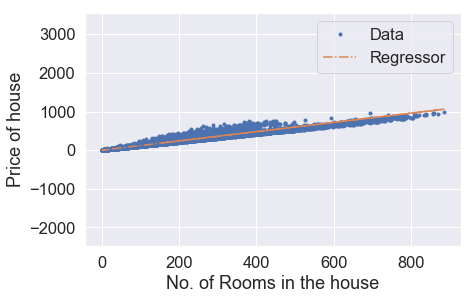

Iteration: 9121,Cost = 941.2224823597965,theta = [0.47097377 1.19724782]
Iteration: 9121,Cost_val = 945.5183435394058,theta = [0.47097377 1.19724782]


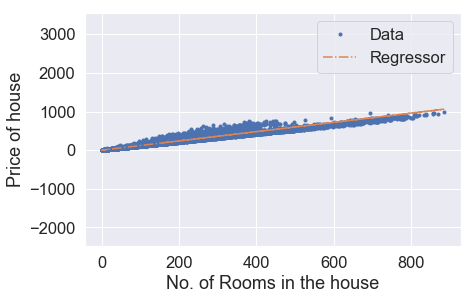

Iteration: 9131,Cost = 941.2200316509327,theta = [0.47146881 1.1972462 ]
Iteration: 9131,Cost_val = 945.5159349785347,theta = [0.47146881 1.1972462 ]


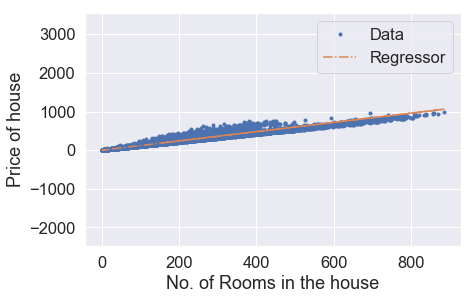

Iteration: 9141,Cost = 941.2175811840722,theta = [0.47196383 1.19724457]
Iteration: 9141,Cost_val = 945.513526655071,theta = [0.47196383 1.19724457]


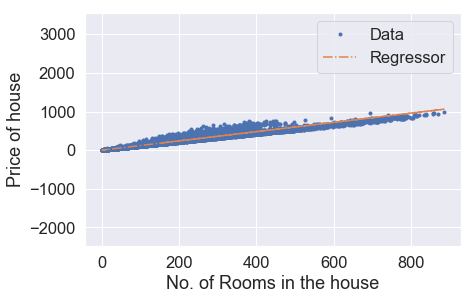

Iteration: 9151,Cost = 941.2151309591701,theta = [0.47245883 1.19724295]
Iteration: 9151,Cost_val = 945.5111185689811,theta = [0.47245883 1.19724295]


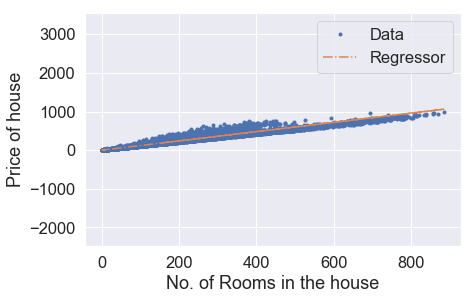

Iteration: 9161,Cost = 941.2126809762328,theta = [0.4729538  1.19724133]
Iteration: 9161,Cost_val = 945.5087107202481,theta = [0.4729538  1.19724133]


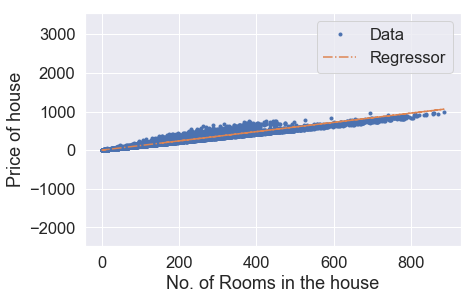

Iteration: 9171,Cost = 941.2102312352148,theta = [0.47344875 1.1972397 ]
Iteration: 9171,Cost_val = 945.5063031088441,theta = [0.47344875 1.1972397 ]


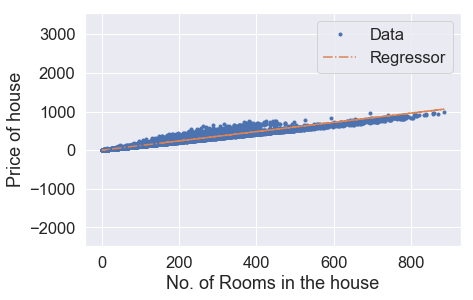

Iteration: 9181,Cost = 941.2077817360969,theta = [0.47394367 1.19723808]
Iteration: 9181,Cost_val = 945.5038957347473,theta = [0.47394367 1.19723808]


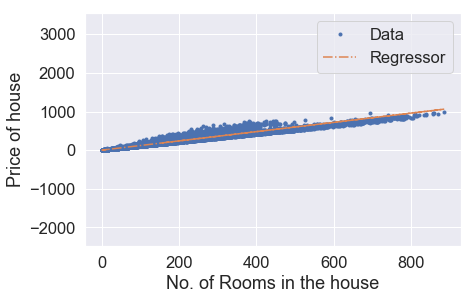

Iteration: 9191,Cost = 941.2053324788623,theta = [0.47443857 1.19723646]
Iteration: 9191,Cost_val = 945.501488597934,theta = [0.47443857 1.19723646]


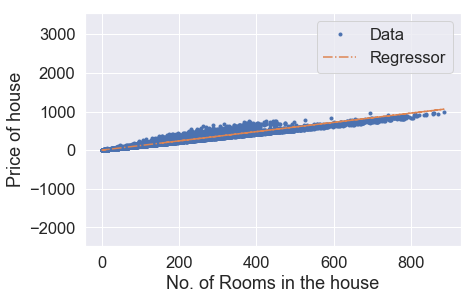

Iteration: 9201,Cost = 941.2028834634644,theta = [0.47493344 1.19723483]
Iteration: 9201,Cost_val = 945.4990816983824,theta = [0.47493344 1.19723483]


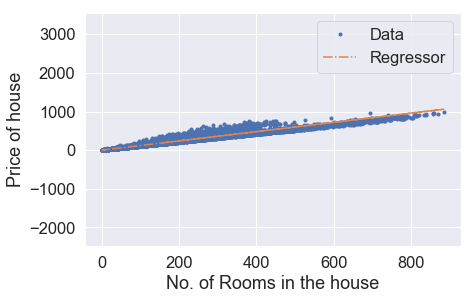

Iteration: 9211,Cost = 941.2004346899155,theta = [0.47542829 1.19723321]
Iteration: 9211,Cost_val = 945.4966750360664,theta = [0.47542829 1.19723321]


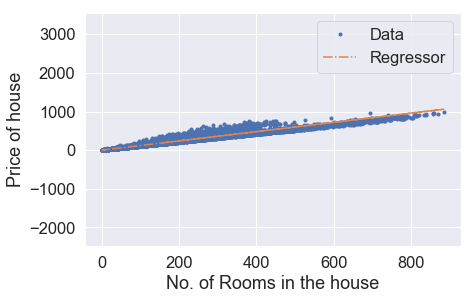

Iteration: 9221,Cost = 941.1979861581649,theta = [0.47592311 1.19723159]
Iteration: 9221,Cost_val = 945.4942686109638,theta = [0.47592311 1.19723159]


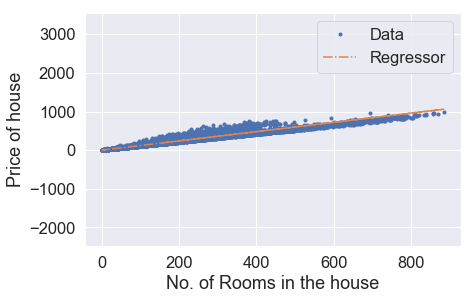

Iteration: 9231,Cost = 941.1955378681903,theta = [0.47641791 1.19722997]
Iteration: 9231,Cost_val = 945.4918624230522,theta = [0.47641791 1.19722997]


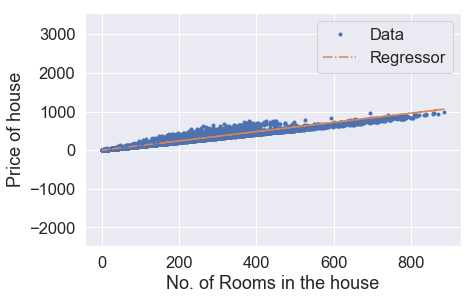

Iteration: 9241,Cost = 941.193089819983,theta = [0.47691269 1.19722834]
Iteration: 9241,Cost_val = 945.4894564723083,theta = [0.47691269 1.19722834]


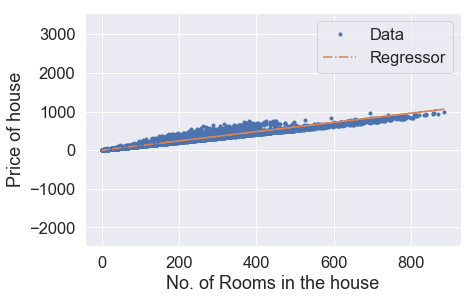

Iteration: 9251,Cost = 941.1906420135001,theta = [0.47740744 1.19722672]
Iteration: 9251,Cost_val = 945.4870507587069,theta = [0.47740744 1.19722672]


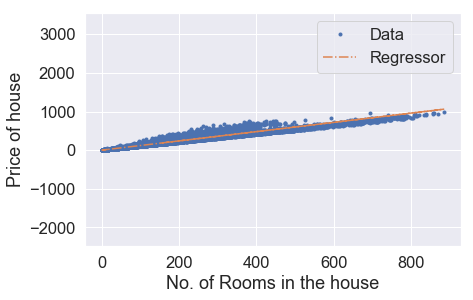

Iteration: 9261,Cost = 941.1881944487293,theta = [0.47790216 1.1972251 ]
Iteration: 9261,Cost_val = 945.4846452822258,theta = [0.47790216 1.1972251 ]


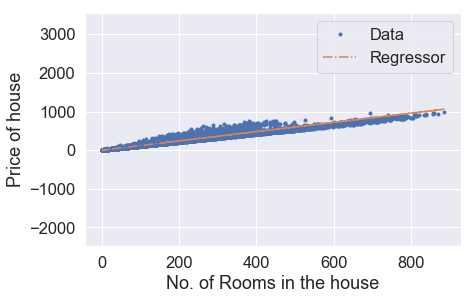

Iteration: 9271,Cost = 941.185747125665,theta = [0.47839687 1.19722348]
Iteration: 9271,Cost_val = 945.482240042839,theta = [0.47839687 1.19722348]


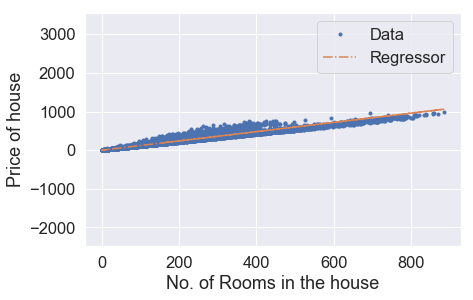

Iteration: 9281,Cost = 941.1833000442385,theta = [0.47889154 1.19722186]
Iteration: 9281,Cost_val = 945.4798350405266,theta = [0.47889154 1.19722186]


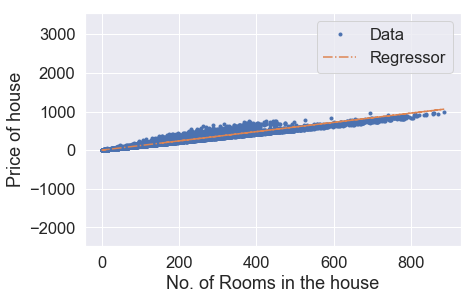

Iteration: 9291,Cost = 941.1808532044627,theta = [0.4793862  1.19722023]
Iteration: 9291,Cost_val = 945.4774302752631,theta = [0.4793862  1.19722023]


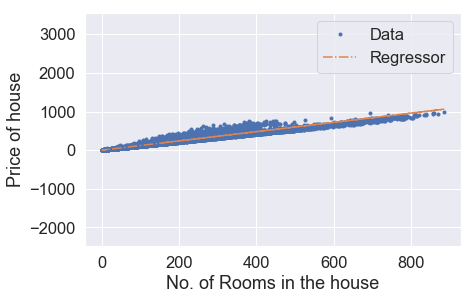

Iteration: 9301,Cost = 941.1784066062994,theta = [0.47988083 1.19721861]
Iteration: 9301,Cost_val = 945.4750257470253,theta = [0.47988083 1.19721861]


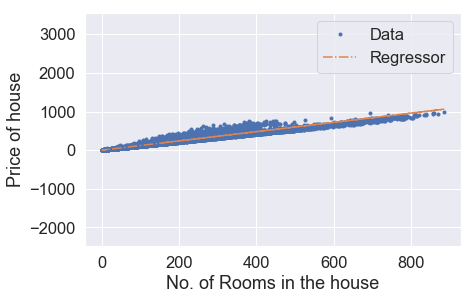

Iteration: 9311,Cost = 941.1759602497197,theta = [0.48037543 1.19721699]
Iteration: 9311,Cost_val = 945.472621455794,theta = [0.48037543 1.19721699]


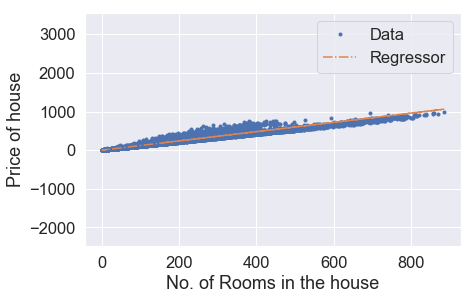

Iteration: 9321,Cost = 941.1735141347123,theta = [0.48087001 1.19721537]
Iteration: 9321,Cost_val = 945.4702174015389,theta = [0.48087001 1.19721537]


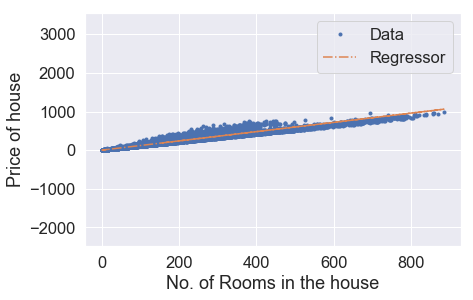

Iteration: 9331,Cost = 941.1710682612501,theta = [0.48136457 1.19721375]
Iteration: 9331,Cost_val = 945.4678135842471,theta = [0.48136457 1.19721375]


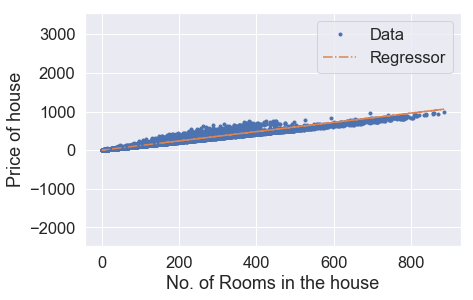

Iteration: 9341,Cost = 941.1686226293058,theta = [0.4818591  1.19721213]
Iteration: 9341,Cost_val = 945.4654100038798,theta = [0.4818591  1.19721213]


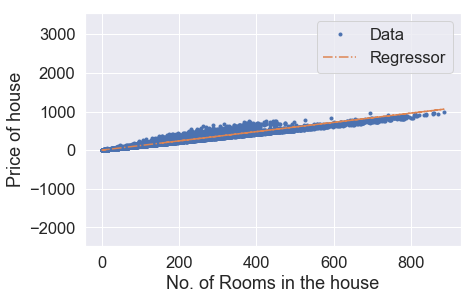

Iteration: 9351,Cost = 941.1661772388587,theta = [0.48235361 1.1972105 ]
Iteration: 9351,Cost_val = 945.4630066604259,theta = [0.48235361 1.1972105 ]


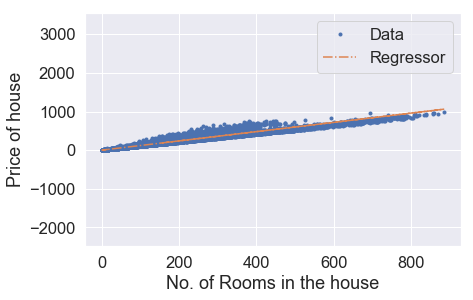

Iteration: 9361,Cost = 941.163732089885,theta = [0.48284809 1.19720888]
Iteration: 9361,Cost_val = 945.4606035538557,theta = [0.48284809 1.19720888]


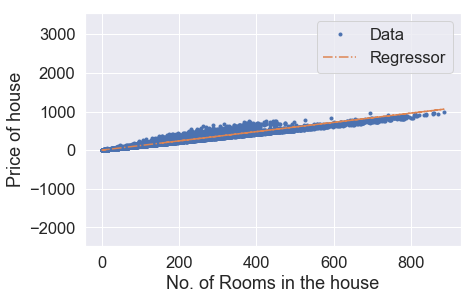

Iteration: 9371,Cost = 941.1612871823552,theta = [0.48334255 1.19720726]
Iteration: 9371,Cost_val = 945.45820068415,theta = [0.48334255 1.19720726]


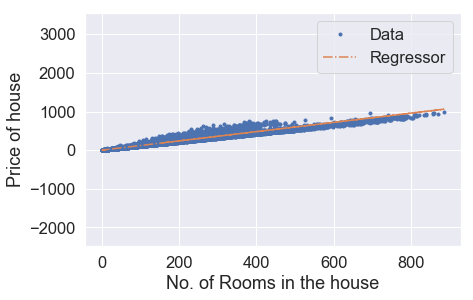

Iteration: 9381,Cost = 941.1588425162562,theta = [0.48383698 1.19720564]
Iteration: 9381,Cost_val = 945.4557980512832,theta = [0.48383698 1.19720564]


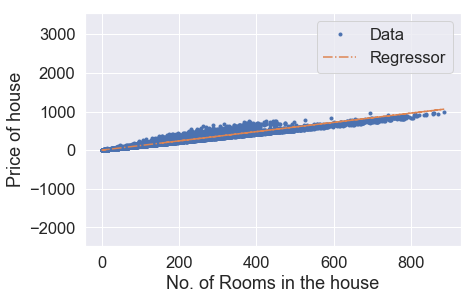

Iteration: 9391,Cost = 941.1563980915455,theta = [0.48433139 1.19720402]
Iteration: 9391,Cost_val = 945.4533956552332,theta = [0.48433139 1.19720402]


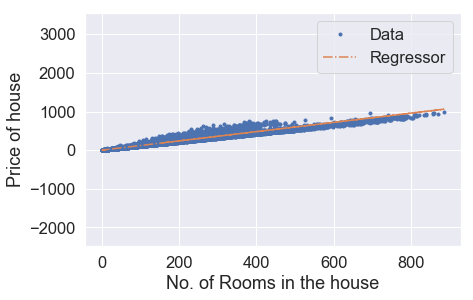

Iteration: 9401,Cost = 941.1539539082208,theta = [0.48482577 1.1972024 ]
Iteration: 9401,Cost_val = 945.4509934959792,theta = [0.48482577 1.1972024 ]


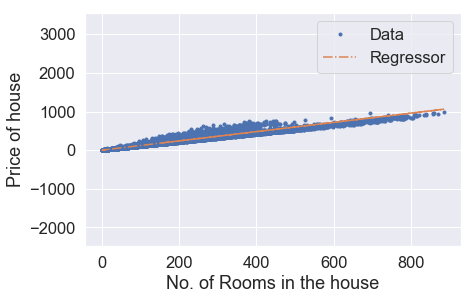

Iteration: 9411,Cost = 941.1515099662411,theta = [0.48532013 1.19720078]
Iteration: 9411,Cost_val = 945.448591573489,theta = [0.48532013 1.19720078]


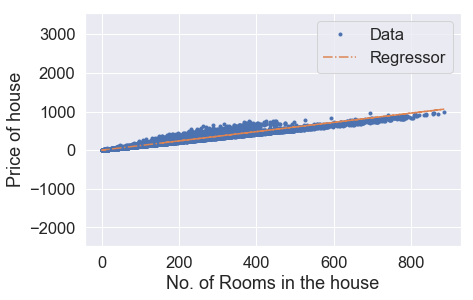

Iteration: 9421,Cost = 941.149066265596,theta = [0.48581447 1.19719916]
Iteration: 9421,Cost_val = 945.4461898877458,theta = [0.48581447 1.19719916]


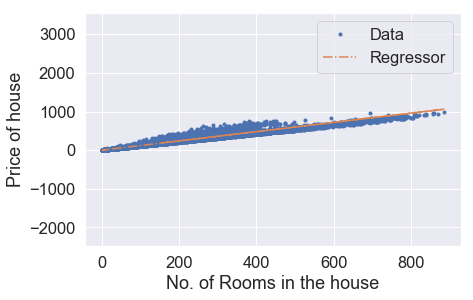

Iteration: 9431,Cost = 941.1466228062565,theta = [0.48630878 1.19719753]
Iteration: 9431,Cost_val = 945.4437884387262,theta = [0.48630878 1.19719753]


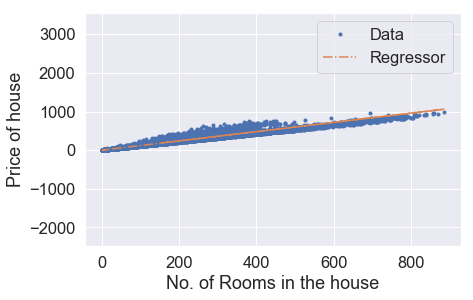

Iteration: 9441,Cost = 941.1441795881916,theta = [0.48680307 1.19719591]
Iteration: 9441,Cost_val = 945.4413872264063,theta = [0.48680307 1.19719591]


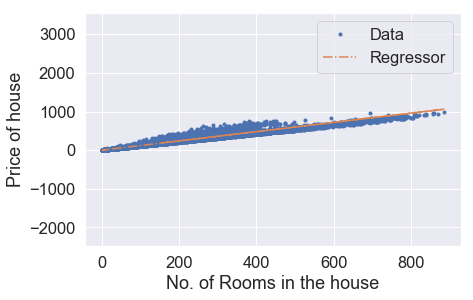

Iteration: 9451,Cost = 941.1417366113837,theta = [0.48729733 1.19719429]
Iteration: 9451,Cost_val = 945.4389862507596,theta = [0.48729733 1.19719429]


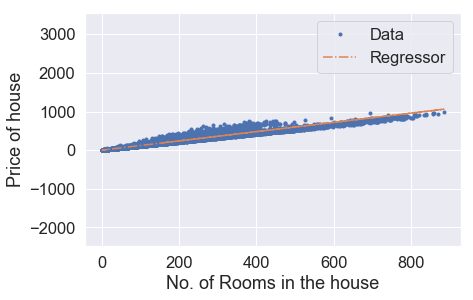

Iteration: 9461,Cost = 941.1392938758228,theta = [0.48779157 1.19719267]
Iteration: 9461,Cost_val = 945.4365855117665,theta = [0.48779157 1.19719267]


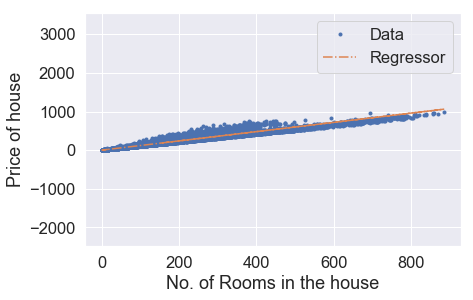

Iteration: 9471,Cost = 941.1368513814515,theta = [0.48828578 1.19719105]
Iteration: 9471,Cost_val = 945.4341850094066,theta = [0.48828578 1.19719105]


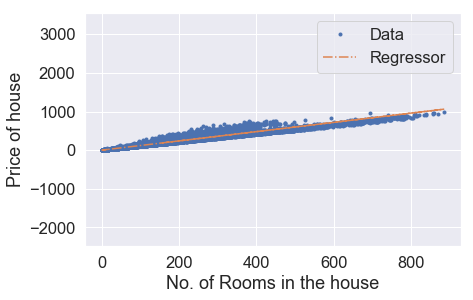

Iteration: 9481,Cost = 941.1344091282763,theta = [0.48877997 1.19718943]
Iteration: 9481,Cost_val = 945.4317847436478,theta = [0.48877997 1.19718943]


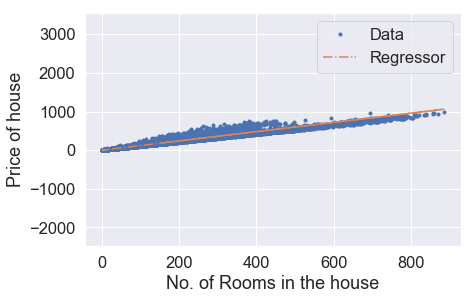

Iteration: 9491,Cost = 941.1319671162591,theta = [0.48927414 1.19718781]
Iteration: 9491,Cost_val = 945.4293847144738,theta = [0.48927414 1.19718781]


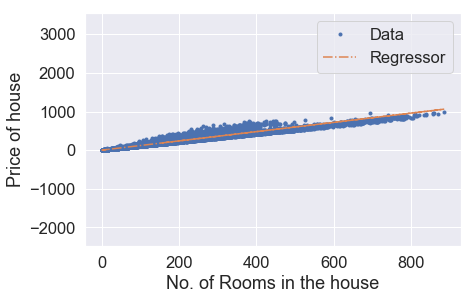

Iteration: 9501,Cost = 941.1295253453889,theta = [0.48976828 1.19718619]
Iteration: 9501,Cost_val = 945.4269849218574,theta = [0.48976828 1.19718619]


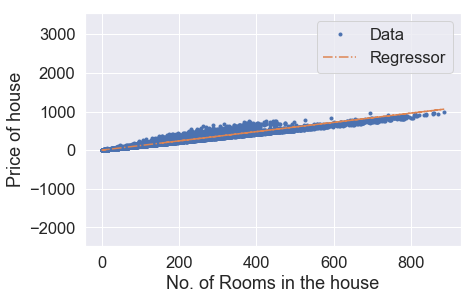

Iteration: 9511,Cost = 941.1270838156307,theta = [0.4902624  1.19718457]
Iteration: 9511,Cost_val = 945.4245853657784,theta = [0.4902624  1.19718457]


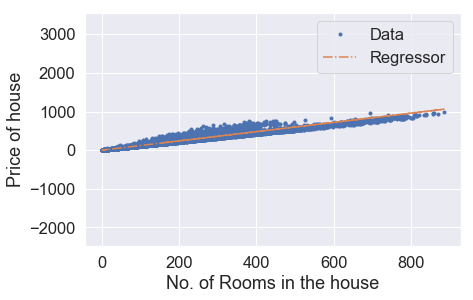

Iteration: 9521,Cost = 941.124642526956,theta = [0.49075649 1.19718295]
Iteration: 9521,Cost_val = 945.4221860462103,theta = [0.49075649 1.19718295]


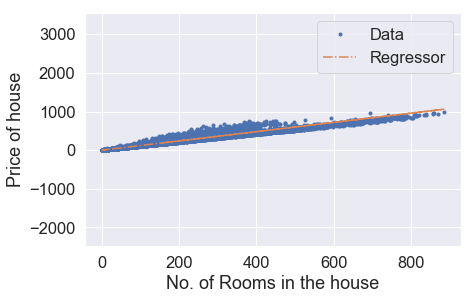

Iteration: 9531,Cost = 941.1222014793543,theta = [0.49125055 1.19718133]
Iteration: 9531,Cost_val = 945.4197869631317,theta = [0.49125055 1.19718133]


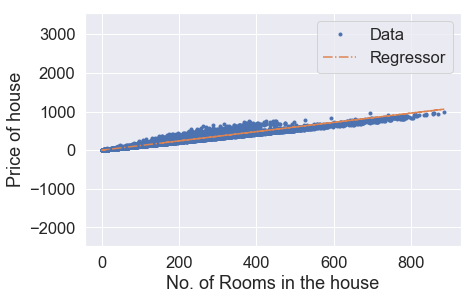

Iteration: 9541,Cost = 941.1197606727895,theta = [0.4917446  1.19717971]
Iteration: 9541,Cost_val = 945.4173881165199,theta = [0.4917446  1.19717971]


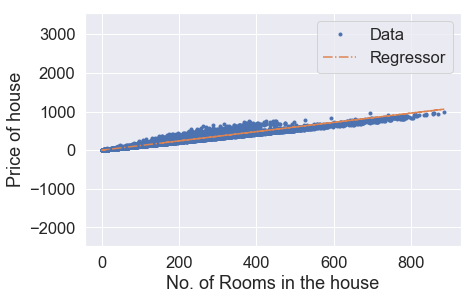

Iteration: 9551,Cost = 941.1173201072569,theta = [0.49223862 1.19717809]
Iteration: 9551,Cost_val = 945.414989506346,theta = [0.49223862 1.19717809]


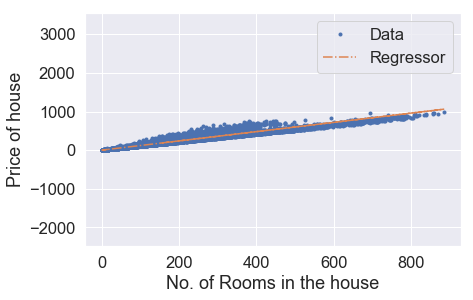

Iteration: 9561,Cost = 941.1148797827043,theta = [0.49273261 1.19717647]
Iteration: 9561,Cost_val = 945.4125911325966,theta = [0.49273261 1.19717647]


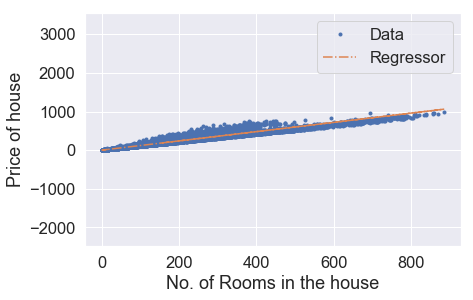

Iteration: 9571,Cost = 941.112439699126,theta = [0.49322658 1.19717485]
Iteration: 9571,Cost_val = 945.4101929952418,theta = [0.49322658 1.19717485]


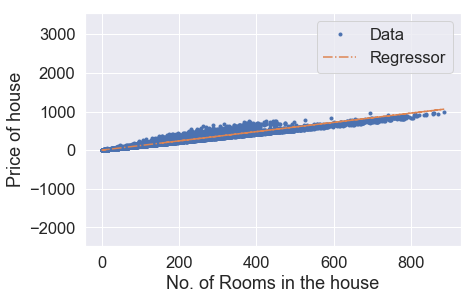

Iteration: 9581,Cost = 941.1099998565021,theta = [0.49372053 1.19717323]
Iteration: 9581,Cost_val = 945.4077950942609,theta = [0.49372053 1.19717323]


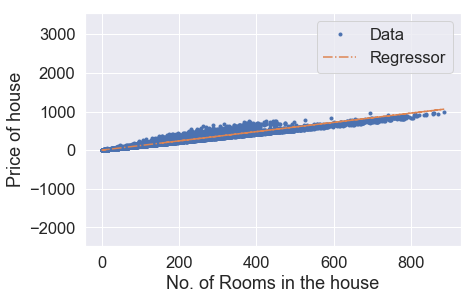

Iteration: 9591,Cost = 941.1075602547967,theta = [0.49421445 1.19717161]
Iteration: 9591,Cost_val = 945.4053974296291,theta = [0.49421445 1.19717161]


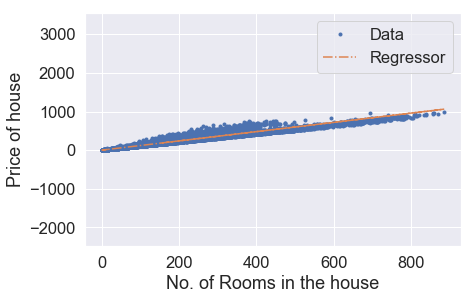

Iteration: 9601,Cost = 941.1051208939979,theta = [0.49470834 1.19716999]
Iteration: 9601,Cost_val = 945.4030000013179,theta = [0.49470834 1.19716999]


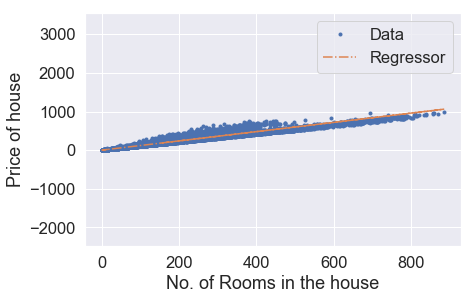

Iteration: 9611,Cost = 941.1026817740665,theta = [0.49520222 1.19716837]
Iteration: 9611,Cost_val = 945.400602809315,theta = [0.49520222 1.19716837]


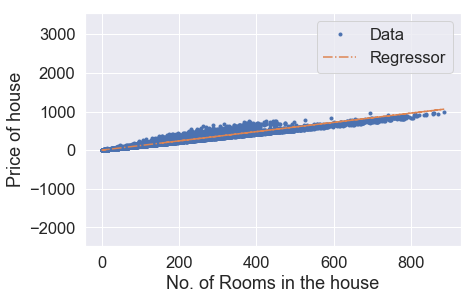

Iteration: 9621,Cost = 941.100242894984,theta = [0.49569607 1.19716675]
Iteration: 9621,Cost_val = 945.3982058535897,theta = [0.49569607 1.19716675]


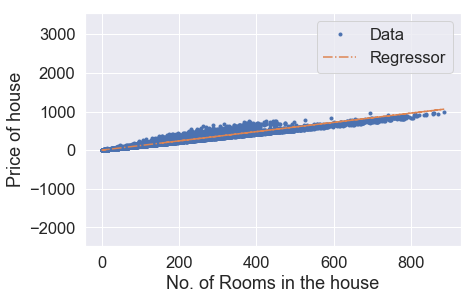

Iteration: 9631,Cost = 941.0978042567393,theta = [0.49618989 1.19716513]
Iteration: 9631,Cost_val = 945.3958091341188,theta = [0.49618989 1.19716513]


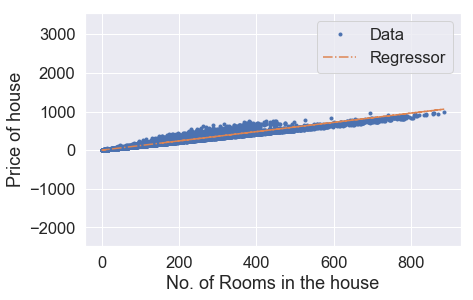

Iteration: 9641,Cost = 941.0953658593015,theta = [0.49668369 1.19716351]
Iteration: 9641,Cost_val = 945.3934126508829,theta = [0.49668369 1.19716351]


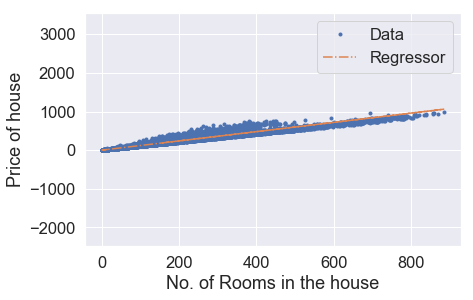

Iteration: 9651,Cost = 941.0929277026331,theta = [0.49717746 1.1971619 ]
Iteration: 9651,Cost_val = 945.3910164038533,theta = [0.49717746 1.1971619 ]


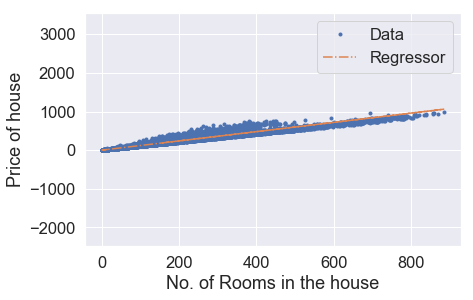

Iteration: 9661,Cost = 941.0904897867417,theta = [0.49767121 1.19716028]
Iteration: 9661,Cost_val = 945.38862039301,theta = [0.49767121 1.19716028]


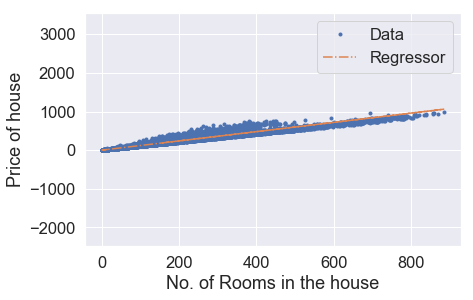

Iteration: 9671,Cost = 941.0880521115673,theta = [0.49816494 1.19715866]
Iteration: 9671,Cost_val = 945.386224618335,theta = [0.49816494 1.19715866]


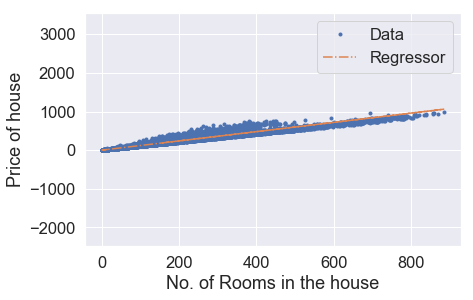

Iteration: 9681,Cost = 941.0856146771125,theta = [0.49865864 1.19715704]
Iteration: 9681,Cost_val = 945.3838290797954,theta = [0.49865864 1.19715704]


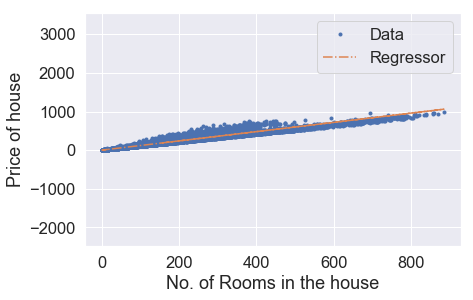

Iteration: 9691,Cost = 941.0831774833363,theta = [0.49915232 1.19715542]
Iteration: 9691,Cost_val = 945.3814337773699,theta = [0.49915232 1.19715542]


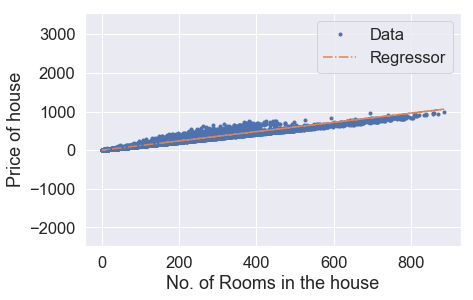

Iteration: 9701,Cost = 941.0807405302198,theta = [0.49964597 1.1971538 ]
Iteration: 9701,Cost_val = 945.3790387110423,theta = [0.49964597 1.1971538 ]


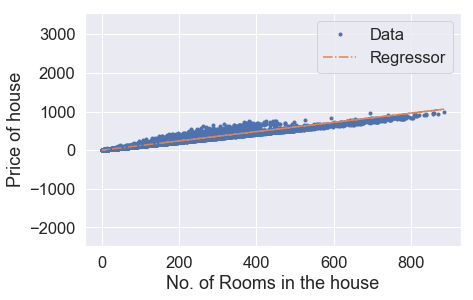

Iteration: 9711,Cost = 941.0783038177611,theta = [0.5001396  1.19715218]
Iteration: 9711,Cost_val = 945.3766438807803,theta = [0.5001396  1.19715218]


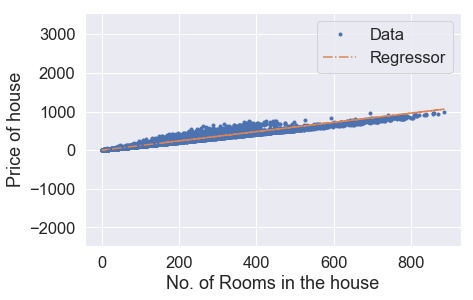

Iteration: 9721,Cost = 941.0758673458932,theta = [0.5006332  1.19715056]
Iteration: 9721,Cost_val = 945.3742492865662,theta = [0.5006332  1.19715056]


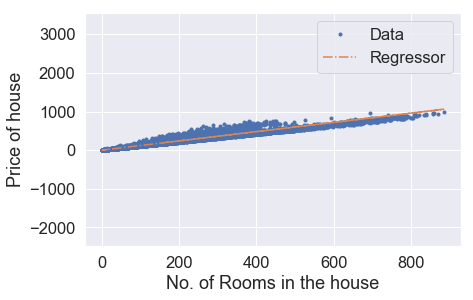

Iteration: 9731,Cost = 941.0734311146198,theta = [0.50112678 1.19714895]
Iteration: 9731,Cost_val = 945.3718549283728,theta = [0.50112678 1.19714895]


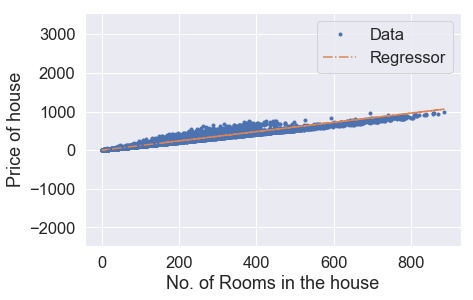

Iteration: 9741,Cost = 941.0709951239253,theta = [0.50162034 1.19714733]
Iteration: 9741,Cost_val = 945.3694608061837,theta = [0.50162034 1.19714733]


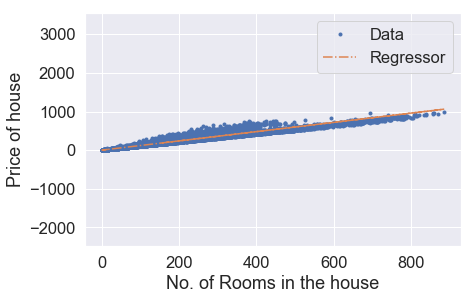

Iteration: 9751,Cost = 941.0685593737735,theta = [0.50211387 1.19714571]
Iteration: 9751,Cost_val = 945.3670669199672,theta = [0.50211387 1.19714571]


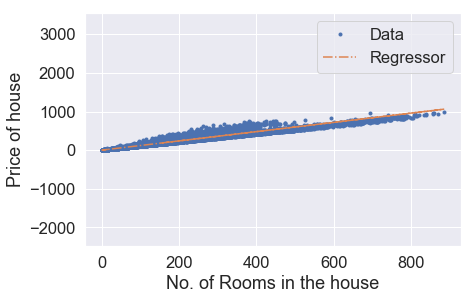

Iteration: 9761,Cost = 941.0661238641405,theta = [0.50260738 1.19714409]
Iteration: 9761,Cost_val = 945.364673269705,theta = [0.50260738 1.19714409]


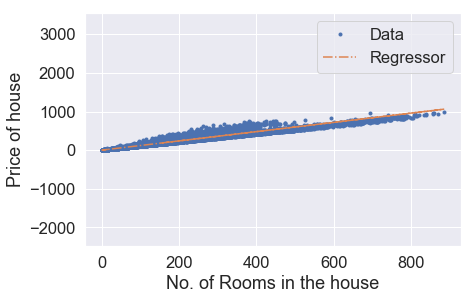

Iteration: 9771,Cost = 941.0636885949905,theta = [0.50310086 1.19714247]
Iteration: 9771,Cost_val = 945.36227985537,theta = [0.50310086 1.19714247]


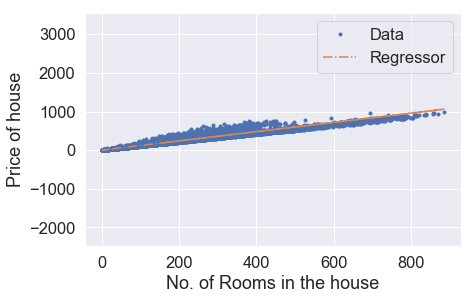

Iteration: 9781,Cost = 941.061253566321,theta = [0.50359432 1.19714085]
Iteration: 9781,Cost_val = 945.3598866769423,theta = [0.50359432 1.19714085]


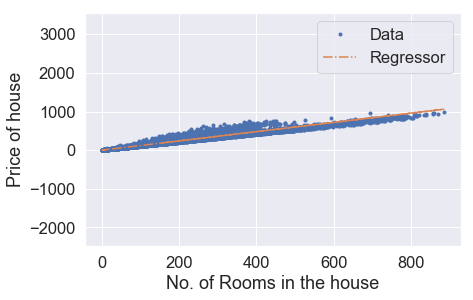

Iteration: 9791,Cost = 941.058818778106,theta = [0.50408775 1.19713924]
Iteration: 9791,Cost_val = 945.3574937344008,theta = [0.50408775 1.19713924]


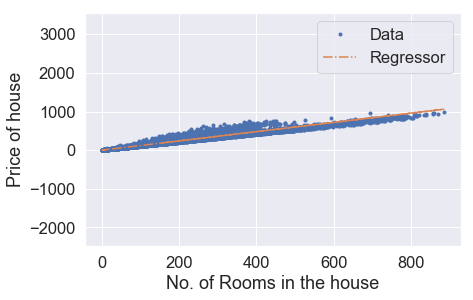

Iteration: 9801,Cost = 941.0563842303114,theta = [0.50458116 1.19713762]
Iteration: 9801,Cost_val = 945.3551010277175,theta = [0.50458116 1.19713762]


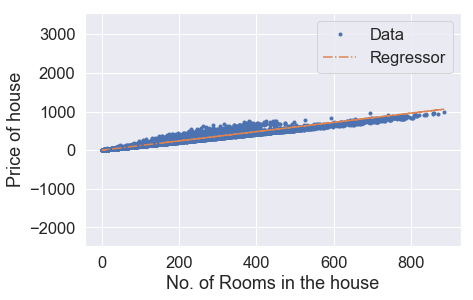

Iteration: 9811,Cost = 941.0539499229258,theta = [0.50507455 1.197136  ]
Iteration: 9811,Cost_val = 945.3527085568693,theta = [0.50507455 1.197136  ]


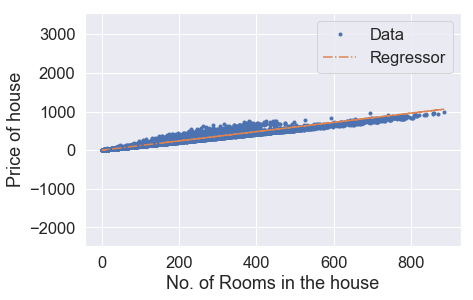

Iteration: 9821,Cost = 941.0515158559093,theta = [0.50556791 1.19713438]
Iteration: 9821,Cost_val = 945.3503163218364,theta = [0.50556791 1.19713438]


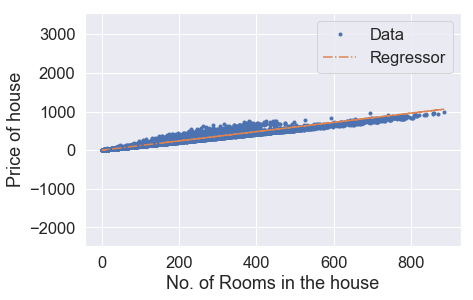

Iteration: 9831,Cost = 941.0490820292431,theta = [0.50606124 1.19713277]
Iteration: 9831,Cost_val = 945.3479243225977,theta = [0.50606124 1.19713277]


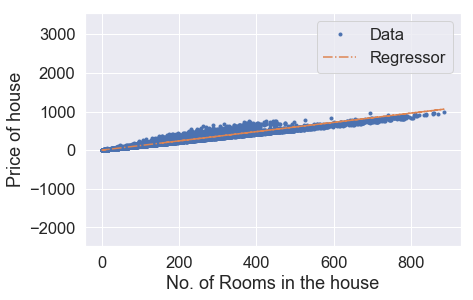

Iteration: 9841,Cost = 941.0466484429006,theta = [0.50655456 1.19713115]
Iteration: 9841,Cost_val = 945.3455325591211,theta = [0.50655456 1.19713115]


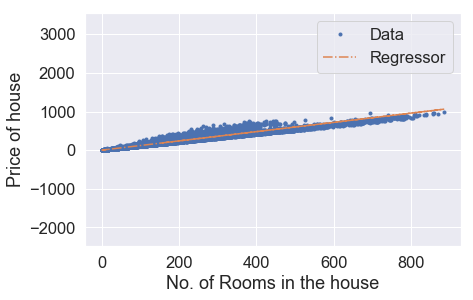

Iteration: 9851,Cost = 941.0442150968815,theta = [0.50704784 1.19712953]
Iteration: 9851,Cost_val = 945.3431410313902,theta = [0.50704784 1.19712953]


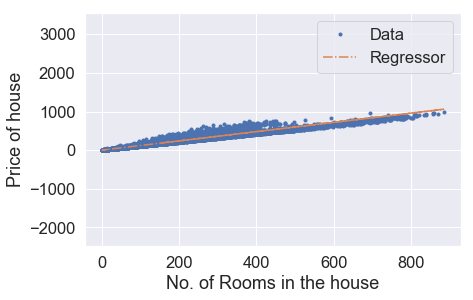

Iteration: 9861,Cost = 941.0417819911248,theta = [0.50754111 1.19712791]
Iteration: 9861,Cost_val = 945.34074973938,theta = [0.50754111 1.19712791]


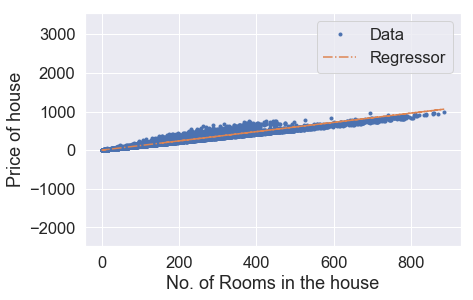

Iteration: 9871,Cost = 941.0393491256498,theta = [0.50803434 1.1971263 ]
Iteration: 9871,Cost_val = 945.3383586830671,theta = [0.50803434 1.1971263 ]


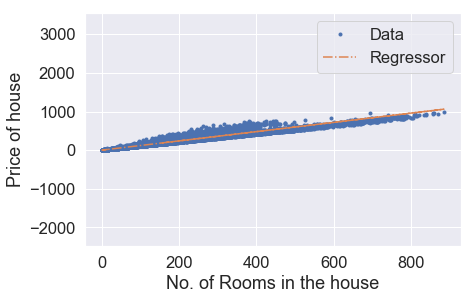

Iteration: 9881,Cost = 941.0369165003963,theta = [0.50852756 1.19712468]
Iteration: 9881,Cost_val = 945.3359678624241,theta = [0.50852756 1.19712468]


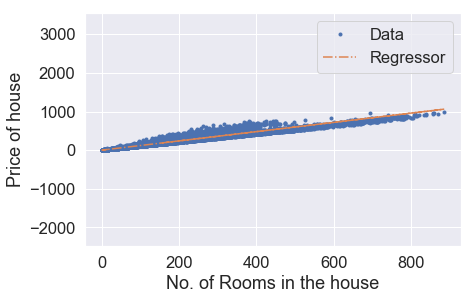

Iteration: 9891,Cost = 941.0344841153595,theta = [0.50902075 1.19712306]
Iteration: 9891,Cost_val = 945.3335772774344,theta = [0.50902075 1.19712306]


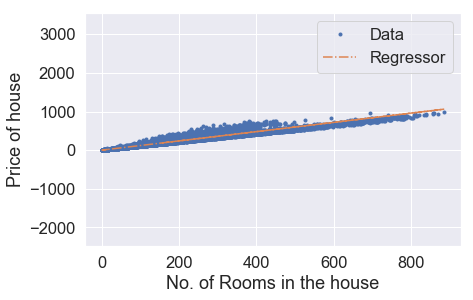

Iteration: 9901,Cost = 941.0320519705009,theta = [0.50951391 1.19712144]
Iteration: 9901,Cost_val = 945.33118692807,theta = [0.50951391 1.19712144]


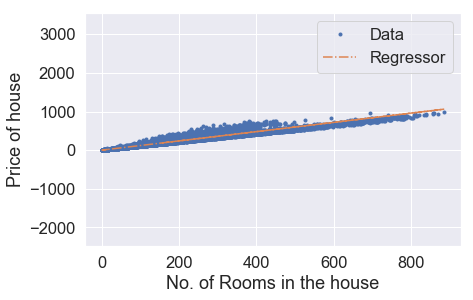

Iteration: 9911,Cost = 941.0296200658079,theta = [0.51000706 1.19711983]
Iteration: 9911,Cost_val = 945.3287968143144,theta = [0.51000706 1.19711983]


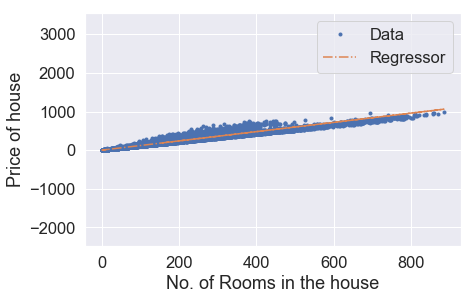

Iteration: 9921,Cost = 941.0271884012578,theta = [0.51050017 1.19711821]
Iteration: 9921,Cost_val = 945.3264069361392,theta = [0.51050017 1.19711821]


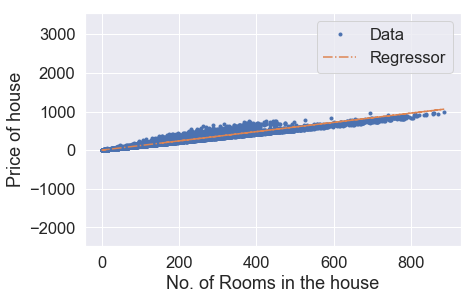

Iteration: 9931,Cost = 941.0247569768322,theta = [0.51099327 1.19711659]
Iteration: 9931,Cost_val = 945.3240172935157,theta = [0.51099327 1.19711659]


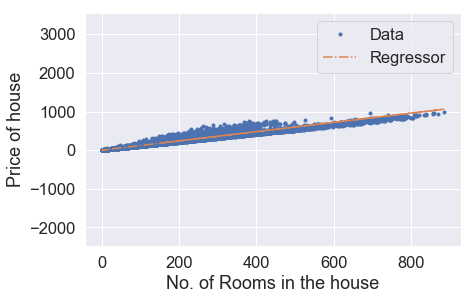

Iteration: 9941,Cost = 941.0223257924976,theta = [0.51148633 1.19711498]
Iteration: 9941,Cost_val = 945.3216278864332,theta = [0.51148633 1.19711498]


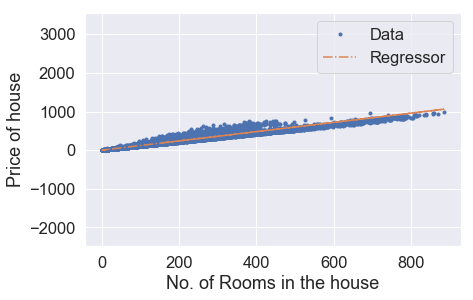

Iteration: 9951,Cost = 941.019894848224,theta = [0.51197938 1.19711336]
Iteration: 9951,Cost_val = 945.3192387148594,theta = [0.51197938 1.19711336]


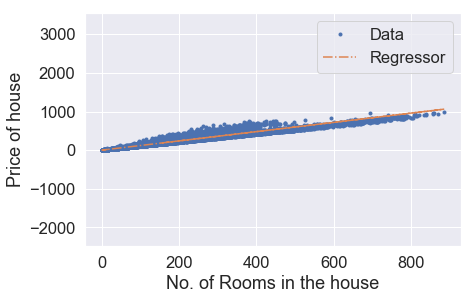

Iteration: 9961,Cost = 941.0174641439894,theta = [0.5124724  1.19711174]
Iteration: 9961,Cost_val = 945.316849778774,theta = [0.5124724  1.19711174]


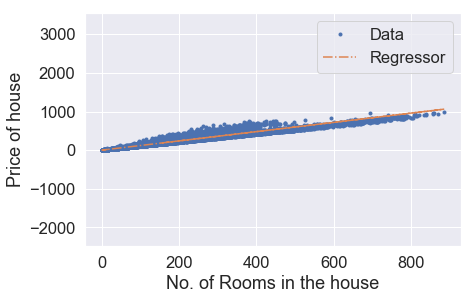

Iteration: 9971,Cost = 941.0150336797956,theta = [0.51296539 1.19711013]
Iteration: 9971,Cost_val = 945.3144610781541,theta = [0.51296539 1.19711013]


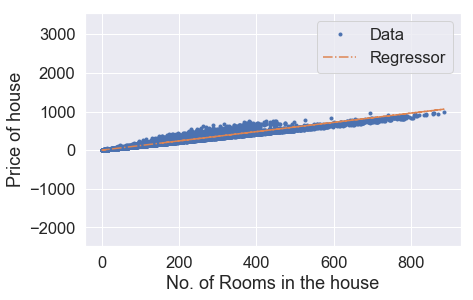

Iteration: 9981,Cost = 941.0126034555961,theta = [0.51345836 1.19710851]
Iteration: 9981,Cost_val = 945.312072612974,theta = [0.51345836 1.19710851]


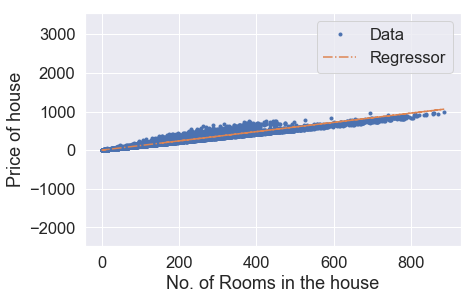

Iteration: 9991,Cost = 941.0101734713598,theta = [0.51395131 1.19710689]
Iteration: 9991,Cost_val = 945.3096843832129,theta = [0.51395131 1.19710689]


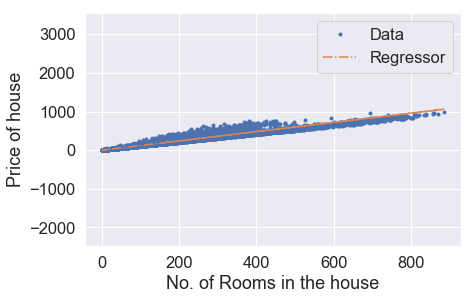

theta0 = 10000
theta1 = 10000
Costs = 10000


In [18]:
'''use the saved weight'''
costs_val,costs_train,theta,iteration  = gradientDescentLinearRegression(alpha=1e-5,iter=10000, theta=theta)

In [19]:
'''Calculate the loss for test data'''
J_test = calculateCost(x_test,theta,Y_test)
print(f"Cost_test = {J_test}")

Cost_test = 867.5955528747274


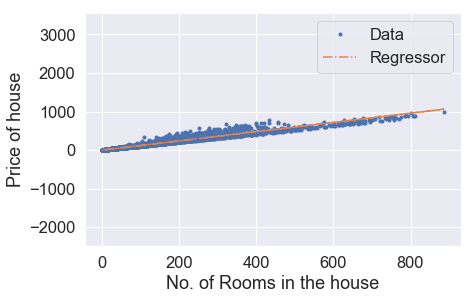

In [20]:
'''plot the test data'''
abline(x_test,theta,Y_test)

In [21]:
''' create range of iteration'''
iteration_range=list(range(0, iteration))

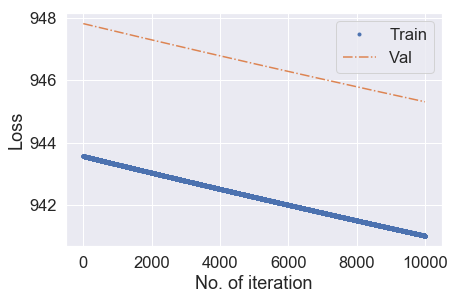

In [22]:
'''plot loss'''
loss_plot(iteration_range,costs_train,costs_val)